In [1]:
import psycopg2

import pandas as pd
import numpy as np
from datetime import datetime
# remove from final
from scipy.stats import ttest_ind

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import Voltus_Project_Nathan_Functions as functions

In [2]:
%load_ext autoreload
%autoreload 2
pd.options.display.max_rows = 100

# Initial Data Processing and EDA

In [3]:
# connecting to the server
conn = psycopg2.connect(
    database="interval_load_data",
    user='postgres',
    password='Onei9yepahShac0renga',
    host="test-interval-load-data.cwr8xr5dhgm1.us-west-2.rds.amazonaws.com",
    port="5432"
)

In [4]:
# querying the sites and their time period
site_df = pd.read_sql_query("SELECT site_id, \
                             MIN(interval_end) as time_start, \
                             MAX(interval_end) as time_end, \
                             (MAX(interval_end) - MIN(interval_end)) as series_length, \
                             COUNT(*) as interval_counts, \
                             AVG(interval_width) as mean_interval_width \
                             FROM intervals \
                             GROUP BY site_id;", conn)

In [5]:
# checking for nulls, only found for kWh
null_df = pd.read_sql_query('SELECT COUNT(*) as kWh_nulls \
                             FROM intervals \
                             WHERE "kWh" IS NULL;', conn)
null_df

,kwh_nulls
0,23


In [6]:
# vast majority of data has intervals of 15-minutes or 1-hour
# the 4 other will need to be looked at in more depth
site_df['mean_interval_width'].value_counts()

900.000000     270
3600.000000     93
996.322396       3
949.035874       1
Name: mean_interval_width, dtype: int64

In [7]:
# general inspection
site_df

,site_id,time_start,time_end,series_length,interval_counts,mean_interval_width
0,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 05:00:00,2018-10-04 04:00:00,1237 days 23:00:00,118845,900.0
1,a05598bc-59ac-6697-0673-0e87e7ccc677,2018-06-01 05:15:00,2018-10-07 05:00:00,127 days 23:45:00,12288,900.0
2,b8ec0850-c5ce-1579-5438-8d1247f0ff16,2016-09-05 05:00:00,2018-09-07 04:00:00,731 days 23:00:00,17568,3600.0
3,b9ad1c9b-fbe2-f36f-ab2a-6894c251433f,2018-08-17 07:15:00,2018-09-01 07:00:00,14 days 23:45:00,1056,900.0
4,61ff3699-aad4-35d3-4ecb-b8195e8b08cd,2015-01-01 05:00:00,2018-10-22 04:00:00,1389 days 23:00:00,133434,900.0
...,...,...,...,...,...,...
362,debc4593-d7e7-c1ae-f268-f6944c531e3f,2015-05-15 05:00:00,2018-10-12 04:00:00,1245 days 23:00:00,119452,900.0
363,8a2629e5-183b-05c3-7544-5ac89ee3c347,2018-05-04 05:00:00,2018-10-12 04:00:00,160 days 23:00:00,15453,900.0
364,811effd3-85a7-f36f-5eeb-cb38de38d5ac,2017-06-21 04:15:00,2018-10-12 04:00:00,477 days 23:45:00,45888,900.0
365,a85566bd-7cea-eb51-6aa5-912ee6bdd7d7,2015-05-15 05:00:00,2018-10-12 04:00:00,1245 days 23:00:00,119505,900.0


In [8]:
site_df.sort_values('series_length').head(100)

,site_id,time_start,time_end,series_length,interval_counts,mean_interval_width
78,44236c0b-b566-0af2-6675-6854fa9378dd,2018-08-20 05:15:00,2018-08-20 05:15:00,0 days 00:00:00,1,900.0
317,30c1077f-52be-0374-cbd6-3cb5974a0bfd,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0
213,914a4622-8135-e1af-b78d-27324b8a2283,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0
25,3dc26230-5764-4f78-4bbe-b7fa0557b7e8,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0
140,36f7a93f-16f8-3f4d-136e-551893c0eacf,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0
224,8dd2fc1b-0874-7462-b589-7ad334248d13,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0
256,2ae3a189-e627-5fe7-d0ac-dcbbfbab0b43,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0
119,dd0c760b-daf3-2e3d-c566-b95a0c0f2ed8,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0
341,998de051-d72a-2d40-1f2f-196f036ec8bf,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0
109,ea5a9c0c-6723-2114-3396-87e87ea4ae93,2018-07-24 05:00:00,2018-07-25 04:00:00,0 days 23:00:00,24,3600.0


In [9]:
# the smaller time series will need to be accommodated
np.sort(site_df['interval_counts'].unique())

array([     1,     24,   1056,   1536,   1629,   3048,   3672,   4893,
         5952,   7488,   7630,   8086,   8160,   8424,   8757,   8758,
         8926,   8998,   9094,   9430,   9478,   9622,   9646,  10078,
        10174,  10294,  10678,  10750,  10774,  10798,  10822,  10918,
        10966,  10990,  11014,  11277,  12288,  13623,  14304,  15069,
        15453,  15584,  17194,  17376,  17540,  17568,  18286,  18393,
        18456,  18840,  18946,  18948,  18954,  18960,  19030,  19032,
        19423,  19526,  21116,  21743,  21829,  22516,  23663,  24300,
        30471,  33021,  35592,  36328,  38012,  45888,  60468,  62393,
        65800,  71360,  74112,  74905,  82491,  82647,  82677,  82679,
        82686,  82692,  82695,  82703,  82704,  82711,  82712,  82714,
        82740,  82743,  82747,  82842,  89899,  95066,  95901,  97396,
        97437, 115860, 117551, 118743, 118845, 119319, 119415, 119416,
       119447, 119449, 119452, 119453, 119454, 119455, 119457, 119461,
      

In [10]:
# checking for nulls and confirming datatypes
site_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 367 entries, 0 to 366
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype          
---  ------               --------------  -----          
 0   site_id              367 non-null    object         
 1   time_start           367 non-null    datetime64[ns] 
 2   time_end             367 non-null    datetime64[ns] 
 3   series_length        367 non-null    timedelta64[ns]
 4   interval_counts      367 non-null    int64          
 5   mean_interval_width  367 non-null    float64        
dtypes: datetime64[ns](2), float64(1), int64(1), object(1), timedelta64[ns](1)
memory usage: 17.3+ KB


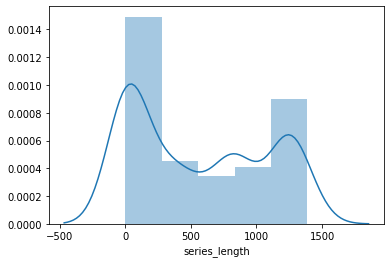

In [11]:
# inspecting the distribution in time series length in days
sns.distplot(site_df['series_length'].dt.days)

In [12]:
# checking for any really small time series and it looks like one might not have enough data to evaluate
# some only have a day of data, but at least you can check that day for start/stop, DR and gaps
site_df['series_length'].sort_values().head()

78    00:00:00
317   23:00:00
213   23:00:00
25    23:00:00
140   23:00:00
Name: series_length, dtype: timedelta64[ns]

In [13]:
# This site only has a single data point, so it will be excluded from further analysis
site_check = pd.read_sql_query("SELECT * \
                               FROM intervals \
                               WHERE site_id='44236c0b-b566-0af2-6675-6854fa9378dd';", conn)
site_check

,kWh,interval_end,interval_width,site_id
0,98.142,2018-08-20 05:15:00,900,44236c0b-b566-0af2-6675-6854fa9378dd


In [14]:
insufficient_data_sites = pd.read_sql_query("SELECT site_id, COUNT(*) FROM intervals \
                                             GROUP BY site_id \
                                             HAVING COUNT(*) < 24;", conn)
insufficient_data_sites

,site_id,count
0,44236c0b-b566-0af2-6675-6854fa9378dd,1


In [15]:
# These sites had either all 0's
# or if some non-0 values existed then they were very small and only had a few unique values.
# These sites were excluded from further analysis as they appear to have corrupted/unusable data
corrupt_sites = pd.read_sql_query("""SELECT site_id, PERCENTILE_CONT(0.5) WITHIN GROUP(ORDER BY "kWh") \
                                     FROM intervals \
                                     GROUP BY site_id \
                                     HAVING PERCENTILE_CONT(0.5) WITHIN GROUP(ORDER BY "kWh") < 0.05;""", conn)
corrupt_sites

,site_id,percentile_cont
0,0101ee7c-a0ef-7b94-f62b-594142c8b0e6,0.000
1,07ae0994-02e6-2b53-051f-609e8d9efa1e,0.000
2,3bb491cc-4378-1845-cd31-41b0a3c10ad3,0.000
3,7e03e2ca-18ed-5eb8-15d9-d56ad7d89634,0.000
4,9fe91411-9092-2ce4-aabc-dd3c6868d50a,0.032


In [16]:
excluded_sites = pd.concat([insufficient_data_sites['site_id'], corrupt_sites['site_id']])
excluded_sites = list(excluded_sites)
site_df = site_df.loc[site_df['site_id'].isin(list(excluded_sites)) == False]
site_df.reset_index(drop=True, inplace=True)
site_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 361 entries, 0 to 360
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype          
---  ------               --------------  -----          
 0   site_id              361 non-null    object         
 1   time_start           361 non-null    datetime64[ns] 
 2   time_end             361 non-null    datetime64[ns] 
 3   series_length        361 non-null    timedelta64[ns]
 4   interval_counts      361 non-null    int64          
 5   mean_interval_width  361 non-null    float64        
dtypes: datetime64[ns](2), float64(1), int64(1), object(1), timedelta64[ns](1)
memory usage: 17.0+ KB


In [17]:
# I want to look closer at the sites with unexpected interval lengths
odd_intervals = list(site_df.loc[(site_df['mean_interval_width'] != 900)
                                 & (site_df['mean_interval_width'] != 3600)]['site_id'])

# There is a pattern here where these four sites have 1296 1-hour intervals covering the same period of time.
# Any future algorithms will need to be able to account for this.
for odd_site in odd_intervals:
    interval_check = pd.read_sql_query(f"SELECT * \
                                        FROM intervals \
                                        WHERE site_id='{odd_site}';", conn)
    hour_time_start = interval_check.loc[interval_check['interval_width'] == 3600]['interval_end'].min()
    hour_time_end = interval_check.loc[interval_check['interval_width'] == 3600]['interval_end'].max()
    print(odd_site)
    print(interval_check['interval_width'].value_counts())
    print('Hourly data starts at ',hour_time_start)
    print('Hourly data ends at ',hour_time_end)
    
# I noticed relatively late (Saturday Afternoon) that the timezones appear to change when the interval lengths changed
# For the first site below it appears that the post interval transition times series is 5 hours ahead of 
# the pre-transition times, which is suspiciuosly how far ahead GMT is from EST.
# But this was consistently seen and it wasn't entirely clear that all of them had similarly calibrated
# meters before and after as the relative magnitude of avg_kW didn't seem the same.
# I decided not to address the issue further in the interest of time.
# Since most of the data is from before the transition, the calculations/deliverable should reflect that portion of the data

e7d819a2-4382-e7d1-a267-069c96a54333
900     35032
3600     1296
Name: interval_width, dtype: int64
Hourly data starts at  2018-09-01 09:00:00
Hourly data ends at  2018-10-25 08:00:00
871f9fba-e8c7-cdcd-1ac4-863509f1be51
900     35032
3600     1296
Name: interval_width, dtype: int64
Hourly data starts at  2018-09-01 09:00:00
Hourly data ends at  2018-10-25 08:00:00
66e9c85d-6b5f-d012-4b56-f69218073f86
900     70064
3600     1296
Name: interval_width, dtype: int64
Hourly data starts at  2018-09-01 09:00:00
Hourly data ends at  2018-10-25 08:00:00
cb846659-8aa0-3233-6b11-6745474c94c3
900     35032
3600     1296
Name: interval_width, dtype: int64
Hourly data starts at  2018-09-01 09:00:00
Hourly data ends at  2018-10-25 08:00:00


In [18]:
# creating a list of sites to be analyzed for use in loops
site_list = list(site_df['site_id'])
len(site_list)

361

In [19]:
# Downloading all the data to a local csv for development
# and to prevent repetitive and time consuming queries

# all_data_df = pd.DataFrame()
# for site in site_list:
#     site_data_df = pd.read_sql_query(f"SELECT * \
#                                       FROM intervals \
#                                       WHERE site_id='{site}';"
#                                     , conn)
#     all_data_df = pd.concat([all_data_df,
#                              site_data_df])
# all_data_df.reset_index(drop=True, inplace=True)
# all_data_df.to_csv('data/kWh_data.csv', index=False)

# all_data_df = pd.DataFrame()
# for site in site_list:
#     site_data_df = pd.read_sql_query(f"""SELECT (3600./interval_width)*"kWh" as "avg_kW",
#                                                 interval_end, interval_width, site_id \
#                                          FROM intervals \
#                                          WHERE site_id='{site}'
#                                          ORDER BY interval_end asc;"""
#                                     , conn)
#     all_data_df = pd.concat([all_data_df,
#                              site_data_df])
# all_data_df.reset_index(drop=True, inplace=True)
# all_data_df.to_csv('data/kW_data.csv', index=False)

In [ ]:
# During development I loaded the local .csv to prevent repetitive and time consuming queries

# all_data_df = pd.read_csv('data/kW_data.csv')
# all_data_df['interval_end'] = pd.to_datetime(all_data_df['interval_end'])
# all_data_df.info()

In [20]:
# all_data_df = pd.read_sql_query("""SELECT "kWh"*(3600./interval_width) as "avg_kW",
#                                            interval_end, interval_width, site_id \
#                                     FROM intervals \
#                                     ORDER BY site_id, interval_end asc;"""
#                                 , conn)
# all_data_df.info()

# Analyzing Daily Start/Stop and Potential DR Events
I ended up using a lot of the information generated while determining daily start/stops to try and identify potential DR events, so I looped through the data once and generated the results to both questions. This took a fair amount of time to execute on my computer with the vast majority of the time spent on the Potential DR Events portion due to my approach requiring the calculation of rolling sums of whether I deem the site to be operating during high load periods or not.  
  
My approach to determining whether a site was continuous and its daily start and stop times involved grouping all of a site's data by day of week and interval end, and then taking the median value to generate a model of a typical week's time series. Whether a given day of week was an operating day or not depended on whether or not it's daily near peak load (95th percentile of load vs. 5th percentile for near base load) was closer to the week's maximum daily near peak load or its minimum daily near base load. A 2 sample T-test was then performed on the near peak and base loads for the operating days to determine if they appeared to be from the same population (i.e. continuous) or not. Upon further inspection, there was more variability in how a continuous site's load profile could look and some ambiguity around whether certain sites were daily or continuous based on seemingly mild daily rhythms and/or high variability over time. A more sophisticated approach would be taken given more time and additional data on a given site. Perhaps an unsupervised clustering based approach and/or the inclusion of smoothing (e.g. rolling average or exponential smoothing) to reduce some of the variability that also impacted some start/stop determinations.  
  
My approach to daily start/stop in part followed a method from a document generated by the Lawrence Berkeley National Laboratory titled Electric Load Shape Benchmarking for small-and Medium-Sized Commercial Buildings. In general, the approach is to set an on-hour threshold and then set the time when on-hours begin to the start time and when they end to the stop time. The threshold is defined as the 5th_percentile_of_load + 0.25 * (95th_percentile_of_load - 5th_percentile_of_load). The hourly means from operating days in the modeled typical week were used to generate a model of a typical day for the purposes of evaluating this daily start/stop method. It appeared to work quite well for most buildings, but a one-size fits all approach doesn't appear to be sufficient for all cases, especially when the load curves showed lots of variability, which was at times compounded by having only a handful of days of data.  
  
My approach to identifying potential DR events involved using the modeled typical week to determine the range of high load hours (i.e. hours with load closer to the daily near peak load than the daily near base load) for each day of week to allow for variation throughout the week as not all sites were observed to have a single operating and non-operating load profile. I then looped through each date's high load period and generated a rolling sum of hours that were above the on-hour threshold. For the purposes of this exercise, I assumed a DR event had to last at least 2 continuous hours and the same day must exhibit 5 continuous hours of on-operation to ensure the entire day wasn't an outlier of some sort. Any day that met those criteria was listed as a day with a potential DR event. This approach didn't appear to yield spectacular results with lots of false positives.  
  
With more time I would focus specifically on improving my approach to classifying continuous operation and potential DR events.

In [733]:

####OBSOLETE

def agg_day_high_load_identifier(day_df, ops_params, near_base_pctl = 5, near_peak_pctl = 95):
    """
    Given a site's aggregated operating day load profile and select operating characteristics,
    determine the start and stop of the high load period (i.e. when it's closer to peak than base).
    """
    ref_peak = ops_params['ref_peak']
    ref_base = ops_params['ref_base']
    # generating load profile parameters
    day_df['near_base_load'] = np.percentile(day_df['avg_kW'], near_base_pctl)
    day_df['near_peak_load'] = np.percentile(day_df['avg_kW'], near_peak_pctl)
    day_df['near_base_delta'] = day_df.loc[:, 'avg_kW'] - day_df.loc[:, 'near_base_load']
    day_df['near_peak_delta'] = day_df.loc[:, 'near_peak_load'] - day_df.loc[:, 'avg_kW']
    day_df['high_load_period'] = day_df.loc[:, 'near_base_delta'] > day_df.loc[:, 'near_peak_delta']
    # identifying the start and stop times
    shift_forward_fill = day_df['high_load_period'].iloc[-1]
    shift_backward_fill = day_df['high_load_period'].iloc[0]
    day_df['high_start'] = day_df['high_load_period'].shift(1, fill_value=shift_forward_fill)
    day_df['high_start'] = day_df['high_load_period'] > day_df['high_start']
    # taking the earliest potential start time in case the data is noisy 
    start_time = day_df.loc[day_df['high_start']].index[0]
    start_time = datetime.strptime(start_time, '%H:%M:%S').time()
    day_df['high_stop'] = day_df['high_load_period'].shift(-1, fill_value=shift_backward_fill)
    day_df['high_stop'] = day_df['high_load_period'] > day_df['high_stop']
    # taking the latest stop time for the same reason as the earliest start
    stop_time = day_df.loc[day_df['high_stop']].index[-1]
    stop_time = datetime.strptime(stop_time, '%H:%M:%S').time()
    # saving the parameters, note shifted time is being used
    ops_params.update({'high_start': start_time, 'high_stop': stop_time})
    return day_df, ops_params

In [734]:
# abondoned this after finding issues with the data in the sites with different interval widths
def hourly_resample(variable_interval_df, site_id):
    """
    Given a DataFrame of interval data with intervals of both 900 and 3600,
    return a properly resampled DataFrame at hourly intervals.
    """
    short_interval_df = variable_interval_df.loc[variable_interval_df['interval_width'] == 900]
    short_interval_df = short_interval_df[['avg_kW', 'interval_end']].set_index('interval_end', drop=True)
    long_interval_df = variable_interval_df.loc[variable_interval_df['interval_width'] == 3600]  
    long_interval_df = long_interval_df[['avg_kW', 'interval_end']].set_index('interval_end', drop=True)
    # to handle the fact that pandas resample interprets intervals
    # as interval starts as opposed to the provided interval ends,
    # the time series needs to be shifted before resampling
    short_interval_df = short_interval_df.shift(-1, axis=0)
    short_interval_df.dropna(inplace=True)
    # assuming the resampled mean will be approximately correct even with missing values
    short_interval_df = short_interval_df.resample('H').mean()
    short_interval_df.dropna(inplace=True)
    # reconstructing the DataFrame
    resampled_df = pd.concat([short_interval_df, long_interval_df])
    resampled_df.sort_index(inplace=True)
    resampled_df['interval_end'] = resampled_df.index
    resampled_df['interval_width'] = 3600
    resampled_df['site_id'] = site_id
    return resampled_df

In [735]:
def aggregate_week_ts(ts_df, ops_params, dr=False):
    """
    Given a time series DataFrame, return an aggregate
    time series spanning one week with the median value
    populated for each interval
    """
    # shifting all data such that the first data point is the 0-hour of its day
    # this allows grouping by day of week in a way that retains the ability to
    # only include full days of data in the analysis, but still retain most days
    # when the time series only includes a few days (or just 24-hours) of data
    # that may not align with a full day
    working_df = ts_df
    width = ops_params['interval_width']
    if dr == False:
        init_time = working_df['interval_end'][0]       
        shifted_time = init_time.replace(hour=0, minute=0, second=0)
        time_shift = shifted_time - init_time
        working_df['shifted_interval'] = working_df['interval_end'] + time_shift
        # getting datetime parameters of interest for grouping
        working_df['shifted_date'] = working_df['shifted_interval'].dt.date
        working_df['shifted_day_of_week'] = working_df['shifted_interval'].dt.dayofweek
        working_df['shifted_time_of_day'] = working_df['shifted_interval'].dt.strftime('%H:%M:%S')
        # filtering out days without 24 hours of data
        # I found at least on example where the interval width was 900, 
        # but timestamps were an hour apart so I'm calculating the width here to accommodate
        # Since working with Avg kW this shouldn't cause major problems
        # as this implicitly extrapolates the 15 minute average to the entire hour
        daily_intervals = 24 / (width / 3600)
        date_counts = working_df['shifted_date'].value_counts()
        full_dates = date_counts.loc[date_counts == daily_intervals].index
        working_df = working_df.loc[working_df['shifted_date'].isin(full_dates)].copy()
        ops_params.update({'initial_time_shift': time_shift})
    else:
        if ops_params['continuous'] == 0:
            time_shift = ops_params['dr_time_shift']
        else:
            time_shift = ops_params['initial_time_shift']
    # performing the day of week and hour of day groupby
    week_df = working_df[['avg_kW',
                          'shifted_day_of_week',
                          'shifted_time_of_day']].groupby(by=['shifted_day_of_week',
                                                              'shifted_time_of_day']).median()
    week_df['time_shifted'] = time_shift
    week_df['imputed_interval_width'] = width
    return week_df, ops_params

In [736]:
def high_load_start_stop(week_ts):
    """
    Given a DataFrame with known operating and non-operating times,
    return the start and stop time for each day.
    """
    # generating shifted time series to identify when the transition betweern
    # low-load to high-load periods occurs
    working_df = week_ts
    shift_forward_fill = working_df['high_load_period'].iloc[-1]
    shift_backward_fill = working_df['high_load_period'].iloc[0]
    shifted_back_df = working_df['high_load_period'].shift(-1, fill_value=shift_backward_fill)
    shifted_forward_df = working_df['high_load_period'].shift(1, fill_value=shift_forward_fill)
    # comparing the shifted and original time series 
    # to determine transitions as potential start and stop times
    working_df['high_start'] = (working_df['high_load_period'] > shifted_forward_df)
    working_df['high_stop'] = (working_df['high_load_period'] > shifted_back_df)
    
    return working_df

In [737]:
def week_load_profile_params(week_ts, ops_params, dr=False, base_load_pctl = 15, near_base_pctl = 5, near_peak_pctl = 95):
    """
    Given a time series aggregated by day of week and sub-daily intervals,
    return columns with the near_base_load, and near_peak_load
    """
    working_df = week_ts
    working_df['base_load'] = 0
    working_df['near_base_load'] = 0
    working_df['near_peak_load'] = 0
    working_df['near_base_delta'] = 0
    working_df['near_peak_delta'] = 0
    working_df['high_load_period'] = 0
    days = week_ts.index.get_level_values(0).unique()
    for day in days:
        base_load = np.percentile(working_df.loc[(day, ), 'avg_kW'], base_load_pctl)
        near_base_load = np.percentile(working_df.loc[(day, ), 'avg_kW'], near_base_pctl)
        near_peak_load = np.percentile(working_df.loc[(day, ), 'avg_kW'], near_peak_pctl)
        working_df.loc[(day, ), 'base_load'] = base_load
        working_df.loc[(day, ), 'near_base_load'] = near_base_load
        working_df.loc[(day, ), 'near_peak_load'] = near_peak_load
        working_df.loc[(day, ), 'near_base_delta'] = (working_df.loc[:, 'avg_kW']
                                                      - working_df.loc[:, 'near_base_load'])
        working_df.loc[(day, ), 'near_peak_delta'] = (working_df.loc[:, 'near_peak_load']
                                                      - working_df.loc[:, 'avg_kW'])
        working_df.loc[(day, ), 'high_load_period'] = (working_df.loc[:, 'near_base_delta']
                                                       > working_df.loc[:, 'near_peak_delta'])
        ref_peak = working_df['near_peak_load'].max()
        ref_base = working_df['near_base_load'].min()
        ops_params.update({'base_load_'+str(day): base_load,
                           'near_base_load_'+str(day): near_base_load,
                           'near_peak_load_'+str(day): near_peak_load,
                           'ref_peak': ref_peak,
                           'ref_base': ref_base,})
    if dr == True:
        # calculating additional parameters for the time shifted data being used 
        # to identify DR events where I'll only be looking in the high load period
        
        
#         working_df['high_load_period'] = working_df['high_load_period']
        #     working_df['high_load_period'] = working_df['high_load_period'].astype('int')
        working_df = high_load_start_stop(working_df)

        # add daily high_start, high_stop datetimes to ops_params
        # taking the earliest potential start time and latest stop time in case the data is noisy 
        starts = []
        stops = []
        for day in days:
            day_slice = working_df.loc[(day, ), ['high_start', 'high_stop']]
        #         print('start: ', day_slice.loc[day_slice['high_start']==1, 'high_start'])
        #         print('stop: ', day_slice.loc[day_slice['high_stop']==1, 'high_stop'])
        #         start_time = day_slice.loc[day_slice['high_start']].index[
            try:
                start_time = day_slice.loc[day_slice['high_start']].index[0]
            except:
                start_time = '00:00:00'
        #             print('exception on ', day)
            start_datetime = datetime.strptime(start_time, '%H:%M:%S')
            start_time = start_datetime.time()
            starts.append(start_time)
        #         stop_time = day_slice.loc[day_slice['high_stop']].index[-1]
            # handling exceptions when a load doesn't end i.e. continuous or 
            # when ending is around midnight, but can vary a little day to day
            try:
                stop_time = day_slice.loc[day_slice['high_stop']].index[-1]
            except:
                if ops_params['interval_width'] == 900:
                    stop_time = '23:45:00'
                else:
                    stop_time = '23:00:00'
            stop_datetime = datetime.strptime(stop_time, '%H:%M:%S')
            stop_time = stop_datetime.time()
            stops.append(stop_time)
            high_length = stop_datetime - start_datetime
            high_length_intervals = 1 + (high_length.total_seconds() / ops_params['interval_width'])
            # adding parameters to dictionary
            ops_params.update({'high_start_'+str(day): start_time,
                               'high_stop_'+str(day): stop_time,
                               'high_length_intervals_'+str(day): high_length_intervals})    

        ref_peak = working_df['near_peak_load'].max()
        ref_base = working_df['near_base_load'].min()
        high_start_stop_threshold = (ref_peak + ref_base)/2
        ops_params.update({'min_high_start': min(starts),
                           'max_high_stop': max(stops),
                           'hi_start_stop_threshold': high_start_stop_threshold})

    return working_df, ops_params

In [738]:
from scipy.stats import ttest_ind
def agg_week_continuous_operation(weekly_df, ops_params, days_iter_index, ref_peak, ref_base, p_threshold):
    """
    Given an aggregated time series with a mult-index where the first index is the day of week,
    this function uses a Welch's t-test to compare the daily base and peak loads to
    determine whether they exhibit a difference that is statistically significant based
    on the p_threshold parameter. If no significant difference between the two
    then the site is considered to be operating continuously.
    """
    near_peaks = np.array([weekly_df.loc[(day,), 'near_peak_load'][0] for day in days_iter_index])
    base_loads = np.array([weekly_df.loc[(day,), 'base_load'][0] for day in days_iter_index])
    
    # by default setting sites with one day of data as daily
    # some seemed like they may have been continuous but also had down peaks
    # potentially these were continuous with DR or something, but insufficient
    # data available to make a definitive assessment
    if len(near_peaks) <= 1:
        ops_params.update({'p_value': np.nan})
        return ops_params
    # handling some edge cases, which may be irrelevant now, but were needed
    # before I removed some sites I deemed to have corrupted data
    elif ((np.sum(near_peaks) == np.sum(base_loads)) 
          or (list(near_peaks) == list(base_loads))):
        ops_params.update({'continuous': 1, 'p_value': np.nan})
        return ops_params
    # now testing for continuous by performing a 2-sample t-test to
    # determine if the peaks and bases appear to be from the same population.
    # In retrospect, I think a more robust process is needed since some
    # potential continuous sites appeared to have variation over the week
    # or inconsistent variation within the day that was preventing their detection,
    # or simply the daily variation seems either small enough or variable enough
    # that the classification becomes somewhat ambiguous
    else:
        near_peak_mean = np.mean(near_peaks)
        near_peak_std = np.std(near_peaks)
        t_stat, p_val = ttest_ind(near_peaks, base_loads, equal_var=False, nan_policy='omit')
        operating_days = []
        if p_val > p_threshold:
            ops_params.update({'continuous': 1})
            for day in days_iter_index:
                daily_peak = weekly_df.loc[(day, ), 'near_peak_load'][0]
                delta_daily_peak_ref_peak = ref_peak - daily_peak
                delta_daily_peak_ref_base = daily_peak - ref_base
                if (((near_peak_mean - near_peak_std) < daily_peak)
                    and (delta_daily_peak_ref_base > delta_daily_peak_ref_peak)):
                    ops_params.update({'dayofweek_'+str(day): 1})
                    operating_days.append(day)
                else:
                    ops_params.update({'dayofweek_'+str(day): 0})
        ops_params.update({'p_value': p_val})
        
        # testing p-value again only on operating days because
        # it was observed that sites with high base load during 
        # operating days and low peak and base during non-operating
        # days we're getting incorrectly flagged as continuous
        near_peaks_op = np.array([weekly_df.loc[(day,), 'near_peak_load'][0] for day in operating_days])
        base_loads_op = np.array([weekly_df.loc[(day,), 'base_load'][0] for day in operating_days])
        if ((len(near_peaks_op) == 1)
            or (list(near_peaks_op) == list(base_loads_op))
            or (np.sum(near_peaks_op) == np.sum(base_loads_op))):
            return ops_params
        else:
            t_stat_op, p_val_op = ttest_ind(near_peaks_op, base_loads_op, equal_var=False, nan_policy='omit')
            if p_val_op > p_threshold:
                ops_params.update({'continuous': 1})
            else:
                ops_params.update({'continuous': 0})
            ops_params.update({'p_value': p_val_op})

        return ops_params

In [739]:
def agg_week_operating_day(weekly_df, days_iter_index, ops_params, p_threshold):
    """
    Given an aggregated time series with a mult-index where the first index is the day of week,
    this function compares each day's near_peak_load against a reference near_base_load
    and near_peak_load to determine operating status based on whether the day's near_peak 
    is closer to a reference near_base (i.e. not operating)
    or is closer to a reference near_peak (i.e. operating).
    It may mis-identify days in which operation is significantly different than usual,
    or if only non-operating dates are present in the time series, or if the time series
    is relatively short but exhibits high variance within that time because 
    these scenarios make it difficult to determine appropriate reference points.
    """
    ops_params.update({'continuous': 0})
    ref_peak = ops_params['ref_peak']
    ref_base = ops_params['ref_base']
    # create a dict of standard size to hold results with nan's as the default to
    # account for time series where less than a week of data is present
    for i in range(7):
        ops_params.update({'dayofweek_'+str(i): np.nan})
    # checking first for continuous processes and their operating days
    ops_params = agg_week_continuous_operation(weekly_df,
                                               ops_params,
                                               days_iter_index,
                                               ref_peak,
                                               ref_base,
                                               p_threshold=p_threshold)
    # checking for daily-varying sites' operating days
    if ops_params['continuous'] == 0:
        for day in days_iter_index:
            daily_peak = weekly_df.loc[(day, ), 'near_peak_load'][0]
            delta_daily_peak_ref_peak = ref_peak - daily_peak
            delta_daily_peak_ref_base = daily_peak - ref_base
            if delta_daily_peak_ref_base > delta_daily_peak_ref_peak:
                ops_params.update({'dayofweek_'+str(day): 1})
            else:
                ops_params.update({'dayofweek_'+str(day): 0})     
    return ops_params

In [897]:
def operating_start_stop(weekly_df, ops_params, low_pct=5, high_pct=95):
    """
    Given a DataFrame with a site time series and load profile parameters,
    return the start and stop time of typical daily operation.
    """
    # aggregating the weekly median data into a daily median
    keys = ['dayofweek_0', 'dayofweek_1', 'dayofweek_2',
            'dayofweek_3', 'dayofweek_4', 'dayofweek_5', 'dayofweek_6']
    operating_days = [int(key[-1]) for key in keys if (ops_params[key] == 1)]
    operating_week = weekly_df.loc[(operating_days, ), :].reset_index()
    day_df = operating_week[['avg_kW', 'shifted_time_of_day']].groupby(by=['shifted_time_of_day']).mean()
    if ops_params['continuous'] == 1:
        ops_params.update({'daily_start': np.nan, 'daily_stop': np.nan})
        return day_df, ops_params
    else:
        # this method for categorizing on-hours
        # was taken from Lawrence Berkeley National Laboratory
        pct_low = np.percentile(day_df['avg_kW'], low_pct)
        pct_high = np.percentile(day_df['avg_kW'], high_pct)
        threshold = pct_low + 0.25 * (pct_high - pct_low)
        ops_params.update({'on_off_threshold': threshold})
        day_df['on_hour'] = (day_df['avg_kW'] > threshold).astype('int')
        # identifying the start and stop times
        shift_forward_fill = day_df['on_hour'].iloc[-1]
        shift_backward_fill = day_df['on_hour'].iloc[0]
        day_df['start'] = day_df['on_hour'].shift(1, fill_value=shift_forward_fill)
        day_df['start'] = day_df['on_hour'] > day_df['start']
        # taking the earliest potential start time in case the data is noisy 
        # and has intermediate troughs (e.g. site with limited data)
        # since ending interval, I'm actually using the preceeding interval
        start_time = day_df.loc[day_df['start']].index[0]
        start_index = list(day_df.index).index(start_time)
        start_time = day_df.index[start_index-1]
        start_time = pd.to_datetime(start_time)
        day_df['stop'] = day_df['on_hour'].shift(-1, fill_value=shift_backward_fill)
        day_df['stop'] = day_df['on_hour'] > day_df['stop']
        # taking the latest stop time for the same reason as the earliest start
        stop_time = pd.to_datetime(day_df.loc[day_df['stop']].index[-1])
        # saving the start times in shifted time
        ops_params.update({'initial_shifted_daily_start': start_time.strftime('%H:%M:%S'),
                           'initial_shifted_daily_stop': stop_time.strftime('%H:%M:%S')})
        # transforming the times back to the original timeframe for final reporting
        time_shift = operating_week['time_shifted'][0]
        start_time -= time_shift
        stop_time -= time_shift
        start_time = start_time.strftime('%H:%M:%S')
        stop_time = stop_time.strftime('%H:%M:%S')
        ops_params.update({'daily_start': start_time,
                           'daily_stop': stop_time})
        return day_df, ops_params

In [749]:
def operating_day_identifier(working_ts, ops_params, near_base_pctl = 5, near_peak_pctl = 95):
    """
    Given a site's Average kW time series and select operating characteristics,
    shift the time series so the 0-hour is the previous determine typical daily
    start time (only if it isn't continuous) 
    then determine which days the site is operating and only retains those days.
    """
    ref_peak = ops_params['ref_peak']
    ref_base = ops_params['ref_base']
    working_ts['init_interval_end_time'] = working_ts.loc[:, 'interval_end'].dt.time
    if ops_params['continuous'] == 0:
        init_time_of_day = ops_params['initial_shifted_daily_start']
        intial_times = working_ts.loc[working_ts['shifted_time_of_day']==init_time_of_day]
        init_time = intial_times['shifted_interval'][0]
        shifted_time = init_time.replace(hour=0, minute=0, second=0)
        time_shift = shifted_time - init_time
        working_ts['shifted_interval'] = working_ts['shifted_interval'] + time_shift
        working_ts['time_shifted'] = time_shift
        working_ts['shifted_date'] = working_ts['shifted_interval'].dt.date
        working_ts['shifted_day_of_week'] = working_ts['shifted_interval'].dt.dayofweek
        working_ts['shifted_time_of_day'] = working_ts['shifted_interval'].dt.strftime('%H:%M:%S')
        ops_params.update({'dr_time_shift': time_shift})
    else:
        ops_params.update({'dr_time_shift': pd.Timedelta('0 days 00:00:00')})
    ## maybe delete after diagnostics
    working_ts['shifted_dt_time'] = working_ts['shifted_interval'].dt.time
    ##
    
    # checking whether a given day appears to be an operating day or not
    day_grouped = working_ts.groupby(by=['shifted_date'])
    base_dict = {}
    peak_dict = {}
    ops_dict = {}
    # looping through the groups and generating daily parameters
    for name, group in day_grouped:
        day_near_base_load = np.percentile(group['avg_kW'], near_base_pctl)
        day_near_peak_load = np.percentile(group['avg_kW'], near_peak_pctl)
        delta_daily_peak_ref_peak = ref_peak - day_near_peak_load
        delta_daily_peak_ref_base = day_near_peak_load - ref_base
        if delta_daily_peak_ref_base > delta_daily_peak_ref_peak:
            operating = 1
        else:
            operating = 0
        base_dict.update({name: day_near_base_load})
        peak_dict.update({name: day_near_peak_load})
        ops_dict.update({name: operating})
    # mapping the parameters to the dataframe
    working_ts['day_near_base_load'] = working_ts['shifted_date'].map(base_dict)
    working_ts['day_near_peak_load'] = working_ts['shifted_date'].map(peak_dict)
    working_ts['operating'] = working_ts['shifted_date'].map(ops_dict)
    #removing non-operating days
    working_ts = working_ts.loc[working_ts['operating'] == 1].copy()
    return working_ts

In [974]:
def potential_dr_periods(working_ts, ops_params, min_consec_dr_hours = 2, min_consec_high_hours = 5):
    """
    Given the time series of operating days shifted such that 
    the typical daily start (only if not continuous) is the 0:00 hour
    otherwise the first hour in the time series is set to the 0-hour,
    return a dataframe with just high load hours for days with a
    complete high load period.
    
    # EXPAND ON THIS
    explain min hour requirements
    """
    dayoweek_grouped = working_ts.groupby(by=['shifted_day_of_week'])
    high_datetimes = []
    days_present = []
    # removing non-high load hours
    for name, group in dayoweek_grouped:
        # my current process for identifying DR events relies on the calculated daily start time
        # being before the daily stop time moving forward, not all sites, particularly continuous
        # ones have had this addressed at this point in time, so they aren't considered
        day_high_start = ops_params['high_start_'+str(name)]
        day_high_stop = ops_params['high_stop_'+str(name)]
        days_present.append(name)
        if day_high_start > day_high_stop:
            pass
        else:
            shifted_dt_times_of_day = pd.to_datetime(group['shifted_time_of_day']).dt.time
            high_hours = group.loc[(shifted_dt_times_of_day >= day_high_start)
                                   & (shifted_dt_times_of_day <= day_high_stop)]
            high_datetimes += list(high_hours.index)
    working_ts = working_ts.loc[working_ts.index.isin(high_datetimes) == True].copy()
    
    # adding columns with day of week base and peak loads which will be compared against avg_kW
    # to try and determine potential DR events
# #     base_load_dict = {}
#     near_base_load_dict = {}
#     near_peak_load_dict = {}    
#     for day in days_present:
# #         base_load_dict.update({day: opps_params['base_load_'+str(day)]})
#         near_base_load_dict.update({day: ops_params['near_base_load_'+str(day)]})
#         near_peak_load_dict.update({day: ops_params['near_peak_load_'+str(day)]})
# #     working_ts['doy_base'] = working_ts['shifted_day_of_week'].map(base_load_dict)
#     working_ts['dow_near_base'] = working_ts['shifted_day_of_week'].map(near_base_load_dict)
#     working_ts['dow_near_peak'] = working_ts['shifted_day_of_week'].map(near_peak_load_dict)
#     working_ts['kW_delta_to_base'] = working_ts['avg_kW'] - working_ts['dow_near_base']
#     working_ts['kW_delta_to_peak'] = working_ts['dow_near_peak'] - working_ts['avg_kW']
#     working_ts['kW_closer_to_peak'] = working_ts['kW_delta_to_base'] > working_ts['kW_delta_to_peak']
#     working_ts['kW_closer_to_peak'] = working_ts['kW_closer_to_peak'].astype('int')
    if ops_params['continuous'] == 0:
        working_ts['kW_on'] = working_ts['avg_kW'] > ops_params['on_off_threshold']
    else:
        working_ts['kW_on'] = working_ts['avg_kW'] > ops_params['hi_start_stop_threshold']
    working_ts['kW_on'] = working_ts['kW_on'].astype('int')
    
    # now removing dates without a full compliment of high load hours 
    # and taking rolling sums of whether an hour is closer to base or peak
    width = ops_params['interval_width']
    req_hi_ints = int((min_consec_high_hours * 3600) / width)
    req_lo_ints = int((min_consec_dr_hours * 3600) / width)
    day_grouped = working_ts.groupby(by=['shifted_date'])
#     complete_high_datetimes = []
    potential_dr_times = []
    for name, group in day_grouped:
        dayoweek = group['shifted_day_of_week'][0]
        day_high_length = ops_params['high_length_intervals_'+str(dayoweek)]
        # if a full high load period
        if group.shape[0] == day_high_length:
#             complete_high_datetimes += list(group.index)
#             consecutive_highs = group.loc[::-1,'kW_closer_to_peak'].rolling(window=req_hi_ints,
#                                                                             min_periods=req_hi_ints).apply(lambda x: sum(x))
#             consecutive_lows = group.loc[::-1,'kW_closer_to_peak'].rolling(window=req_lo_ints,
#                                                                             min_periods=req_lo_ints).apply(lambda x: sum(x))
            consecutive_highs = group.loc[::-1,'kW_on'].rolling(window=req_hi_ints,
                                                                min_periods=req_hi_ints).apply(lambda x: sum(x))
            consecutive_lows = group.loc[::-1,'kW_on'].rolling(window=req_lo_ints,
                                                               min_periods=req_lo_ints).apply(lambda x: sum(x))
            # if there appears to be normal operation during part of the day 
            # (i.e. required consecutive closer to peak hours is met) and
            # there is an extended (i.e. req_lo_ints) period closer to the base
            # then those hours are marked as DR hours
            if (consecutive_highs.max() == req_hi_ints 
                and consecutive_lows.min() == 0):
                dr_hours = list(consecutive_lows.loc[consecutive_lows==0].index)
                print('initial_flagged_hours: ',dr_hours)
                potential_dr_times += dr_hours
    
    # since only the hours where there is a potential DR event with successive nearer to base kWs
    # at least as long as the full req_lo_ints, the last several periods of the potential DR event
    # aren't captured and must be calculated to ensure that when shifted back to the original time
    # series time/timezone all potential hours are flagged in case a DR even extended over multiple days
    # in which case both days should be flagged.
    width_mins = width / 60
    final_dr_times_list = []
    for x in range(0, req_lo_ints):
        x_width_mins = str(int(x * width_mins))
        next_int_time = [time + pd.Timedelta(f'0 days 00:{x_width_mins}:00') for time in potential_dr_times]
        final_dr_times_list += next_int_time
    final_dr_times_list = list(set(final_dr_times_list))
    final_dr_times_list.sort()
    
    # now shifting the times back to the original times series time
    if len(final_dr_times_list) == 0:
        dr_days_df = pd.DataFrame()
    else:
        print(final_dr_times_list)
        dr_days_df = pd.DataFrame(final_dr_times_list, columns=['dr_times'])
        print(dr_days_df['dr_times'])
        dr_days_df['site_id'] = working_ts['site_id'][0]
        dr_days_df['potential_dr_dates'] = dr_days_df['dr_times'].dt.date
        dr_days_df.drop(columns=['dr_times'], inplace=True)
        dr_days_df.drop_duplicates(inplace=True)
#     else:
#         shift = ops_params['initial_time_shift'] + ops_params['dr_time_shift']
#         print(final_dr_times_list)
#         dr_days_df = pd.DataFrame(final_dr_times_list, columns=['shifted_dr_times'])
#         dr_days_df['reverted_dr_times'] = dr_days_df['shifted_dr_times'] - shift
#         print(dr_days_df[['reverted_dr_times', 'shifted_dr_times']])
#         dr_days_df['site_id'] = working_ts['site_id'][0]
#         dr_days_df['potential_dr_dates'] = dr_days_df['reverted_dr_times'].dt.date
#         dr_days_df.drop(columns=['shifted_dr_times', 'reverted_dr_times'], inplace=True)
#         dr_days_df.drop_duplicates(inplace=True)
    
    return working_ts, dr_days_df

In [782]:
# I realized both the operating start/stop and DR identification processes used a lot of the same data,
# so I combined them to prevent redundancy and for expediency
def site_operating_and_dr_status(site_data_df, site_id_list):
    """
    Given site-level Average kW time series',
    categorize the sites as operating continuously or not, 
    determine daily start/stop if not continuously operating,
    identify days when there was potentially a demand response event,
    and then return this information per site in a dataframe.
    """
    ops_data = pd.DataFrame()
    dr_data = pd.DataFrame()
    for site in site_id_list:
        print(site)
        ops_params = {}
        working_df = site_data_df.loc[site_data_df['site_id'] == site].copy()
        working_df.reset_index(inplace=True, drop=True)
        width = working_df['interval_width'].mean()
        
        # I initially resampled all the data to hourly, but near the end of the project
        # I noticed the data before and after the transition didn't totally line up,
        # so I decided to drop data after the transition i.e. hourly intervals
#         if width.is_integer():
#             working_ts = working_df.set_index('interval_end', drop=False)
#             working_ts.dropna(inplace=True)
#         else:
#             working_ts = hourly_resample(working_df, site)
        
        if width.is_integer() == False:
            # dropping less frequent interval
            drop_int = working_df['interval_width'].value_counts().sort_values().index[0]
            working_df = working_df.loc[working_df['interval_width'] != drop_int]
        working_ts = working_df.set_index('interval_end', drop=False)
        working_ts.dropna(inplace=True)
        # at least one example was found where hourly data had a 15-minute interval length
        # so interval width is being calculated based on interval timestamps
        width = working_ts['interval_end'].iloc[1] - working_ts['interval_end'].iloc[0]
        width = width.total_seconds()
        working_df.loc[:, 'interval_width'] = width
        ops_params.update({'interval_width': width})
        # creating a weekly time series made up of the median for each time period
        working_week, ops_params = aggregate_week_ts(working_ts, ops_params)
        # calculating near_peak_load and near_base_load parameters
        # as well as reference parameter variables for evaluating operating days
        working_week, ops_params = week_load_profile_params(working_week, ops_params)
        days_index = working_week.index.get_level_values(0).unique()
        ops_params = agg_week_operating_day(working_week,
                                            days_index,
                                            ops_params,
                                            p_threshold=0.05)
        # calculating the start/stop times of a typical operating day
        working_day, ops_params = operating_start_stop(working_week, ops_params)
        site_ops_data = pd.DataFrame(ops_params, index=[site])
        ops_data = pd.concat([ops_data, site_ops_data])
        
        # flagging potential DR events, focused more on flagging them for daily sites
        # not checking DR events if only one day of data due to insufficient
        # data to make confident conclusions
        

        

        # determining which dates in entire data set are operating days
        # and shifting time series daily 0-hour to be daily start time
        working_ts_dr = operating_day_identifier(working_ts, ops_params)
        # creating aggregate weekly parameters for the data in new shifted time
        working_week_dr, ops_params = aggregate_week_ts(working_ts_dr, ops_params, dr=True)
        working_week_dr, ops_params = week_load_profile_params(working_week_dr, ops_params, dr=True)
        working_ts_dr, site_dr_days = potential_dr_periods(working_ts_dr, ops_params)
        
            # determining the high load period start/stop
            # (i.e. when load is closer to peak than base)
            # only this period will be evaluated for DR events.
    #         working_day, ops_params = agg_day_high_load_identifier(working_day, ops_params)


            # subsetting the the data to only include high load periods on complete days
            # and shifting the data again
            # dr_ts = potential_dr_periods(working_ts, ops_params)

            # generating output dataframes
        site_ops_data = pd.DataFrame(ops_params, index=[site])
        dr_data = pd.concat([dr_data, site_dr_days])
    
    # final cleanup
    ops_data['continuous'] = ops_data['continuous'].astype('bool')
    dr_data.set_index('site_id', inplace=True, drop=True)
    #     return ops_params, working_ts
    return ops_data[['continuous', 'daily_start', 'daily_stop']], dr_data
#     return ops_data
#, dr_data

In [783]:
# 'dbea811b-92f8-4e35-432c-9a7d19680a6d' DR @ 2017-02-35

In [983]:
start_stop_data, dr_event_data = site_operating_and_dr_status(all_data_df, site_list)

# test_ops_data, test_dr_data = site_operating_and_dr_status(all_data_df, ['e7d819a2-4382-e7d1-a267-069c96a54333'])

35f1db19-ab26-7f30-3451-971f053712f6
initial_flagged_hours:  [Timestamp('2015-05-25 08:45:00'), Timestamp('2015-05-25 08:30:00'), Timestamp('2015-05-25 08:15:00'), Timestamp('2015-05-25 08:00:00'), Timestamp('2015-05-25 07:45:00'), Timestamp('2015-05-25 07:30:00'), Timestamp('2015-05-25 07:15:00'), Timestamp('2015-05-25 07:00:00'), Timestamp('2015-05-25 06:45:00'), Timestamp('2015-05-25 06:30:00'), Timestamp('2015-05-25 06:15:00'), Timestamp('2015-05-25 06:00:00'), Timestamp('2015-05-25 05:45:00'), Timestamp('2015-05-25 05:30:00'), Timestamp('2015-05-25 05:15:00'), Timestamp('2015-05-25 05:00:00'), Timestamp('2015-05-25 04:45:00'), Timestamp('2015-05-25 04:30:00'), Timestamp('2015-05-25 04:15:00'), Timestamp('2015-05-25 04:00:00'), Timestamp('2015-05-25 03:45:00'), Timestamp('2015-05-25 03:30:00'), Timestamp('2015-05-25 03:15:00'), Timestamp('2015-05-25 03:00:00'), Timestamp('2015-05-25 02:45:00')]
initial_flagged_hours:  [Timestamp('2015-06-01 08:15:00'), Timestamp('2015-06-01 08:00:0

KeyboardInterrupt: 

In [ ]:
start_stop_data

In [ ]:
dr_event_data

In [ ]:
start_stop_data.to_csv('deliverables\continuous_flag_and_start_stop_times.csv', index=True)
dr_event_data.to_csv('deliverables\potential_dr_event_days.csv', index=True)

In [78]:
testing_updated_ops_data.drop_duplicates(inplace=True)

In [79]:
testing_updated_ops_data.loc[testing_updated_ops_data['continuous'] == 1]

,interval_width,base_load_0,near_base_load_0,near_peak_load_0,ref_peak,ref_base,base_load_1,near_base_load_1,near_peak_load_1,base_load_2,...,dayofweek_3,dayofweek_4,dayofweek_5,dayofweek_6,p_value,on_off_threshold,initial_shifted_daily_start,initial_shifted_daily_stop,daily_start,daily_stop
e7ef7c8f-7d80-c0ca-03fe-9c0f220c3d7f,3600.0,1168.5425,1162.330,1213.8375,1215.475,276.965,1134.6125,1122.2025,1201.4475,1124.495,...,1.0,1.0,0.0,1.0,0.348792,NaN,NaN,NaN,NaN,NaN
f68751c2-aae5-2ea4-7b25-7d915b03307d,3600.0,4.0800,4.080,80.4480,80.448,4.080,4.0800,4.0800,25.9920,4.080,...,0.0,0.0,0.0,0.0,0.242728,NaN,NaN,NaN,NaN,NaN
9aa3b5ad-0981-1a44-d58d-e3f2d1f2d550,900.0,464.4000,388.800,4914.0000,5020.200,302.400,4912.2000,4896.0000,5005.8000,4939.200,...,1.0,1.0,0.0,0.0,0.161729,NaN,NaN,NaN,NaN,NaN
6ba0dc29-c307-1388-1637-85349f4e0309,900.0,794.8800,721.440,1032.4800,1555.200,721.440,810.3600,771.8400,1005.1200,833.760,...,0.0,0.0,1.0,1.0,0.111559,NaN,NaN,NaN,NaN,NaN
15790985-7b3c-8665-72be-4a829cd30c03,900.0,659.9250,645.525,827.5500,872.775,447.300,455.8500,447.3000,820.5750,800.100,...,1.0,1.0,1.0,1.0,0.065701,NaN,NaN,NaN,NaN,NaN


In [125]:
testing_ops_params, testing_ts = site_operating_and_dr_status(all_data_df, site_list[0:1])

35f1db19-ab26-7f30-3451-971f053712f6


In [239]:
# ops_params = {}
# params_test_df = all_data_df.loc[all_data_df['site_id'] == 'e7d819a2-4382-e7d1-a267-069c96a54333'].copy()
# params_test_df.reset_index(inplace=True, drop=True)
# width = params_test_df['interval_width'].mean()
# if width.is_integer() == False:
#     # dropping less frequent interval
#     drop_int = params_test_df['interval_width'].value_counts().sort_values().index[0]
#     working_df = params_test_df.loc[params_test_df['interval_width'] != drop_int]
# params_test_ts = params_test_df.set_index('interval_end', drop=False)
# params_test_ts.dropna(inplace=True)

3600


In [ ]:
# continuous example = e7ef7c8f-7d80-c0ca-03fe-9c0f220c3d7f
# daily example = e7d819a2-4382-e7d1-a267-069c96a54333
# single day example = 591c3ec2-5ab5-f4fb-318d-4f46fc4d850d
# example with too many dr days = 35f1db19-ab26-7f30-3451-971f053712f6

In [945]:
ops_params = {}
params_test_df = all_data_df.loc[all_data_df['site_id'] == 'dbea811b-92f8-4e35-432c-9a7d19680a6d'].copy()
params_test_df.reset_index(inplace=True, drop=True)
width = params_test_df['interval_width'].mean()
if width.is_integer() == False:
    # dropping less frequent interval
    drop_int = params_test_df['interval_width'].value_counts().sort_values().index[0]
    params_test_df = params_test_df.loc[params_test_df['interval_width'] != drop_int]
params_test_ts = params_test_df.set_index('interval_end', drop=False)
params_test_ts.dropna(inplace=True)

width = params_test_ts['interval_end'].iloc[1] - params_test_ts['interval_end'].iloc[0]
width = width.total_seconds()
params_test_df.loc[:, 'interval_width'] = width
ops_params.update({'interval_width': width})


In [946]:
params_test_week, ops_params = aggregate_week_ts(params_test_ts, ops_params)
params_test_week, ops_params = week_load_profile_params(params_test_week, ops_params)

In [947]:
test_days_index = params_test_week.index.get_level_values(0).unique()
ops_params = agg_week_operating_day(params_test_week,
                                    test_days_index,
                                    ops_params,
                                    p_threshold=0.05)
# calculating the start/stop times of a typical operating day
params_test_day, ops_params = operating_start_stop(params_test_week, ops_params)
# params_test_day, ops_params = agg_day_high_load_identifier(params_test__day, ops_params)

In [948]:
testing_ts_dr = operating_day_identifier(params_test_ts, ops_params)
testing_week_dr, ops_params = aggregate_week_ts(testing_ts_dr, ops_params, dr=True)
testing_week_dr, ops_params = week_load_profile_params(testing_week_dr, ops_params, dr=True)

In [949]:
ops_params

{'interval_width': 900.0,
 'initial_time_shift': Timedelta('-1 days +19:00:00'),
 'base_load_0': 88.0,
 'near_base_load_0': 86.22000000000001,
 'near_peak_load_0': 253.61999999999998,
 'ref_peak': 254.28,
 'ref_base': 86.04,
 'base_load_1': 89.8,
 'near_base_load_1': 87.9,
 'near_peak_load_1': 253.44,
 'base_load_2': 96.66,
 'near_base_load_2': 95.04,
 'near_peak_load_2': 254.28,
 'base_load_3': 89.69999999999999,
 'near_base_load_3': 87.84,
 'near_peak_load_3': 251.21999999999997,
 'base_load_4': 88.0,
 'near_base_load_4': 86.4,
 'near_peak_load_4': 252.09,
 'base_load_5': 87.94999999999999,
 'near_base_load_5': 86.04,
 'near_peak_load_5': 248.91,
 'base_load_6': 88.65,
 'near_base_load_6': 87.12,
 'near_peak_load_6': 251.28,
 'continuous': 0,
 'dayofweek_0': 1,
 'dayofweek_1': 1,
 'dayofweek_2': 1,
 'dayofweek_3': 1,
 'dayofweek_4': 1,
 'dayofweek_5': 1,
 'dayofweek_6': 1,
 'p_value': 2.348064307657677e-17,
 'on_off_threshold': 128.97285714285715,
 'initial_shifted_daily_start': '07:

In [975]:
testing_ts_dr, test_dr_times = potential_dr_periods(testing_ts_dr, ops_params)
# testing_ts_dr

initial_flagged_hours:  [Timestamp('2015-11-26 19:15:00'), Timestamp('2015-11-26 19:00:00'), Timestamp('2015-11-26 18:45:00'), Timestamp('2015-11-26 18:30:00'), Timestamp('2015-11-26 18:15:00'), Timestamp('2015-11-26 18:00:00'), Timestamp('2015-11-26 17:45:00'), Timestamp('2015-11-26 17:30:00'), Timestamp('2015-11-26 17:15:00'), Timestamp('2015-11-26 17:00:00'), Timestamp('2015-11-26 16:45:00'), Timestamp('2015-11-26 16:30:00'), Timestamp('2015-11-26 16:15:00'), Timestamp('2015-11-26 16:00:00'), Timestamp('2015-11-26 15:45:00'), Timestamp('2015-11-26 15:30:00'), Timestamp('2015-11-26 15:15:00'), Timestamp('2015-11-26 15:00:00'), Timestamp('2015-11-26 14:45:00'), Timestamp('2015-11-26 14:30:00'), Timestamp('2015-11-26 14:15:00'), Timestamp('2015-11-26 14:00:00'), Timestamp('2015-11-26 13:45:00'), Timestamp('2015-11-26 13:30:00'), Timestamp('2015-11-26 13:15:00'), Timestamp('2015-11-26 13:00:00'), Timestamp('2015-11-26 12:45:00'), Timestamp('2015-11-26 12:30:00'), Timestamp('2015-11-26 1

In [979]:
test_dr_times.reset_index(inplace=True, drop=True)
test_dr_times

,site_id,potential_dr_dates
0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2015-11-26
1,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25


In [977]:
params_test_df['date'] = params_test_df['interval_end'].dt.date

In [959]:
params_test_df.loc[params_test_df['date'] == test_dr_times['potential_dr_dates'][1]]
# params_test_df['avg_kW'].loc[params_test_df['date'] == test_dr_times['potential_dr_dates'][0]].plot()

,avg_kW,interval_end,interval_width,site_id,date
62668,237.60,2017-02-26 00:00:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62669,234.72,2017-02-26 00:15:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62670,229.68,2017-02-26 00:30:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62671,232.56,2017-02-26 00:45:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62672,235.44,2017-02-26 01:00:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62673,239.04,2017-02-26 01:15:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62674,234.72,2017-02-26 01:30:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62675,235.44,2017-02-26 01:45:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62676,229.68,2017-02-26 02:00:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26
62677,233.28,2017-02-26 02:15:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-26


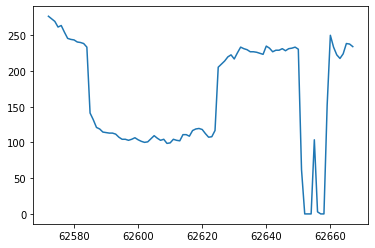

In [982]:
params_test_df.loc[params_test_df['date'] == test_dr_times['potential_dr_dates'][1], 'avg_kW'].plot()

In [966]:
params_test_df.loc[params_test_df['date'] == test_dr_times['potential_dr_dates'][1]+pd.Timedelta('-1 days 00:00:00')]

,avg_kW,interval_end,interval_width,site_id,date
62572,276.48,2017-02-25 00:00:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62573,272.88,2017-02-25 00:15:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62574,269.28,2017-02-25 00:30:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62575,261.36,2017-02-25 00:45:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62576,263.52,2017-02-25 01:00:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62577,254.16,2017-02-25 01:15:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62578,245.52,2017-02-25 01:30:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62579,244.08,2017-02-25 01:45:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62580,243.36,2017-02-25 02:00:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25
62581,240.48,2017-02-25 02:15:00,900.0,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-25


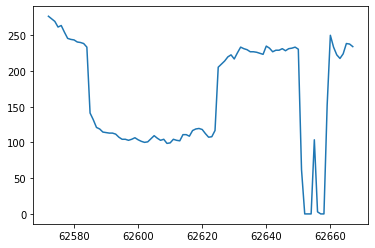

In [962]:
params_test_df.loc[params_test_df['date'] == test_dr_times['potential_dr_dates'][1]+pd.Timedelta('-1 days 00:00:00'), 'avg_kW'].plot()

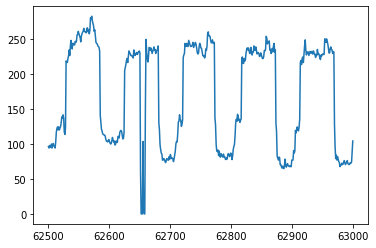

In [961]:
params_test_df['avg_kW'].iloc[62500:63000].plot()

In [969]:
testing_ts_dr['date'] = testing_ts_dr['interval_end'].dt.date

In [970]:
testing_ts_dr.loc[testing_ts_dr['date'] == test_dr_times['potential_dr_dates'][1]+pd.Timedelta('-1 days 00:00:00')]

,avg_kW,interval_end,interval_width,site_id,shifted_interval,shifted_date,shifted_day_of_week,shifted_time_of_day,init_interval_end_time,time_shifted,shifted_dt_time,day_near_base_load,day_near_peak_load,operating,kW_on,date
interval_end,,,,,,,,,,,,,,,,
2017-02-25 00:00:00,276.48,2017-02-25 00:00:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 12:00:00,2017-02-24,4,12:00:00,00:00:00,-1 days +17:00:00,12:00:00,102.06,270.18,1,1,2017-02-25
2017-02-25 00:15:00,272.88,2017-02-25 00:15:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 12:15:00,2017-02-24,4,12:15:00,00:15:00,-1 days +17:00:00,12:15:00,102.06,270.18,1,1,2017-02-25
2017-02-25 00:30:00,269.28,2017-02-25 00:30:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 12:30:00,2017-02-24,4,12:30:00,00:30:00,-1 days +17:00:00,12:30:00,102.06,270.18,1,1,2017-02-25
2017-02-25 00:45:00,261.36,2017-02-25 00:45:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 12:45:00,2017-02-24,4,12:45:00,00:45:00,-1 days +17:00:00,12:45:00,102.06,270.18,1,1,2017-02-25
2017-02-25 01:00:00,263.52,2017-02-25 01:00:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 13:00:00,2017-02-24,4,13:00:00,01:00:00,-1 days +17:00:00,13:00:00,102.06,270.18,1,1,2017-02-25
2017-02-25 01:15:00,254.16,2017-02-25 01:15:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 13:15:00,2017-02-24,4,13:15:00,01:15:00,-1 days +17:00:00,13:15:00,102.06,270.18,1,1,2017-02-25
2017-02-25 01:30:00,245.52,2017-02-25 01:30:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 13:30:00,2017-02-24,4,13:30:00,01:30:00,-1 days +17:00:00,13:30:00,102.06,270.18,1,1,2017-02-25
2017-02-25 01:45:00,244.08,2017-02-25 01:45:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 13:45:00,2017-02-24,4,13:45:00,01:45:00,-1 days +17:00:00,13:45:00,102.06,270.18,1,1,2017-02-25
2017-02-25 02:00:00,243.36,2017-02-25 02:00:00,900,dbea811b-92f8-4e35-432c-9a7d19680a6d,2017-02-24 14:00:00,2017-02-24,4,14:00:00,02:00:00,-1 days +17:00:00,14:00:00,102.06,270.18,1,1,2017-02-25


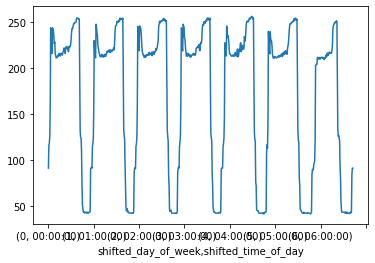

In [814]:
testing_week_dr['avg_kW'].plot()

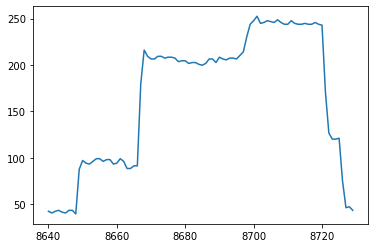

In [821]:
#
# params_test_df['avg_kW'].iloc[8640:8730].plot()

params_test_df['avg_kW'].iloc[8640:8730].plot()

In [791]:
params_test_df['day_of_week'] = params_test_df['interval_end'].dt.dayofweek

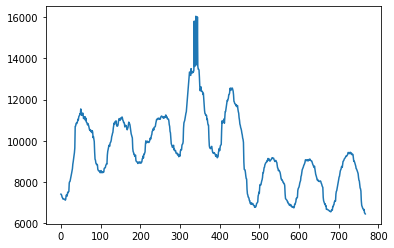

In [793]:
params_test_df['avg_kW'].iloc[0:768].plot()

In [687]:
params_test_ts.head()

,avg_kW,interval_end,interval_width,site_id,shifted_interval,shifted_date,shifted_day_of_week,shifted_time_of_day,init_interval_end_time,time_shifted,shifted_dt_time,day_near_base_load,day_near_peak_load,operating
interval_end,,,,,,,,,,,,,,
2017-09-01 05:00:00,45.12,2017-09-01 05:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 20:00:00,2017-08-31,3,20:00:00,05:00:00,-1 days +20:00:00,20:00:00,41.28,92.88,0
2017-09-01 05:15:00,43.20,2017-09-01 05:15:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 20:15:00,2017-08-31,3,20:15:00,05:15:00,-1 days +20:00:00,20:15:00,41.28,92.88,0
2017-09-01 05:30:00,42.24,2017-09-01 05:30:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 20:30:00,2017-08-31,3,20:30:00,05:30:00,-1 days +20:00:00,20:30:00,41.28,92.88,0
2017-09-01 05:45:00,41.28,2017-09-01 05:45:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 20:45:00,2017-08-31,3,20:45:00,05:45:00,-1 days +20:00:00,20:45:00,41.28,92.88,0
2017-09-01 06:00:00,44.16,2017-09-01 06:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 21:00:00,2017-08-31,3,21:00:00,06:00:00,-1 days +20:00:00,21:00:00,41.28,92.88,0


In [689]:
shift = ops_params['initial_time_shift']+ops_params['dr_time_shift']
shift

Timedelta('-1 days +15:00:00')

In [696]:
test_dr_times_df = pd.DataFrame(test_dr_times, columns=['shifted_potential_dr_times'])
test_dr_times_df['reverted_potential_dr_times'] = test_dr_times_df['shifted_potential_dr_times']-shift
test_dr_times_df['site_id'] = testing_ts_dr['site_id'][0]
test_dr_times_df['potential_dr_dates'] = test_dr_times_df['reverted_potential_dr_times'].dt.date
test_dr_times_df.drop(columns=['shifted_potential_dr_times', 'reverted_potential_dr_times'], inplace=True)
test_dr_times_df.drop_duplicates(inplace=True)
test_dr_times_df

,site_id,potential_dr_dates
0,e7d819a2-4382-e7d1-a267-069c96a54333,2017-11-30
15,e7d819a2-4382-e7d1-a267-069c96a54333,2018-01-01
24,e7d819a2-4382-e7d1-a267-069c96a54333,2018-01-02
34,e7d819a2-4382-e7d1-a267-069c96a54333,2018-01-05


In [670]:
test_dr_times

[Timestamp('2017-11-30 10:15:00'),
 Timestamp('2017-11-30 10:30:00'),
 Timestamp('2017-11-30 10:45:00'),
 Timestamp('2017-11-30 11:00:00'),
 Timestamp('2017-11-30 11:15:00'),
 Timestamp('2017-11-30 11:30:00'),
 Timestamp('2017-11-30 11:45:00'),
 Timestamp('2017-11-30 12:00:00'),
 Timestamp('2017-11-30 12:15:00'),
 Timestamp('2017-11-30 12:30:00'),
 Timestamp('2017-11-30 12:45:00'),
 Timestamp('2017-11-30 13:00:00'),
 Timestamp('2017-11-30 13:15:00'),
 Timestamp('2017-11-30 13:30:00'),
 Timestamp('2017-11-30 13:45:00'),
 Timestamp('2018-01-01 10:15:00'),
 Timestamp('2018-01-01 10:30:00'),
 Timestamp('2018-01-01 10:45:00'),
 Timestamp('2018-01-01 11:00:00'),
 Timestamp('2018-01-01 11:15:00'),
 Timestamp('2018-01-01 11:30:00'),
 Timestamp('2018-01-01 11:45:00'),
 Timestamp('2018-01-01 12:00:00'),
 Timestamp('2018-01-01 12:15:00'),
 Timestamp('2018-01-02 00:15:00'),
 Timestamp('2018-01-02 00:30:00'),
 Timestamp('2018-01-02 00:45:00'),
 Timestamp('2018-01-02 01:00:00'),
 Timestamp('2018-01-

In [667]:
test_dr_times.sort()
test_dr_times

[Timestamp('2017-11-30 10:15:00'),
 Timestamp('2017-11-30 10:30:00'),
 Timestamp('2017-11-30 10:45:00'),
 Timestamp('2017-11-30 11:00:00'),
 Timestamp('2017-11-30 11:15:00'),
 Timestamp('2017-11-30 11:30:00'),
 Timestamp('2017-11-30 11:45:00'),
 Timestamp('2017-11-30 12:00:00'),
 Timestamp('2017-11-30 12:15:00'),
 Timestamp('2017-11-30 12:30:00'),
 Timestamp('2017-11-30 12:45:00'),
 Timestamp('2017-11-30 13:00:00'),
 Timestamp('2017-11-30 13:15:00'),
 Timestamp('2017-11-30 13:30:00'),
 Timestamp('2017-11-30 13:45:00'),
 Timestamp('2018-01-01 10:15:00'),
 Timestamp('2018-01-01 10:30:00'),
 Timestamp('2018-01-01 10:45:00'),
 Timestamp('2018-01-01 11:00:00'),
 Timestamp('2018-01-01 11:15:00'),
 Timestamp('2018-01-01 11:30:00'),
 Timestamp('2018-01-01 11:45:00'),
 Timestamp('2018-01-01 12:00:00'),
 Timestamp('2018-01-01 12:15:00'),
 Timestamp('2018-01-02 00:15:00'),
 Timestamp('2018-01-02 00:30:00'),
 Timestamp('2018-01-02 00:45:00'),
 Timestamp('2018-01-02 01:00:00'),
 Timestamp('2018-01-

In [632]:
wid = str(int(900 / 60))
next_time = [time + pd.Timedelta(f'0 days 00:{wid}:00') for time in test_dr_times]
next_time

[Timestamp('2017-11-30 12:00:00'),
 Timestamp('2017-11-30 11:45:00'),
 Timestamp('2017-11-30 11:30:00'),
 Timestamp('2017-11-30 11:15:00'),
 Timestamp('2017-11-30 11:00:00'),
 Timestamp('2017-11-30 10:45:00'),
 Timestamp('2017-11-30 10:30:00'),
 Timestamp('2017-11-30 10:15:00'),
 Timestamp('2018-01-02 00:45:00'),
 Timestamp('2018-01-02 00:30:00'),
 Timestamp('2018-01-02 00:15:00'),
 Timestamp('2018-01-01 10:30:00'),
 Timestamp('2018-01-01 10:15:00'),
 Timestamp('2018-01-05 00:45:00'),
 Timestamp('2018-01-05 00:30:00')]

In [628]:
set(test_dr_times+next_time)

{Timestamp('2017-11-30 10:00:00'),
 Timestamp('2017-11-30 10:15:00'),
 Timestamp('2017-11-30 10:30:00'),
 Timestamp('2017-11-30 10:45:00'),
 Timestamp('2017-11-30 11:00:00'),
 Timestamp('2017-11-30 11:15:00'),
 Timestamp('2017-11-30 11:30:00'),
 Timestamp('2017-11-30 11:45:00'),
 Timestamp('2017-11-30 12:00:00'),
 Timestamp('2018-01-01 10:00:00'),
 Timestamp('2018-01-01 10:15:00'),
 Timestamp('2018-01-01 10:30:00'),
 Timestamp('2018-01-02 00:00:00'),
 Timestamp('2018-01-02 00:15:00'),
 Timestamp('2018-01-02 00:30:00'),
 Timestamp('2018-01-02 00:45:00'),
 Timestamp('2018-01-05 00:15:00'),
 Timestamp('2018-01-05 00:30:00'),
 Timestamp('2018-01-05 00:45:00')}

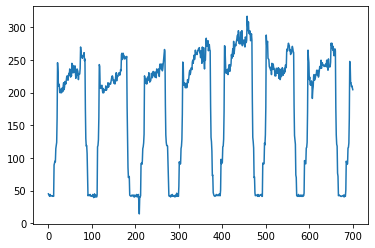

In [462]:
params_test_df.loc[0:700, 'avg_kW'].plot()

In [465]:
params_test_df.head()

,avg_kW,interval_end,interval_width,site_id
0,45.12,2017-09-01 05:00:00,900.0,e7d819a2-4382-e7d1-a267-069c96a54333
1,43.20,2017-09-01 05:15:00,900.0,e7d819a2-4382-e7d1-a267-069c96a54333
2,42.24,2017-09-01 05:30:00,900.0,e7d819a2-4382-e7d1-a267-069c96a54333
3,41.28,2017-09-01 05:45:00,900.0,e7d819a2-4382-e7d1-a267-069c96a54333
4,44.16,2017-09-01 06:00:00,900.0,e7d819a2-4382-e7d1-a267-069c96a54333


In [466]:
params_test_ts.head()

,avg_kW,interval_end,interval_width,site_id,shifted_interval,shifted_date,shifted_day_of_week,shifted_time_of_day,init_interval_end_time,time_shifted,shifted_dt_time,day_near_base_load,day_near_peak_load,operating
interval_end,,,,,,,,,,,,,,
2017-09-01 05:00:00,45.12,2017-09-01 05:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 20:00:00,2017-08-31,3,20:00:00,05:00:00,-1 days +20:00:00,20:00:00,41.28,92.88,0
2017-09-01 05:15:00,43.20,2017-09-01 05:15:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 20:15:00,2017-08-31,3,20:15:00,05:15:00,-1 days +20:00:00,20:15:00,41.28,92.88,0
2017-09-01 05:30:00,42.24,2017-09-01 05:30:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 20:30:00,2017-08-31,3,20:30:00,05:30:00,-1 days +20:00:00,20:30:00,41.28,92.88,0
2017-09-01 05:45:00,41.28,2017-09-01 05:45:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 20:45:00,2017-08-31,3,20:45:00,05:45:00,-1 days +20:00:00,20:45:00,41.28,92.88,0
2017-09-01 06:00:00,44.16,2017-09-01 06:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-08-31 21:00:00,2017-08-31,3,21:00:00,06:00:00,-1 days +20:00:00,21:00:00,41.28,92.88,0


In [589]:
grouped = testing_ts_dr.groupby(by=['shifted_date'])
test_group = grouped.get_group(pd.Timestamp('2017-09-04'))
test_group.head()

,avg_kW,interval_end,interval_width,site_id,shifted_interval,shifted_date,shifted_day_of_week,shifted_time_of_day,init_interval_end_time,time_shifted,shifted_dt_time,day_near_base_load,day_near_peak_load,operating,doy_near_base,doy_near_peak,kW_delta_to_base,kW_delta_to_peak,kW_closer_to_peak
interval_end,,,,,,,,,,,,,,,,,,,
2017-09-04 10:00:00,167.04,2017-09-04 10:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 01:00:00,2017-09-04,0,01:00:00,10:00:00,-1 days +20:00:00,01:00:00,42.24,270.96,1,43.2,253.44,123.84,86.40,1
2017-09-04 10:15:00,246.72,2017-09-04 10:15:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 01:15:00,2017-09-04,0,01:15:00,10:15:00,-1 days +20:00:00,01:15:00,42.24,270.96,1,43.2,253.44,203.52,6.72,1
2017-09-04 10:30:00,244.80,2017-09-04 10:30:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 01:30:00,2017-09-04,0,01:30:00,10:30:00,-1 days +20:00:00,01:30:00,42.24,270.96,1,43.2,253.44,201.60,8.64,1
2017-09-04 10:45:00,213.12,2017-09-04 10:45:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 01:45:00,2017-09-04,0,01:45:00,10:45:00,-1 days +20:00:00,01:45:00,42.24,270.96,1,43.2,253.44,169.92,40.32,1
2017-09-04 11:00:00,211.20,2017-09-04 11:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 02:00:00,2017-09-04,0,02:00:00,11:00:00,-1 days +20:00:00,02:00:00,42.24,270.96,1,43.2,253.44,168.00,42.24,1


In [604]:
test_roll = test_group.loc[::-1,'kW_closer_to_peak'].rolling(window=8,
                                                    min_periods=8,
                                                    closed='both').apply(lambda x: sum(x))
test_roll

interval_end
2017-09-05 02:15:00    NaN
2017-09-05 02:00:00    NaN
2017-09-05 01:45:00    NaN
2017-09-05 01:30:00    NaN
2017-09-05 01:15:00    NaN
2017-09-05 01:00:00    NaN
2017-09-05 00:45:00    NaN
2017-09-05 00:30:00    8.0
2017-09-05 00:15:00    8.0
2017-09-05 00:00:00    8.0
2017-09-04 23:45:00    8.0
2017-09-04 23:30:00    8.0
2017-09-04 23:15:00    8.0
2017-09-04 23:00:00    8.0
2017-09-04 22:45:00    8.0
2017-09-04 22:30:00    8.0
2017-09-04 22:15:00    8.0
2017-09-04 22:00:00    8.0
2017-09-04 21:45:00    8.0
2017-09-04 21:30:00    8.0
2017-09-04 21:15:00    8.0
2017-09-04 21:00:00    8.0
2017-09-04 20:45:00    8.0
2017-09-04 20:30:00    8.0
2017-09-04 20:15:00    8.0
2017-09-04 20:00:00    8.0
2017-09-04 19:45:00    8.0
2017-09-04 19:30:00    8.0
2017-09-04 19:15:00    8.0
2017-09-04 19:00:00    8.0
2017-09-04 18:45:00    8.0
2017-09-04 18:30:00    8.0
2017-09-04 18:15:00    8.0
2017-09-04 18:00:00    8.0
2017-09-04 17:45:00    8.0
2017-09-04 17:30:00    8.0
2017-09-04 17:1

In [609]:
test_roll.iloc[::-1].index

DatetimeIndex(['2017-09-04 10:00:00', '2017-09-04 10:15:00',
               '2017-09-04 10:30:00', '2017-09-04 10:45:00',
               '2017-09-04 11:00:00', '2017-09-04 11:15:00',
               '2017-09-04 11:30:00', '2017-09-04 11:45:00',
               '2017-09-04 12:00:00', '2017-09-04 12:15:00',
               '2017-09-04 12:30:00', '2017-09-04 12:45:00',
               '2017-09-04 13:00:00', '2017-09-04 13:15:00',
               '2017-09-04 13:30:00', '2017-09-04 13:45:00',
               '2017-09-04 14:00:00', '2017-09-04 14:15:00',
               '2017-09-04 14:30:00', '2017-09-04 14:45:00',
               '2017-09-04 15:00:00', '2017-09-04 15:15:00',
               '2017-09-04 15:30:00', '2017-09-04 15:45:00',
               '2017-09-04 16:00:00', '2017-09-04 16:15:00',
               '2017-09-04 16:30:00', '2017-09-04 16:45:00',
               '2017-09-04 17:00:00', '2017-09-04 17:15:00',
               '2017-09-04 17:30:00', '2017-09-04 17:45:00',
               '2017-09-

In [608]:
test_roll.iloc[::-1].values

array([ 8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,
        8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,
        8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,
        8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,  8.,
        8.,  8.,  8.,  8.,  8.,  8.,  8., nan, nan, nan, nan, nan, nan,
       nan])

In [473]:
df = grouped.get_group(0)
test_dt_times = pd.to_datetime(df['shifted_time_of_day']).dt.time
df_sub = df.loc[(test_dt_times >= ops_params['high_start_0'])
       & (test_dt_times <= ops_params['high_stop_0'])]

In [474]:
df_sub_grouped = df_sub.groupby(by=['shifted_date'])

In [478]:
for name, group in df_sub_grouped:
    print(name, type(name))

2017-09-04 <class 'datetime.date'>
2017-09-11 <class 'datetime.date'>
2017-09-18 <class 'datetime.date'>
2017-09-25 <class 'datetime.date'>
2017-10-02 <class 'datetime.date'>
2017-10-09 <class 'datetime.date'>
2017-10-16 <class 'datetime.date'>
2017-10-23 <class 'datetime.date'>
2017-10-30 <class 'datetime.date'>
2017-11-06 <class 'datetime.date'>
2017-11-13 <class 'datetime.date'>
2017-11-20 <class 'datetime.date'>
2017-11-27 <class 'datetime.date'>
2017-12-04 <class 'datetime.date'>
2017-12-11 <class 'datetime.date'>
2017-12-18 <class 'datetime.date'>
2018-01-01 <class 'datetime.date'>
2018-01-08 <class 'datetime.date'>
2018-01-15 <class 'datetime.date'>
2018-01-22 <class 'datetime.date'>
2018-01-29 <class 'datetime.date'>
2018-02-05 <class 'datetime.date'>
2018-02-12 <class 'datetime.date'>
2018-02-19 <class 'datetime.date'>
2018-02-26 <class 'datetime.date'>
2018-03-05 <class 'datetime.date'>
2018-03-12 <class 'datetime.date'>
2018-03-19 <class 'datetime.date'>
2018-03-26 <class 'd

In [493]:
a = pd.Timestamp('2017-09-04')
# a = datetime.strptime(a, '%Y-%m-%d').date
print(a)
df_sub_grouped.get_group(a)

2017-09-04 00:00:00


,avg_kW,interval_end,interval_width,site_id,shifted_interval,shifted_date,shifted_day_of_week,shifted_time_of_day,init_interval_end_time,time_shifted,shifted_dt_time,day_near_base_load,day_near_peak_load,operating
interval_end,,,,,,,,,,,,,,
2017-09-04 10:00:00,167.04,2017-09-04 10:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 01:00:00,2017-09-04,0,01:00:00,10:00:00,-1 days +20:00:00,01:00:00,42.24,270.96,1
2017-09-04 10:15:00,246.72,2017-09-04 10:15:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 01:15:00,2017-09-04,0,01:15:00,10:15:00,-1 days +20:00:00,01:15:00,42.24,270.96,1
2017-09-04 10:30:00,244.80,2017-09-04 10:30:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 01:30:00,2017-09-04,0,01:30:00,10:30:00,-1 days +20:00:00,01:30:00,42.24,270.96,1
2017-09-04 10:45:00,213.12,2017-09-04 10:45:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 01:45:00,2017-09-04,0,01:45:00,10:45:00,-1 days +20:00:00,01:45:00,42.24,270.96,1
2017-09-04 11:00:00,211.20,2017-09-04 11:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 02:00:00,2017-09-04,0,02:00:00,11:00:00,-1 days +20:00:00,02:00:00,42.24,270.96,1
2017-09-04 11:15:00,215.04,2017-09-04 11:15:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 02:15:00,2017-09-04,0,02:15:00,11:15:00,-1 days +20:00:00,02:15:00,42.24,270.96,1
2017-09-04 11:30:00,210.24,2017-09-04 11:30:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 02:30:00,2017-09-04,0,02:30:00,11:30:00,-1 days +20:00:00,02:30:00,42.24,270.96,1
2017-09-04 11:45:00,207.36,2017-09-04 11:45:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 02:45:00,2017-09-04,0,02:45:00,11:45:00,-1 days +20:00:00,02:45:00,42.24,270.96,1
2017-09-04 12:00:00,210.24,2017-09-04 12:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-04 03:00:00,2017-09-04,0,03:00:00,12:00:00,-1 days +20:00:00,03:00:00,42.24,270.96,1


In [471]:
testing_ts_dr.head()

,avg_kW,interval_end,interval_width,site_id,shifted_interval,shifted_date,shifted_day_of_week,shifted_time_of_day,init_interval_end_time,time_shifted,shifted_dt_time,day_near_base_load,day_near_peak_load,operating
interval_end,,,,,,,,,,,,,,
2017-09-01 09:00:00,94.08,2017-09-01 09:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-01 00:00:00,2017-09-01,4,00:00:00,09:00:00,-1 days +20:00:00,00:00:00,41.28,255.6,1
2017-09-01 09:15:00,114.24,2017-09-01 09:15:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-01 00:15:00,2017-09-01,4,00:15:00,09:15:00,-1 days +20:00:00,00:15:00,41.28,255.6,1
2017-09-01 09:30:00,119.04,2017-09-01 09:30:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-01 00:30:00,2017-09-01,4,00:30:00,09:30:00,-1 days +20:00:00,00:30:00,41.28,255.6,1
2017-09-01 09:45:00,123.84,2017-09-01 09:45:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-01 00:45:00,2017-09-01,4,00:45:00,09:45:00,-1 days +20:00:00,00:45:00,41.28,255.6,1
2017-09-01 10:00:00,161.28,2017-09-01 10:00:00,900,e7d819a2-4382-e7d1-a267-069c96a54333,2017-09-01 01:00:00,2017-09-01,4,01:00:00,10:00:00,-1 days +20:00:00,01:00:00,41.28,255.6,1


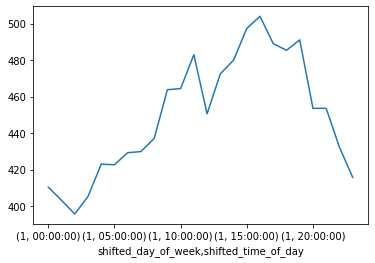

In [453]:
params_test_week['avg_kW'].plot()

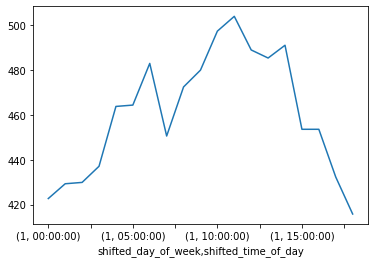

In [454]:
testing_week_dr['avg_kW'].plot()

In [455]:
testing_week_dr.head(96)

avg_kW      time_shifted  \
shifted_day_of_week shifted_time_of_day                             
1                   00:00:00              422.7 -1 days +19:00:00   
                    01:00:00              429.3 -1 days +19:00:00   
                    02:00:00              429.9 -1 days +19:00:00   
                    03:00:00              437.1 -1 days +19:00:00   
                    04:00:00              463.8 -1 days +19:00:00   
                    05:00:00              464.4 -1 days +19:00:00   
                    06:00:00              483.0 -1 days +19:00:00   
                    07:00:00              450.6 -1 days +19:00:00   
                    08:00:00              472.5 -1 days +19:00:00   
                    09:00:00              480.0 -1 days +19:00:00   
                    10:00:00              497.4 -1 days +19:00:00   
                    11:00:00              504.0 -1 days +19:00:00   
                    12:00:00              489.0 -1 days +19:00:00   
                    13:00:00              485.4 -1 days +19:00:00   
                    14:00:00              491.1 -1 days +19:00:00   
                    15:00:00              453.6 -1 days +19:00:00   
                    16:00:00              453.6 -1 days +19:00:00   
                    17:00:00              432.3 -1 days +19:00:00   
                    18:00:00              415.8 -1 days +19:00:00   

                                         imputed_interval_width  base_load  \
shifted_day_of_week shifted_time_of_day                                      
1                   00:00:00                             3600.0     429.72   
                    01:00:00                             3600.0     429.72   
                    02:00:00                             3600.0     429.72   
                    03:00:00                             3600.0     429.72   
                    04:00:00                             3600.0     429.72   
                    05:00:00                             3600.0     429.72   
                    06:00:00                             3600.0     429.72   
                    07:00:00                             3600.0     429.72   
                    08:00:00                             3600.0     429.72   
                    09:00:00                             3600.0     429.72   
                    10:00:00                             3600.0     429.72   
                    11:00:00                             3600.0     429.72   
                    12:00:00                             3600.0     429.72   
                    13:00:00                             3600.0     429.72   
                    14:00:00                             3600.0     429.72   
                    15:00:00                             3600.0     429.72   
                    16:00:00                             3600.0     429.72   
                    17:00:00                             3600.0     429.72   
                    18:00:00                             3600.0     429.72   

                                         near_base_load  near_peak_load  \
shifted_day_of_week shifted_time_of_day                                   
1                   00:00:00                     422.01          498.06   
                    01:00:00                     422.01          498.06   
                    02:00:00                     422.01          498.06   
                    03:00:00                     422.01          498.06   
                    04:00:00                     422.01          498.06   
                    05:00:00                     422.01          498.06   
                    06:00:00                     422.01          498.06   
                    07:00:00                     422.01          498.06   
                    08:00:00                     422.01          498.06   
                    09:00:00                     422.01          498.06   
                    10:00:00                     422

In [688]:
ops_params

{'interval_width': 900.0,
 'initial_time_shift': Timedelta('-1 days +19:00:00'),
 'base_load_0': 43.440000000000005,
 'near_base_load_0': 43.2,
 'near_peak_load_0': 253.44,
 'ref_peak': 254.4,
 'ref_base': 42.24,
 'base_load_1': 45.0,
 'near_base_load_1': 42.24,
 'near_peak_load_1': 253.07999999999998,
 'base_load_2': 44.4,
 'near_base_load_2': 42.24,
 'near_peak_load_2': 252.0,
 'base_load_3': 43.440000000000005,
 'near_base_load_3': 42.24,
 'near_peak_load_3': 252.71999999999997,
 'base_load_4': 43.2,
 'near_base_load_4': 42.24,
 'near_peak_load_4': 254.4,
 'base_load_5': 42.84,
 'near_base_load_5': 42.24,
 'near_peak_load_5': 252.24,
 'base_load_6': 43.2,
 'near_base_load_6': 42.24,
 'near_peak_load_6': 248.88,
 'continuous': 0,
 'dayofweek_0': 1,
 'dayofweek_1': 1,
 'dayofweek_2': 1,
 'dayofweek_3': 1,
 'dayofweek_4': 1,
 'dayofweek_5': 1,
 'dayofweek_6': 1,
 'p_value': 3.6089430204780977e-20,
 'on_off_threshold': 94.11857142857141,
 'initial_shifted_daily_start': '04:00:00',
 'ini

In [65]:
type(testing_ts['dt_time'][0])

datetime.time

In [68]:
testing_ts.loc[testing_ts['dt_time'] > testing_ops_params['high_start']].head(100)

,avg_kW,interval_end,interval_width,site_id,shifted_interval,date,day_of_week,time_of_day,dt_time,day_near_base_load,day_near_peak_load,operating
interval_end,,,,,,,,,,,,
2015-05-15 13:15:00,9279.36,2015-05-15 13:15:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 08:15:00,2015-05-15,4,08:15:00,08:15:00,7171.20,11283.84,1
2015-05-15 13:30:00,9417.60,2015-05-15 13:30:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 08:30:00,2015-05-15,4,08:30:00,08:30:00,7171.20,11283.84,1
2015-05-15 13:45:00,9650.88,2015-05-15 13:45:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 08:45:00,2015-05-15,4,08:45:00,08:45:00,7171.20,11283.84,1
2015-05-15 14:00:00,10696.32,2015-05-15 14:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 09:00:00,2015-05-15,4,09:00:00,09:00:00,7171.20,11283.84,1
2015-05-15 14:15:00,10704.96,2015-05-15 14:15:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 09:15:00,2015-05-15,4,09:15:00,09:15:00,7171.20,11283.84,1
2015-05-15 14:30:00,10817.28,2015-05-15 14:30:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 09:30:00,2015-05-15,4,09:30:00,09:30:00,7171.20,11283.84,1
2015-05-15 14:45:00,10860.48,2015-05-15 14:45:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 09:45:00,2015-05-15,4,09:45:00,09:45:00,7171.20,11283.84,1
2015-05-15 15:00:00,10834.56,2015-05-15 15:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 10:00:00,2015-05-15,4,10:00:00,10:00:00,7171.20,11283.84,1
2015-05-15 15:15:00,10895.04,2015-05-15 15:15:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 10:15:00,2015-05-15,4,10:15:00,10:15:00,7171.20,11283.84,1


In [570]:
testing_ts = operating_day_identifier(testing_ts, testing_updated_ops_data)

In [539]:
testing_ts.head(100)

,avg_kW,interval_end,interval_width,site_id,shifted_interval,date,day_of_week,time_of_day,time,day_near_base_load,day_near_peak_load,operating
interval_end,,,,,,,,,,,,
2015-05-16 00:00:00,10437.12,2015-05-16 00:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 19:00:00,2015-05-16,4,19:00:00,00:00:00,8484.48,11070.00,1
2015-05-16 00:15:00,10497.60,2015-05-16 00:15:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 19:15:00,2015-05-16,4,19:15:00,00:15:00,8484.48,11070.00,1
2015-05-16 00:30:00,10393.92,2015-05-16 00:30:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 19:30:00,2015-05-16,4,19:30:00,00:30:00,8484.48,11070.00,1
2015-05-16 00:45:00,10488.96,2015-05-16 00:45:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 19:45:00,2015-05-16,4,19:45:00,00:45:00,8484.48,11070.00,1
2015-05-16 01:00:00,10419.84,2015-05-16 01:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 20:00:00,2015-05-16,4,20:00:00,01:00:00,8484.48,11070.00,1
2015-05-16 01:15:00,10152.00,2015-05-16 01:15:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 20:15:00,2015-05-16,4,20:15:00,01:15:00,8484.48,11070.00,1
2015-05-16 01:30:00,10203.84,2015-05-16 01:30:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 20:30:00,2015-05-16,4,20:30:00,01:30:00,8484.48,11070.00,1
2015-05-16 01:45:00,10074.24,2015-05-16 01:45:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 20:45:00,2015-05-16,4,20:45:00,01:45:00,8484.48,11070.00,1
2015-05-16 02:00:00,9961.92,2015-05-16 02:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6,2015-05-15 21:00:00,2015-05-16,4,21:00:00,02:00:00,8484.48,11070.00,1


In [106]:
def site_operating_status(site_data_df, site_id_list):
    """
    Given site-level Average kW time series', categorize the sites as 
    operating continuously or not, determine daily start/stop if
    not continuously operating, and produce various other load profile
    parameters in the form of a dataframe where each row has information
    for a given site.
    """
    ops_data = pd.DataFrame()
    ops_params = {}
    for site in site_id_list:
        print(site)
        working_df = site_data_df.loc[site_data_df['site_id'] == site].copy()
        working_df.reset_index(inplace=True, drop=True)
        width = working_df['interval_width'].mean()
        if width.is_integer():
            working_ts = working_df.set_index('interval_end', drop=False)
            working_ts.dropna(inplace=True)
        else:
            working_ts = hourly_resample(working_df, site)
        # at least one example was found where hourly data had a 15-minute interval length
        # so interval width is being calculated based on interval timestamps
        width = working_df['interval_end'].iloc[1] - working_df['interval_end'].iloc[0]
        width = width.total_seconds()
        working_df.loc[:, 'interval_width'] = width
        ops_params.update({'interval_width': width})
        # creating a weekly time series made up of the median for each time period
        working_week = aggregate_week_ts(working_ts, ops_params)
        # calculating near_peak_load and near_base_load parameters
        # as well as reference parameter variables for evaluating operating days
        working_week, ops_params = week_load_profile_params(working_week, ops_params)
        days_index = working_week.index.get_level_values(0).unique()
        ops_params = agg_week_operating_day(working_week,
                                            days_index,
                                            ops_params,
                                            p_threshold=0.05)
        # calculating the start/stop times of a typical operating day
        working_day, ops_params = operating_start_stop(working_week, ops_params)
        site_ops_data = pd.DataFrame(ops_params, index=[site])
        ops_data = pd.concat([ops_data, site_ops_data])
        
    return ops_data   
#     return ops_data[['continuous', 'daily_start', 'daily_stop']]

In [107]:
test_ops_data = site_operating_status(all_data_df, site_list)

35f1db19-ab26-7f30-3451-971f053712f6
a05598bc-59ac-6697-0673-0e87e7ccc677
b8ec0850-c5ce-1579-5438-8d1247f0ff16
b9ad1c9b-fbe2-f36f-ab2a-6894c251433f
61ff3699-aad4-35d3-4ecb-b8195e8b08cd
c388dd30-eaeb-dcfe-f76e-e2e6ebf83ce1
5fe94934-6a5f-af51-9794-5b881e7adf19
6f245a0a-eff7-e9fe-bb95-8d0270a775cf
35d54699-97cc-50f2-6d5c-5d50607e9631
327d1cc1-bf53-33f9-7374-184b3c7838ad
d1668f39-1f93-e186-9d6c-acb8ba6567e4
a31524b6-60b5-5928-887b-263b5cb59c23
cc250a40-4b23-6077-95f5-e207d3ddcf42
fb203000-0b6e-e587-0168-25b53c60a153
0644edc0-0417-d12c-b3cb-505bc2e3e258
adeeddca-5043-9a55-278a-db8b50518baa
8c5573ab-4066-3a42-8b0b-2b9dba5533a8
97a1a970-21c0-c946-f82b-e1b58b530cc3
e1936d00-255f-5073-fe4a-c0db2543150e
dbea811b-92f8-4e35-432c-9a7d19680a6d
678558e3-3fd0-d054-e17f-f0defcb52c12
591c3ec2-5ab5-f4fb-318d-4f46fc4d850d
c1cb8652-f39a-189e-25cf-7d6313a9b01f
7b59d921-c882-0ca0-7f89-fb8d60362225
72f8bc16-6c01-b9f1-b89d-8c38c11f0046
3dc26230-5764-4f78-4bbe-b7fa0557b7e8
f2f57d71-344e-adda-6441-3b7d6620dd40
0

b39a02a0-5140-464d-ee95-e45023c05d8d
871fe49b-fe9e-b4f9-dbef-5054703fcd68
46ad5df5-ae69-be7e-cc46-9c02132e204a
a83e1a23-bef7-4772-76ff-b72a3e64726c
c0727430-6446-4ab2-9719-21fad5f6aaf3
5aed4954-460d-a724-04bc-522537a29698
7d167b7b-2871-1c6d-a474-8accad23bb94
318467ad-e593-a20a-fe23-daf9998cc991
ac00b847-21c9-f9d2-2c28-9e28b8a33bf5
5961e490-81ba-c338-86cd-ad5c7919ee60
281e2b26-89bc-2a2c-f5b7-322f942d139d
0bebeb97-fddb-c886-3899-5d221e89b86a
6ba0dc29-c307-1388-1637-85349f4e0309
34816db2-ed2c-16d6-8416-b3849f02e9eb
12e61d30-25f9-16f9-7cfc-c9221a766def
97637050-75e4-51c5-bace-70b9b45dff87
5ef5bf80-7c47-1b7a-78d8-6d8a195577f6
c24f74e9-aa99-2b51-7679-dd1b0ef5adc9
989da191-fdc5-2eee-2cc9-ad35a0bbb863
39138f01-5443-f532-6462-736c6dcc10e8
67558069-06d2-2b8a-e0a8-18cc5444c287
6f493bda-5d1e-6dac-2438-2f79d51b7c6e
f1fc624e-00ad-2e4a-4e6b-0a3391a90fdf
21e4f4d5-363b-14bd-a730-9d435d74d606
bb055294-2785-65c5-d0c3-682d88f20e03
ebe99dd0-da49-66b2-cd2e-e79dab5e45c5
71cd23cb-cf0c-1c17-8bee-3d5e0eaf60f2
2

In [108]:
test_ops_data.head()

,interval_width,ref_peak,ref_base,continuous,dayofweek_0,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,dayofweek_6,p_value,daily_start,daily_stop
35f1db19-ab26-7f30-3451-971f053712f6,900.0,11168.280,7333.200,0,1.0,1,1.0,1.0,1.0,1.0,1.0,2.770465e-04,10:45:00,03:00:00
a05598bc-59ac-6697-0673-0e87e7ccc677,900.0,789.750,375.075,0,0.0,1,1.0,1.0,1.0,1.0,0.0,2.105606e-02,06:30:00,00:45:00
b8ec0850-c5ce-1579-5438-8d1247f0ff16,3600.0,335.300,65.450,0,1.0,1,1.0,1.0,1.0,1.0,1.0,1.196665e-06,10:00:00,03:00:00
b9ad1c9b-fbe2-f36f-ab2a-6894c251433f,900.0,50.240,20.920,0,1.0,1,1.0,1.0,1.0,NaN,NaN,3.173697e-06,14:30:00,08:00:00
61ff3699-aad4-35d3-4ecb-b8195e8b08cd,900.0,506.925,354.675,0,1.0,1,1.0,1.0,1.0,1.0,1.0,8.507204e-15,10:00:00,02:45:00


In [109]:
# final p-value = 0.05 with dropping min/max
test_ops_data.loc[test_ops_data['continuous'] == 1]

,interval_width,ref_peak,ref_base,continuous,dayofweek_0,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,dayofweek_6,p_value,daily_start,daily_stop
adeeddca-5043-9a55-278a-db8b50518baa,900.0,91152.000,62208.000,1,0.0,1,1.0,1.0,1.0,1.0,1.0,0.054335,NaN,NaN
e7ef7c8f-7d80-c0ca-03fe-9c0f220c3d7f,3600.0,1215.475,276.965,1,1.0,1,1.0,1.0,1.0,0.0,1.0,0.348792,NaN,NaN
f68751c2-aae5-2ea4-7b25-7d915b03307d,3600.0,80.448,4.080,1,1.0,0,0.0,0.0,0.0,0.0,0.0,0.363217,NaN,NaN
9aa3b5ad-0981-1a44-d58d-e3f2d1f2d550,900.0,5020.200,302.400,1,1.0,1,1.0,1.0,1.0,0.0,0.0,0.161729,NaN,NaN
6ba0dc29-c307-1388-1637-85349f4e0309,900.0,1555.200,721.440,1,0.0,0,0.0,0.0,0.0,1.0,1.0,0.111559,NaN,NaN


In [432]:
# final p-value = 0.05
test_ops_data.loc[test_ops_data['continuous'] == 1]

,continuous,daily_start,daily_stop
e7ef7c8f-7d80-c0ca-03fe-9c0f220c3d7f,1,NaN,NaN
f68751c2-aae5-2ea4-7b25-7d915b03307d,1,NaN,NaN
9aa3b5ad-0981-1a44-d58d-e3f2d1f2d550,1,NaN,NaN
6ba0dc29-c307-1388-1637-85349f4e0309,1,NaN,NaN
15790985-7b3c-8665-72be-4a829cd30c03,1,NaN,NaN


In [319]:
# pre-time_shift
test_ops_data

,continuous,daily_start,daily_stop
35f1db19-ab26-7f30-3451-971f053712f6,0,06:00:00,22:00:00
a05598bc-59ac-6697-0673-0e87e7ccc677,0,01:30:00,19:30:00
b8ec0850-c5ce-1579-5438-8d1247f0ff16,0,06:00:00,22:00:00
b9ad1c9b-fbe2-f36f-ab2a-6894c251433f,0,07:30:00,00:45:00
61ff3699-aad4-35d3-4ecb-b8195e8b08cd,0,05:15:00,21:45:00
...,...,...,...
debc4593-d7e7-c1ae-f268-f6944c531e3f,0,05:30:00,20:00:00
8a2629e5-183b-05c3-7544-5ac89ee3c347,0,05:15:00,09:30:00
811effd3-85a7-f36f-5eeb-cb38de38d5ac,0,07:45:00,22:00:00
a85566bd-7cea-eb51-6aa5-912ee6bdd7d7,0,05:15:00,21:15:00


In [250]:
# p = 0.04 double checked correctly
test_ops_data.loc[test_ops_data['continuous'] == 1].sort_values('p_value')

,continuous,dayofweek_0,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,dayofweek_6,p_value
f771d6db-d64e-2ff2-f50d-47be0ad31b9c,1,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.048835
15790985-7b3c-8665-72be-4a829cd30c03,1,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.065701
6ba0dc29-c307-1388-1637-85349f4e0309,1,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.111559
9aa3b5ad-0981-1a44-d58d-e3f2d1f2d550,1,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.161729
f68751c2-aae5-2ea4-7b25-7d915b03307d,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.242728
e7ef7c8f-7d80-c0ca-03fe-9c0f220c3d7f,1,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.348792
0101ee7c-a0ef-7b94-f62b-594142c8b0e6,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9fe91411-9092-2ce4-aabc-dd3c6868d50a,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7e03e2ca-18ed-5eb8-15d9-d56ad7d89634,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
07ae0994-02e6-2b53-051f-609e8d9efa1e,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [245]:
# original test
# 811effd3-85a7-f36f-5eeb-cb38de38d5ac

# continuous 6-day
# appears to operate 5-days a week,
# but late spike on perceived Sunday night makes that day seem like an operating day
# unclear why it wasn't characterized like this in the mass processed version
# e7ef7c8f-7d80-c0ca-03fe-9c0f220c3d7f

# continuous 7-day
# has mostly low load with short periods of high usage,
# causing problems with using median
# f68751c2-aae5-2ea4-7b25-7d915b03307d

# continuous 0-day
# seems like a 
# 9aa3b5ad-0981-1a44-d58d-e3f2d1f2d550

# unexpected nans
# fixed
# 591c3ec2-5ab5-f4fb-318d-4f46fc4d850d

# scipy invalid
# lots of very small values with little variance
# causes all medians to be the same
# 9fe91411-9092-2ce4-aabc-dd3c6868d50a

# daily being flagged as continuous
# d082397d-d743-fcf5-b536-762d9c7f4a35

temp_df = pd.read_sql_query("""SELECT "kWh"*(3600./interval_width) as "avg_kW", interval_end, interval_width, site_id from intervals where site_id='35f1db19-ab26-7f30-3451-971f053712f6' order by interval_end asc;""", conn)
temp_df

,avg_kW,interval_end,interval_width,site_id
0,7413.12,2015-05-15 05:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6
1,7395.84,2015-05-15 05:15:00,900,35f1db19-ab26-7f30-3451-971f053712f6
2,7344.00,2015-05-15 05:30:00,900,35f1db19-ab26-7f30-3451-971f053712f6
3,7266.24,2015-05-15 05:45:00,900,35f1db19-ab26-7f30-3451-971f053712f6
4,7240.32,2015-05-15 06:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6
...,...,...,...,...
118840,11162.88,2018-10-04 03:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6
118841,10808.64,2018-10-04 03:15:00,900,35f1db19-ab26-7f30-3451-971f053712f6
118842,10834.56,2018-10-04 03:30:00,900,35f1db19-ab26-7f30-3451-971f053712f6
118843,10696.32,2018-10-04 03:45:00,900,35f1db19-ab26-7f30-3451-971f053712f6


In [246]:
temp_week = aggregate_week_ts(temp_df)
temp_week = week_load_profile_params(temp_week)
ref_peak = temp_week['near_peak_load'].max()
print(ref_peak)
ref_base = temp_week['near_base_load'].min()
print(ref_base)
days_index = temp_week.index.get_level_values(0).unique()
ops_params = agg_week_operating_day(temp_week, days_index, ref_peak, ref_base, p_threshold=0.04)

11168.280000000002
7333.2
[]
[] []


In [324]:
reset_week = temp_week.reset_index()
reset_week['time_shifted'][0]

Timedelta('-1 days +19:00:00')

In [326]:
all_data_df.loc[all_data_df['site_id'] == '35f1db19-ab26-7f30-3451-971f053712f6'].head()

,avg_kW,interval_end,interval_width,site_id
3816858,7413.12,2015-05-15 05:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6
3816859,7395.84,2015-05-15 05:15:00,900,35f1db19-ab26-7f30-3451-971f053712f6
3816860,7344.00,2015-05-15 05:30:00,900,35f1db19-ab26-7f30-3451-971f053712f6
3816861,7266.24,2015-05-15 05:45:00,900,35f1db19-ab26-7f30-3451-971f053712f6
3816862,7240.32,2015-05-15 06:00:00,900,35f1db19-ab26-7f30-3451-971f053712f6


In [328]:
aggregate_week_ts(temp_df).head()

avg_kW      time_shifted  imputed_interval_width
day_of_week time_of_day                                                   
0           00:00:00     7862.40 -1 days +19:00:00                   900.0
            00:15:00     7819.20 -1 days +19:00:00                   900.0
            00:30:00     7810.56 -1 days +19:00:00                   900.0
            00:45:00     7715.52 -1 days +19:00:00                   900.0
            01:00:00     7724.16 -1 days +19:00:00                   900.0

In [334]:
pd.to_datetime(aggregate_week_ts(temp_df).index[0][1])-reset_week['time_shifted'][0]

Timestamp('2020-02-20 05:00:00')

In [261]:
ops_params

{'continuous': 0,
 'dayofweek_0': 1,
 'dayofweek_1': 1,
 'dayofweek_2': 1,
 'dayofweek_3': 1,
 'dayofweek_4': 1,
 'dayofweek_5': 1,
 'dayofweek_6': 1,
 'p_value': 4.154708774291556e-05}

In [266]:
keys = ['dayofweek_0', 'dayofweek_1', 'dayofweek_2',
        'dayofweek_3', 'dayofweek_4', 'dayofweek_5', 'dayofweek_6']
operating_days = [int(key[-1]) for key in keys if (ops_params[key] == 1)]
operating_days

[0, 1, 2, 3, 4, 5, 6]

In [267]:
operating_days = operating_days[:-1]
operating_days

[0, 1, 2, 3, 4, 5]

In [272]:
sliced_week = sliced_week.reset_index()
sliced_week

,day_of_week,time_of_day,avg_kW,time_shifted,imputed_interval_width,base_load,near_base_load,near_peak_load,near_base_delta,near_peak_delta,high_load_period,high_start,high_stop
0,0,00:00:00,7862.40,-1 days +19:00:00,900.0,7717.68,7570.8,11050.56,291.60,3188.16,0,0,0
1,0,00:15:00,7819.20,-1 days +19:00:00,900.0,7717.68,7570.8,11050.56,248.40,3231.36,0,0,0
2,0,00:30:00,7810.56,-1 days +19:00:00,900.0,7717.68,7570.8,11050.56,239.76,3240.00,0,0,0
3,0,00:45:00,7715.52,-1 days +19:00:00,900.0,7717.68,7570.8,11050.56,144.72,3335.04,0,0,0
4,0,01:00:00,7724.16,-1 days +19:00:00,900.0,7717.68,7570.8,11050.56,153.36,3326.40,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
571,5,22:45:00,8026.56,-1 days +19:00:00,900.0,7529.76,7419.6,9512.64,606.96,1486.08,0,0,0
572,5,23:00:00,7948.80,-1 days +19:00:00,900.0,7529.76,7419.6,9512.64,529.20,1563.84,0,0,0
573,5,23:15:00,7776.00,-1 days +19:00:00,900.0,7529.76,7419.6,9512.64,356.40,1736.64,0,0,0
574,5,23:30:00,7680.96,-1 days +19:00:00,900.0,7529.76,7419.6,9512.64,261.36,1831.68,0,0,0


In [274]:
sliced_week = temp_week.loc[(operating_days, ), :].reset_index()
op_day = sliced_week[['avg_kW', 'time_of_day']].groupby(by=['time_of_day']).mean()
op_day

,avg_kW
time_of_day,
00:00:00,7819.92
00:15:00,7745.76
00:30:00,7698.96
00:45:00,7683.84
01:00:00,7644.24
01:15:00,7605.36
01:30:00,7575.12
01:45:00,7550.64
02:00:00,7516.80


In [ ]:
    working_df = week_ts
    shift_forward_fill = working_df['high_load_period'].iloc[-1]
    shift_backward_fill = working_df['high_load_period'].iloc[0]
    shifted_back_df = working_df['high_load_period'].shift(-1,
                                                           axis=0,
                                                           fill_value=shift_backward_fill)
    shifted_forward_df = working_df['high_load_period'].shift(1,
                                                              axis=0,
                                                              fill_value=shift_forward_fill)
    # comparing the shifted and original time series
    working_df['high_start'] = (working_df['high_load_period'] > shifted_forward_df).astype('int')
    working_df['high_stop'] = (working_df['high_load_period'] > shifted_back_df).astype('int')

In [275]:
pct_5 = np.percentile(op_day['avg_kW'], 5)
pct_95 = np.percentile(op_day['avg_kW'], 95)
threshold = pct_5 + 0.25 * (pct_95 - pct_5)
op_day['on_hour'] = (op_day['avg_kW'] > threshold).astype('int')

In [362]:
op_day['start'] = op_day['on_hour'].shift(-1, fill_value=shift_forward_fill)
op_day

,avg_kW,on_hour,start,stop
time_of_day,,,,
00:00:00,7819.92,0,0,False
00:15:00,7745.76,0,0,False
00:30:00,7698.96,0,0,False
00:45:00,7683.84,0,0,False
01:00:00,7644.24,0,0,False
01:15:00,7605.36,0,0,False
01:30:00,7575.12,0,0,False
01:45:00,7550.64,0,0,False
02:00:00,7516.80,0,0,False


In [363]:
shift_forward_fill = op_day['on_hour'].iloc[-1]
shift_backward_fill = op_day['on_hour'].iloc[0]
op_day['start'] = op_day['on_hour'].shift(-1, fill_value=shift_backward_fill)
op_day['start'] = op_day['on_hour'] < op_day['start']
start_time = op_day.loc[op_day['start']].index[0]

op_day['stop'] = op_day['on_hour'].shift(-1, fill_value=shift_backward_fill)
op_day['stop'] = op_day['on_hour'] > op_day['stop']
stop_time = op_day.loc[op_day['stop']].index[-1]
op_day

,avg_kW,on_hour,start,stop
time_of_day,,,,
00:00:00,7819.92,0,False,False
00:15:00,7745.76,0,False,False
00:30:00,7698.96,0,False,False
00:45:00,7683.84,0,False,False
01:00:00,7644.24,0,False,False
01:15:00,7605.36,0,False,False
01:30:00,7575.12,0,False,False
01:45:00,7550.64,0,False,False
02:00:00,7516.80,0,False,False


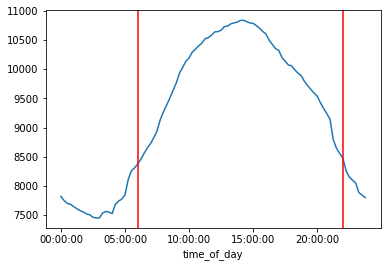

In [305]:
op_day['avg_kW'].plot()
temp_start = list(op_day.index).index(start_time)
temp_stop = list(op_day.index).index(stop_time)

# print(temp_start, temp_stop)
plt.gca().axvline(temp_start, color='r')
plt.gca().axvline(temp_stop, color='r');

# ax = plt.gca()
# line = ax.lines[0]
# print(line.get_xdata())

In [ ]:
# consider making base the lesser local max and the near peak as the higher local max
# threshold as the local minimum

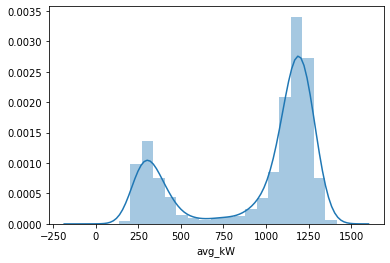

In [453]:
sns.distplot(temp_ts['avg_kW'])

# Identifying Data Gaps
I actually answered this question first because 1) the nature and frequency of the gaps may impact the approach used to solve other problems, which it did to a certain extent by exposing some sites with odd characteristics (i.e. non-constant interval width) and 2) I had the clearest initial idea for answering it.  
  
My approach.  

In [192]:
all_gap_dates = functions.multi_site_gap_date_df(site_list)

In [ ]:
all_gap_dates.to_csv('deliverables\gap_dates.csv', index=False)

In [373]:
def plt_operating_start_stop(weekly_df, ops_params, low_pct=5, high_pct=95):
    """
    Given a DataFrame with a site time series and load profile parameters,
    return the start and stop time of typical daily operation.
    """
    # aggregating the weekly median data into a daily median
    keys = ['dayofweek_0', 'dayofweek_1', 'dayofweek_2',
            'dayofweek_3', 'dayofweek_4', 'dayofweek_5', 'dayofweek_6']
    operating_days = [int(key[-1]) for key in keys if (ops_params[key] == 1)]
    analyzed_days = [int(key[-1]) for key in keys if (ops_params[key] != np.nan)]
    operating_week = weekly_df.loc[(operating_days, ), :].reset_index()
    day_df = operating_week[['avg_kW', 'time_of_day']].groupby(by=['time_of_day']).mean()
    if ops_params['continuous'] == 1:
        ops_params.update({'daily_start': np.nan,
                           'daily_stop': np.nan,
                           'agg_week_day_count': len(analyzed_days)})
        return day_df, ops_params
    else:
        # this method for categorizing on-hours
        # was taken from Lawrence Berkeley National Laboratory
        pct_low = np.percentile(day_df['avg_kW'], low_pct)
        pct_high = np.percentile(day_df['avg_kW'], high_pct)
        threshold = pct_low + 0.25 * (pct_high - pct_low)
        day_df['on_hour'] = (day_df['avg_kW'] > threshold).astype('int')
        # identifying the start and stop times
        shift_forward_fill = day_df['on_hour'].iloc[-1]
        shift_backward_fill = day_df['on_hour'].iloc[0]
        day_df['start'] = day_df['on_hour'].shift(1, fill_value=shift_forward_fill)
        day_df['start'] = day_df['on_hour'] > day_df['start']
        # taking the earliest potential start time in case the data is noisy 
        # and has intermediate troughs (e.g. site with limited data)
        start_time = day_df.loc[day_df['start']].index[0]
        start_index = list(day_df.index).index(start_time)
        start_time = day_df.index[start_index-1]
        day_df['stop'] = day_df['on_hour'].shift(-1, fill_value=shift_backward_fill)
        day_df['stop'] = day_df['on_hour'] > day_df['stop']
        # taking the latest stop time for the same reason as the earliest start
        stop_time = day_df.loc[day_df['stop']].index[-1]
        
        ops_params.update({'daily_start': start_time, 'daily_stop': stop_time,
                           'agg_week_day_count': len(analyzed_days)})
        return day_df, ops_params

In [374]:
def plot_site_operating_status(site_data_df, site_id_list):
    """
    Given site-level Average kW time series', categorize the sites as 
    operating continuously or not, determine daily start/stop if
    not continuously operating, and produce various other load profile
    parameters in the form of a dataframe where each row has information
    for a given site.
    """
    ops_data = pd.DataFrame()
    for site in site_id_list:
#         print(site)
        working_df = site_data_df.loc[site_data_df['site_id'] == site]
        width = working_df['interval_width'].mean()
        if width.is_integer():
            working_ts = working_df.set_index('interval_end', drop=False)
            working_ts.dropna(inplace=True)
        else:
            working_ts = hourly_resample(working_df, site)
            width = 3600
        # creating a weekly time series made up of the median for each time period
        working_week = aggregate_week_ts(working_ts)
        # calculating near_peak_load and near_base_load parameters
        # as well as reference parameter variables for evaluating operating days
        working_week = week_load_profile_params(working_week)
        ref_peak = working_week['near_peak_load'].max()
        ref_base = working_week['near_base_load'].min()
        days_index = working_week.index.get_level_values(0).unique()
        ops_params = agg_week_operating_day(working_week,
                                            days_index,
                                            ref_peak,
                                            ref_base,
                                            p_threshold=0.05)
        working_day, ops_params = plt_operating_start_stop(working_week, ops_params)
        
        site_ops_data = pd.DataFrame(ops_params, index=[site])
        ops_data = pd.concat([ops_data, site_ops_data])
        
        daily_intervals = 24 / (working_week['imputed_interval_width'].iloc[0] / 3600)
        days_in_data = str(int(working_ts.shape[0] / daily_intervals))
        plt.figure(figsize=[15, 4])
#         working_day[['avg_kW']].plot()
        working_week[['avg_kW']].plot()
        start_time = ops_params['daily_start']
        stop_time = ops_params['daily_stop']
        try:
            plt_start = list(working_day.index).index(start_time)
            plt_stop = list(working_day.index).index(stop_time)
            for i in range(ops_params['agg_week_day_count']):
                plt.gca().axvline(plt_start+(daily_intervals*i), color='r')
                plt.gca().axvline(plt_stop+(daily_intervals*i), color='r')
        except:
            pass
        plt.gca().set_title(site+' - '
                            +str(ops_params['continuous'])+' - '
                            +days_in_data+' - '
                            +str(start_time)+' - '
                            +str(stop_time))
        plt.xticks(rotation=45);
    plt.show();
    return ops_data

In [375]:
import matplotlib
matplotlib.rcParams.update({'figure.max_open_warning': 0})

<Figure size 1080x288 with 0 Axes>

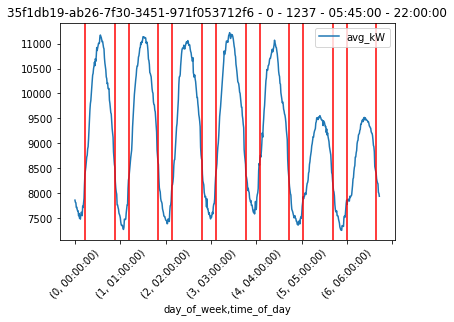

<Figure size 1080x288 with 0 Axes>

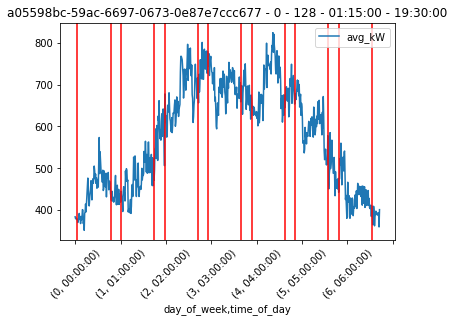

<Figure size 1080x288 with 0 Axes>

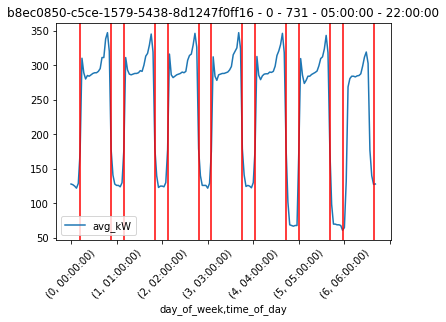

<Figure size 1080x288 with 0 Axes>

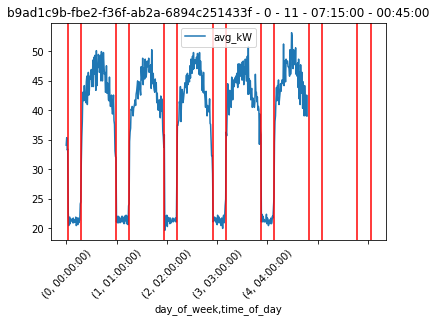

<Figure size 1080x288 with 0 Axes>

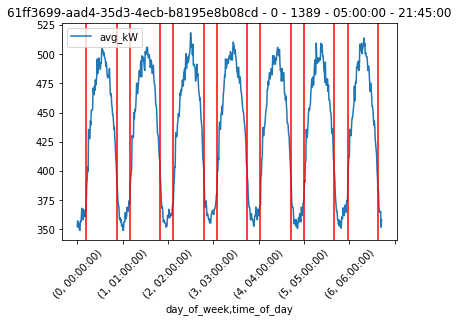

<Figure size 1080x288 with 0 Axes>

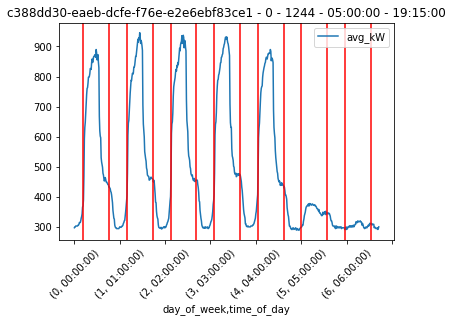

<Figure size 1080x288 with 0 Axes>

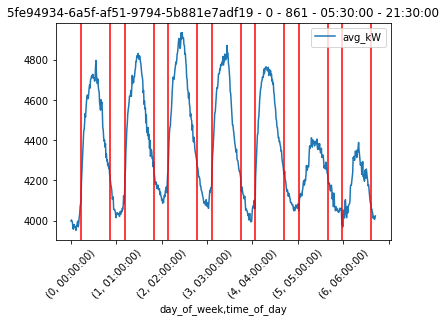

<Figure size 1080x288 with 0 Axes>

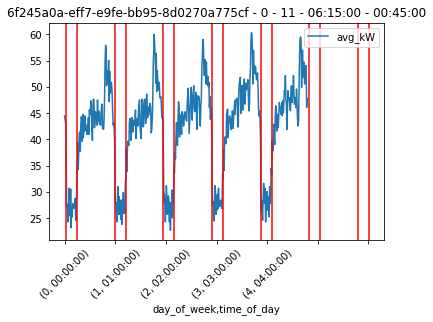

<Figure size 1080x288 with 0 Axes>

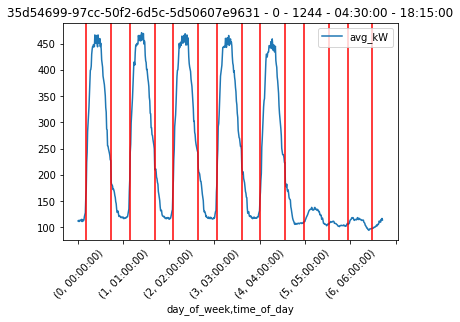

<Figure size 1080x288 with 0 Axes>

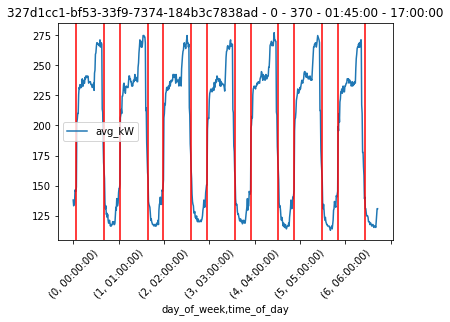

<Figure size 1080x288 with 0 Axes>

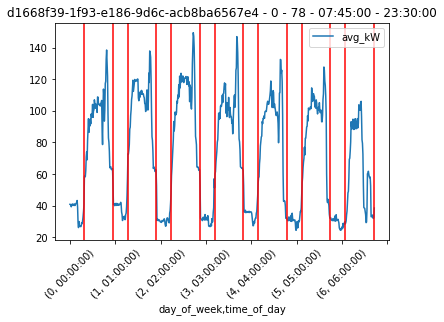

<Figure size 1080x288 with 0 Axes>

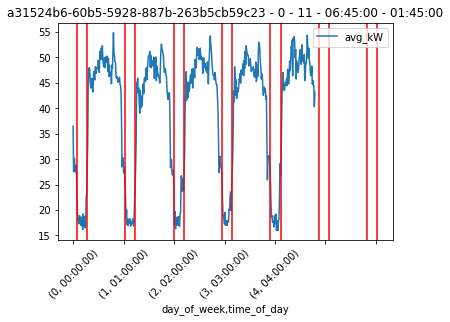

<Figure size 1080x288 with 0 Axes>

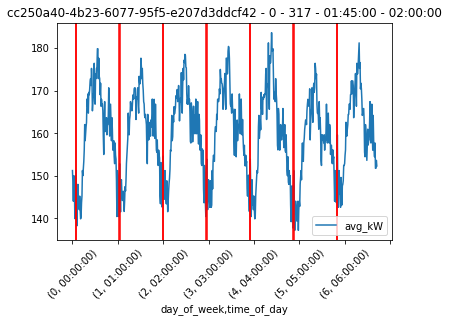

<Figure size 1080x288 with 0 Axes>

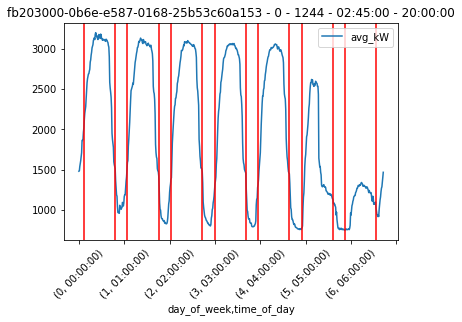

<Figure size 1080x288 with 0 Axes>

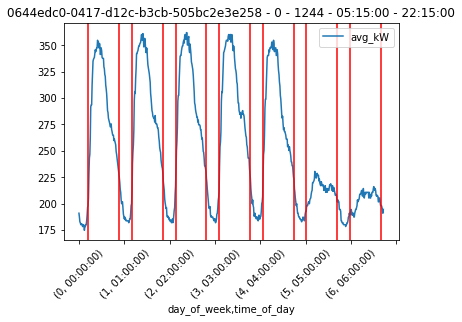

<Figure size 1080x288 with 0 Axes>

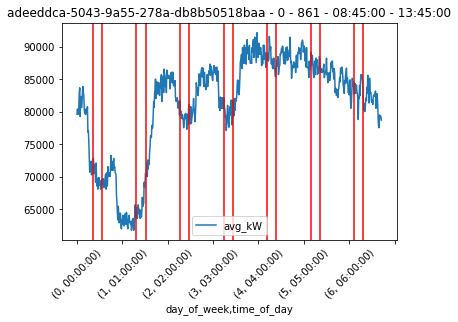

<Figure size 1080x288 with 0 Axes>

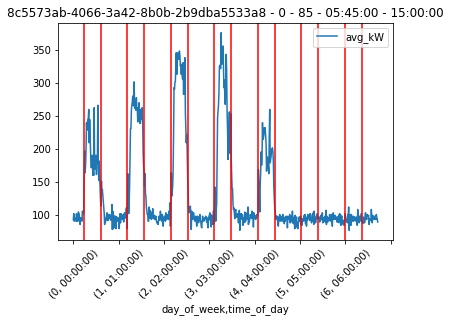

<Figure size 1080x288 with 0 Axes>

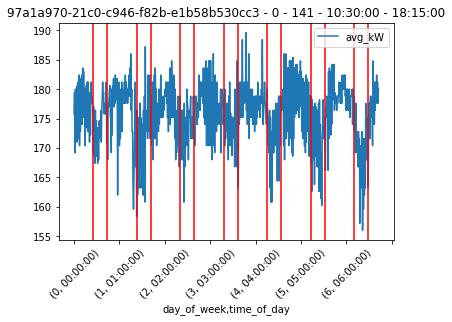

<Figure size 1080x288 with 0 Axes>

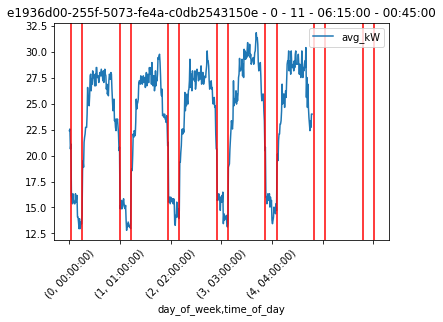

<Figure size 1080x288 with 0 Axes>

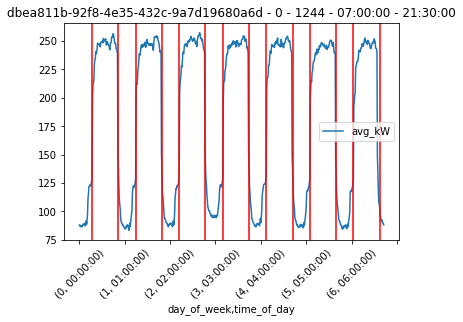

<Figure size 1080x288 with 0 Axes>

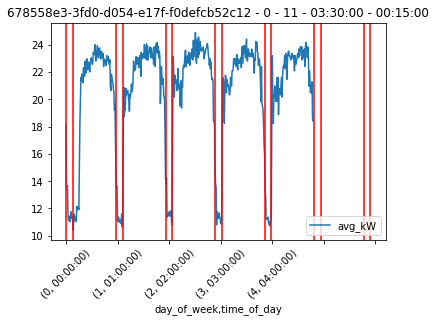

<Figure size 1080x288 with 0 Axes>

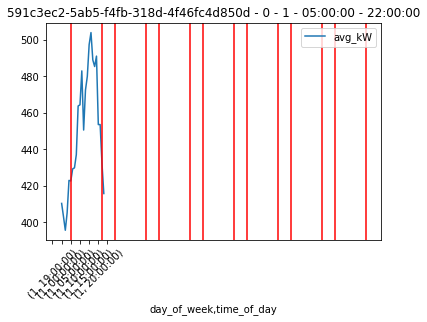

<Figure size 1080x288 with 0 Axes>

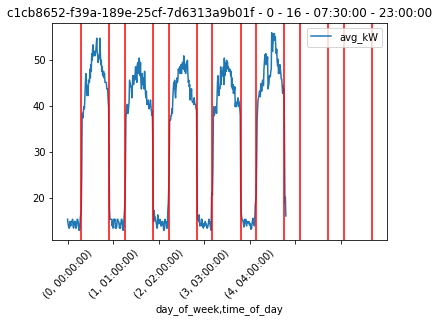

<Figure size 1080x288 with 0 Axes>

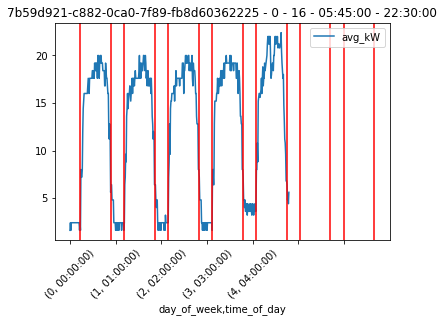

<Figure size 1080x288 with 0 Axes>

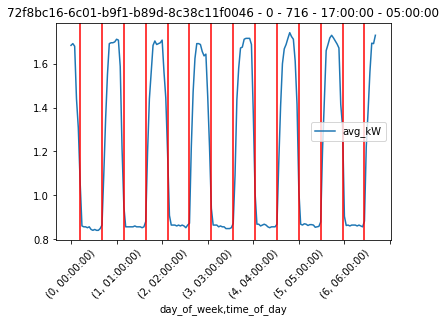

<Figure size 1080x288 with 0 Axes>

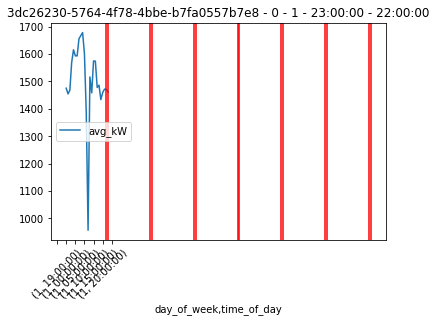

<Figure size 1080x288 with 0 Axes>

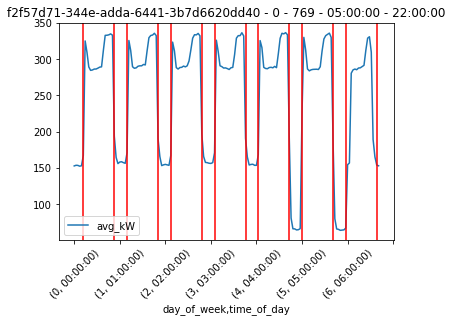

<Figure size 1080x288 with 0 Axes>

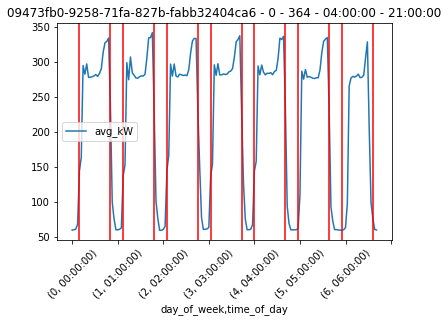

<Figure size 1080x288 with 0 Axes>

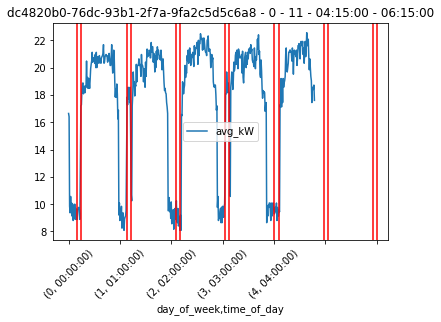

<Figure size 1080x288 with 0 Axes>

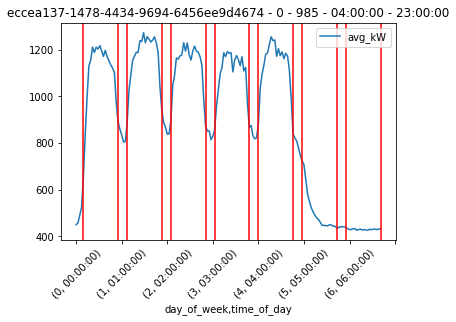

<Figure size 1080x288 with 0 Axes>

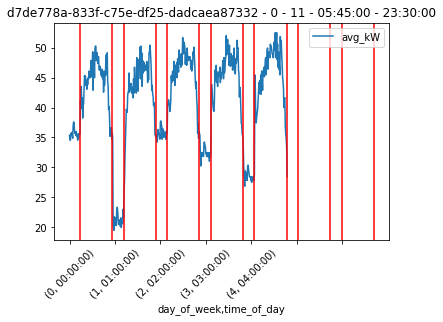

<Figure size 1080x288 with 0 Axes>

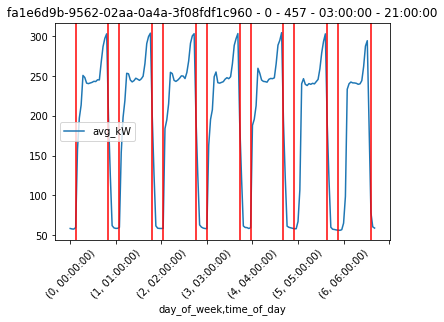

<Figure size 1080x288 with 0 Axes>

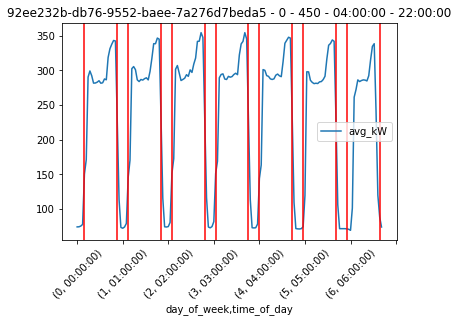

<Figure size 1080x288 with 0 Axes>

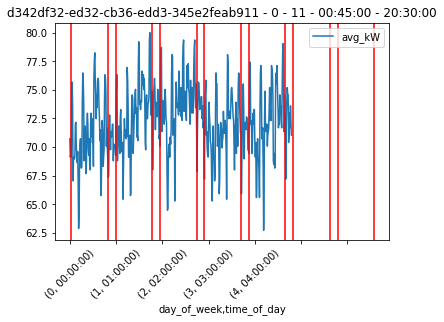

<Figure size 1080x288 with 0 Axes>

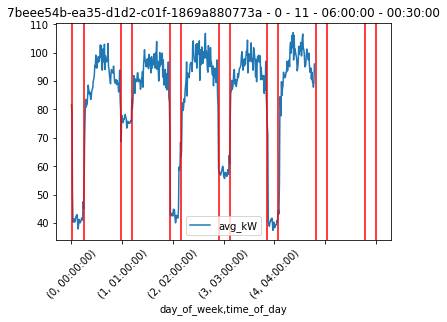

<Figure size 1080x288 with 0 Axes>

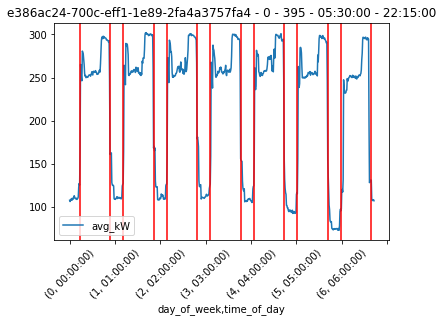

<Figure size 1080x288 with 0 Axes>

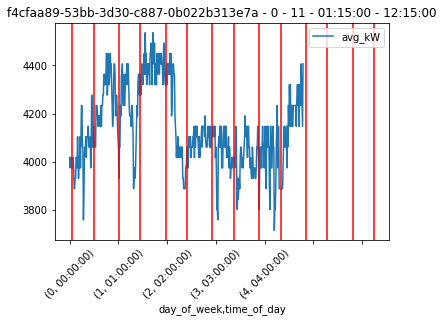

<Figure size 1080x288 with 0 Axes>

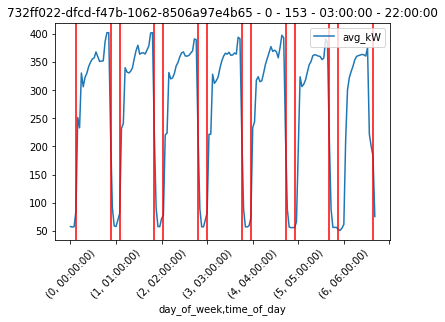

<Figure size 1080x288 with 0 Axes>

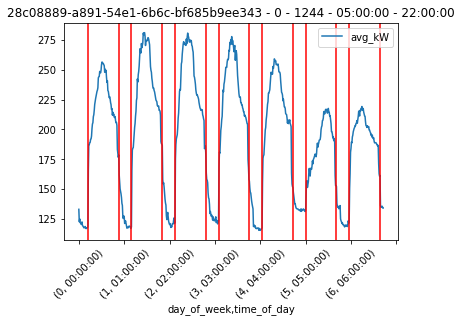

<Figure size 1080x288 with 0 Axes>

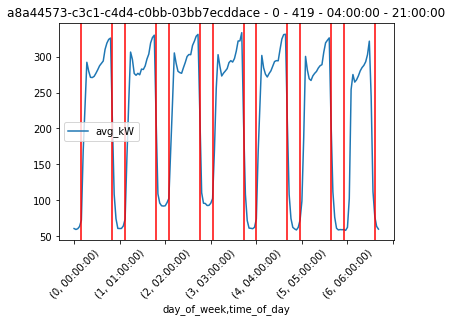

<Figure size 1080x288 with 0 Axes>

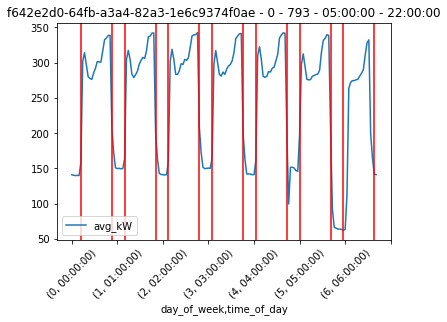

<Figure size 1080x288 with 0 Axes>

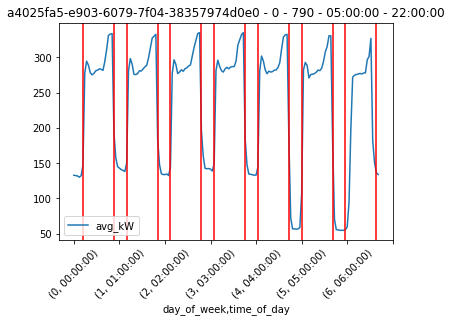

<Figure size 1080x288 with 0 Axes>

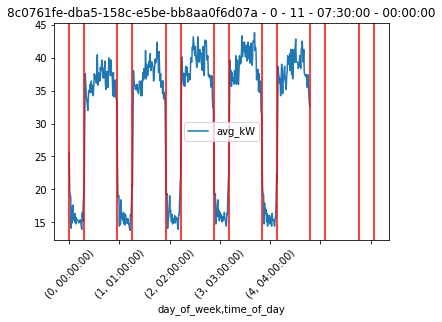

<Figure size 1080x288 with 0 Axes>

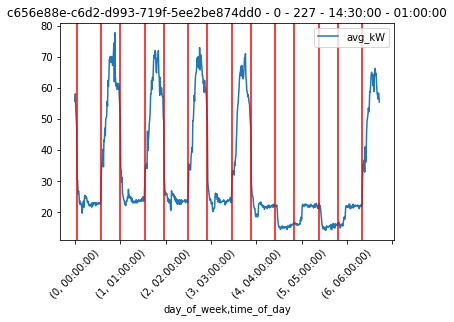

<Figure size 1080x288 with 0 Axes>

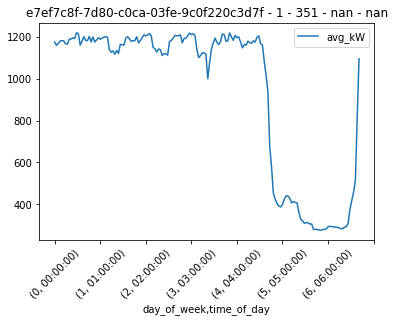

<Figure size 1080x288 with 0 Axes>

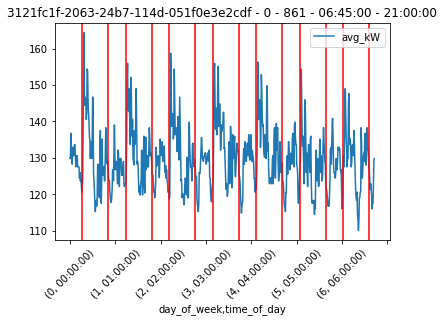

<Figure size 1080x288 with 0 Axes>

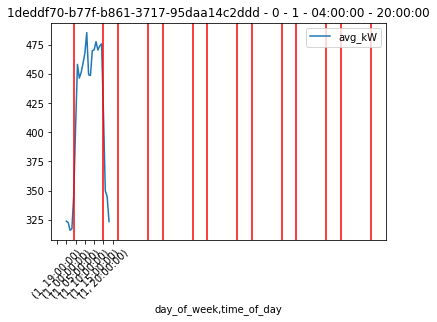

<Figure size 1080x288 with 0 Axes>

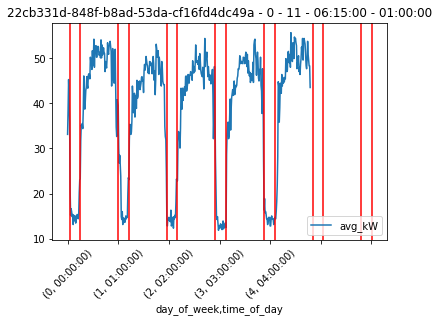

<Figure size 1080x288 with 0 Axes>

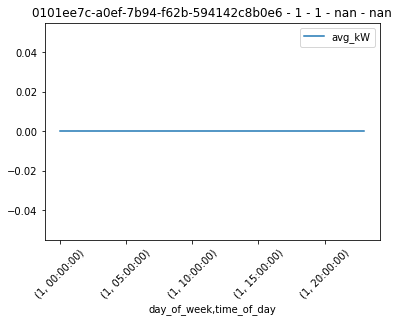

<Figure size 1080x288 with 0 Axes>

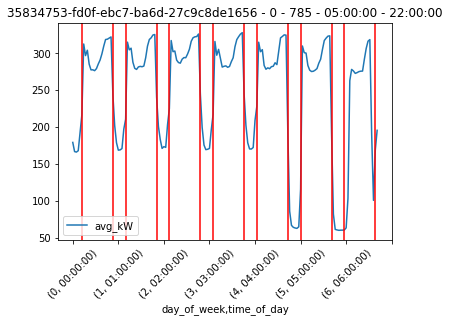

<Figure size 1080x288 with 0 Axes>

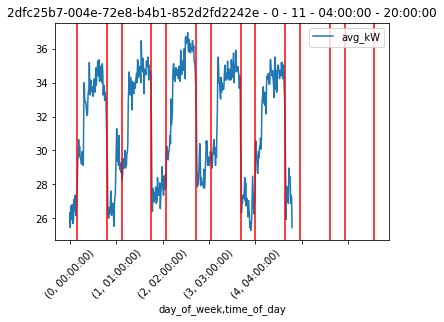

<Figure size 1080x288 with 0 Axes>

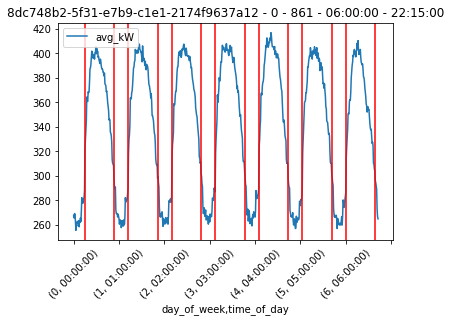

<Figure size 1080x288 with 0 Axes>

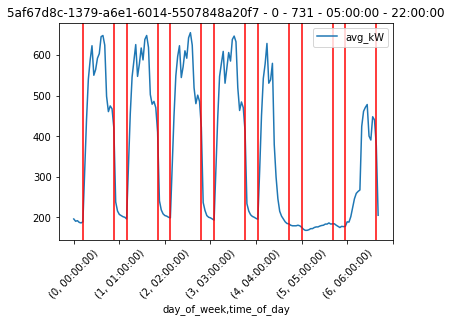

<Figure size 1080x288 with 0 Axes>

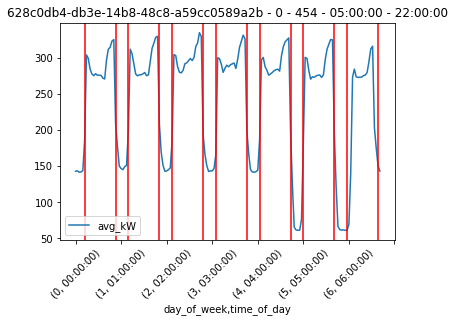

<Figure size 1080x288 with 0 Axes>

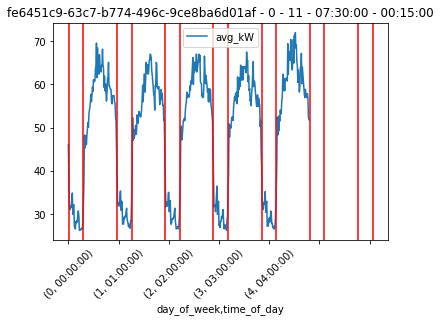

<Figure size 1080x288 with 0 Axes>

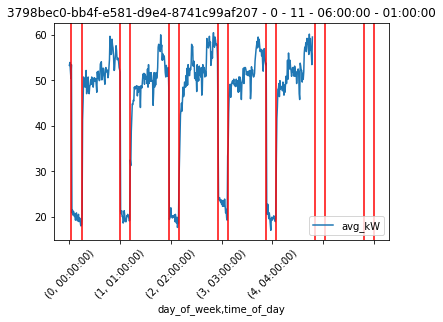

<Figure size 1080x288 with 0 Axes>

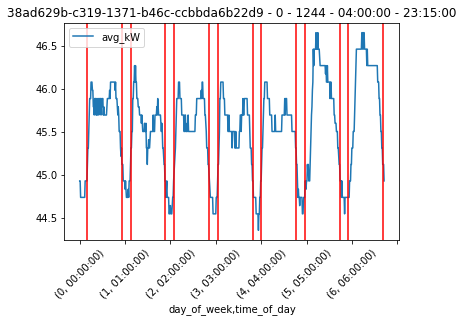

<Figure size 1080x288 with 0 Axes>

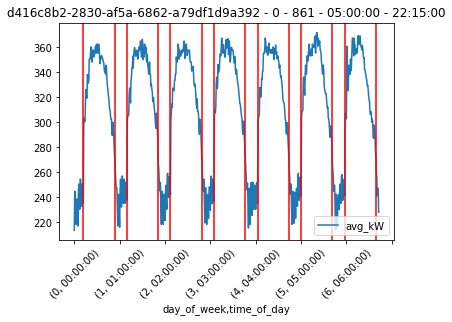

<Figure size 1080x288 with 0 Axes>

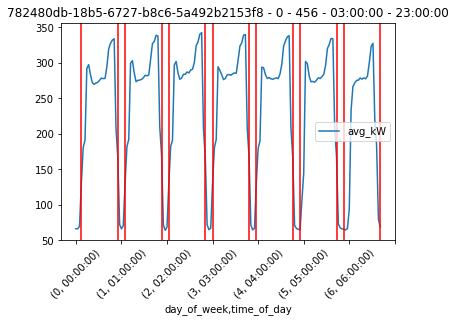

<Figure size 1080x288 with 0 Axes>

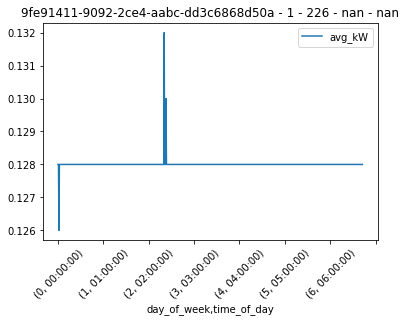

<Figure size 1080x288 with 0 Axes>

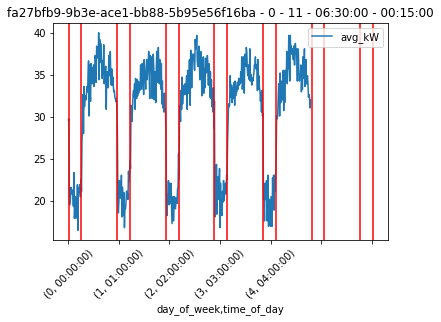

<Figure size 1080x288 with 0 Axes>

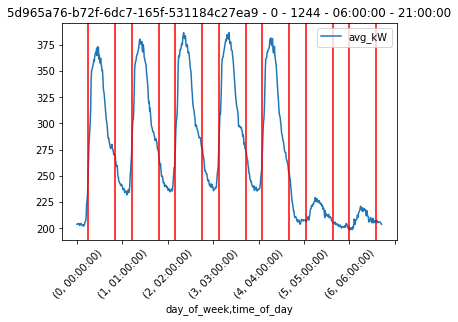

<Figure size 1080x288 with 0 Axes>

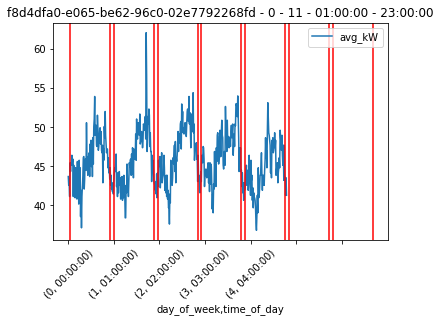

<Figure size 1080x288 with 0 Axes>

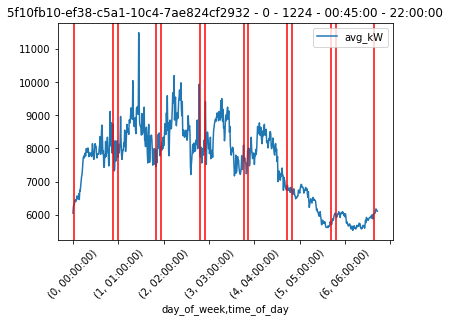

<Figure size 1080x288 with 0 Axes>

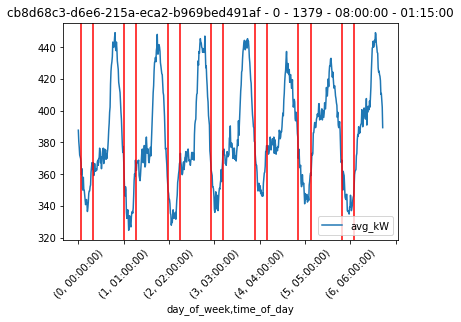

<Figure size 1080x288 with 0 Axes>

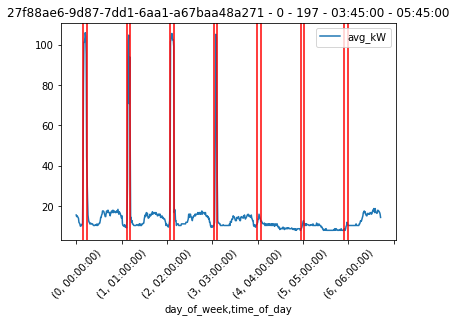

<Figure size 1080x288 with 0 Axes>

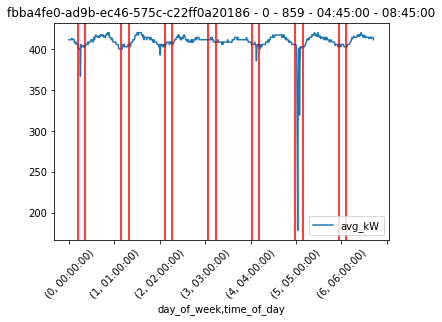

<Figure size 1080x288 with 0 Axes>

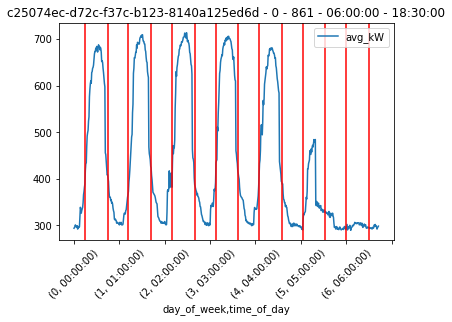

<Figure size 1080x288 with 0 Axes>

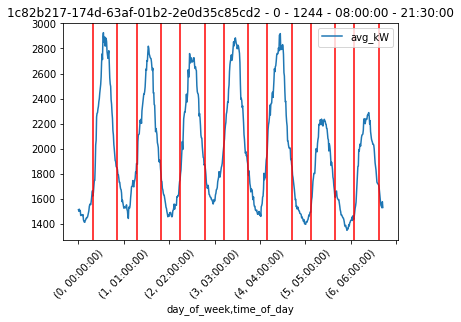

<Figure size 1080x288 with 0 Axes>

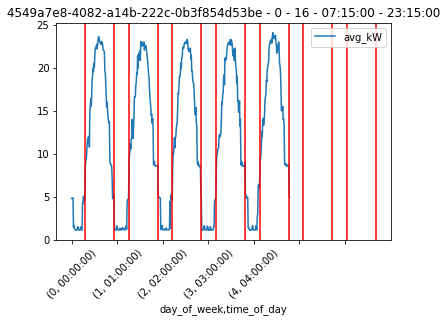

<Figure size 1080x288 with 0 Axes>

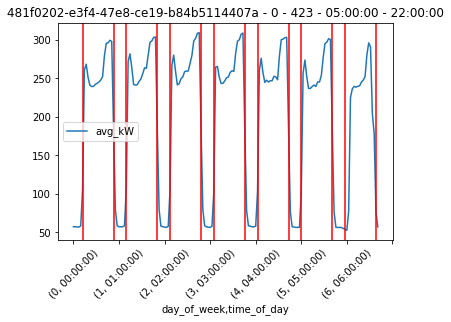

<Figure size 1080x288 with 0 Axes>

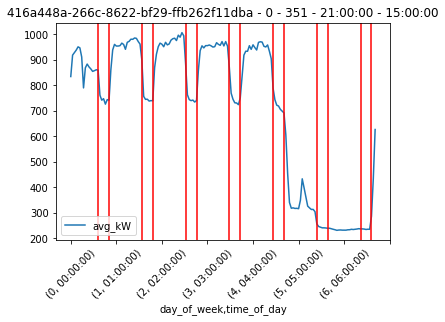

<Figure size 1080x288 with 0 Axes>

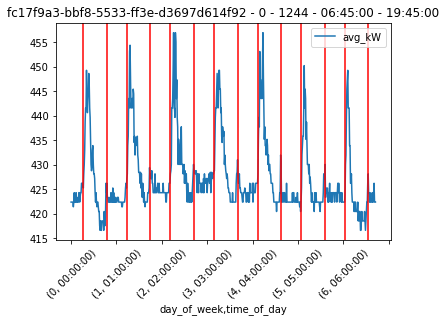

<Figure size 1080x288 with 0 Axes>

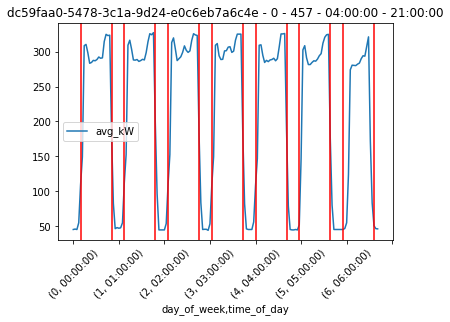

<Figure size 1080x288 with 0 Axes>

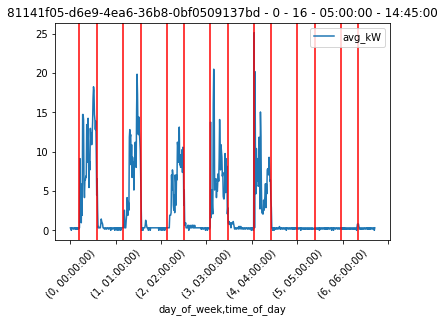

<Figure size 1080x288 with 0 Axes>

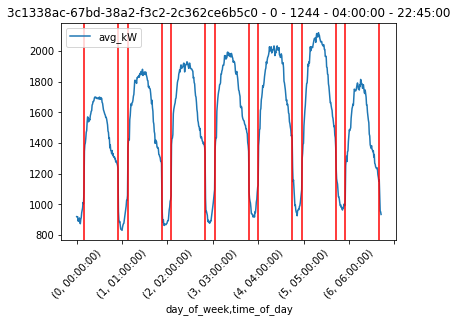

<Figure size 1080x288 with 0 Axes>

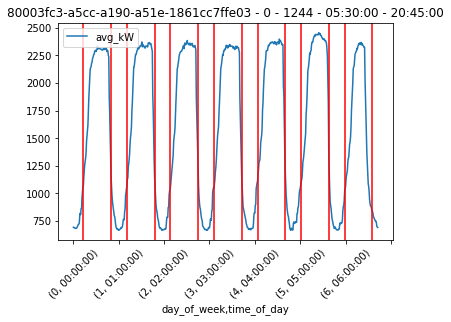

<Figure size 1080x288 with 0 Axes>

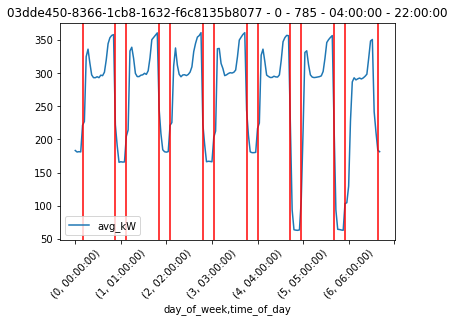

<Figure size 1080x288 with 0 Axes>

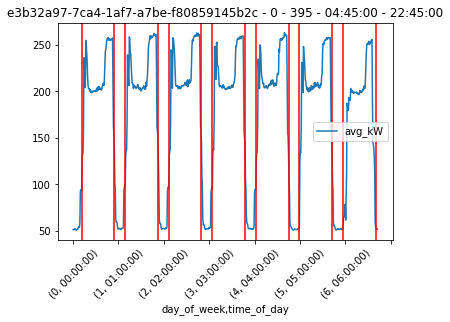

<Figure size 1080x288 with 0 Axes>

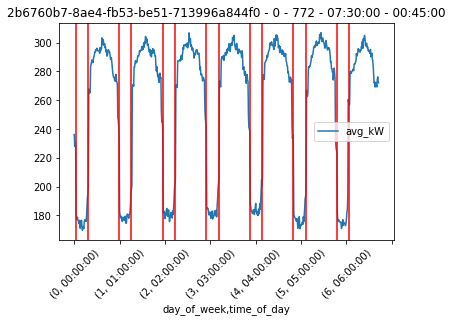

<Figure size 1080x288 with 0 Axes>

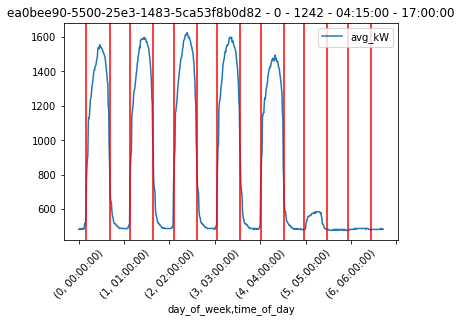

<Figure size 1080x288 with 0 Axes>

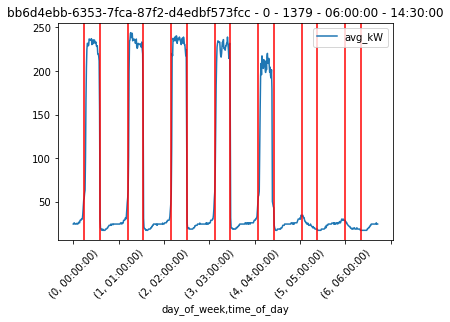

<Figure size 1080x288 with 0 Axes>

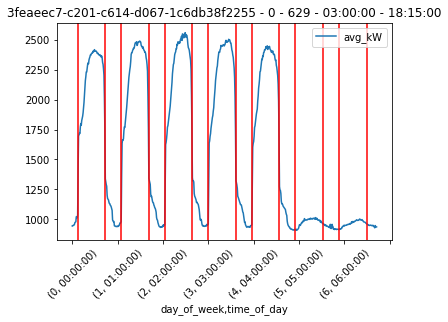

<Figure size 1080x288 with 0 Axes>

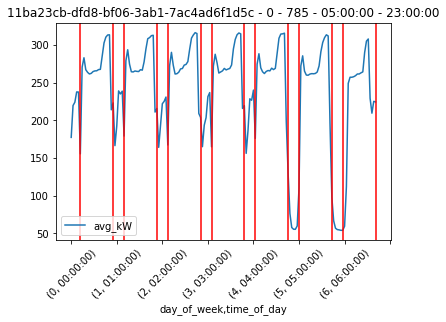

<Figure size 1080x288 with 0 Axes>

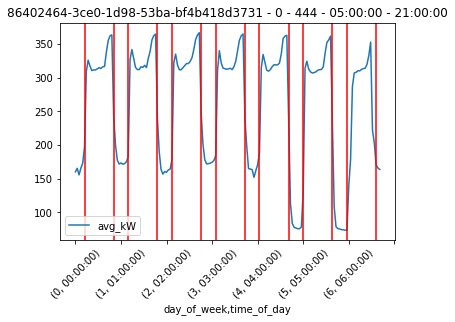

<Figure size 1080x288 with 0 Axes>

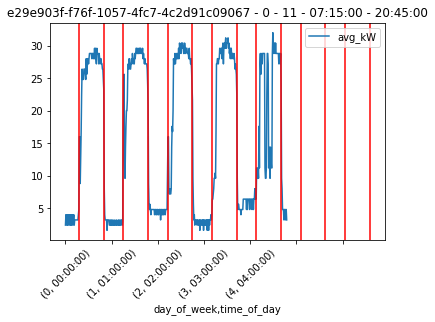

<Figure size 1080x288 with 0 Axes>

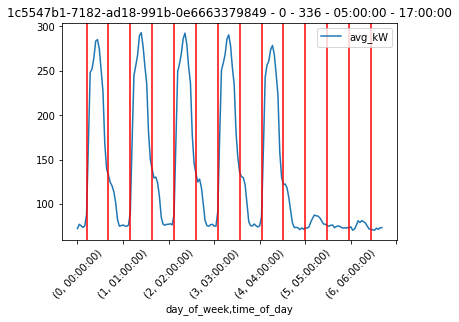

<Figure size 1080x288 with 0 Axes>

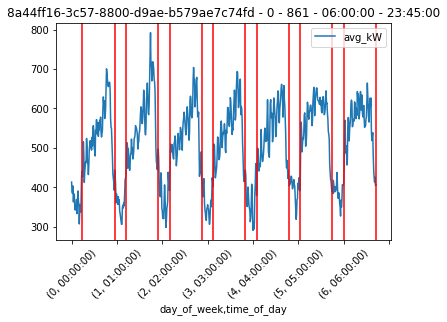

<Figure size 1080x288 with 0 Axes>

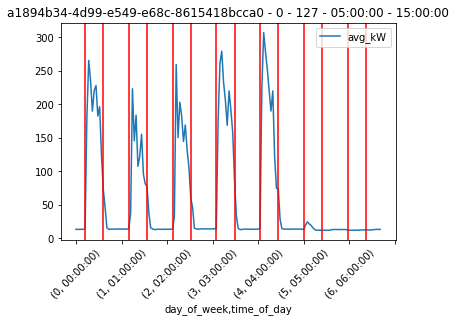

<Figure size 1080x288 with 0 Axes>

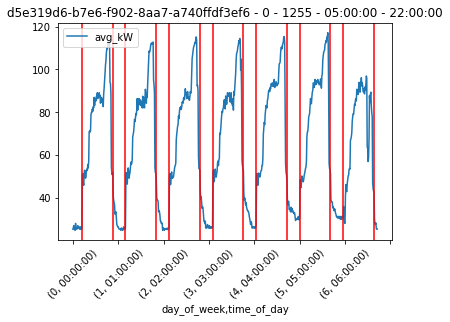

<Figure size 1080x288 with 0 Axes>

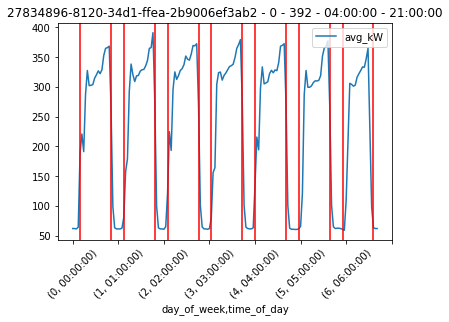

<Figure size 1080x288 with 0 Axes>

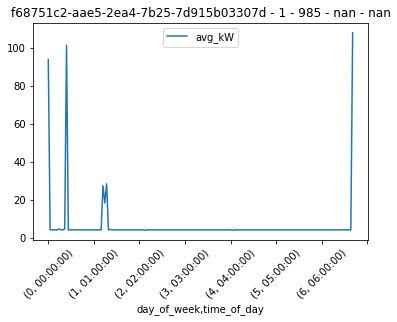

<Figure size 1080x288 with 0 Axes>

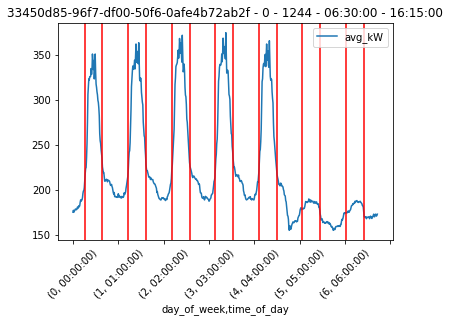

<Figure size 1080x288 with 0 Axes>

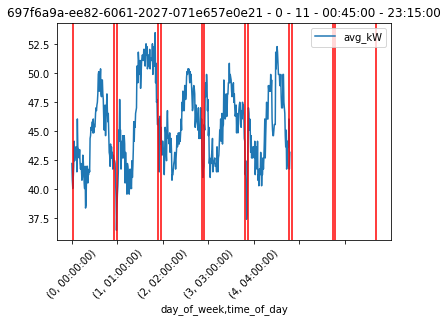

<Figure size 1080x288 with 0 Axes>

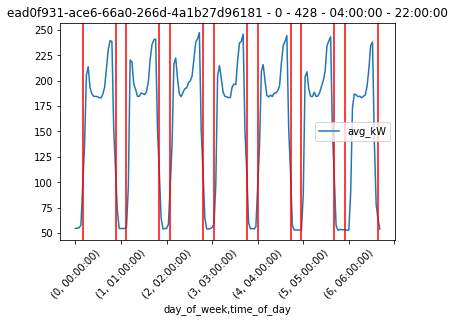

<Figure size 1080x288 with 0 Axes>

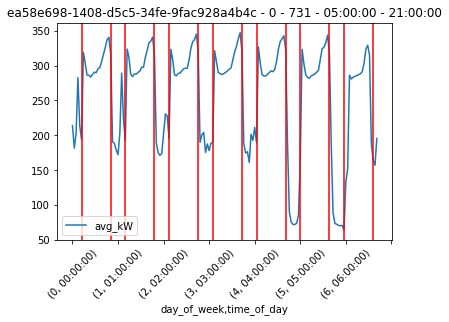

<Figure size 1080x288 with 0 Axes>

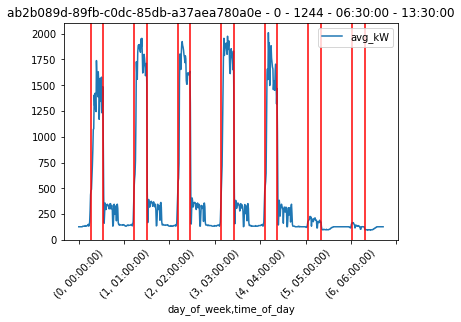

<Figure size 1080x288 with 0 Axes>

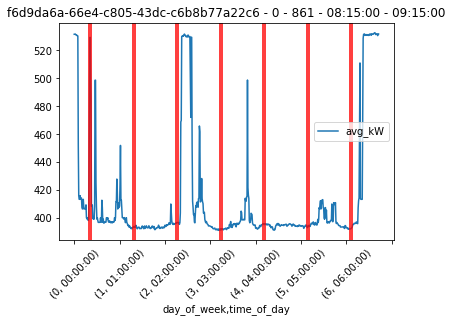

<Figure size 1080x288 with 0 Axes>

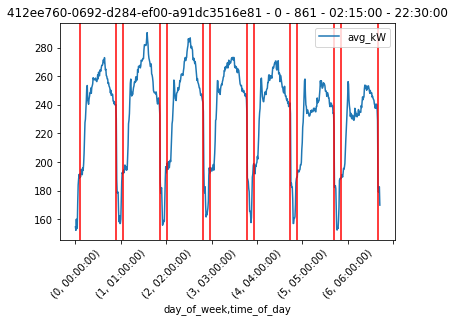

<Figure size 1080x288 with 0 Axes>

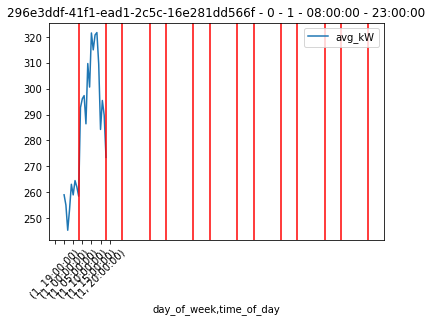

<Figure size 1080x288 with 0 Axes>

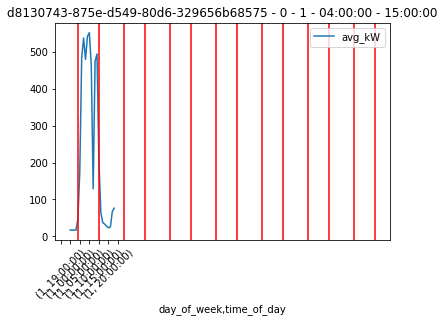

<Figure size 1080x288 with 0 Axes>

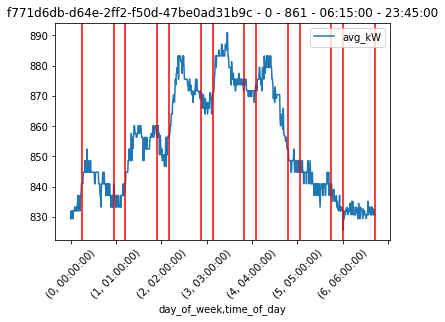

<Figure size 1080x288 with 0 Axes>

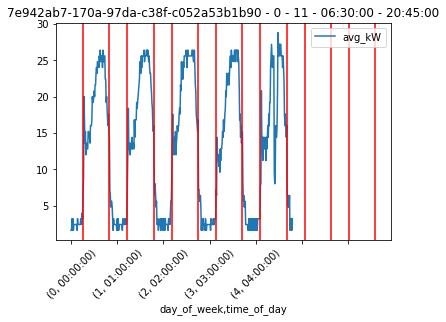

<Figure size 1080x288 with 0 Axes>

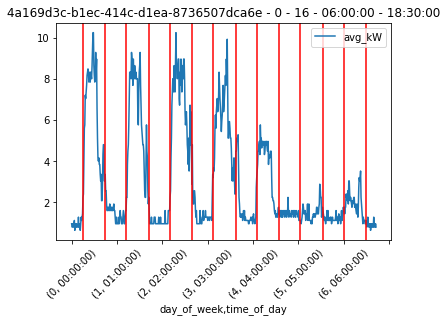

<Figure size 1080x288 with 0 Axes>

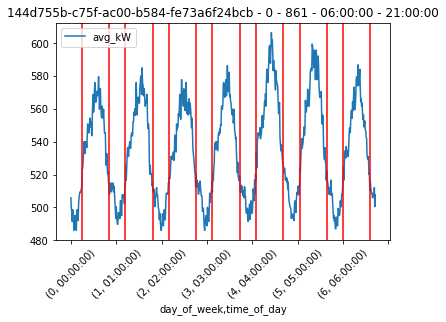

<Figure size 1080x288 with 0 Axes>

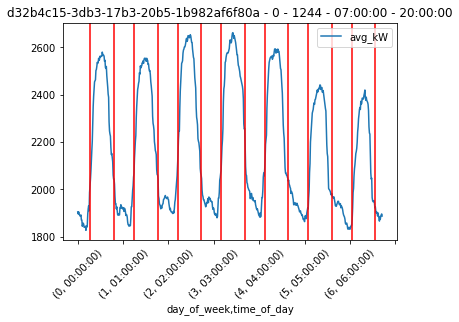

<Figure size 1080x288 with 0 Axes>

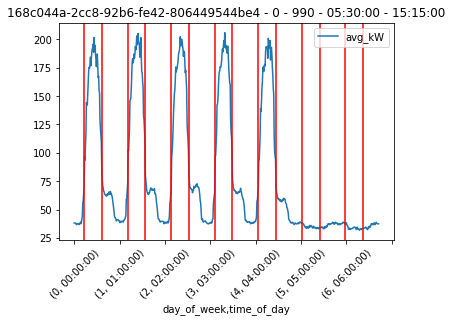

<Figure size 1080x288 with 0 Axes>

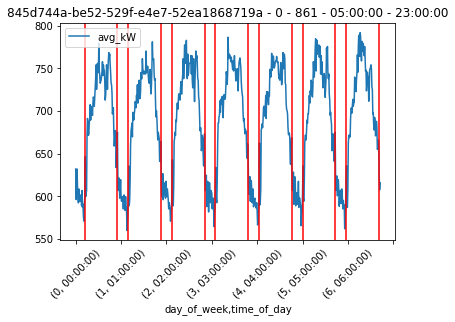

<Figure size 1080x288 with 0 Axes>

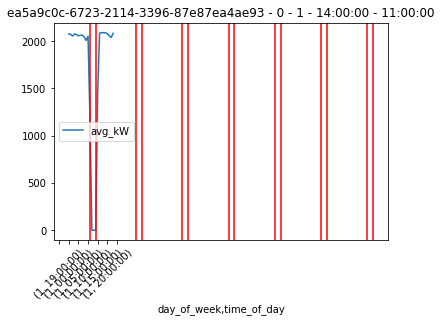

<Figure size 1080x288 with 0 Axes>

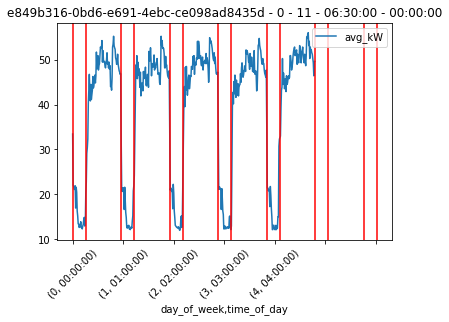

<Figure size 1080x288 with 0 Axes>

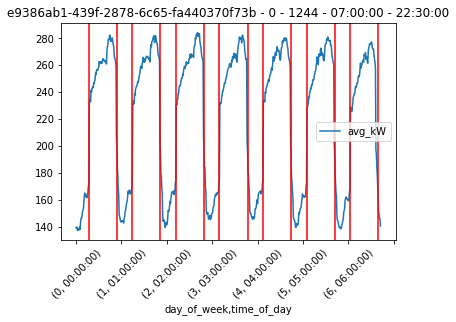

<Figure size 1080x288 with 0 Axes>

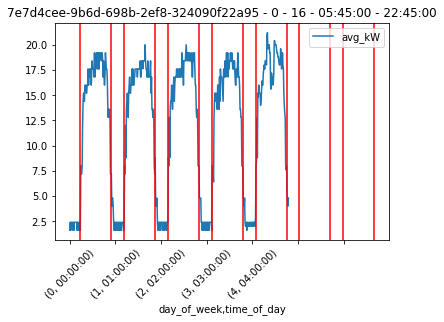

<Figure size 1080x288 with 0 Axes>

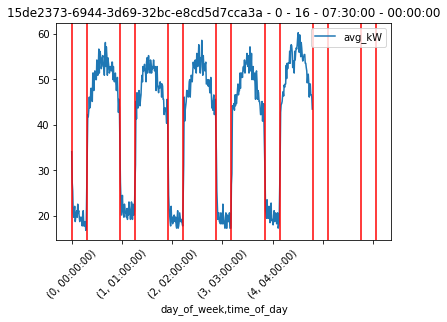

<Figure size 1080x288 with 0 Axes>

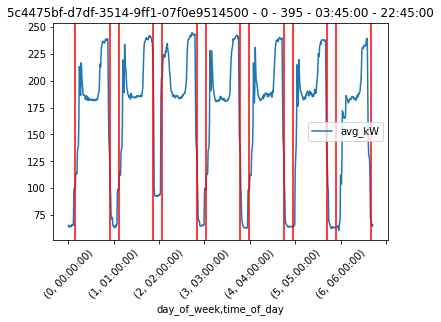

<Figure size 1080x288 with 0 Axes>

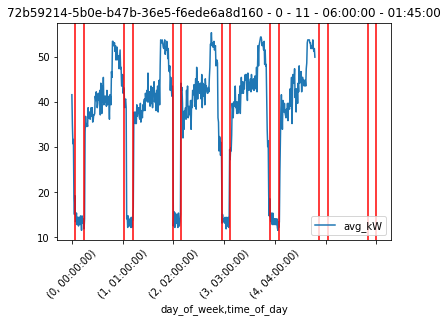

<Figure size 1080x288 with 0 Axes>

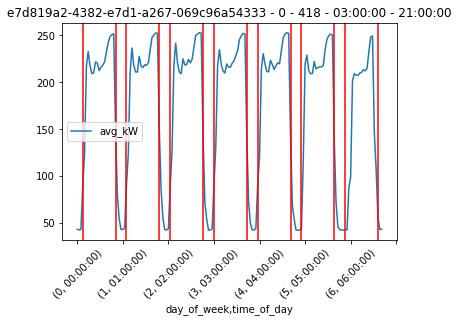

<Figure size 1080x288 with 0 Axes>

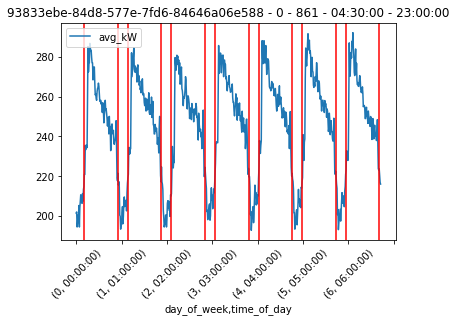

<Figure size 1080x288 with 0 Axes>

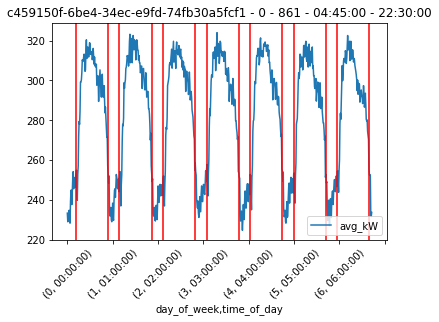

<Figure size 1080x288 with 0 Axes>

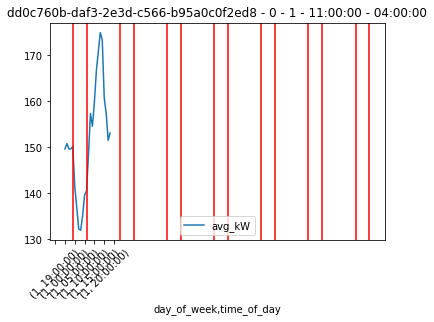

<Figure size 1080x288 with 0 Axes>

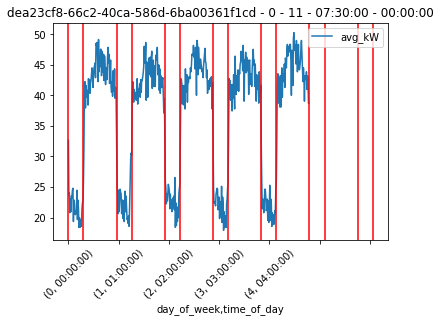

<Figure size 1080x288 with 0 Axes>

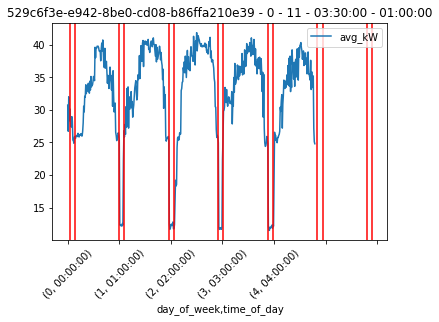

<Figure size 1080x288 with 0 Axes>

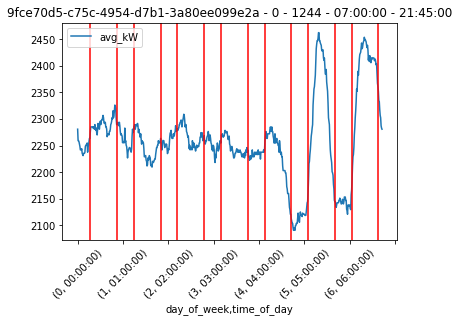

<Figure size 1080x288 with 0 Axes>

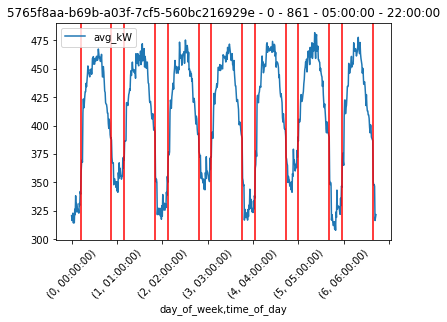

<Figure size 1080x288 with 0 Axes>

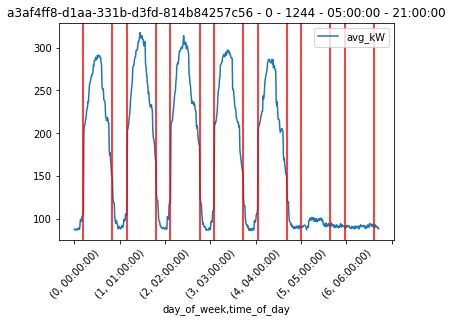

<Figure size 1080x288 with 0 Axes>

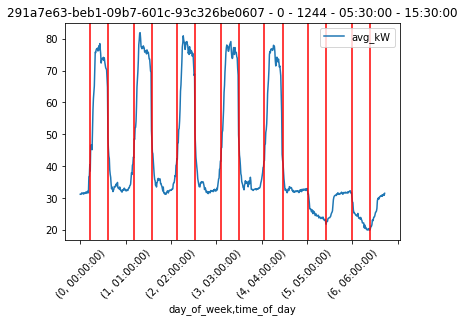

<Figure size 1080x288 with 0 Axes>

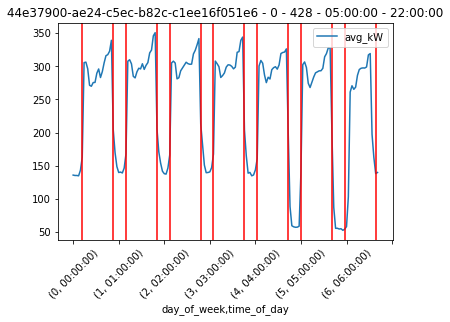

<Figure size 1080x288 with 0 Axes>

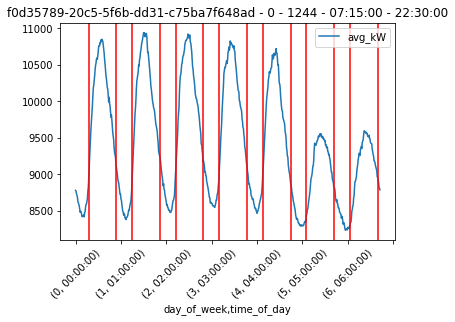

<Figure size 1080x288 with 0 Axes>

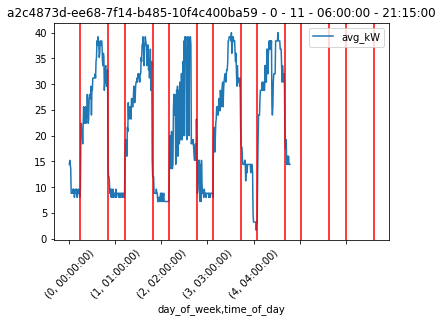

<Figure size 1080x288 with 0 Axes>

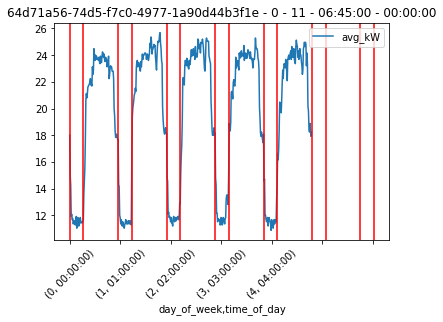

<Figure size 1080x288 with 0 Axes>

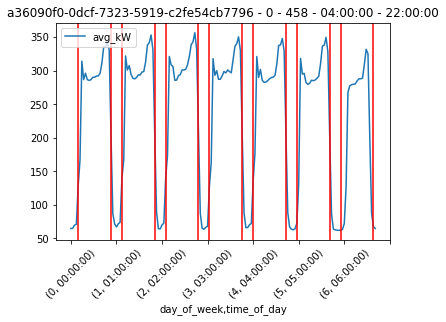

<Figure size 1080x288 with 0 Axes>

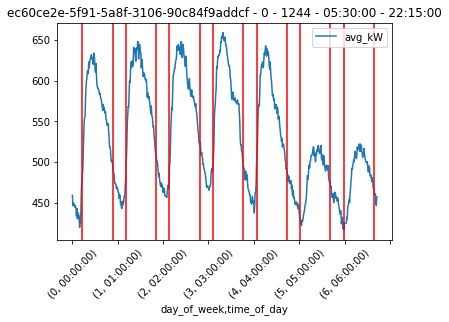

<Figure size 1080x288 with 0 Axes>

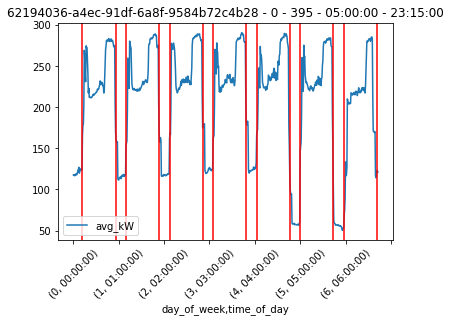

<Figure size 1080x288 with 0 Axes>

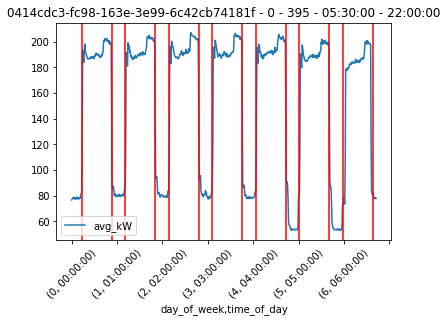

<Figure size 1080x288 with 0 Axes>

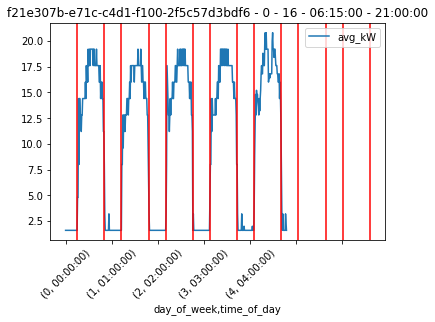

<Figure size 1080x288 with 0 Axes>

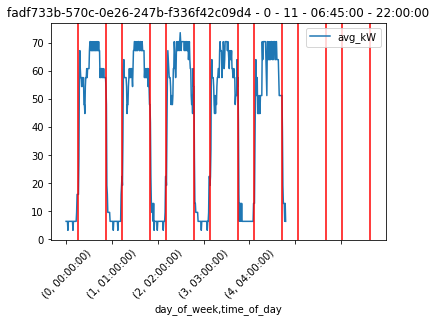

<Figure size 1080x288 with 0 Axes>

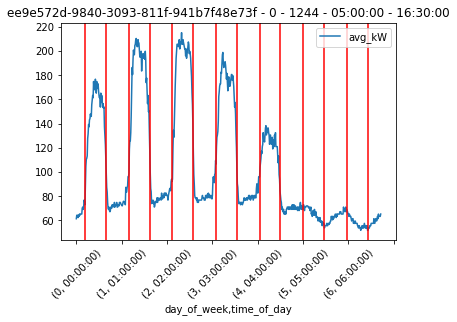

<Figure size 1080x288 with 0 Axes>

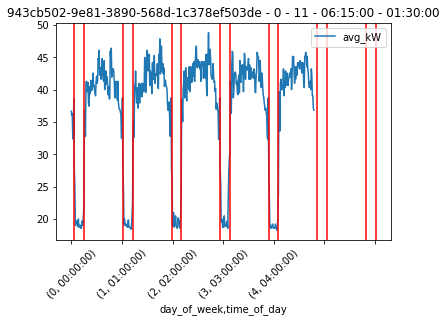

<Figure size 1080x288 with 0 Axes>

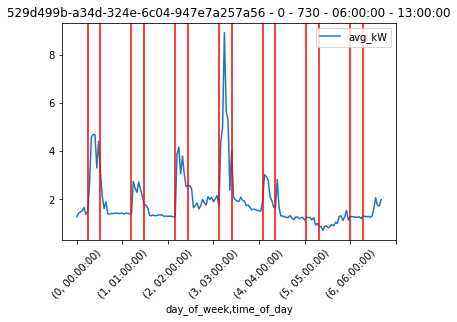

<Figure size 1080x288 with 0 Axes>

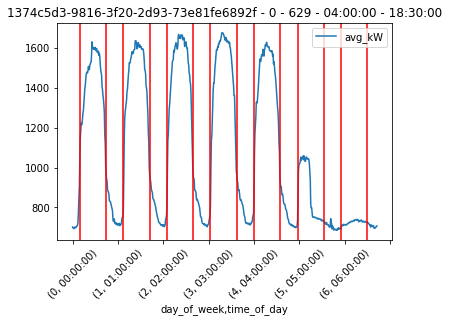

<Figure size 1080x288 with 0 Axes>

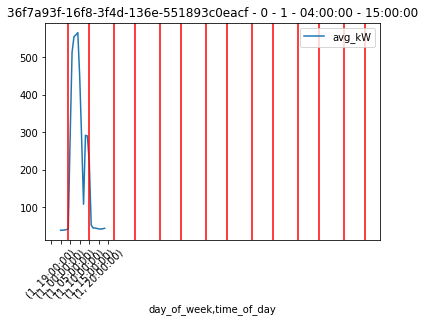

<Figure size 1080x288 with 0 Axes>

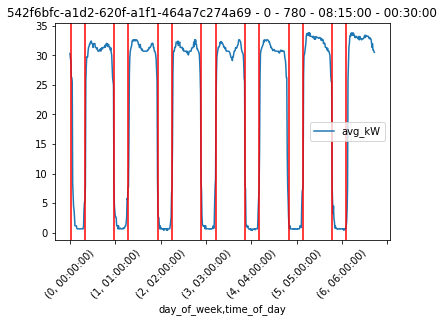

<Figure size 1080x288 with 0 Axes>

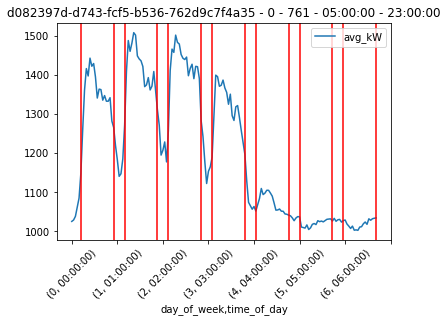

<Figure size 1080x288 with 0 Axes>

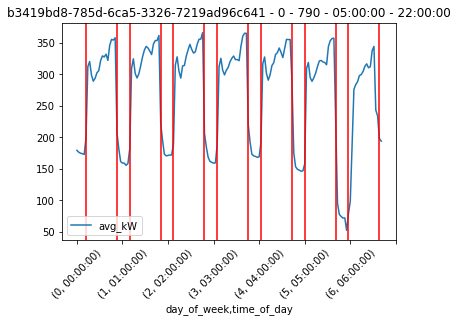

<Figure size 1080x288 with 0 Axes>

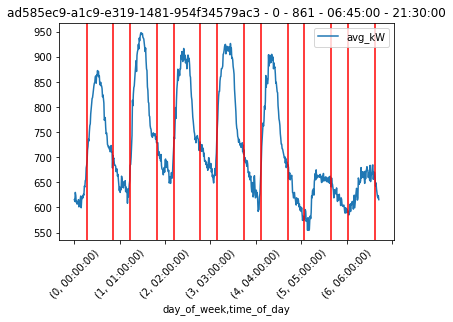

<Figure size 1080x288 with 0 Axes>

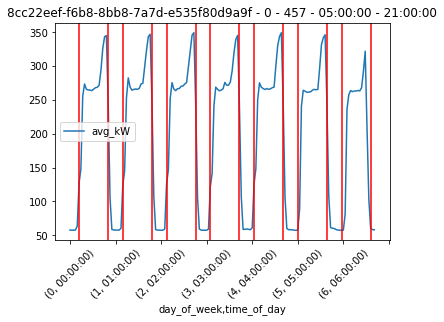

<Figure size 1080x288 with 0 Axes>

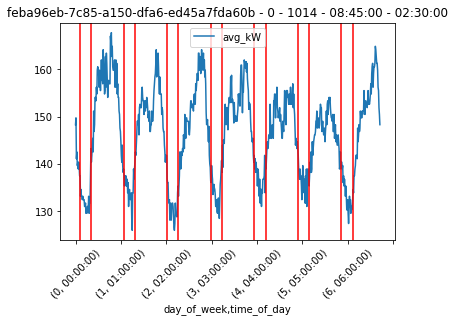

<Figure size 1080x288 with 0 Axes>

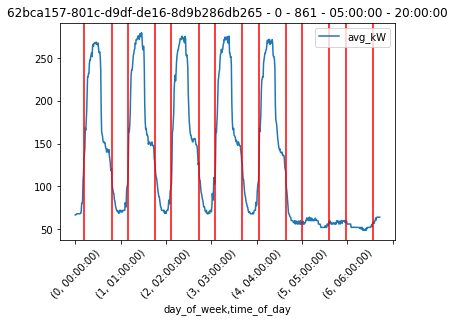

<Figure size 1080x288 with 0 Axes>

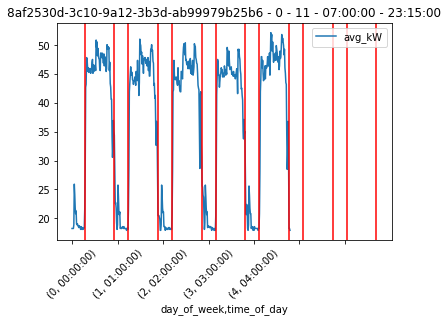

<Figure size 1080x288 with 0 Axes>

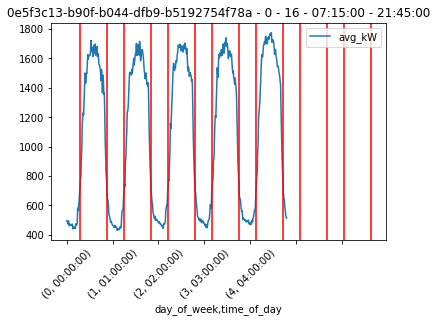

<Figure size 1080x288 with 0 Axes>

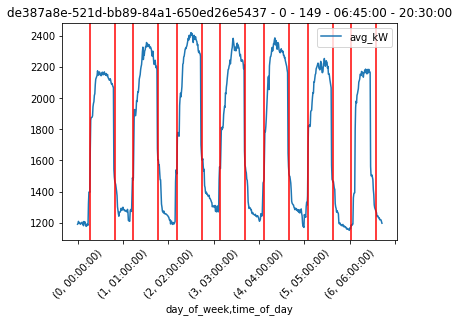

<Figure size 1080x288 with 0 Axes>

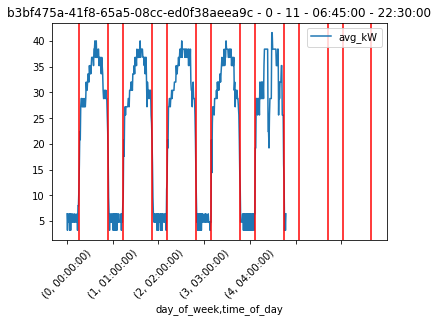

<Figure size 1080x288 with 0 Axes>

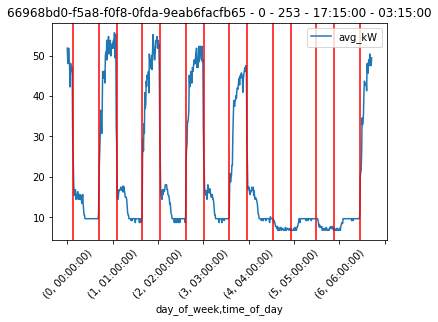

<Figure size 1080x288 with 0 Axes>

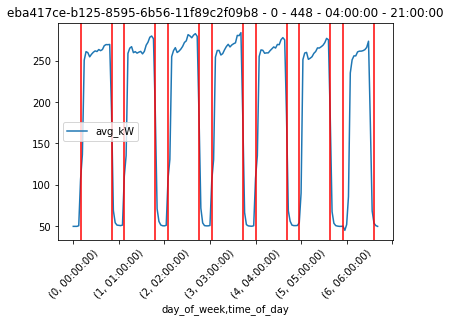

<Figure size 1080x288 with 0 Axes>

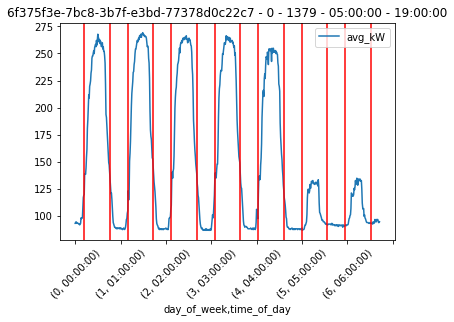

<Figure size 1080x288 with 0 Axes>

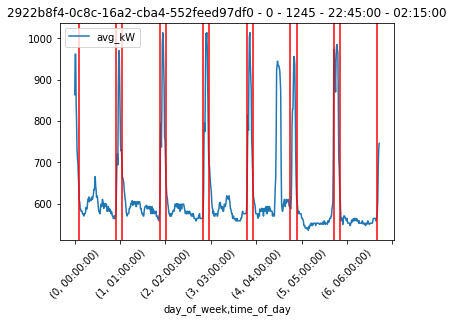

<Figure size 1080x288 with 0 Axes>

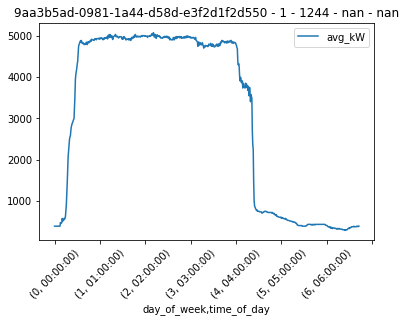

<Figure size 1080x288 with 0 Axes>

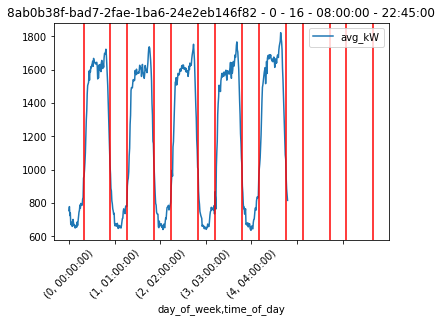

<Figure size 1080x288 with 0 Axes>

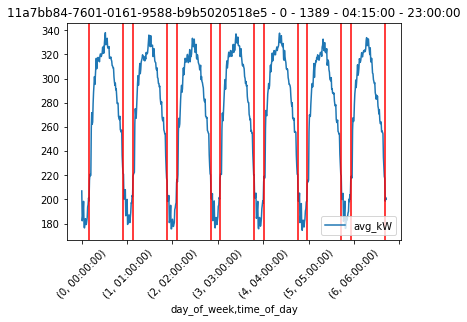

<Figure size 1080x288 with 0 Axes>

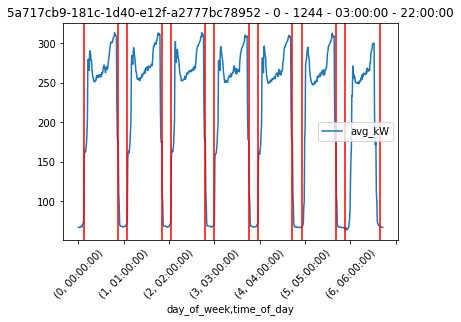

<Figure size 1080x288 with 0 Axes>

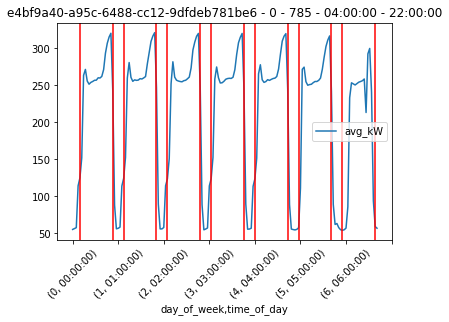

<Figure size 1080x288 with 0 Axes>

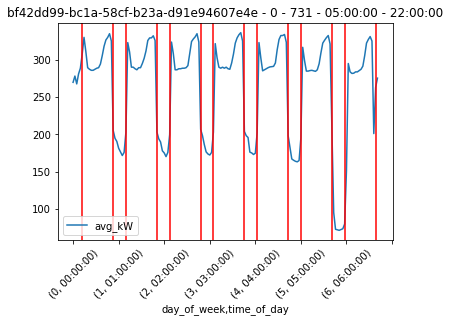

<Figure size 1080x288 with 0 Axes>

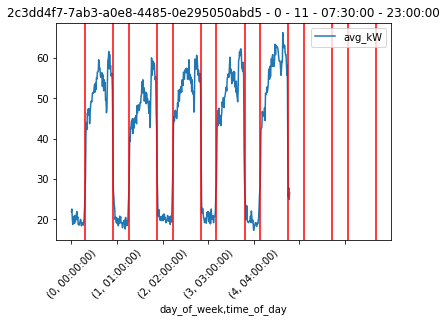

<Figure size 1080x288 with 0 Axes>

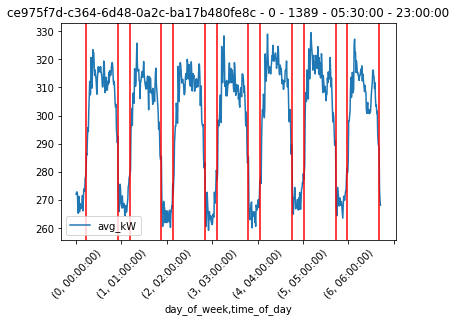

<Figure size 1080x288 with 0 Axes>

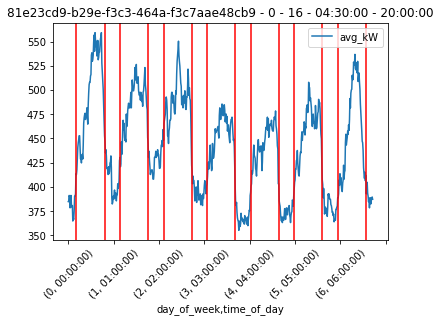

<Figure size 1080x288 with 0 Axes>

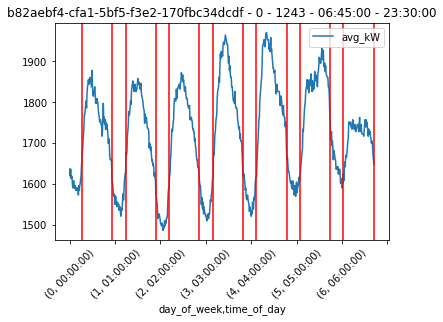

<Figure size 1080x288 with 0 Axes>

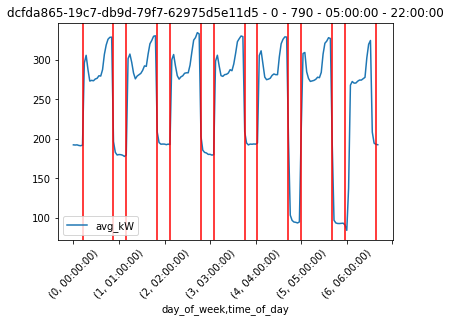

<Figure size 1080x288 with 0 Axes>

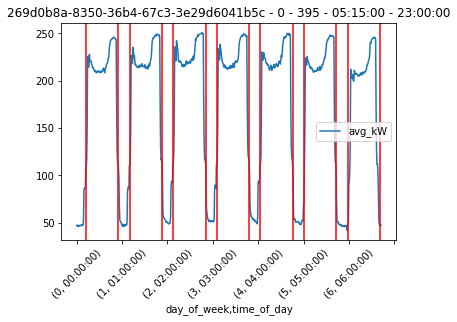

<Figure size 1080x288 with 0 Axes>

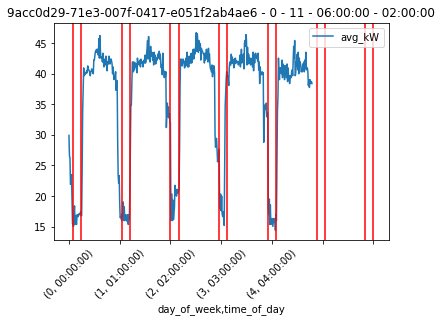

<Figure size 1080x288 with 0 Axes>

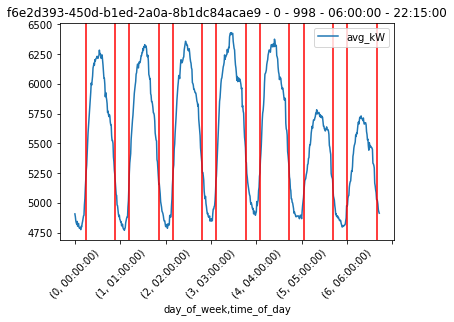

<Figure size 1080x288 with 0 Axes>

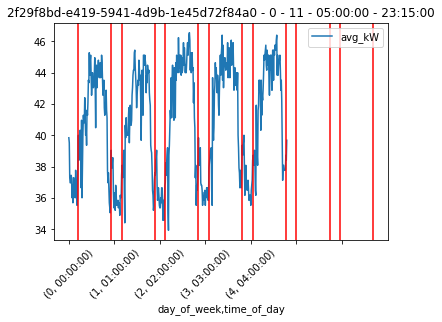

<Figure size 1080x288 with 0 Axes>

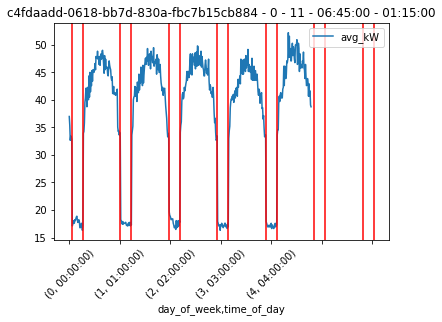

<Figure size 1080x288 with 0 Axes>

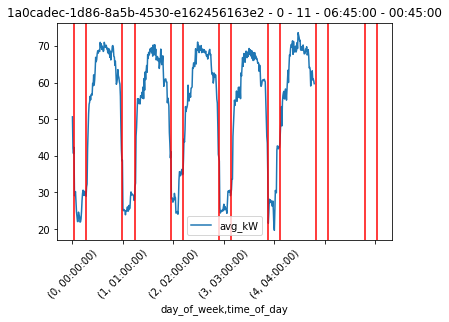

<Figure size 1080x288 with 0 Axes>

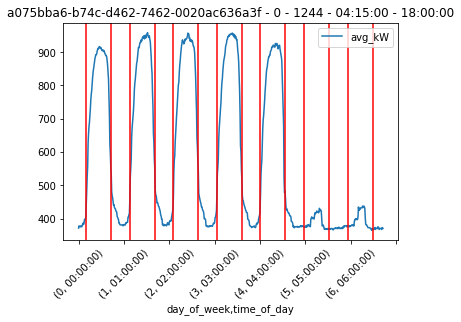

<Figure size 1080x288 with 0 Axes>

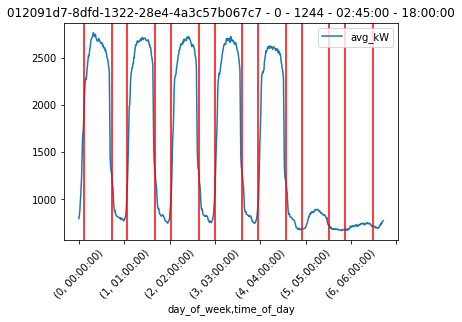

<Figure size 1080x288 with 0 Axes>

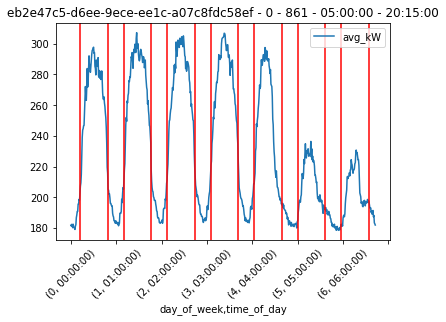

<Figure size 1080x288 with 0 Axes>

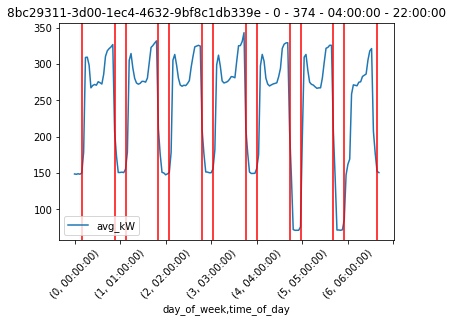

<Figure size 1080x288 with 0 Axes>

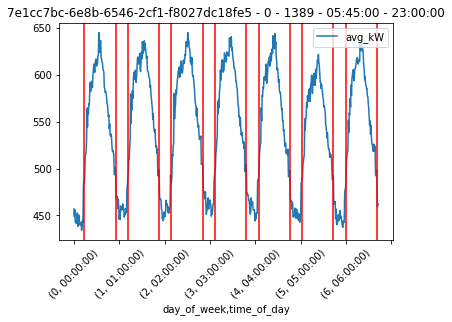

<Figure size 1080x288 with 0 Axes>

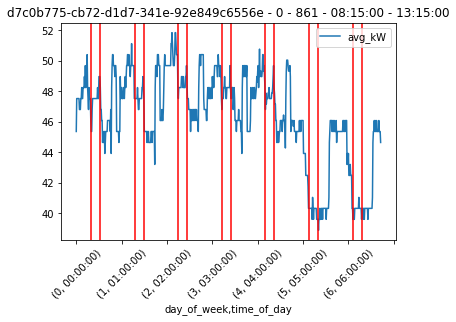

<Figure size 1080x288 with 0 Axes>

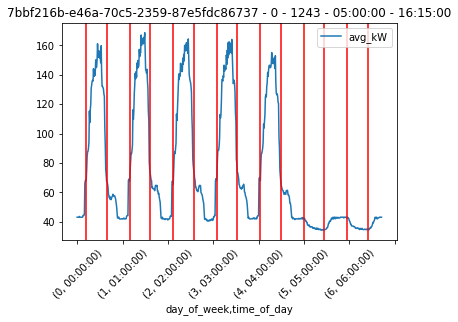

<Figure size 1080x288 with 0 Axes>

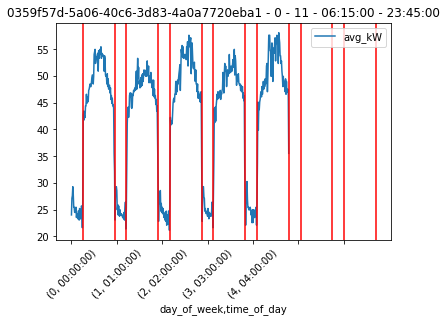

<Figure size 1080x288 with 0 Axes>

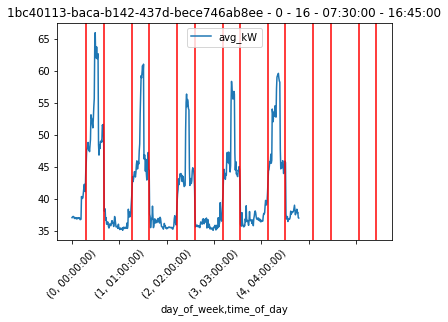

<Figure size 1080x288 with 0 Axes>

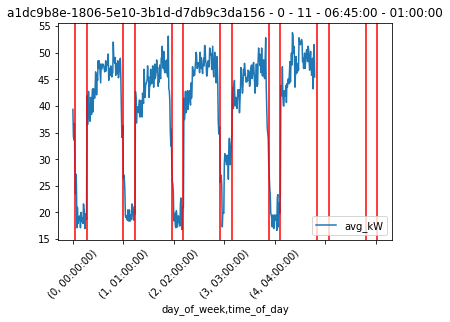

<Figure size 1080x288 with 0 Axes>

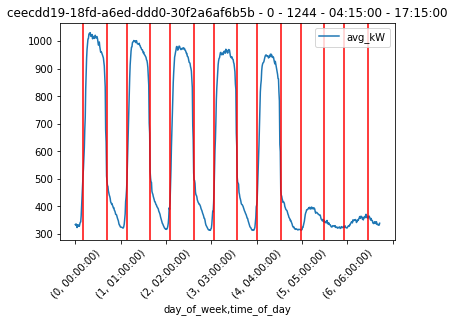

<Figure size 1080x288 with 0 Axes>

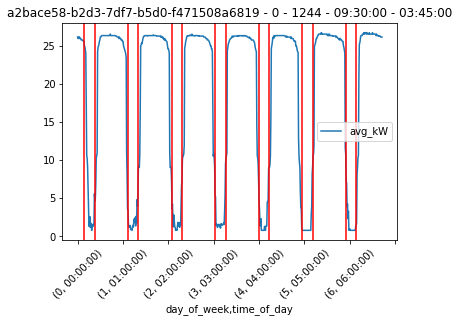

<Figure size 1080x288 with 0 Axes>

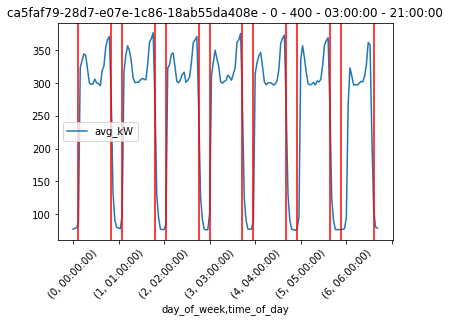

<Figure size 1080x288 with 0 Axes>

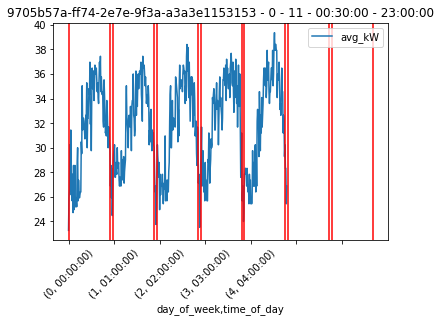

<Figure size 1080x288 with 0 Axes>

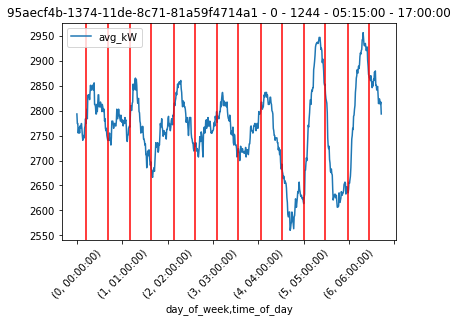

<Figure size 1080x288 with 0 Axes>

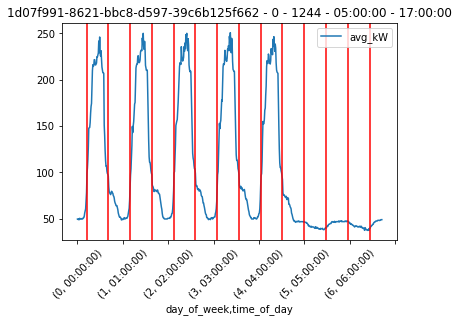

<Figure size 1080x288 with 0 Axes>

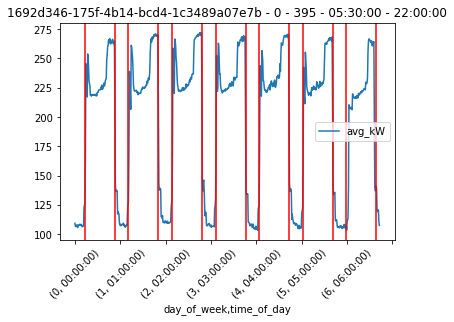

<Figure size 1080x288 with 0 Axes>

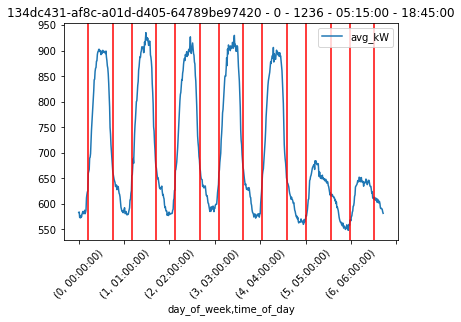

<Figure size 1080x288 with 0 Axes>

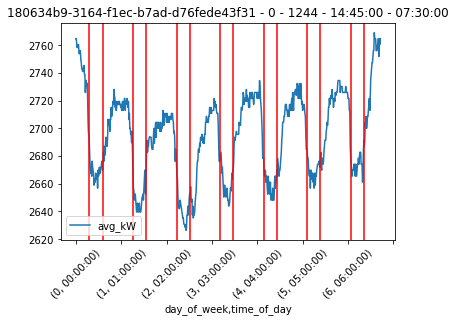

<Figure size 1080x288 with 0 Axes>

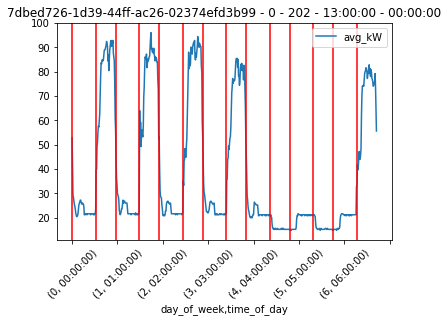

<Figure size 1080x288 with 0 Axes>

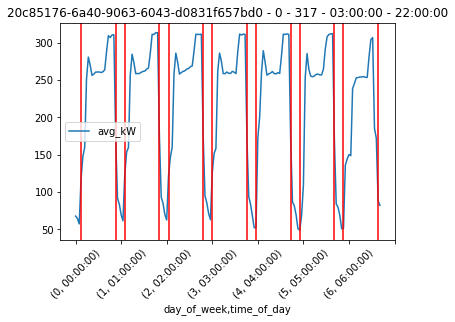

<Figure size 1080x288 with 0 Axes>

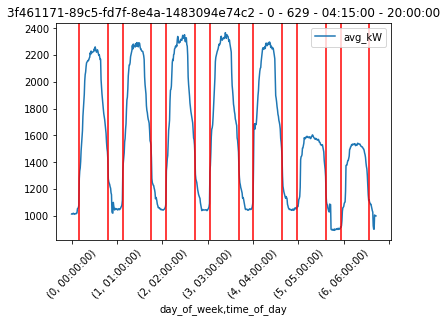

<Figure size 1080x288 with 0 Axes>

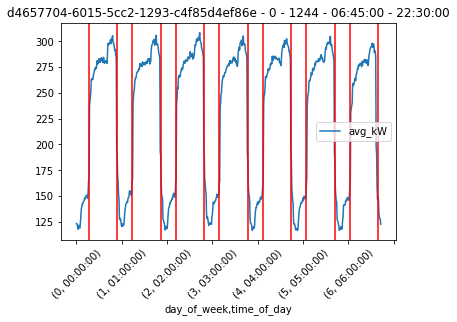

<Figure size 1080x288 with 0 Axes>

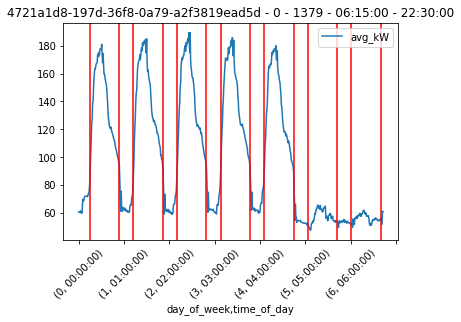

<Figure size 1080x288 with 0 Axes>

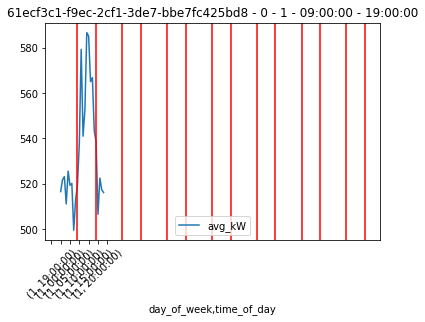

<Figure size 1080x288 with 0 Axes>

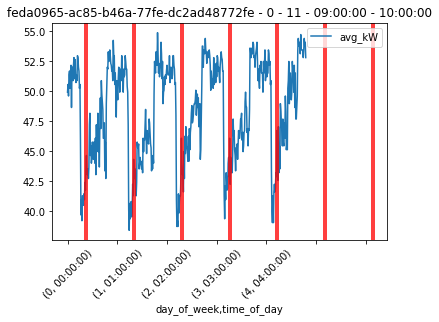

<Figure size 1080x288 with 0 Axes>

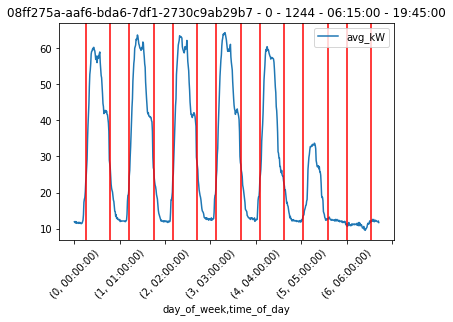

<Figure size 1080x288 with 0 Axes>

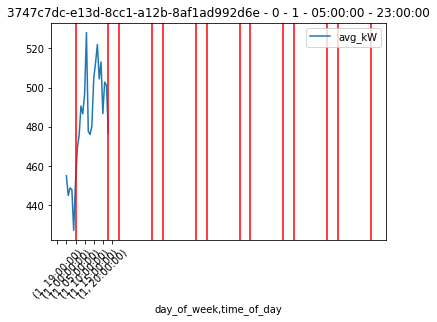

<Figure size 1080x288 with 0 Axes>

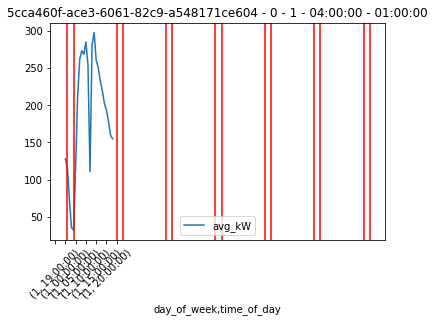

<Figure size 1080x288 with 0 Axes>

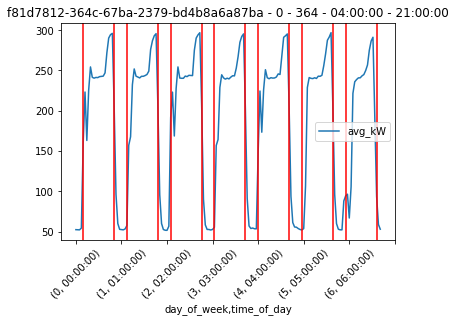

<Figure size 1080x288 with 0 Axes>

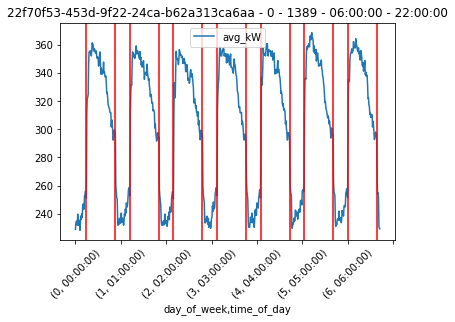

<Figure size 1080x288 with 0 Axes>

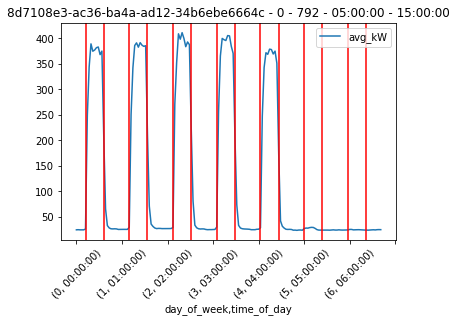

<Figure size 1080x288 with 0 Axes>

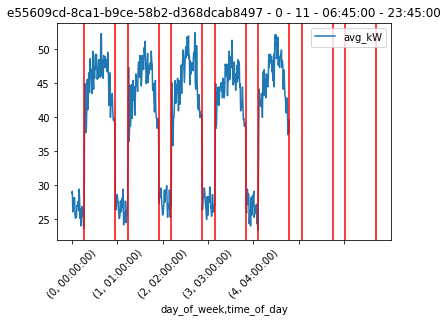

<Figure size 1080x288 with 0 Axes>

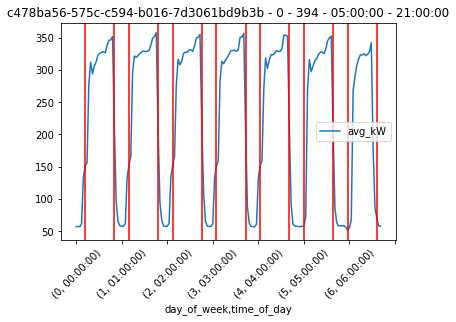

<Figure size 1080x288 with 0 Axes>

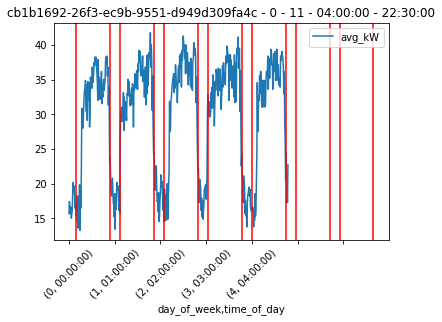

<Figure size 1080x288 with 0 Axes>

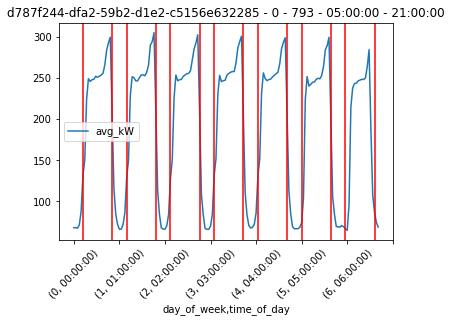

<Figure size 1080x288 with 0 Axes>

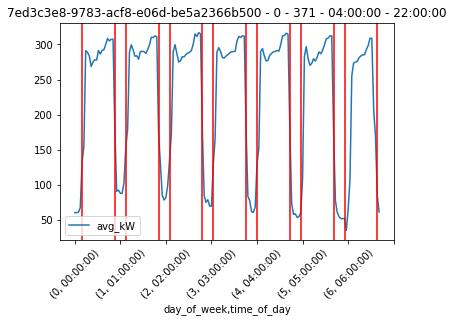

<Figure size 1080x288 with 0 Axes>

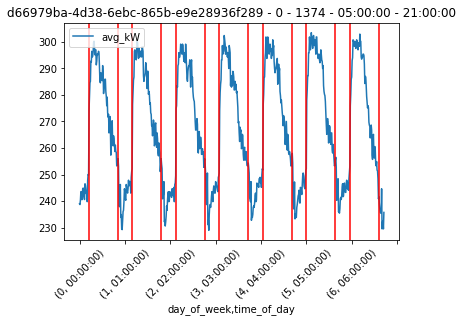

<Figure size 1080x288 with 0 Axes>

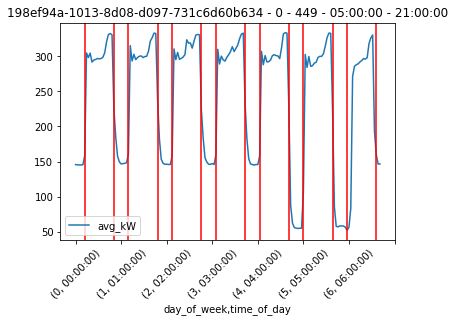

<Figure size 1080x288 with 0 Axes>

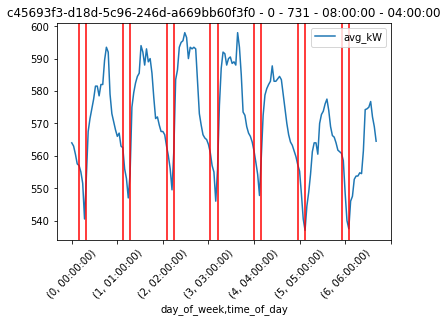

<Figure size 1080x288 with 0 Axes>

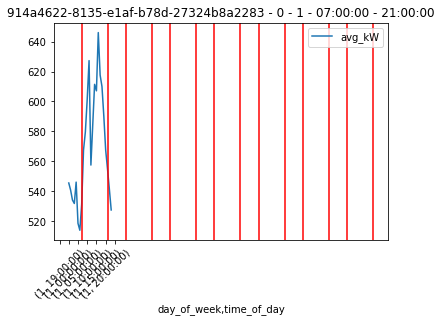

<Figure size 1080x288 with 0 Axes>

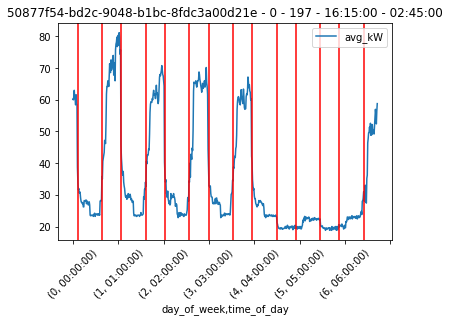

<Figure size 1080x288 with 0 Axes>

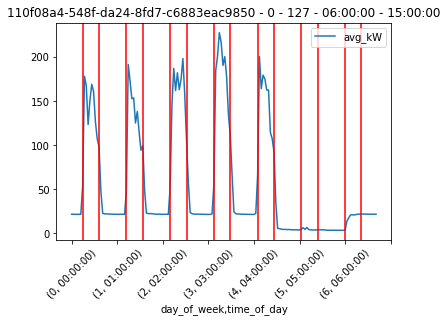

<Figure size 1080x288 with 0 Axes>

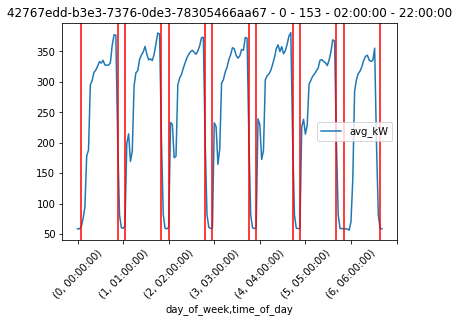

<Figure size 1080x288 with 0 Axes>

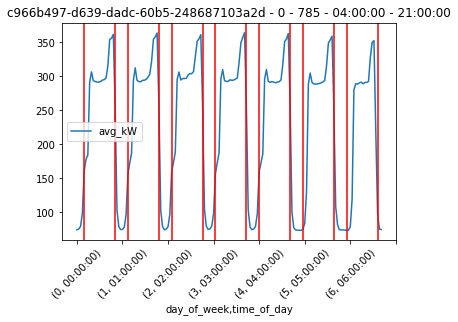

<Figure size 1080x288 with 0 Axes>

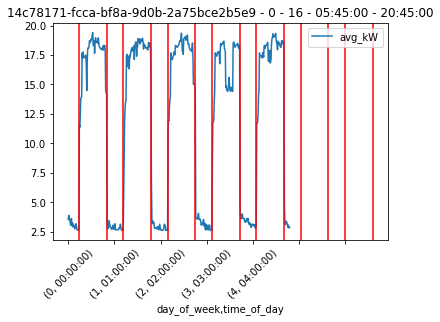

<Figure size 1080x288 with 0 Axes>

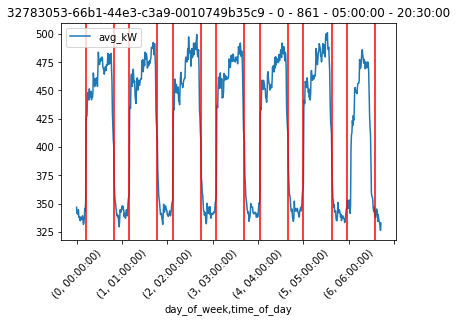

<Figure size 1080x288 with 0 Axes>

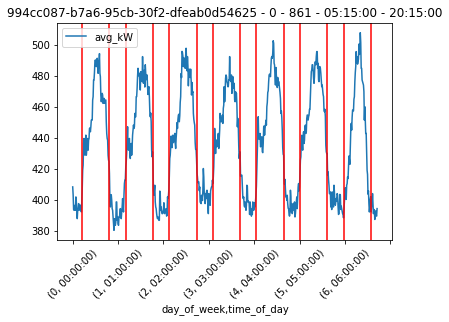

<Figure size 1080x288 with 0 Axes>

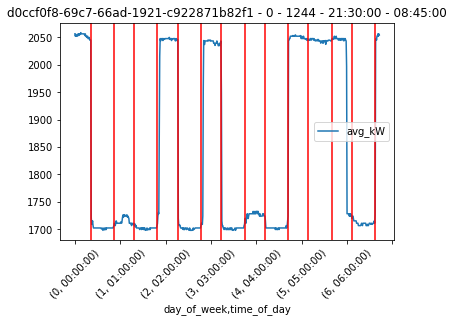

<Figure size 1080x288 with 0 Axes>

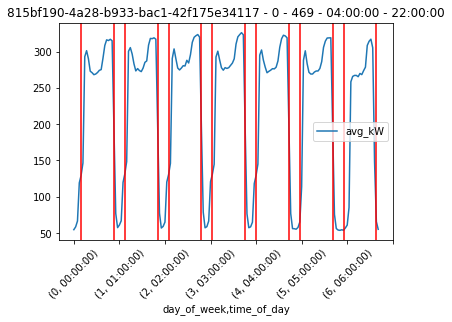

<Figure size 1080x288 with 0 Axes>

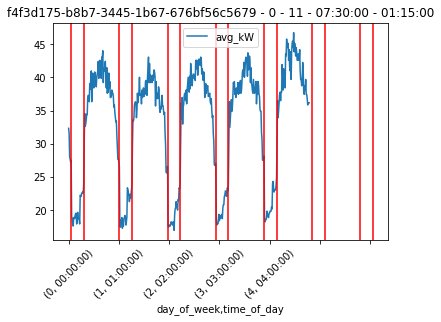

<Figure size 1080x288 with 0 Axes>

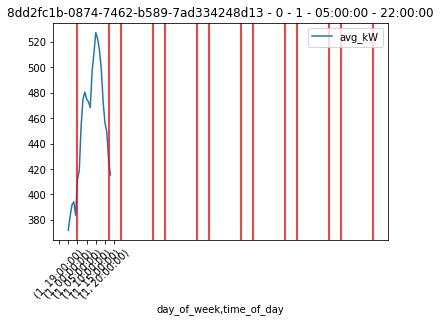

<Figure size 1080x288 with 0 Axes>

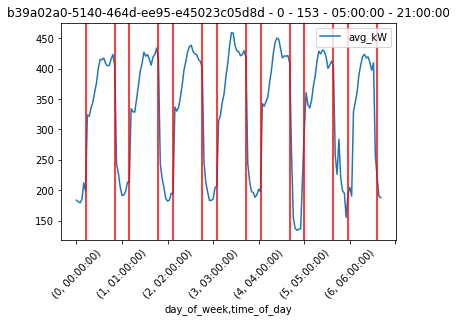

<Figure size 1080x288 with 0 Axes>

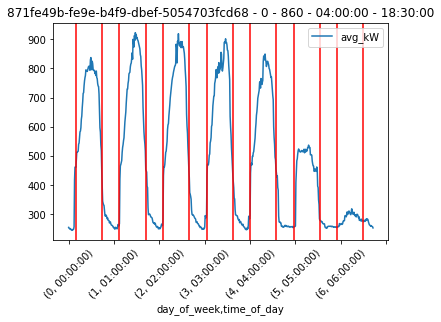

<Figure size 1080x288 with 0 Axes>

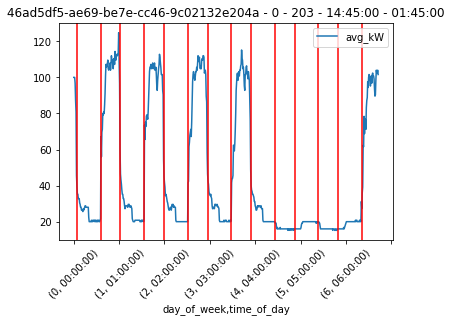

<Figure size 1080x288 with 0 Axes>

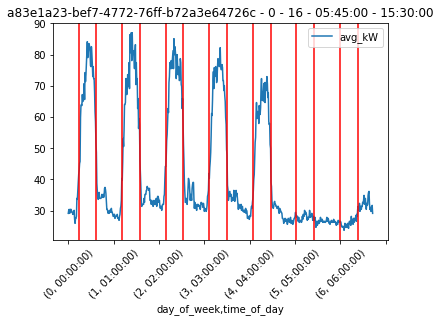

<Figure size 1080x288 with 0 Axes>

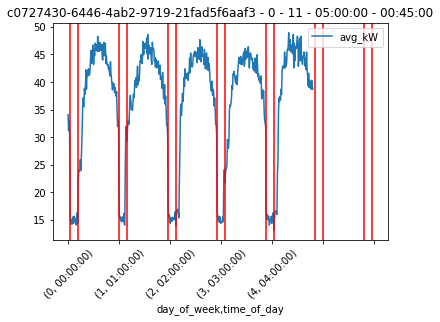

<Figure size 1080x288 with 0 Axes>

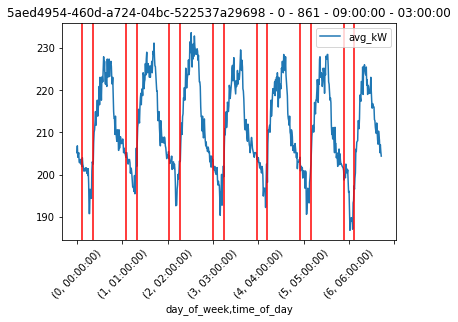

<Figure size 1080x288 with 0 Axes>

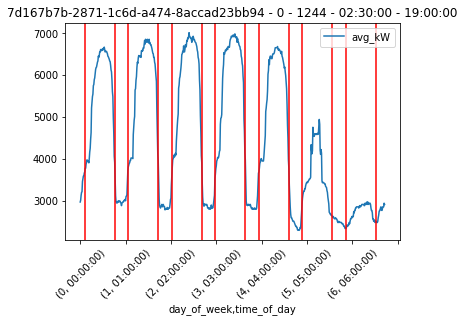

<Figure size 1080x288 with 0 Axes>

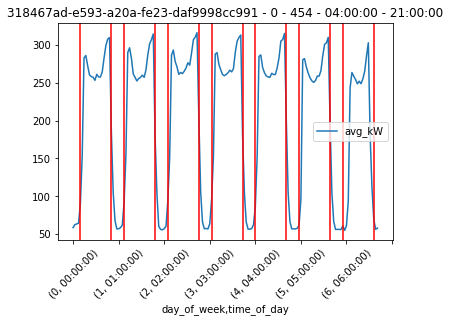

<Figure size 1080x288 with 0 Axes>

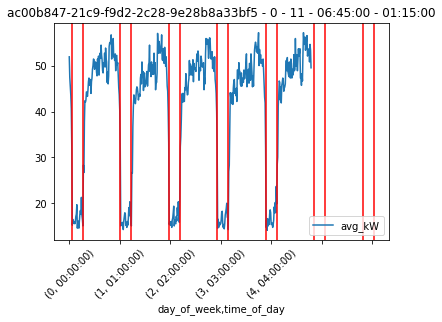

<Figure size 1080x288 with 0 Axes>

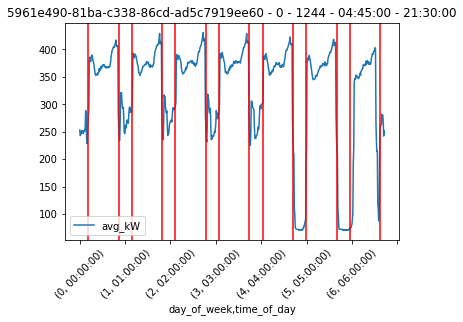

<Figure size 1080x288 with 0 Axes>

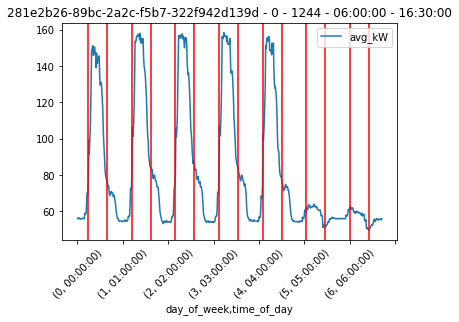

<Figure size 1080x288 with 0 Axes>

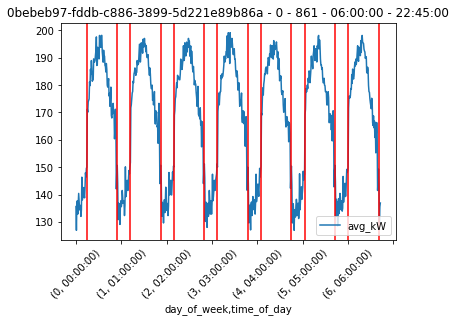

<Figure size 1080x288 with 0 Axes>

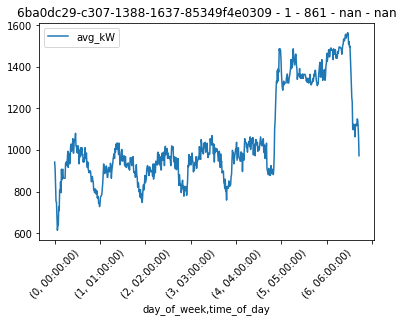

<Figure size 1080x288 with 0 Axes>

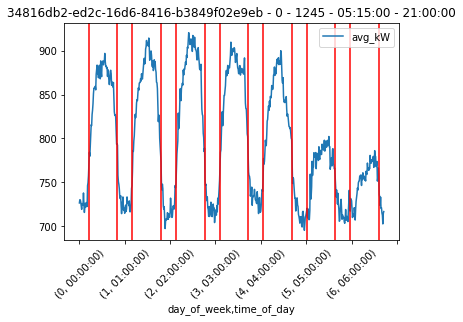

<Figure size 1080x288 with 0 Axes>

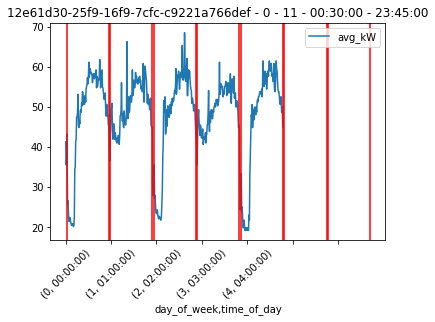

<Figure size 1080x288 with 0 Axes>

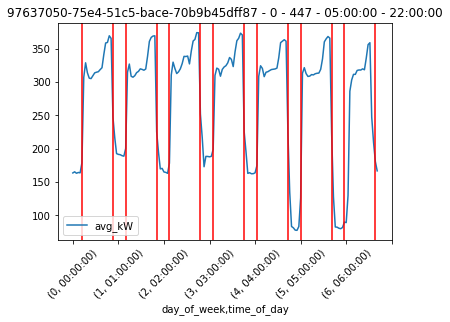

<Figure size 1080x288 with 0 Axes>

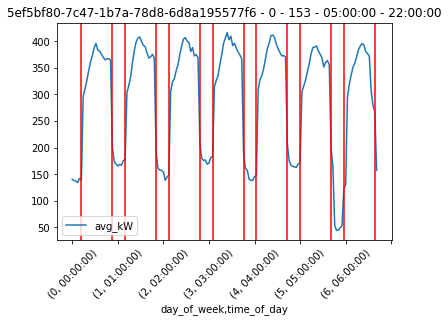

<Figure size 1080x288 with 0 Axes>

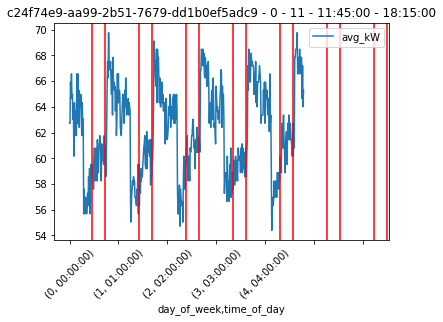

<Figure size 1080x288 with 0 Axes>

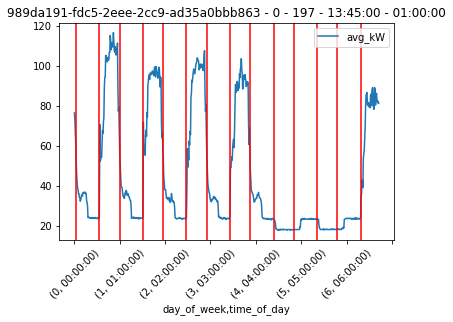

<Figure size 1080x288 with 0 Axes>

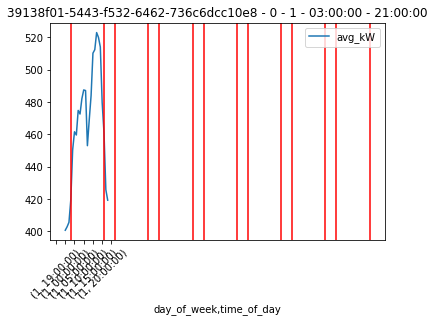

<Figure size 1080x288 with 0 Axes>

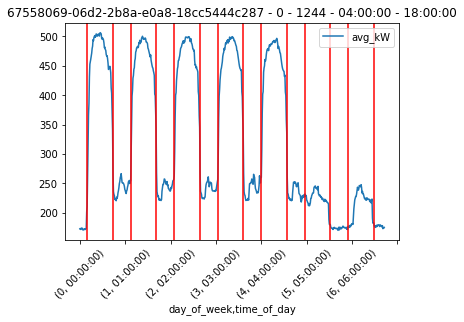

<Figure size 1080x288 with 0 Axes>

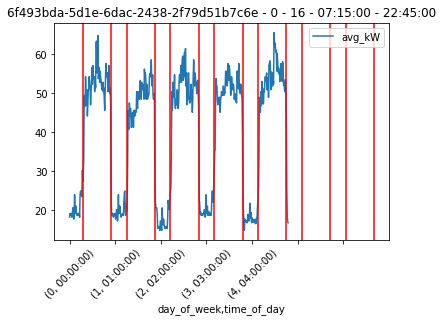

<Figure size 1080x288 with 0 Axes>

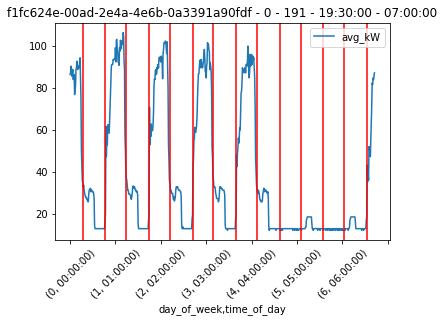

<Figure size 1080x288 with 0 Axes>

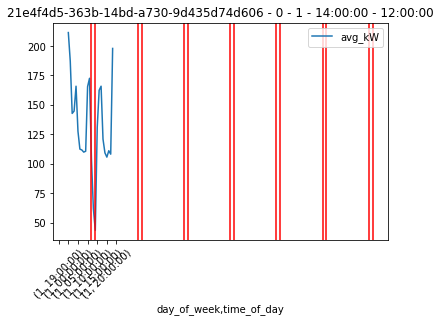

<Figure size 1080x288 with 0 Axes>

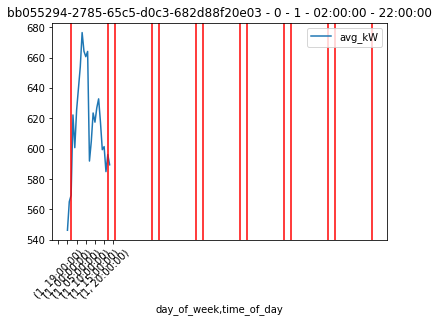

<Figure size 1080x288 with 0 Axes>

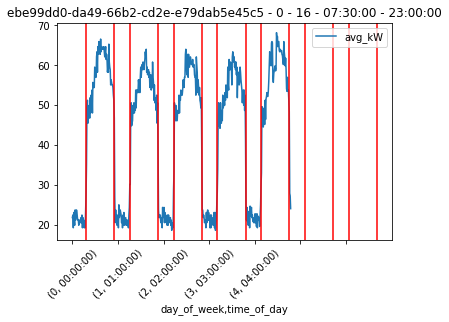

<Figure size 1080x288 with 0 Axes>

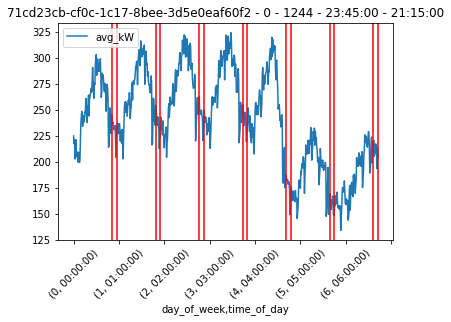

<Figure size 1080x288 with 0 Axes>

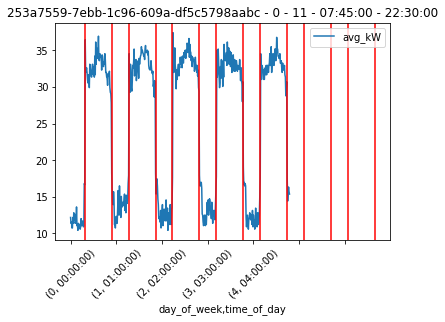

<Figure size 1080x288 with 0 Axes>

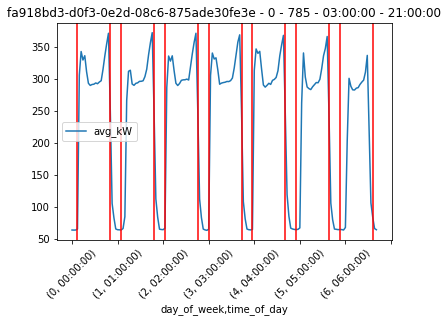

<Figure size 1080x288 with 0 Axes>

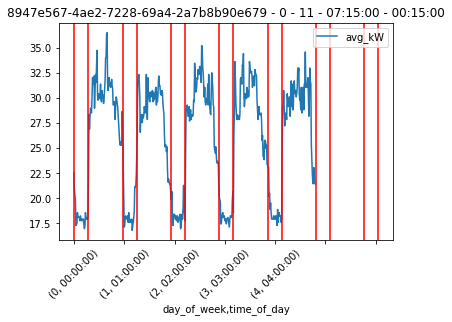

<Figure size 1080x288 with 0 Axes>

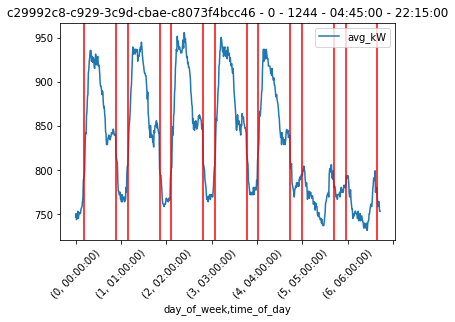

<Figure size 1080x288 with 0 Axes>

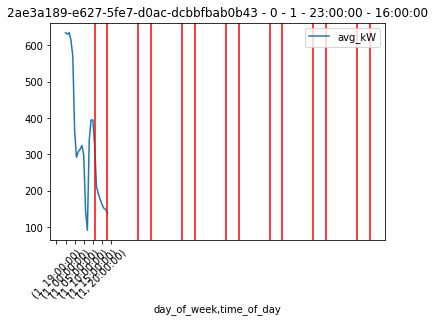

<Figure size 1080x288 with 0 Axes>

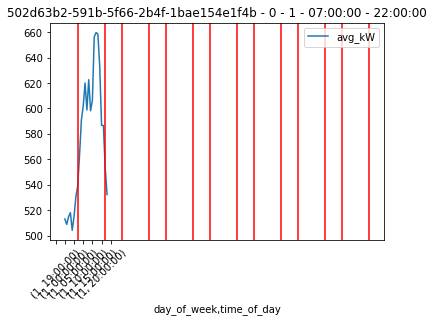

<Figure size 1080x288 with 0 Axes>

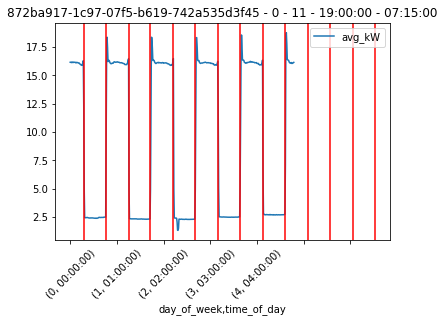

<Figure size 1080x288 with 0 Axes>

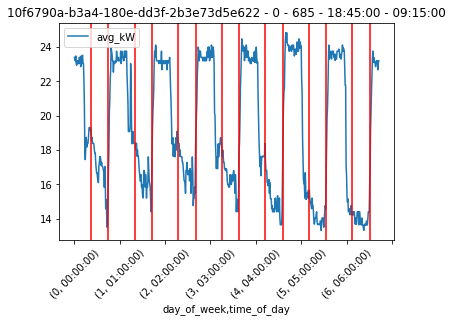

<Figure size 1080x288 with 0 Axes>

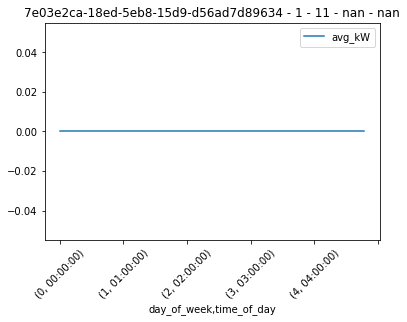

<Figure size 1080x288 with 0 Axes>

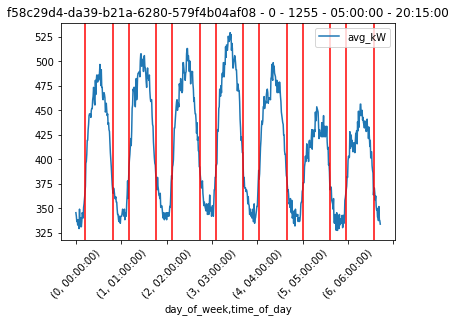

<Figure size 1080x288 with 0 Axes>

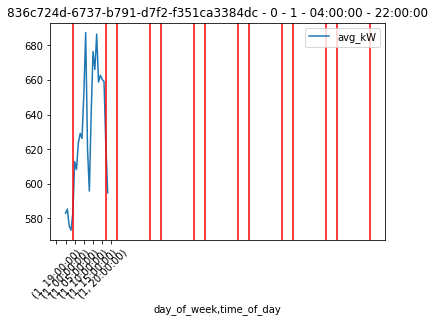

<Figure size 1080x288 with 0 Axes>

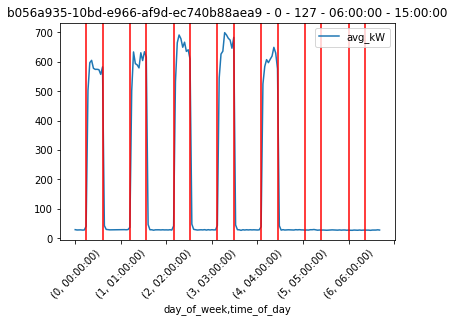

<Figure size 1080x288 with 0 Axes>

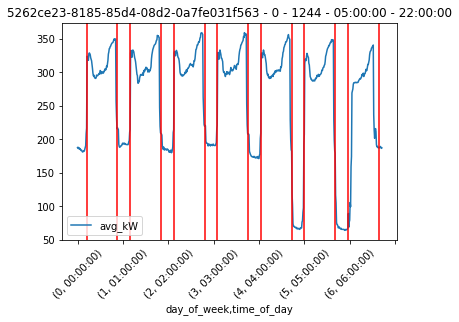

<Figure size 1080x288 with 0 Axes>

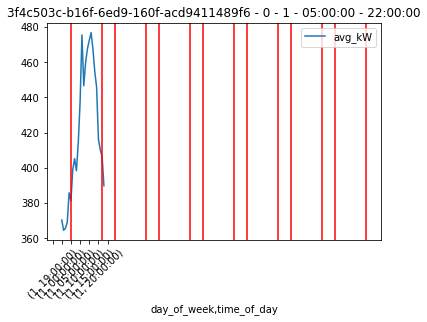

<Figure size 1080x288 with 0 Axes>

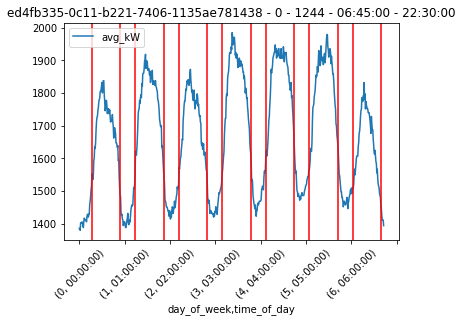

<Figure size 1080x288 with 0 Axes>

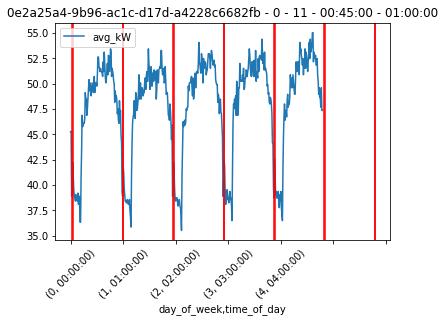

<Figure size 1080x288 with 0 Axes>

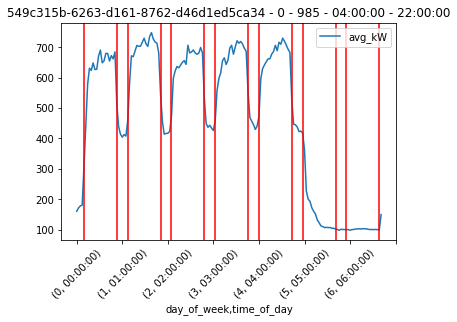

<Figure size 1080x288 with 0 Axes>

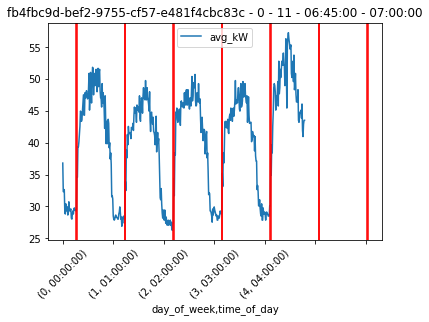

<Figure size 1080x288 with 0 Axes>

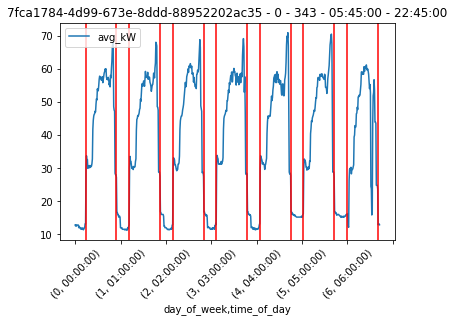

<Figure size 1080x288 with 0 Axes>

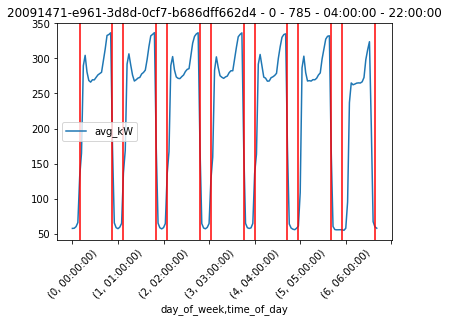

<Figure size 1080x288 with 0 Axes>

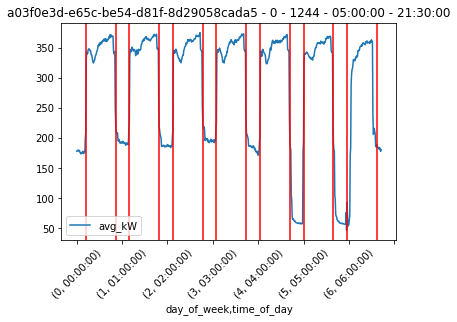

<Figure size 1080x288 with 0 Axes>

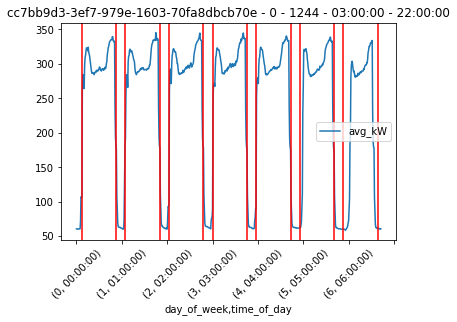

<Figure size 1080x288 with 0 Axes>

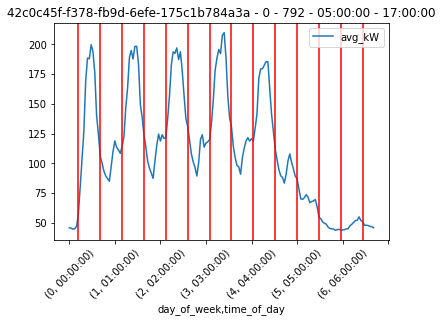

<Figure size 1080x288 with 0 Axes>

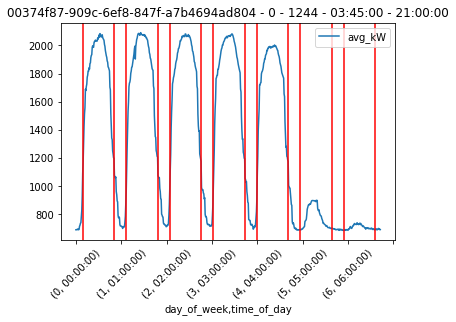

<Figure size 1080x288 with 0 Axes>

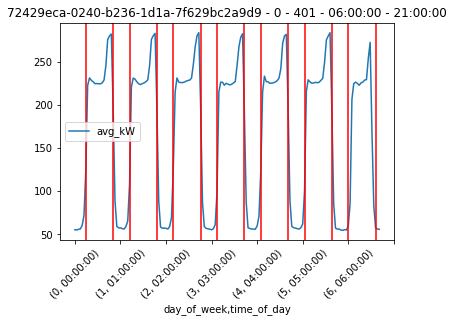

<Figure size 1080x288 with 0 Axes>

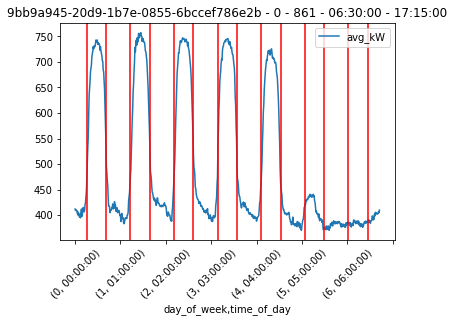

<Figure size 1080x288 with 0 Axes>

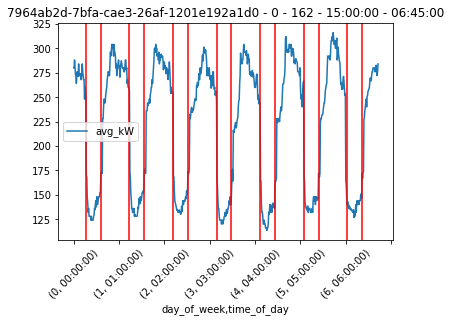

<Figure size 1080x288 with 0 Axes>

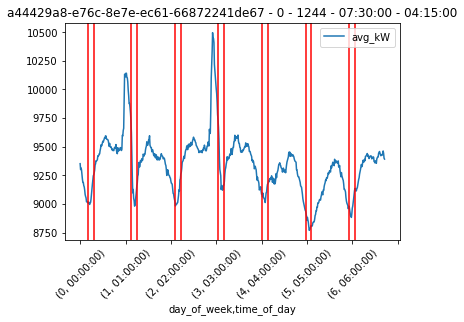

<Figure size 1080x288 with 0 Axes>

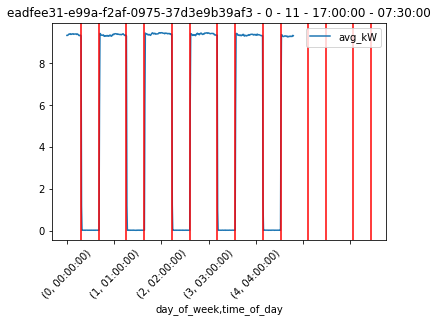

<Figure size 1080x288 with 0 Axes>

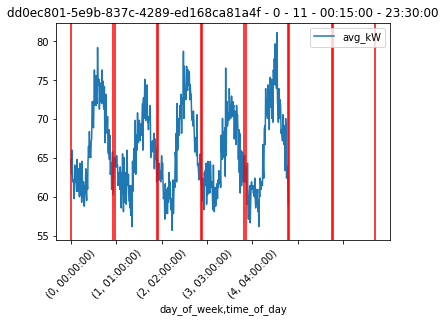

<Figure size 1080x288 with 0 Axes>

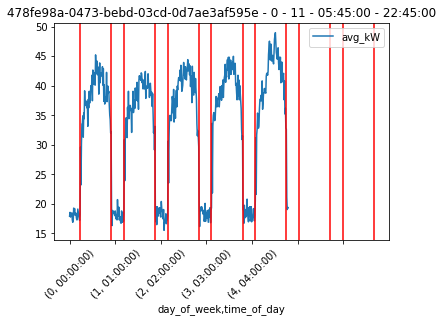

<Figure size 1080x288 with 0 Axes>

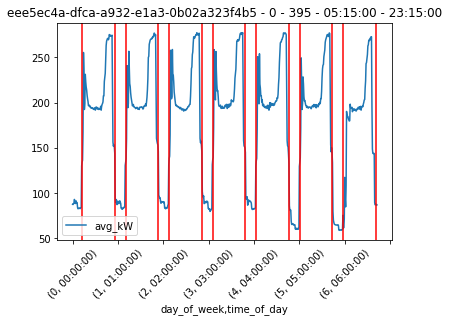

<Figure size 1080x288 with 0 Axes>

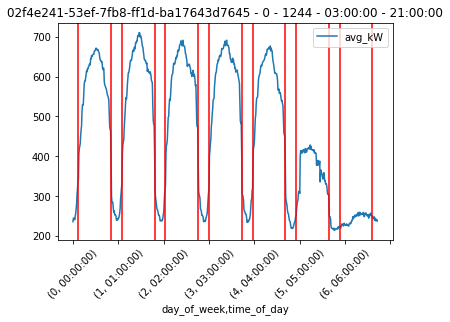

<Figure size 1080x288 with 0 Axes>

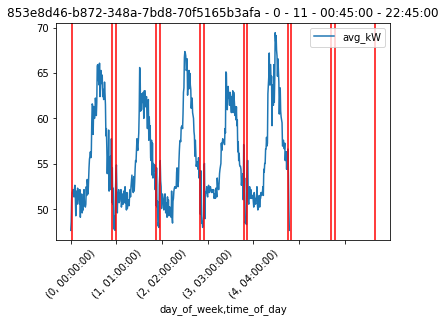

<Figure size 1080x288 with 0 Axes>

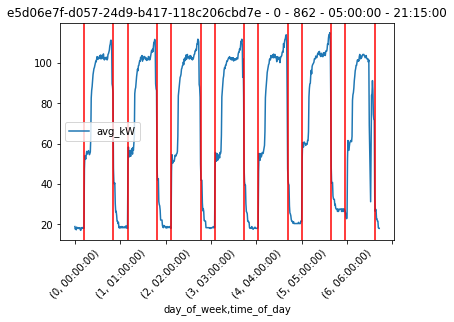

<Figure size 1080x288 with 0 Axes>

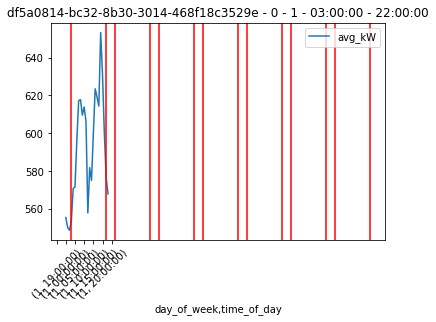

<Figure size 1080x288 with 0 Axes>

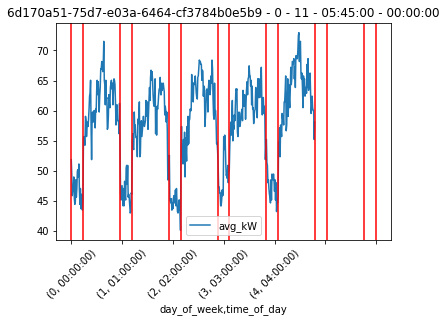

<Figure size 1080x288 with 0 Axes>

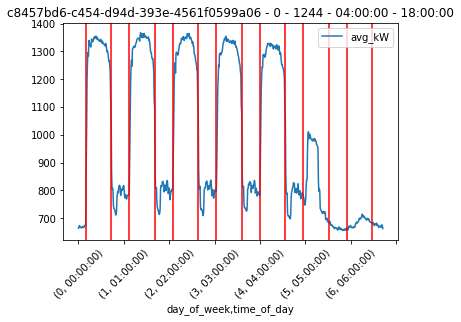

<Figure size 1080x288 with 0 Axes>

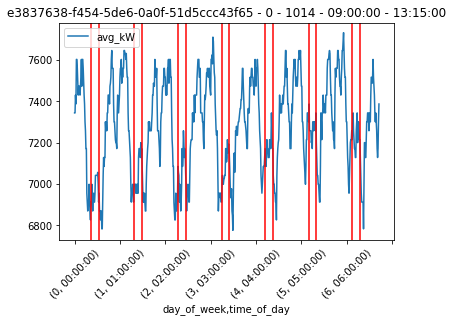

<Figure size 1080x288 with 0 Axes>

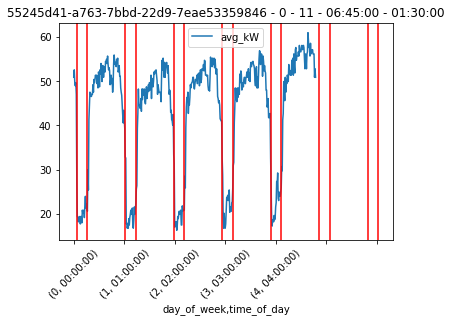

<Figure size 1080x288 with 0 Axes>

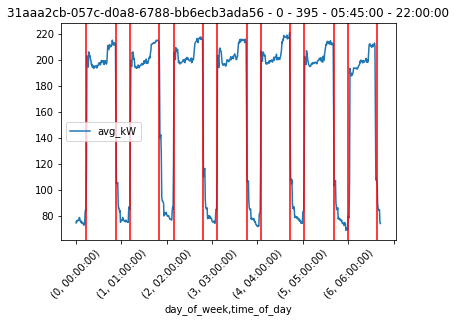

<Figure size 1080x288 with 0 Axes>

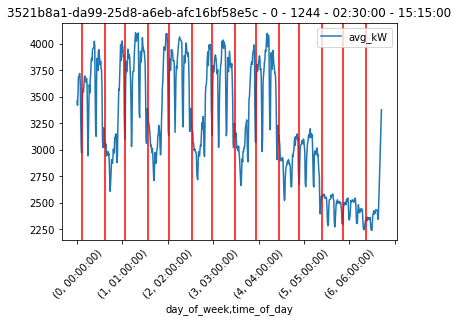

<Figure size 1080x288 with 0 Axes>

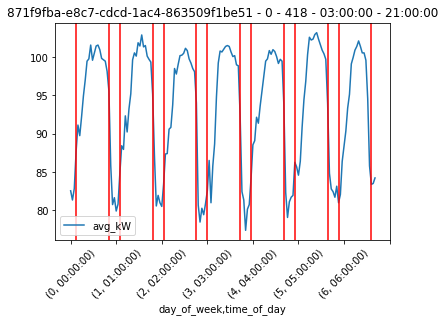

<Figure size 1080x288 with 0 Axes>

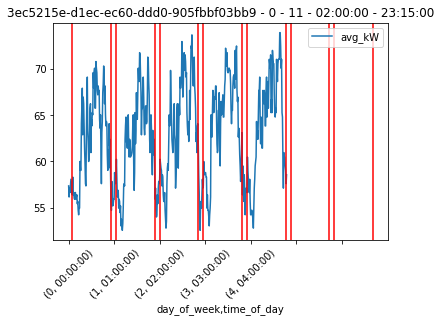

<Figure size 1080x288 with 0 Axes>

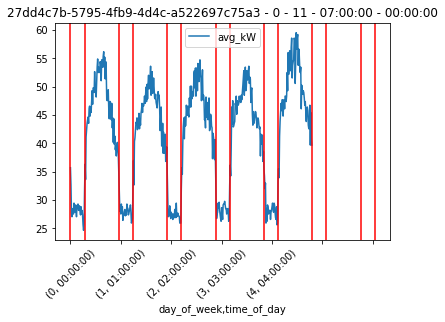

<Figure size 1080x288 with 0 Axes>

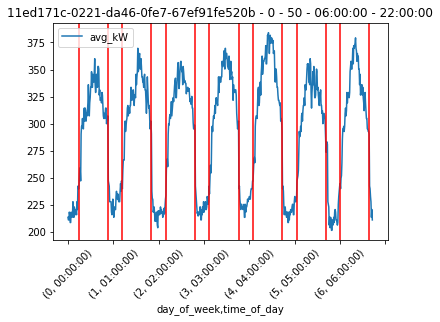

<Figure size 1080x288 with 0 Axes>

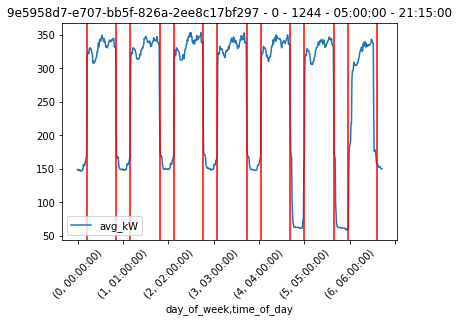

<Figure size 1080x288 with 0 Axes>

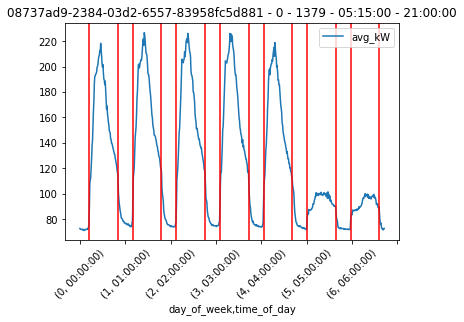

<Figure size 1080x288 with 0 Axes>

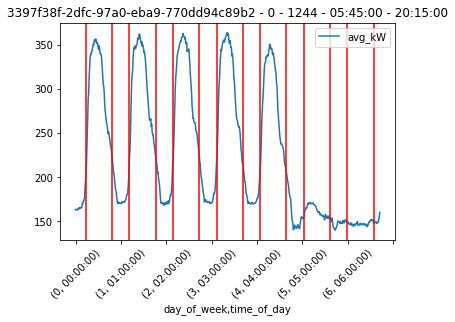

<Figure size 1080x288 with 0 Axes>

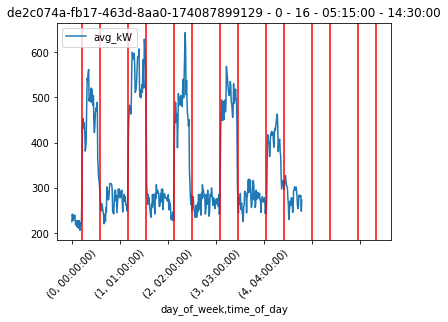

<Figure size 1080x288 with 0 Axes>

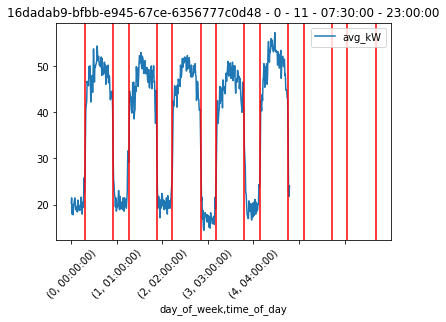

<Figure size 1080x288 with 0 Axes>

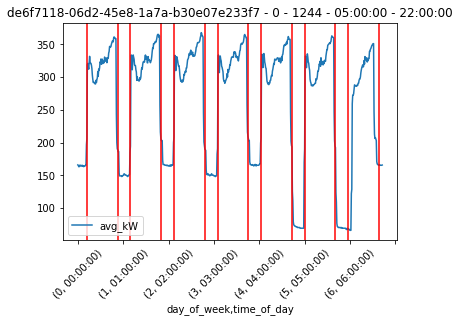

<Figure size 1080x288 with 0 Axes>

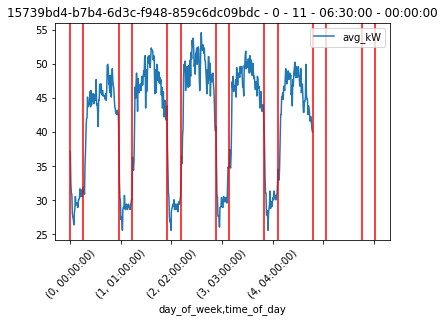

<Figure size 1080x288 with 0 Axes>

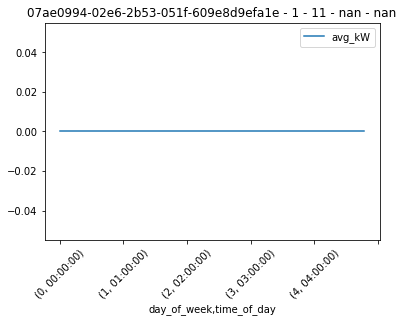

<Figure size 1080x288 with 0 Axes>

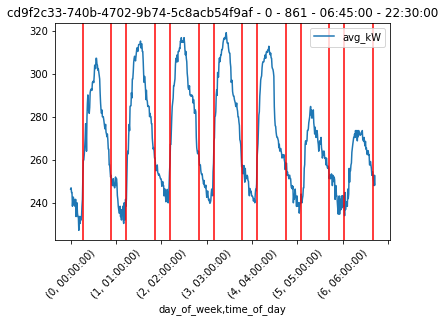

<Figure size 1080x288 with 0 Axes>

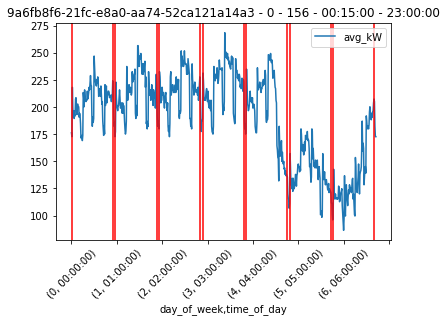

<Figure size 1080x288 with 0 Axes>

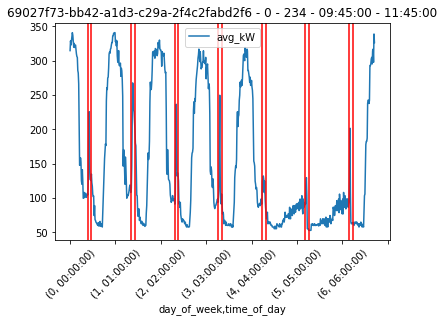

<Figure size 1080x288 with 0 Axes>

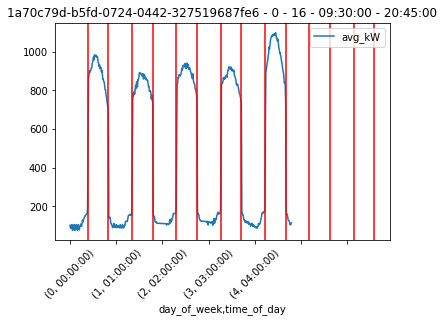

<Figure size 1080x288 with 0 Axes>

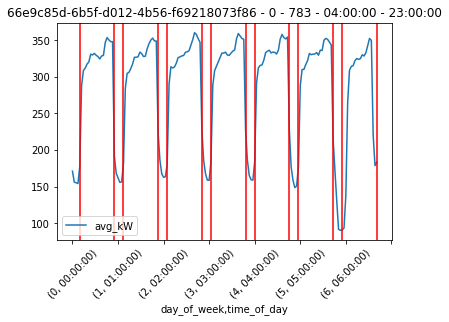

<Figure size 1080x288 with 0 Axes>

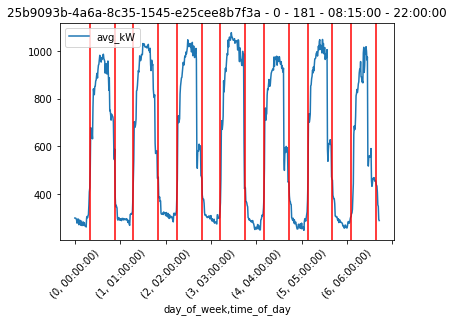

<Figure size 1080x288 with 0 Axes>

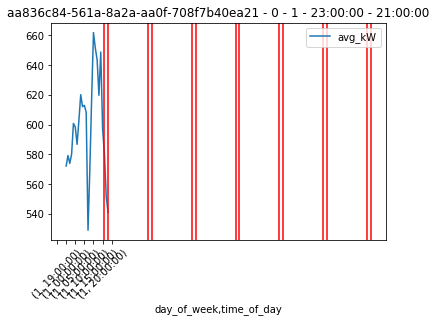

<Figure size 1080x288 with 0 Axes>

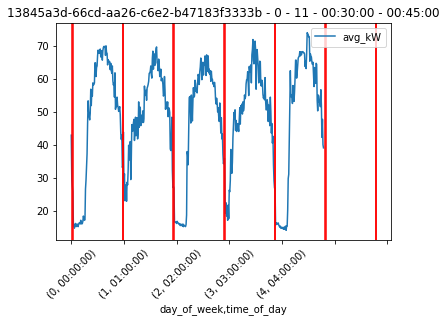

<Figure size 1080x288 with 0 Axes>

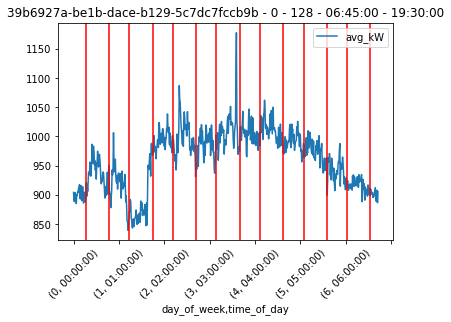

<Figure size 1080x288 with 0 Axes>

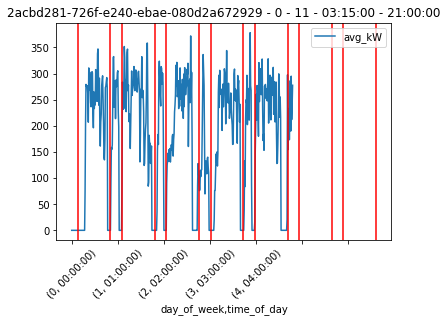

<Figure size 1080x288 with 0 Axes>

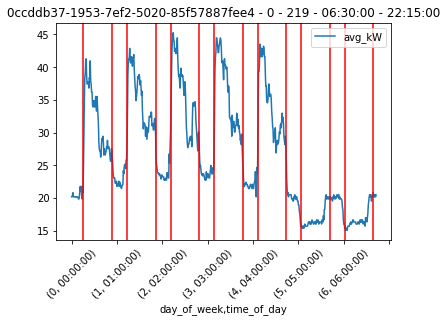

<Figure size 1080x288 with 0 Axes>

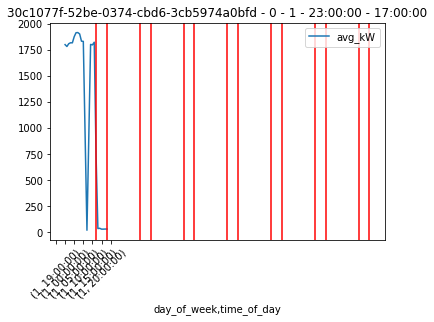

<Figure size 1080x288 with 0 Axes>

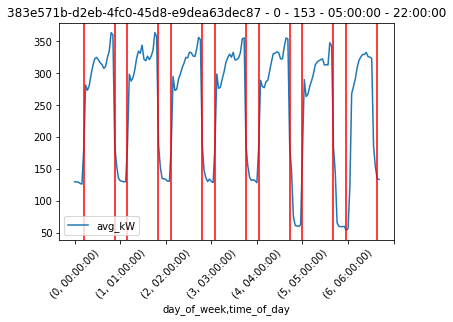

<Figure size 1080x288 with 0 Axes>

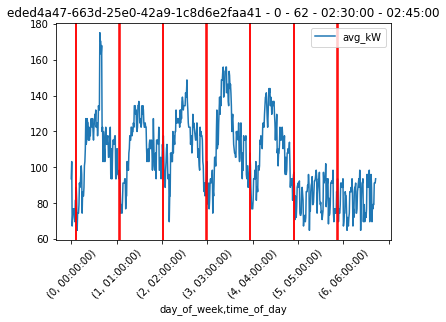

<Figure size 1080x288 with 0 Axes>

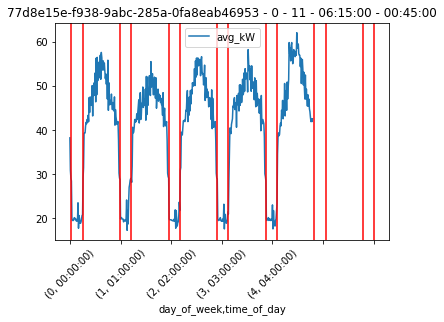

<Figure size 1080x288 with 0 Axes>

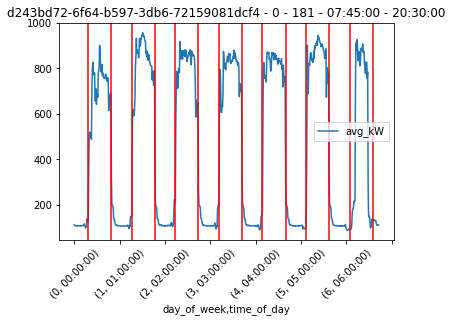

<Figure size 1080x288 with 0 Axes>

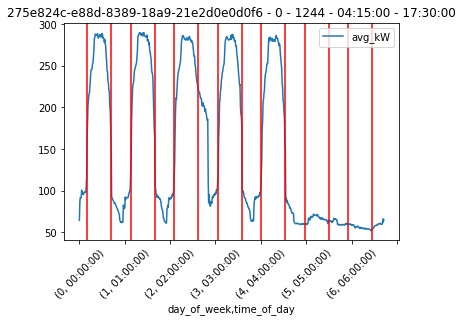

<Figure size 1080x288 with 0 Axes>

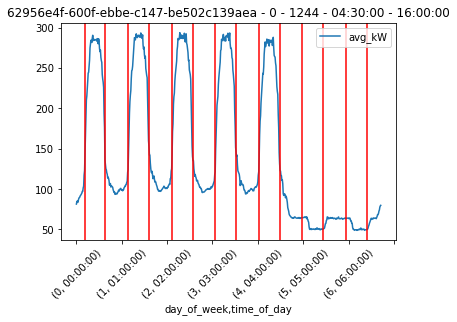

<Figure size 1080x288 with 0 Axes>

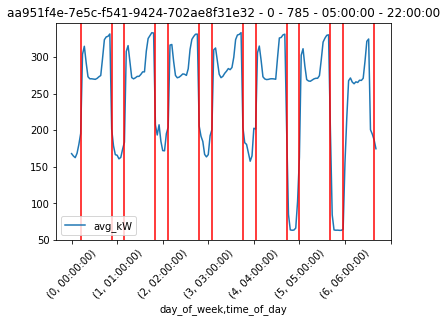

<Figure size 1080x288 with 0 Axes>

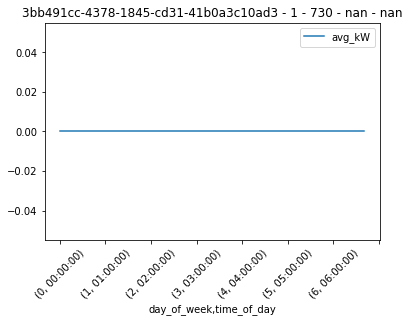

<Figure size 1080x288 with 0 Axes>

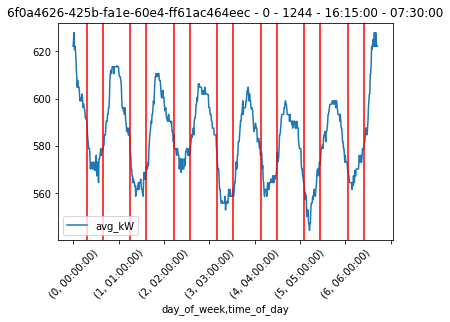

<Figure size 1080x288 with 0 Axes>

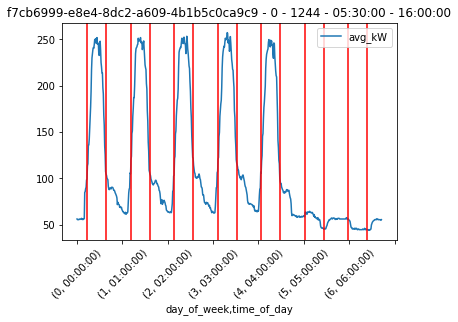

<Figure size 1080x288 with 0 Axes>

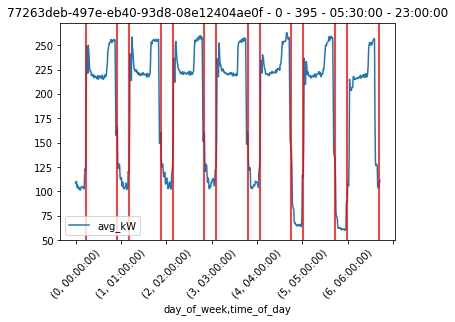

<Figure size 1080x288 with 0 Axes>

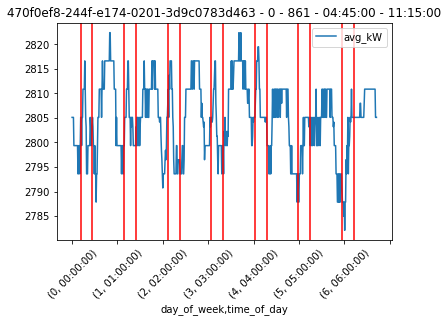

<Figure size 1080x288 with 0 Axes>

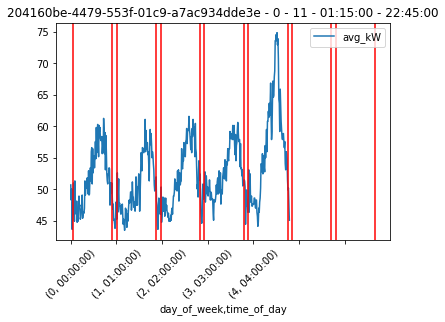

<Figure size 1080x288 with 0 Axes>

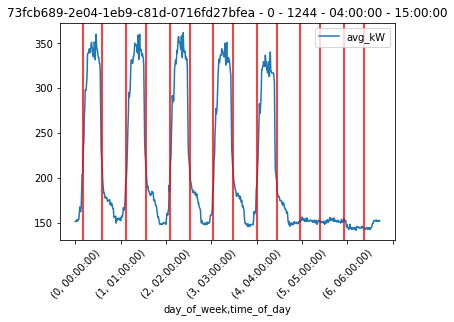

<Figure size 1080x288 with 0 Axes>

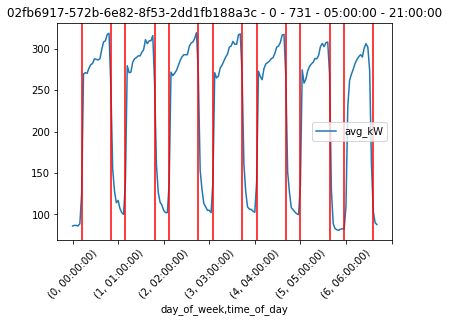

<Figure size 1080x288 with 0 Axes>

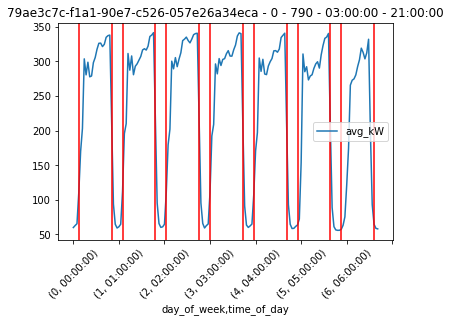

<Figure size 1080x288 with 0 Axes>

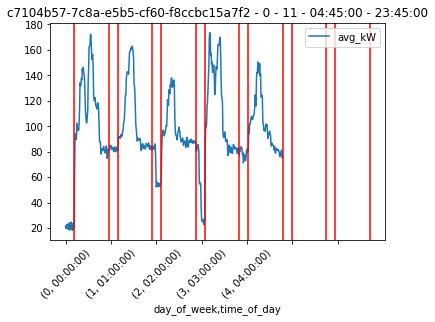

<Figure size 1080x288 with 0 Axes>

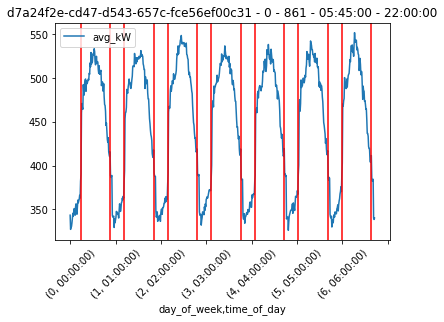

<Figure size 1080x288 with 0 Axes>

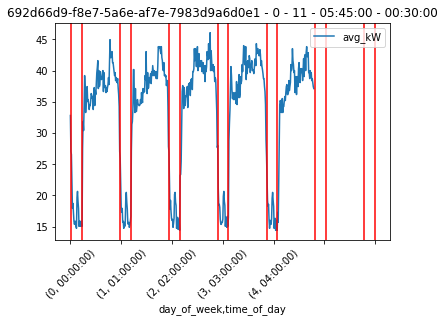

<Figure size 1080x288 with 0 Axes>

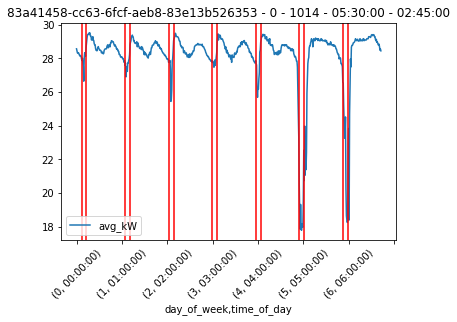

<Figure size 1080x288 with 0 Axes>

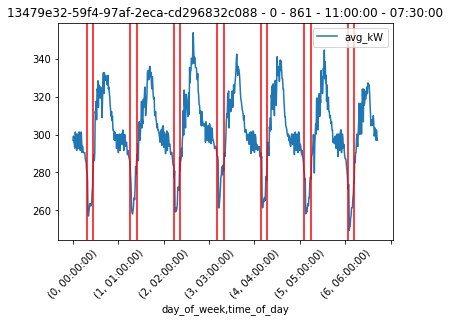

<Figure size 1080x288 with 0 Axes>

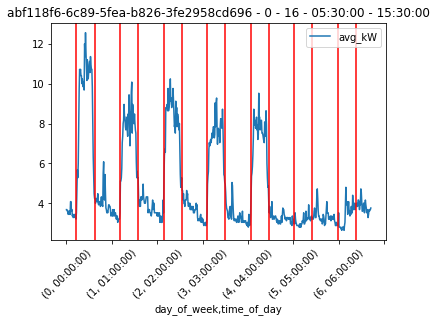

<Figure size 1080x288 with 0 Axes>

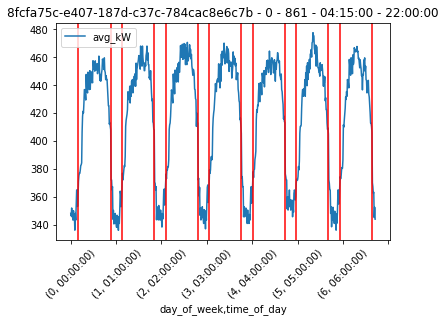

<Figure size 1080x288 with 0 Axes>

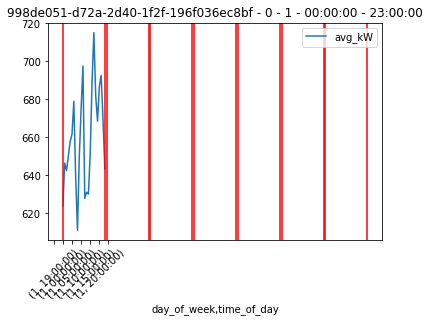

<Figure size 1080x288 with 0 Axes>

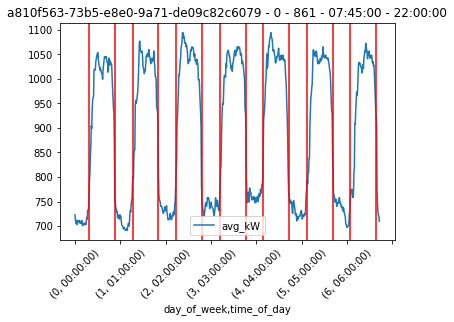

<Figure size 1080x288 with 0 Axes>

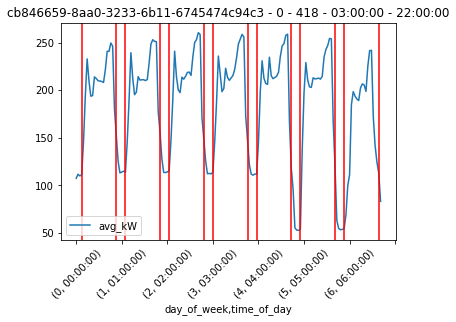

<Figure size 1080x288 with 0 Axes>

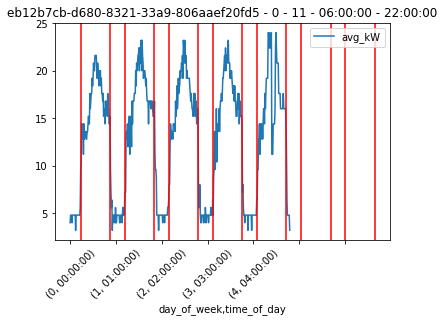

<Figure size 1080x288 with 0 Axes>

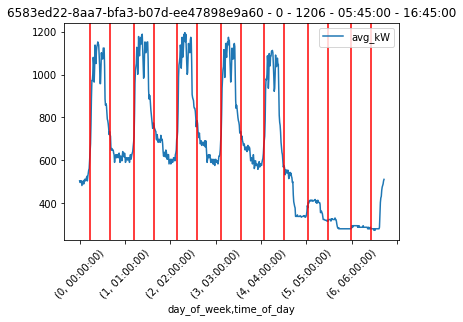

<Figure size 1080x288 with 0 Axes>

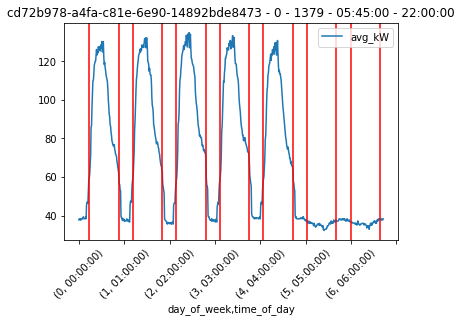

<Figure size 1080x288 with 0 Axes>

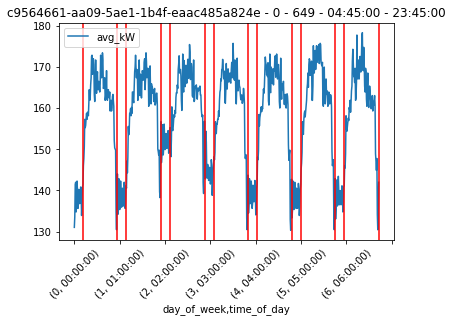

<Figure size 1080x288 with 0 Axes>

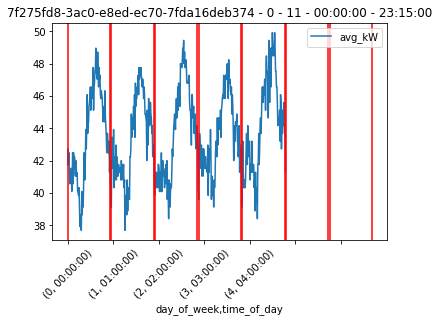

<Figure size 1080x288 with 0 Axes>

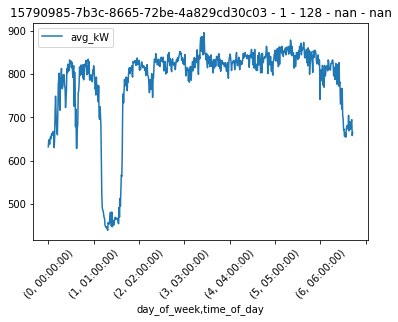

<Figure size 1080x288 with 0 Axes>

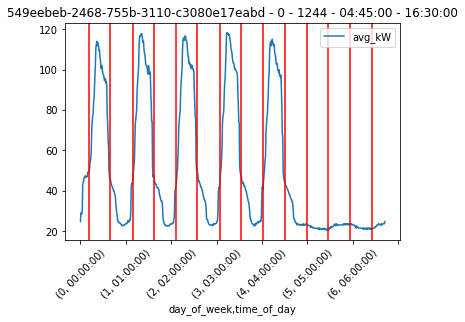

<Figure size 1080x288 with 0 Axes>

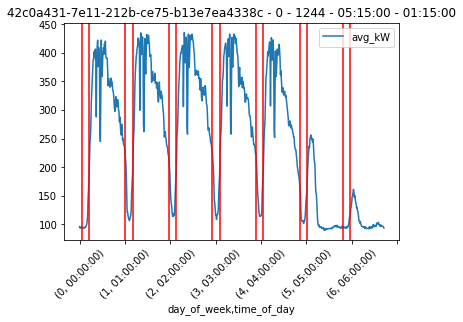

<Figure size 1080x288 with 0 Axes>

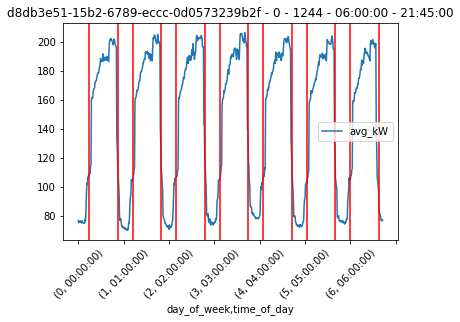

<Figure size 1080x288 with 0 Axes>

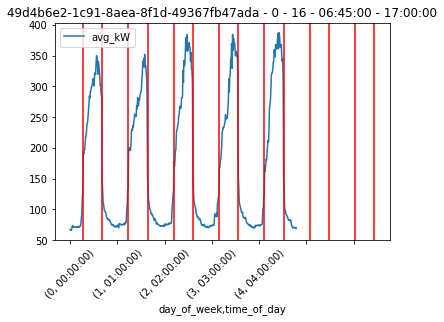

<Figure size 1080x288 with 0 Axes>

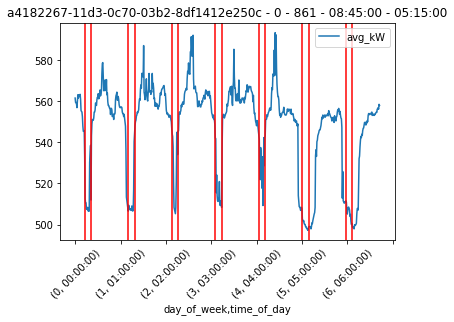

<Figure size 1080x288 with 0 Axes>

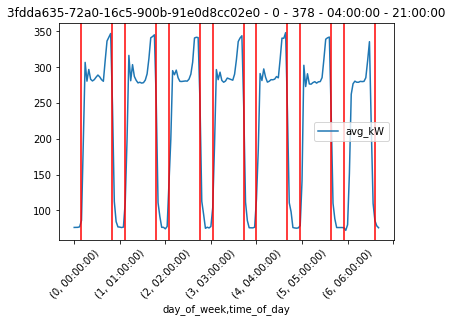

<Figure size 1080x288 with 0 Axes>

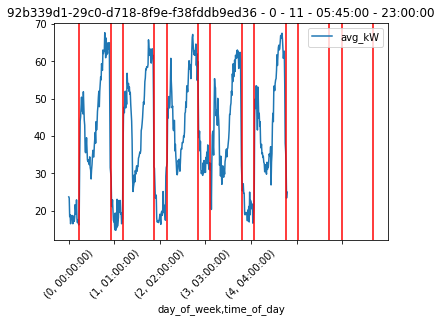

<Figure size 1080x288 with 0 Axes>

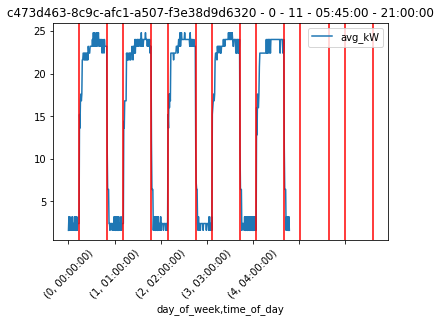

<Figure size 1080x288 with 0 Axes>

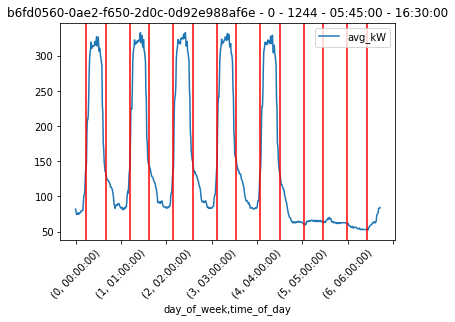

<Figure size 1080x288 with 0 Axes>

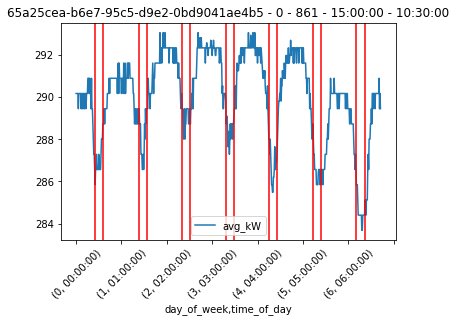

<Figure size 1080x288 with 0 Axes>

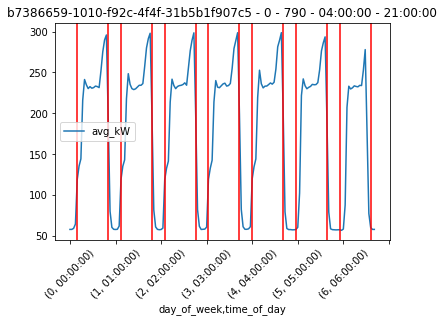

<Figure size 1080x288 with 0 Axes>

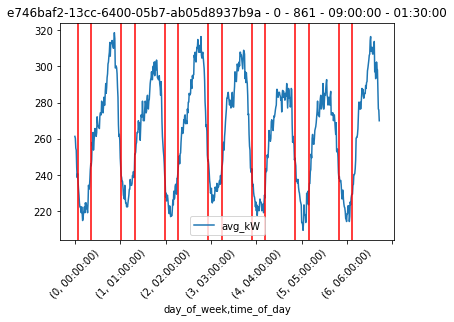

<Figure size 1080x288 with 0 Axes>

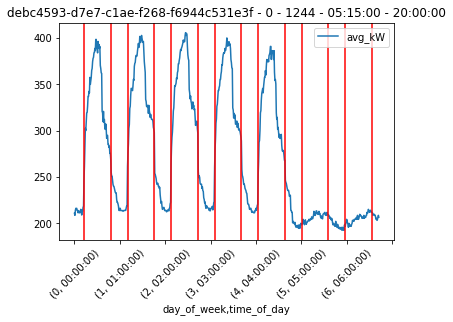

<Figure size 1080x288 with 0 Axes>

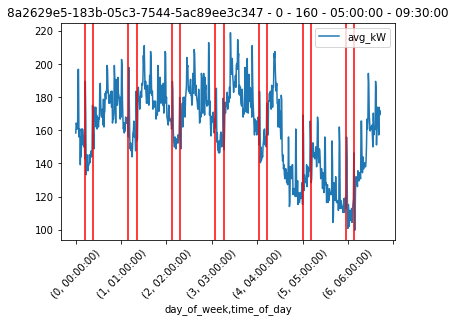

<Figure size 1080x288 with 0 Axes>

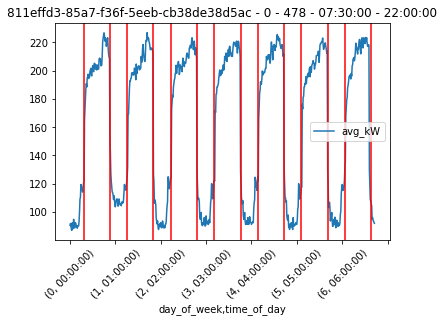

<Figure size 1080x288 with 0 Axes>

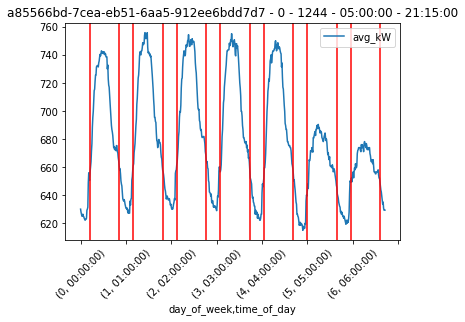

<Figure size 1080x288 with 0 Axes>

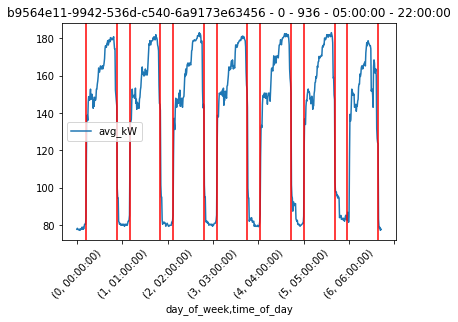

In [377]:
test_ops_data = plot_site_operating_status(all_data_df, site_list)

In [378]:
plt.close('all')

In [383]:
def day_plot_site_operating_status(site_data_df, site_id_list):
    """
    Given site-level Average kW time series', categorize the sites as 
    operating continuously or not, determine daily start/stop if
    not continuously operating, and produce various other load profile
    parameters in the form of a dataframe where each row has information
    for a given site.
    """
    ops_data = pd.DataFrame()
    for site in site_id_list:
#         print(site)
        working_df = site_data_df.loc[site_data_df['site_id'] == site]
        width = working_df['interval_width'].mean()
        if width.is_integer():
            working_ts = working_df.set_index('interval_end', drop=False)
            working_ts.dropna(inplace=True)
        else:
            working_ts = hourly_resample(working_df, site)
            width = 3600
        # creating a weekly time series made up of the median for each time period
        working_week = aggregate_week_ts(working_ts)
        # calculating near_peak_load and near_base_load parameters
        # as well as reference parameter variables for evaluating operating days
        working_week = week_load_profile_params(working_week)
        ref_peak = working_week['near_peak_load'].max()
        ref_base = working_week['near_base_load'].min()
        days_index = working_week.index.get_level_values(0).unique()
        ops_params = agg_week_operating_day(working_week,
                                            days_index,
                                            ref_peak,
                                            ref_base,
                                            p_threshold=0.05)
        working_day, ops_params = plt_operating_start_stop(working_week, ops_params)
        
        site_ops_data = pd.DataFrame(ops_params, index=[site])
        ops_data = pd.concat([ops_data, site_ops_data])
        
        daily_intervals = 24 / (working_week['imputed_interval_width'].iloc[0] / 3600)
        days_in_data = str(int(working_ts.shape[0] / daily_intervals))
        plt.figure(figsize=[15, 4])
        working_day[['avg_kW']].plot()
#         working_week[['avg_kW']].plot()
        start_time = ops_params['daily_start']
        stop_time = ops_params['daily_stop']
        try:
            plt_start = list(working_day.index).index(start_time)
            plt_stop = list(working_day.index).index(stop_time)
            plt.gca().axvline(plt_start, color='r')
            plt.gca().axvline(plt_stop, color='r')
        except:
            pass
        plt.gca().set_title(site+' - '
                            +str(ops_params['continuous'])+' - '
                            +days_in_data+' - '
                            +str(start_time)+' - '
                            +str(stop_time))
        plt.xticks(rotation=45);
    plt.show();
    return ops_data

<Figure size 1080x288 with 0 Axes>

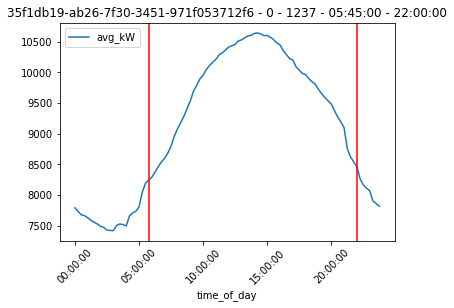

<Figure size 1080x288 with 0 Axes>

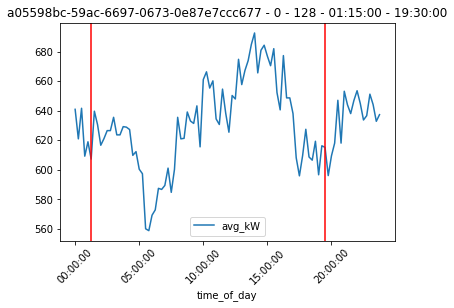

<Figure size 1080x288 with 0 Axes>

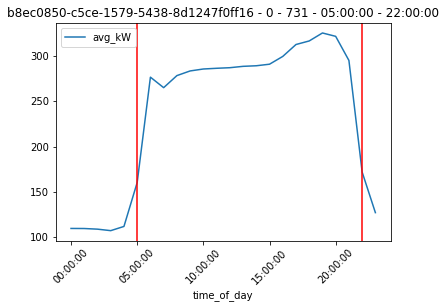

<Figure size 1080x288 with 0 Axes>

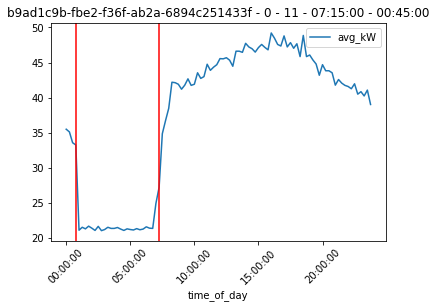

<Figure size 1080x288 with 0 Axes>

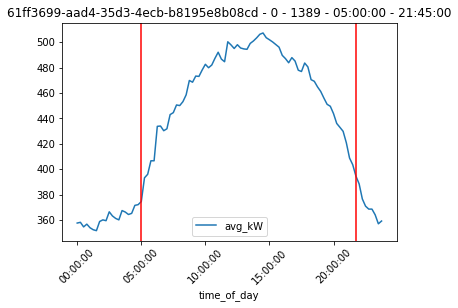

<Figure size 1080x288 with 0 Axes>

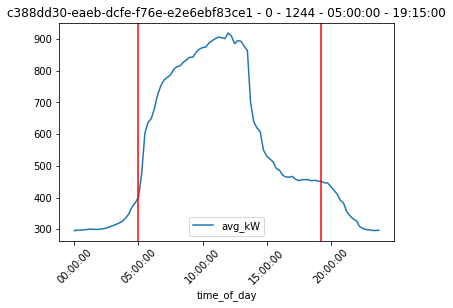

<Figure size 1080x288 with 0 Axes>

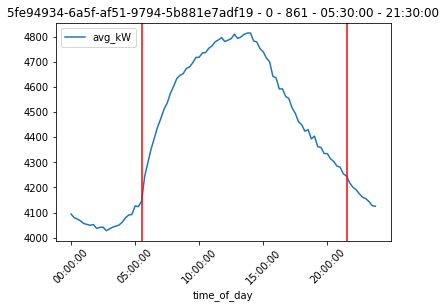

<Figure size 1080x288 with 0 Axes>

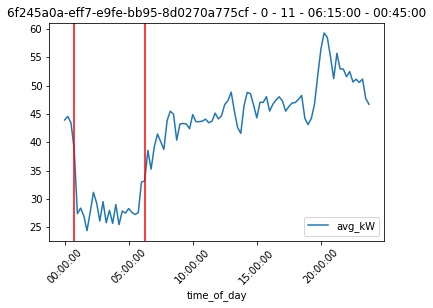

<Figure size 1080x288 with 0 Axes>

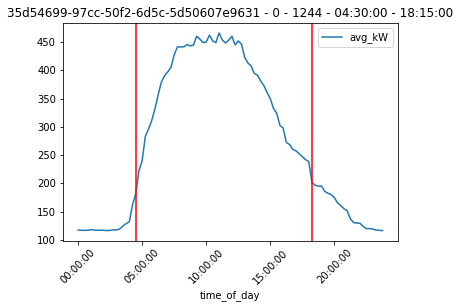

<Figure size 1080x288 with 0 Axes>

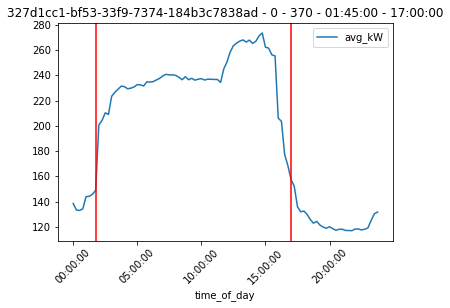

<Figure size 1080x288 with 0 Axes>

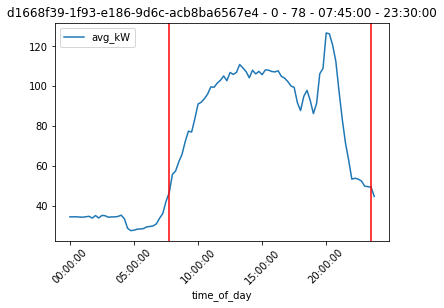

<Figure size 1080x288 with 0 Axes>

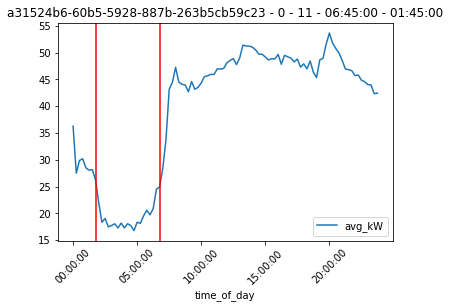

<Figure size 1080x288 with 0 Axes>

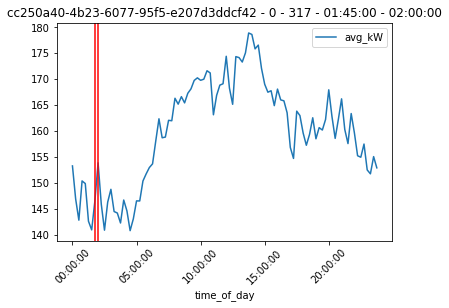

<Figure size 1080x288 with 0 Axes>

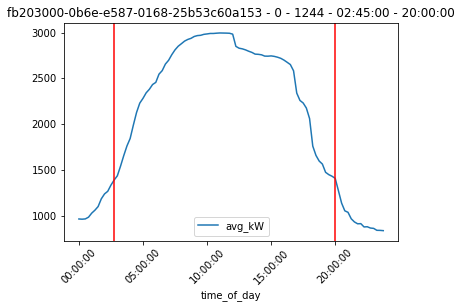

<Figure size 1080x288 with 0 Axes>

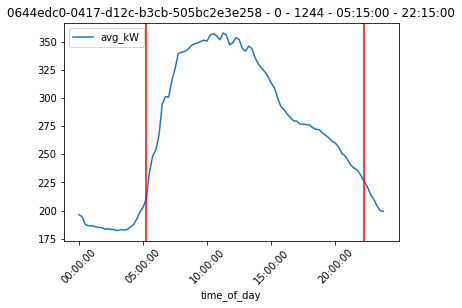

<Figure size 1080x288 with 0 Axes>

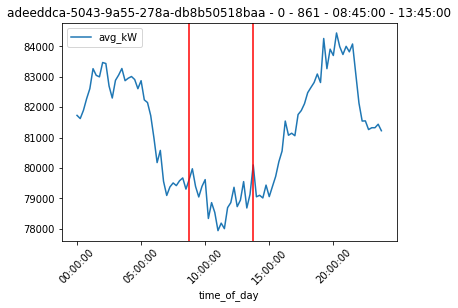

<Figure size 1080x288 with 0 Axes>

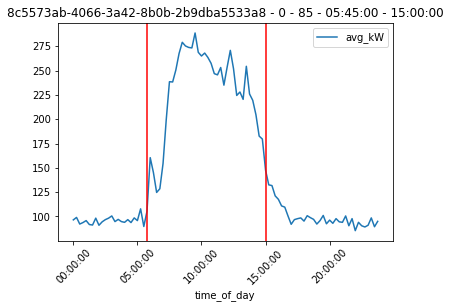

<Figure size 1080x288 with 0 Axes>

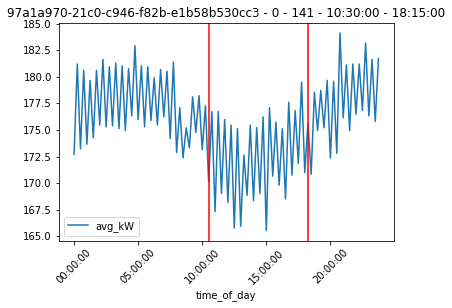

<Figure size 1080x288 with 0 Axes>

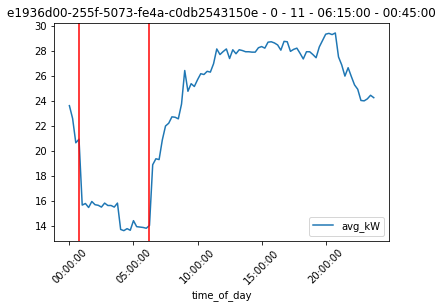

<Figure size 1080x288 with 0 Axes>

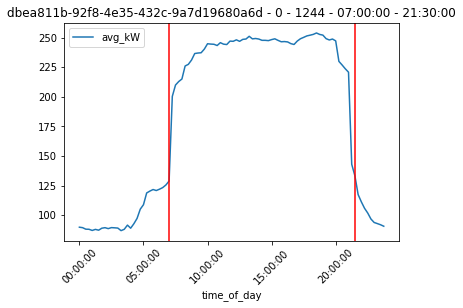

<Figure size 1080x288 with 0 Axes>

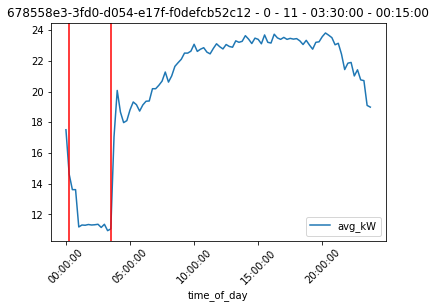

<Figure size 1080x288 with 0 Axes>

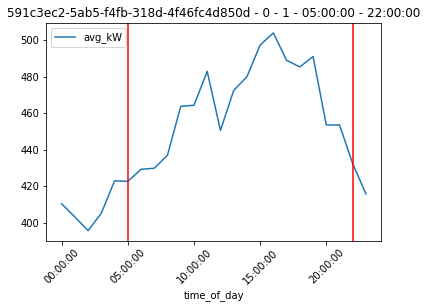

<Figure size 1080x288 with 0 Axes>

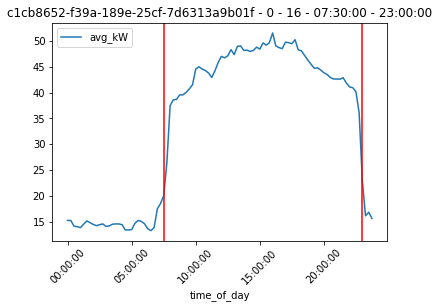

<Figure size 1080x288 with 0 Axes>

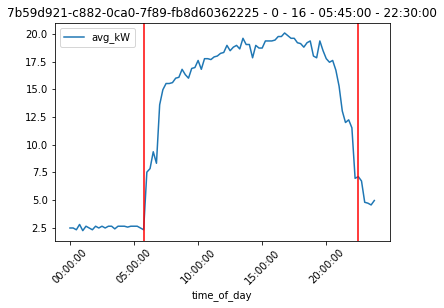

<Figure size 1080x288 with 0 Axes>

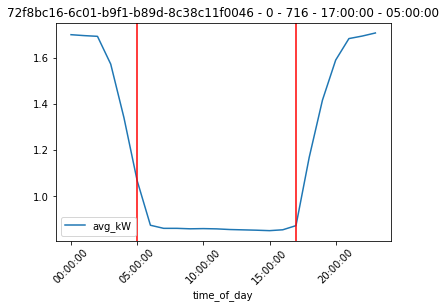

<Figure size 1080x288 with 0 Axes>

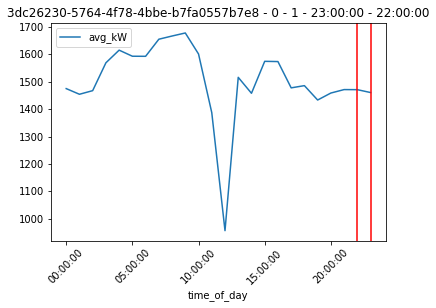

<Figure size 1080x288 with 0 Axes>

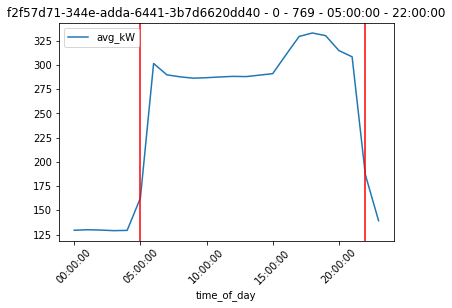

<Figure size 1080x288 with 0 Axes>

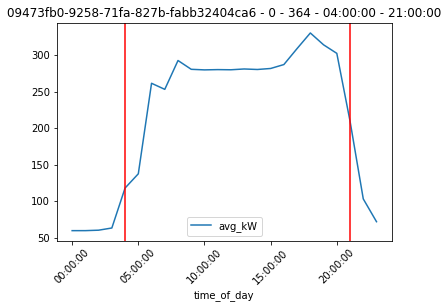

<Figure size 1080x288 with 0 Axes>

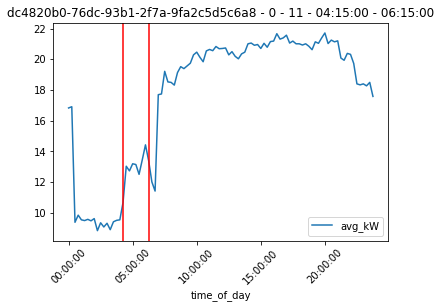

<Figure size 1080x288 with 0 Axes>

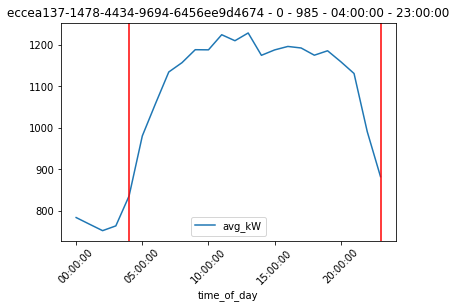

<Figure size 1080x288 with 0 Axes>

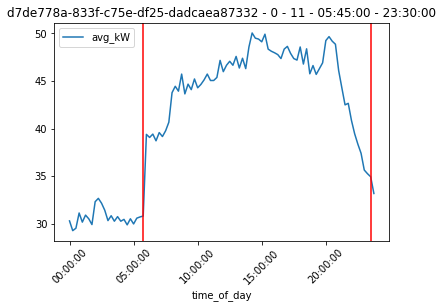

<Figure size 1080x288 with 0 Axes>

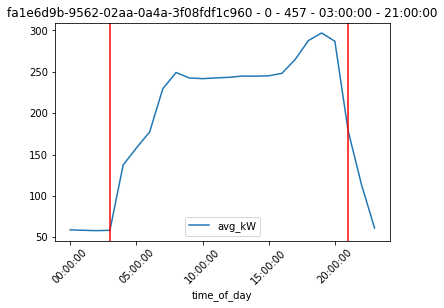

<Figure size 1080x288 with 0 Axes>

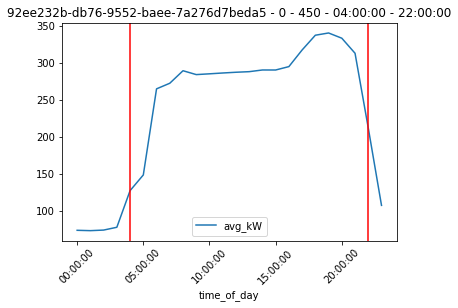

<Figure size 1080x288 with 0 Axes>

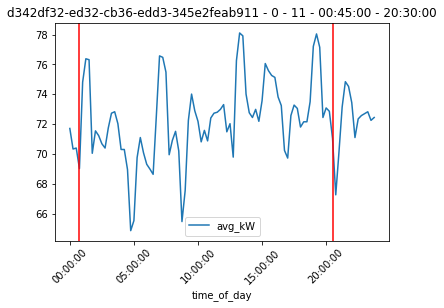

<Figure size 1080x288 with 0 Axes>

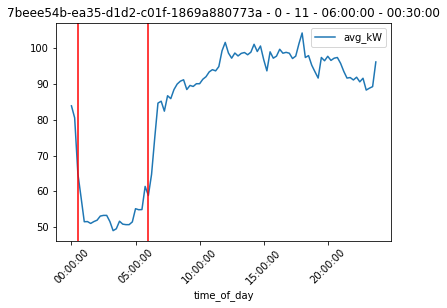

<Figure size 1080x288 with 0 Axes>

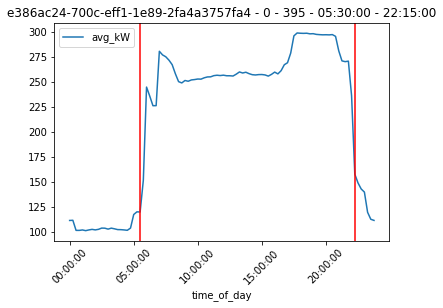

<Figure size 1080x288 with 0 Axes>

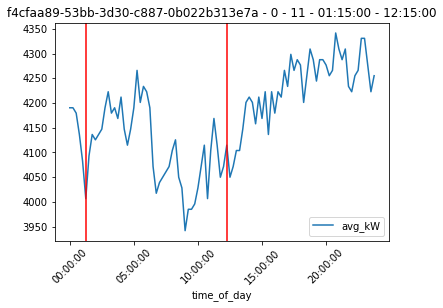

<Figure size 1080x288 with 0 Axes>

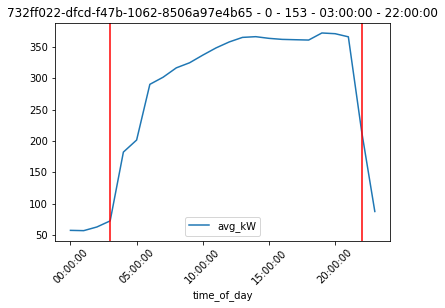

<Figure size 1080x288 with 0 Axes>

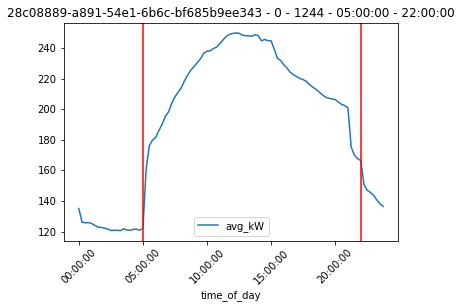

<Figure size 1080x288 with 0 Axes>

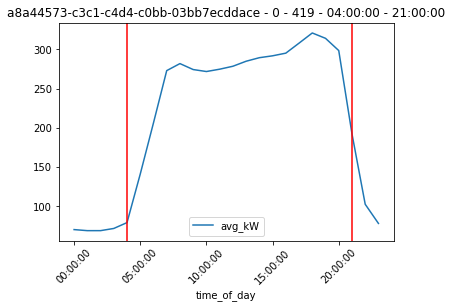

<Figure size 1080x288 with 0 Axes>

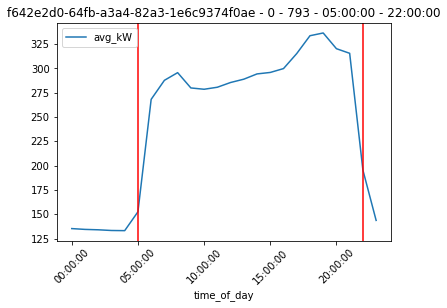

<Figure size 1080x288 with 0 Axes>

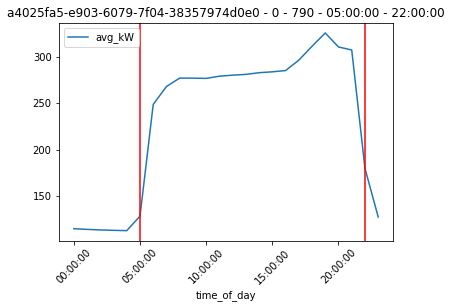

<Figure size 1080x288 with 0 Axes>

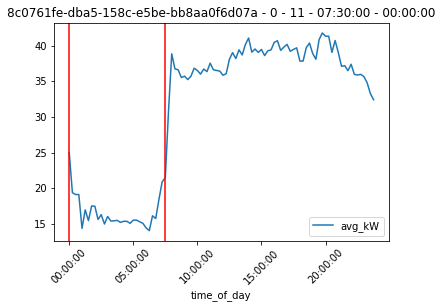

<Figure size 1080x288 with 0 Axes>

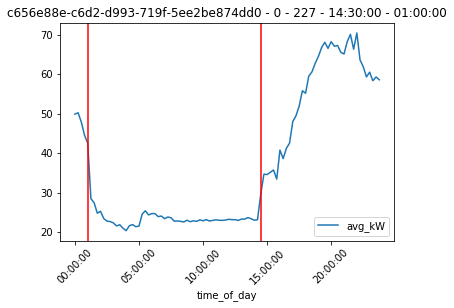

<Figure size 1080x288 with 0 Axes>

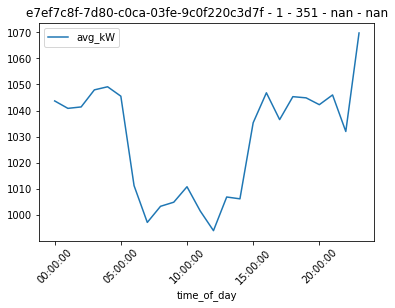

<Figure size 1080x288 with 0 Axes>

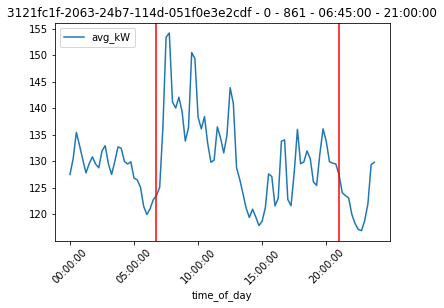

<Figure size 1080x288 with 0 Axes>

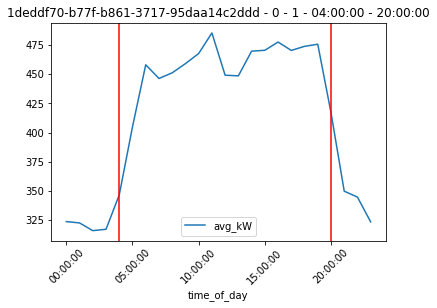

<Figure size 1080x288 with 0 Axes>

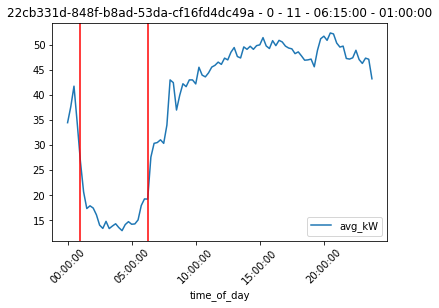

<Figure size 1080x288 with 0 Axes>

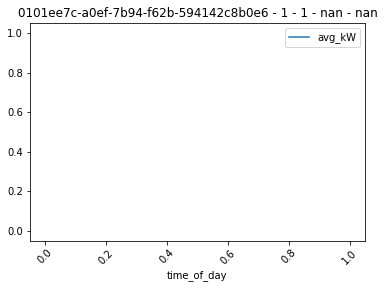

<Figure size 1080x288 with 0 Axes>

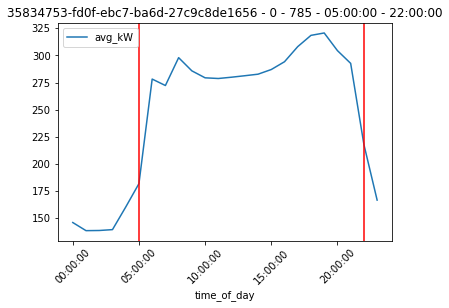

<Figure size 1080x288 with 0 Axes>

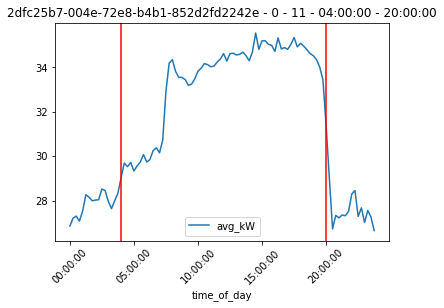

<Figure size 1080x288 with 0 Axes>

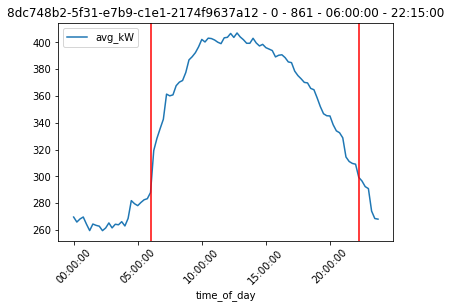

<Figure size 1080x288 with 0 Axes>

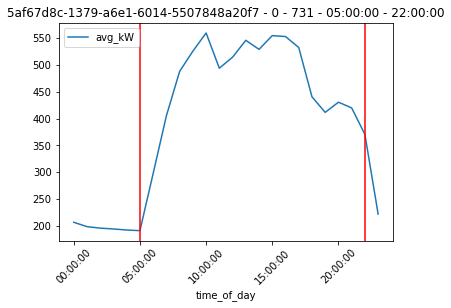

<Figure size 1080x288 with 0 Axes>

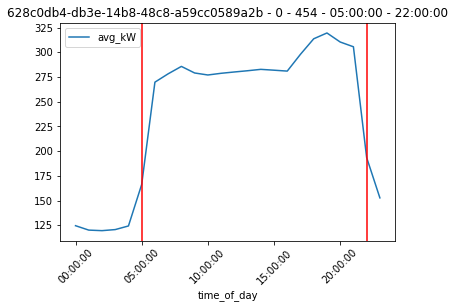

<Figure size 1080x288 with 0 Axes>

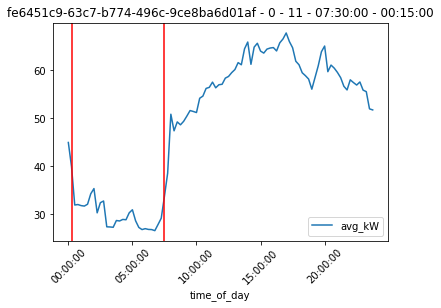

<Figure size 1080x288 with 0 Axes>

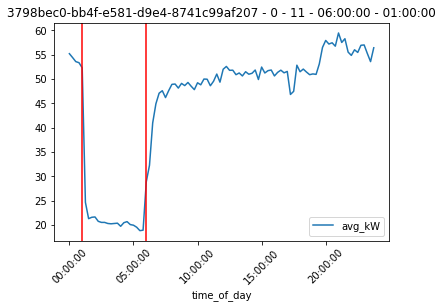

<Figure size 1080x288 with 0 Axes>

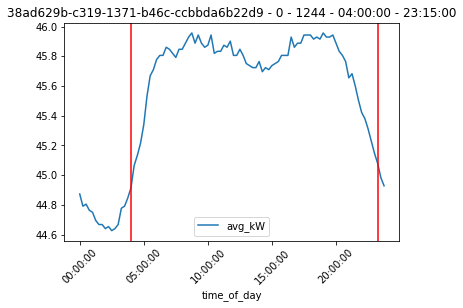

<Figure size 1080x288 with 0 Axes>

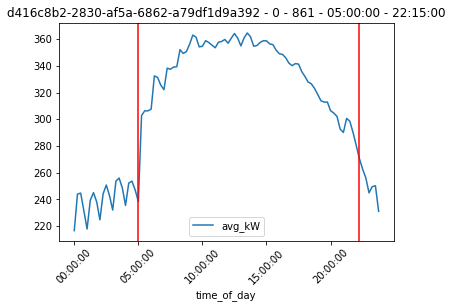

<Figure size 1080x288 with 0 Axes>

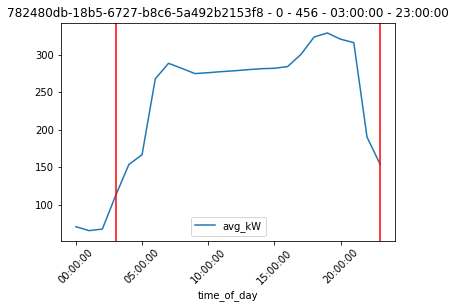

<Figure size 1080x288 with 0 Axes>

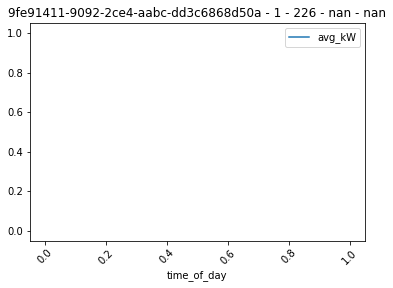

<Figure size 1080x288 with 0 Axes>

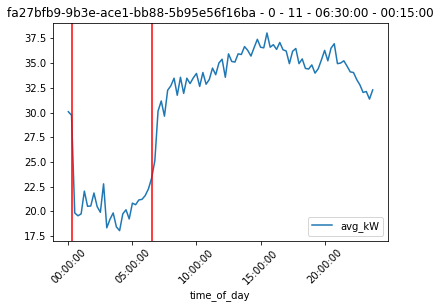

<Figure size 1080x288 with 0 Axes>

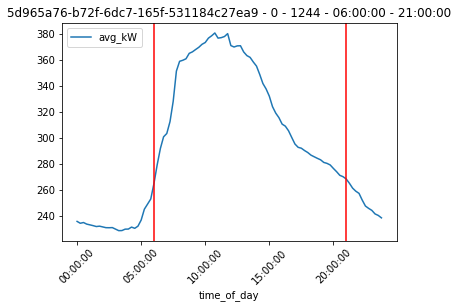

<Figure size 1080x288 with 0 Axes>

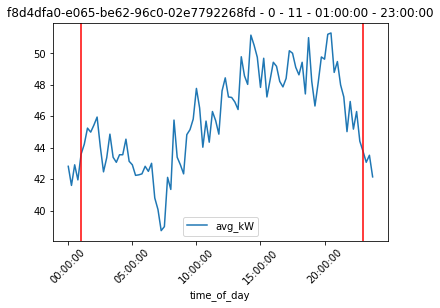

<Figure size 1080x288 with 0 Axes>

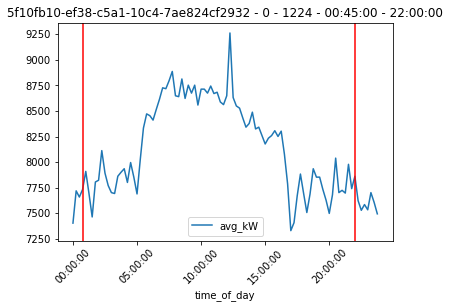

<Figure size 1080x288 with 0 Axes>

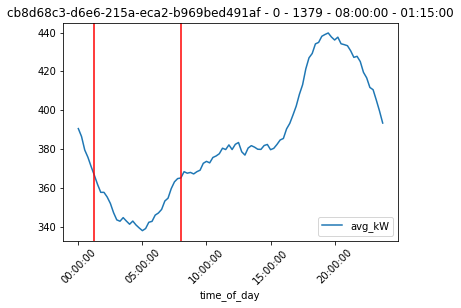

<Figure size 1080x288 with 0 Axes>

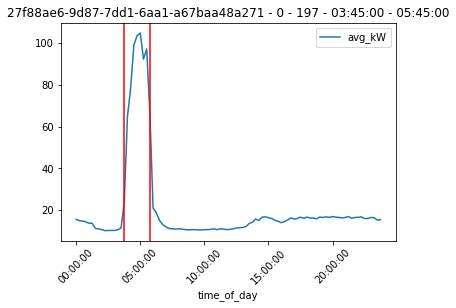

<Figure size 1080x288 with 0 Axes>

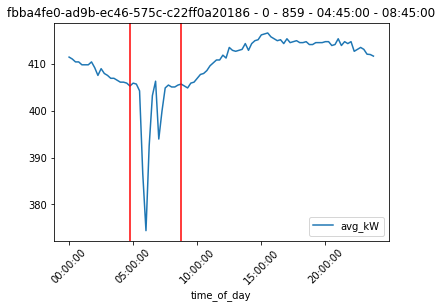

<Figure size 1080x288 with 0 Axes>

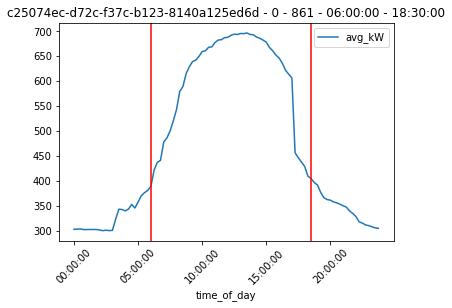

<Figure size 1080x288 with 0 Axes>

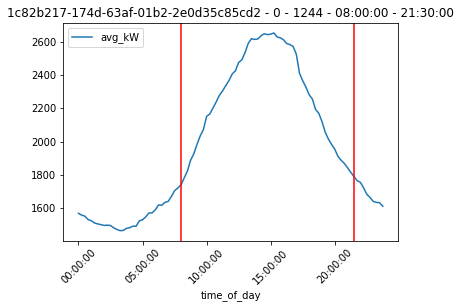

<Figure size 1080x288 with 0 Axes>

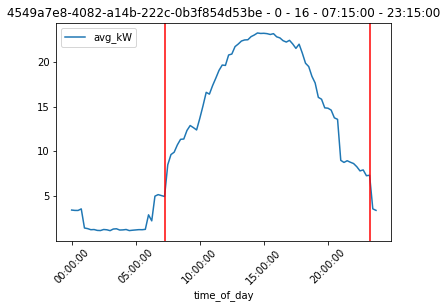

<Figure size 1080x288 with 0 Axes>

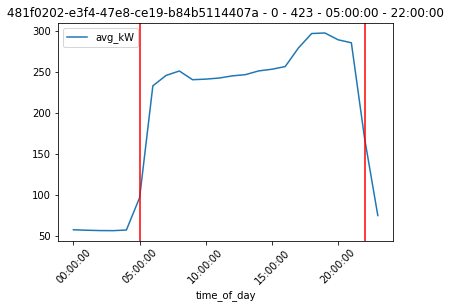

<Figure size 1080x288 with 0 Axes>

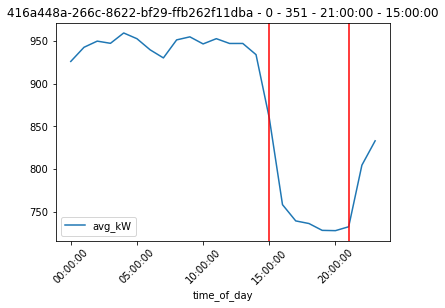

<Figure size 1080x288 with 0 Axes>

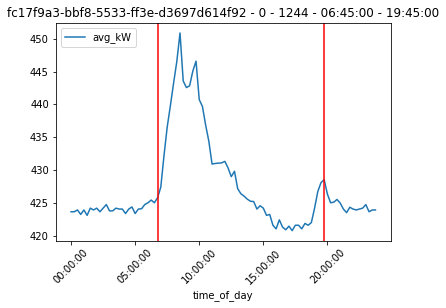

<Figure size 1080x288 with 0 Axes>

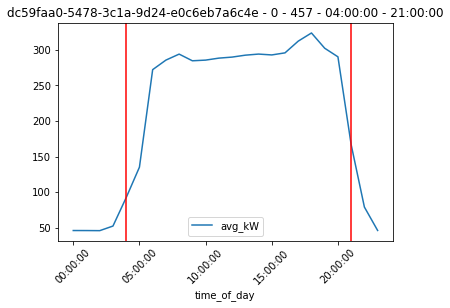

<Figure size 1080x288 with 0 Axes>

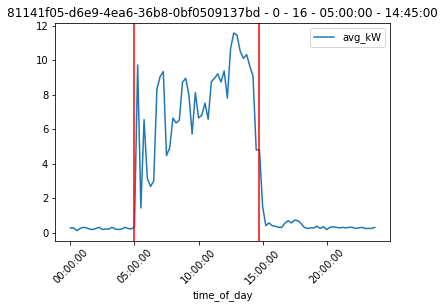

<Figure size 1080x288 with 0 Axes>

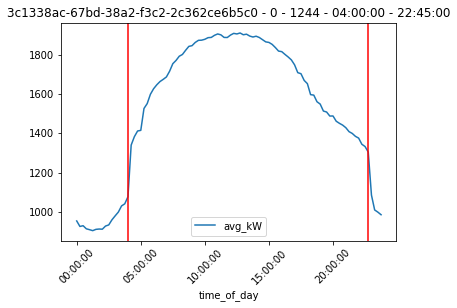

<Figure size 1080x288 with 0 Axes>

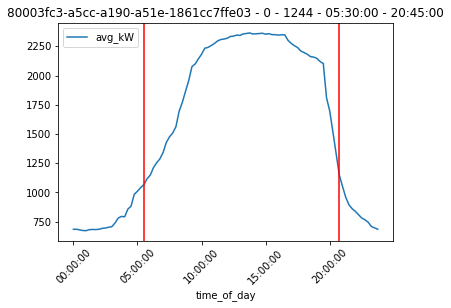

<Figure size 1080x288 with 0 Axes>

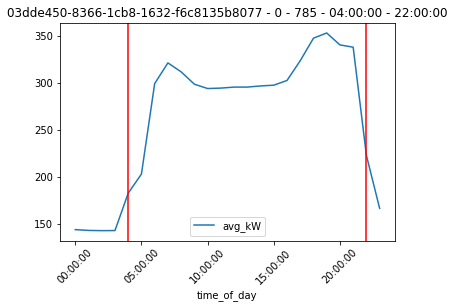

<Figure size 1080x288 with 0 Axes>

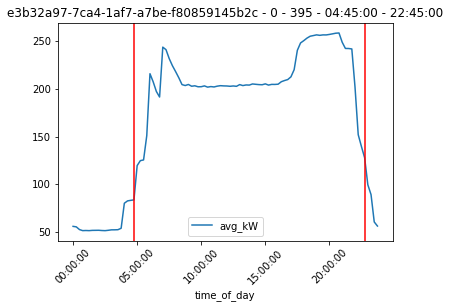

<Figure size 1080x288 with 0 Axes>

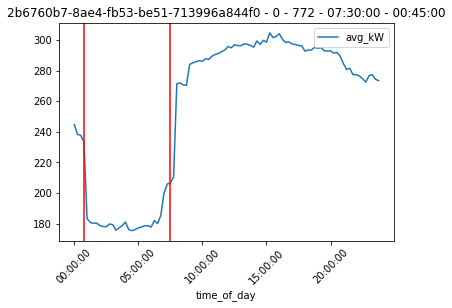

<Figure size 1080x288 with 0 Axes>

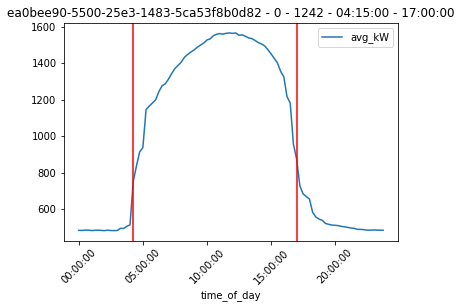

<Figure size 1080x288 with 0 Axes>

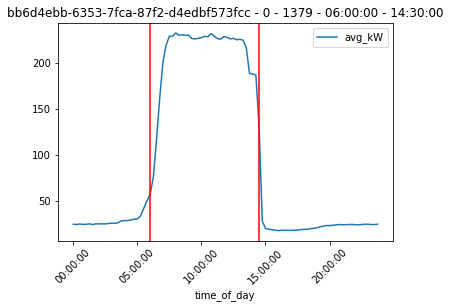

<Figure size 1080x288 with 0 Axes>

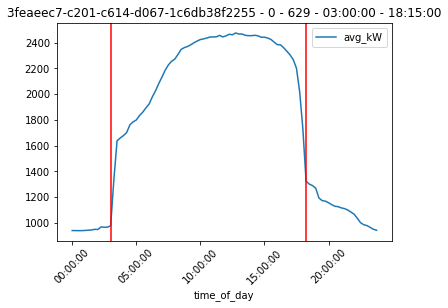

<Figure size 1080x288 with 0 Axes>

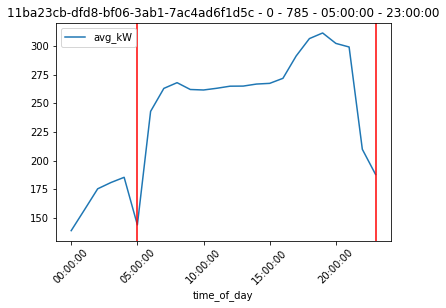

<Figure size 1080x288 with 0 Axes>

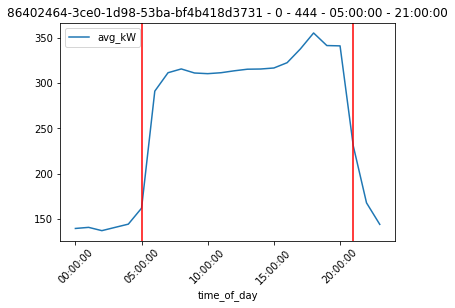

<Figure size 1080x288 with 0 Axes>

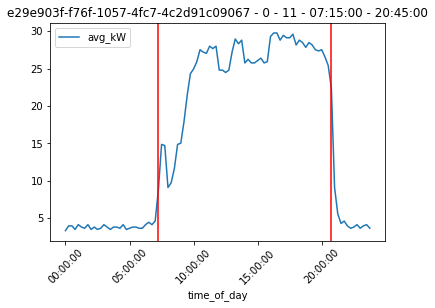

<Figure size 1080x288 with 0 Axes>

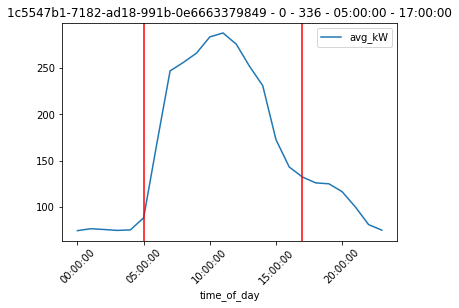

<Figure size 1080x288 with 0 Axes>

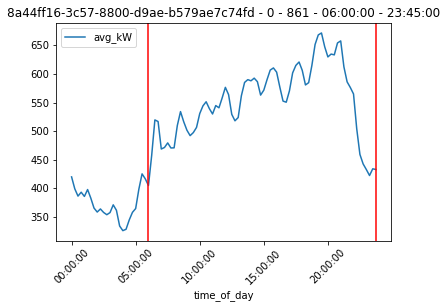

<Figure size 1080x288 with 0 Axes>

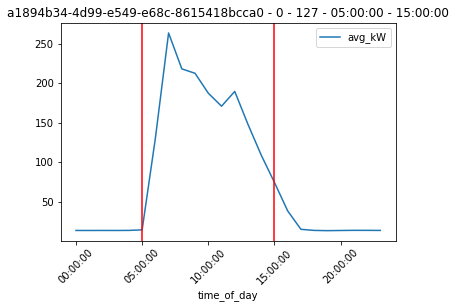

<Figure size 1080x288 with 0 Axes>

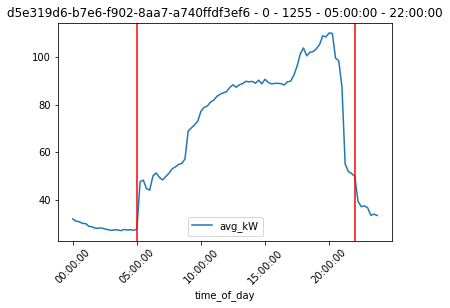

<Figure size 1080x288 with 0 Axes>

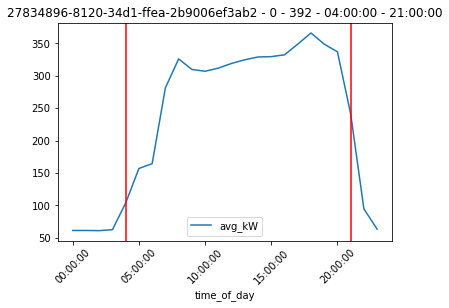

<Figure size 1080x288 with 0 Axes>

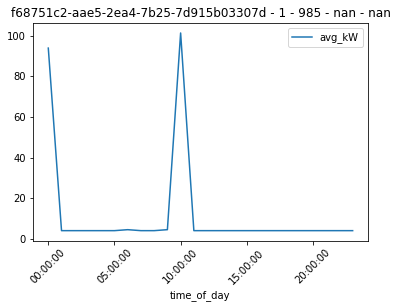

<Figure size 1080x288 with 0 Axes>

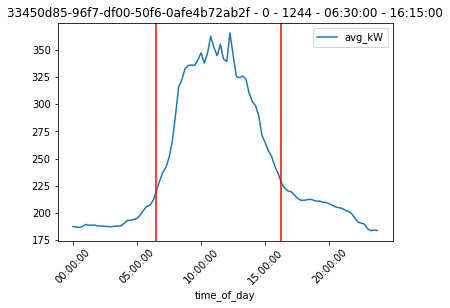

<Figure size 1080x288 with 0 Axes>

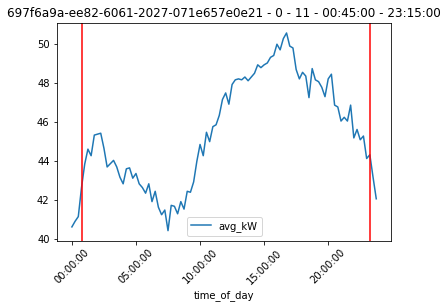

<Figure size 1080x288 with 0 Axes>

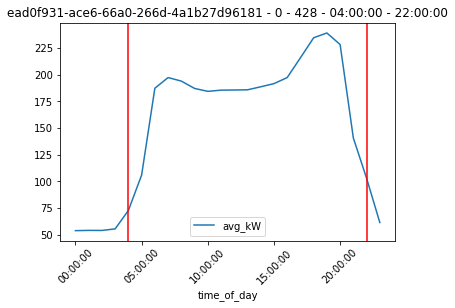

<Figure size 1080x288 with 0 Axes>

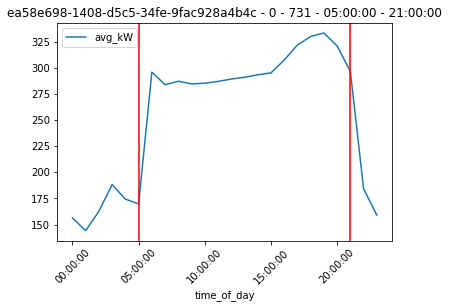

<Figure size 1080x288 with 0 Axes>

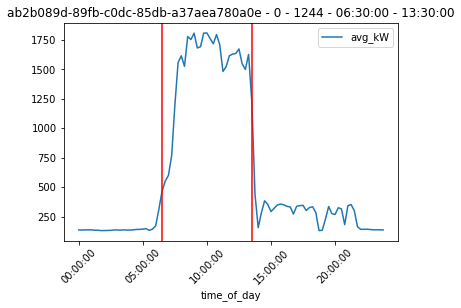

<Figure size 1080x288 with 0 Axes>

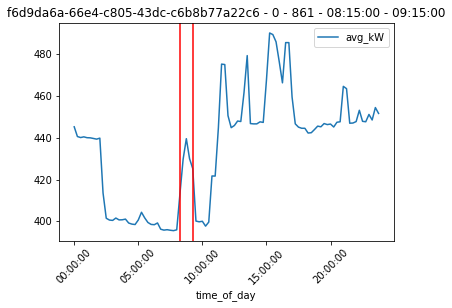

<Figure size 1080x288 with 0 Axes>

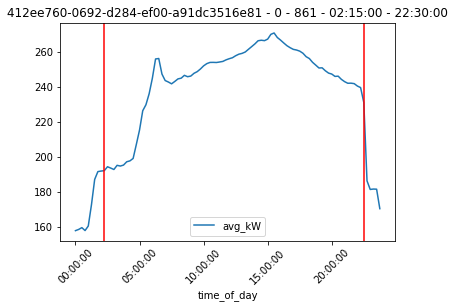

<Figure size 1080x288 with 0 Axes>

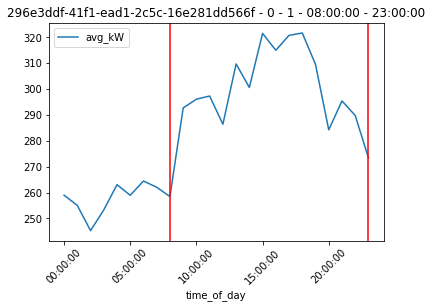

<Figure size 1080x288 with 0 Axes>

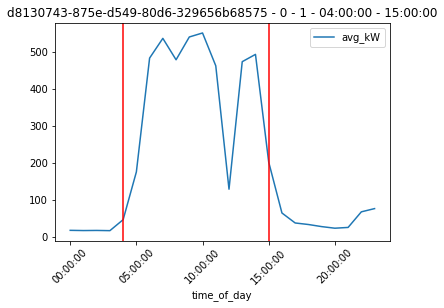

<Figure size 1080x288 with 0 Axes>

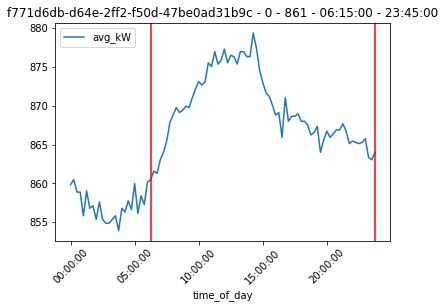

<Figure size 1080x288 with 0 Axes>

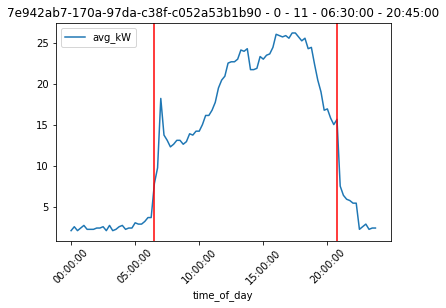

<Figure size 1080x288 with 0 Axes>

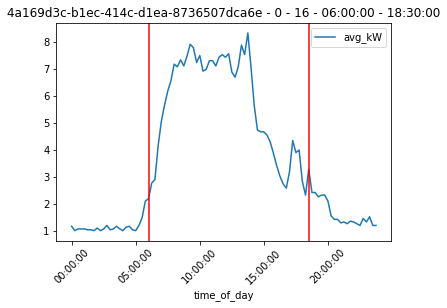

<Figure size 1080x288 with 0 Axes>

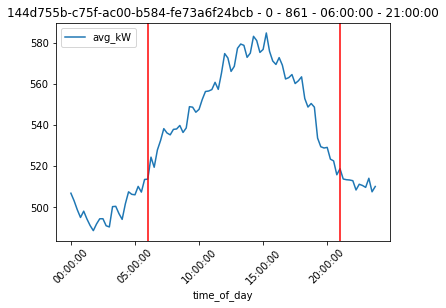

<Figure size 1080x288 with 0 Axes>

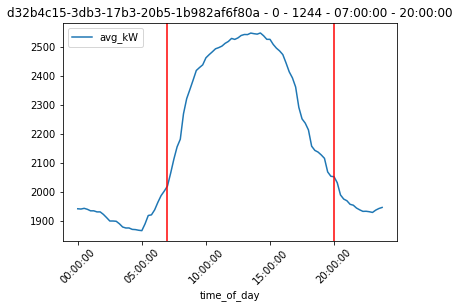

<Figure size 1080x288 with 0 Axes>

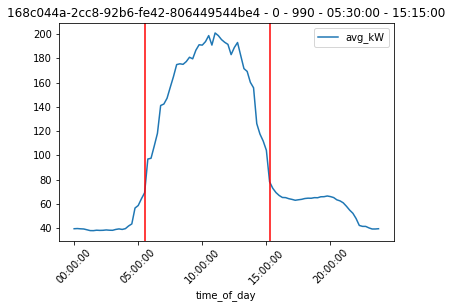

<Figure size 1080x288 with 0 Axes>

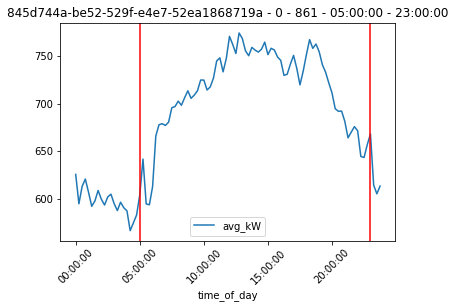

<Figure size 1080x288 with 0 Axes>

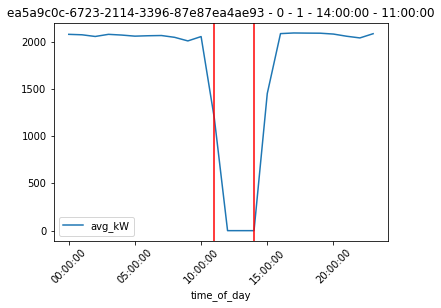

<Figure size 1080x288 with 0 Axes>

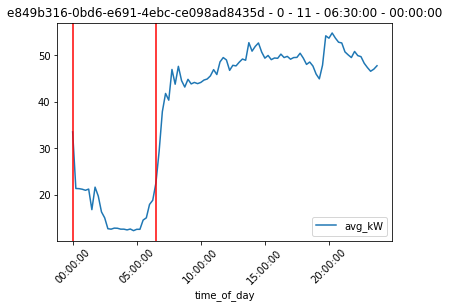

<Figure size 1080x288 with 0 Axes>

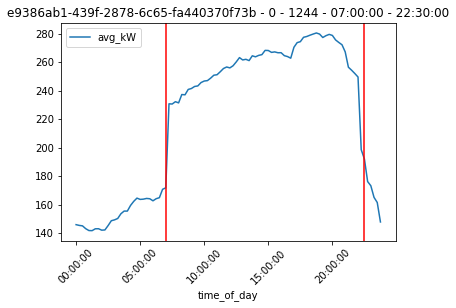

<Figure size 1080x288 with 0 Axes>

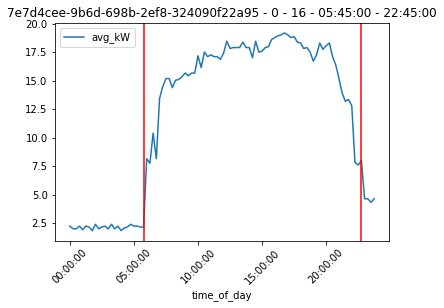

<Figure size 1080x288 with 0 Axes>

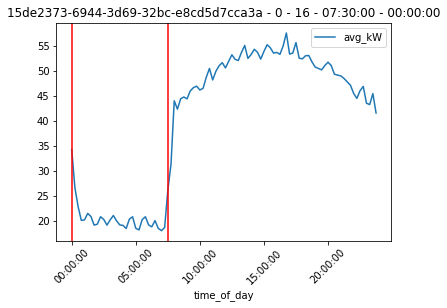

<Figure size 1080x288 with 0 Axes>

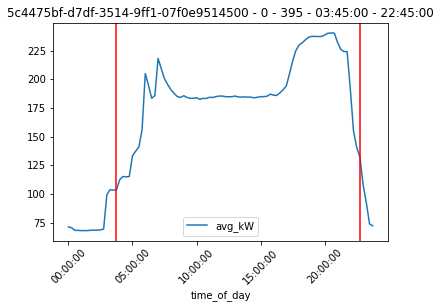

<Figure size 1080x288 with 0 Axes>

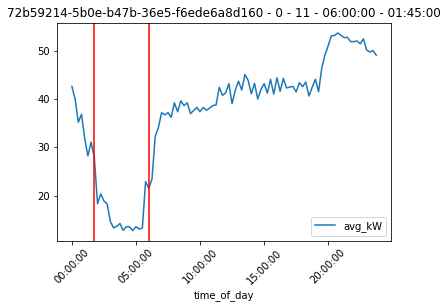

<Figure size 1080x288 with 0 Axes>

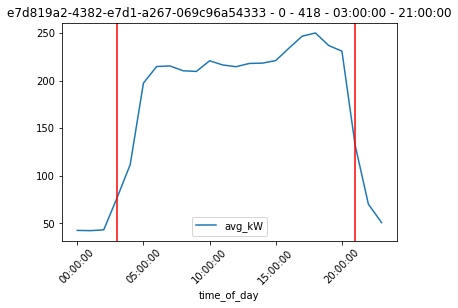

<Figure size 1080x288 with 0 Axes>

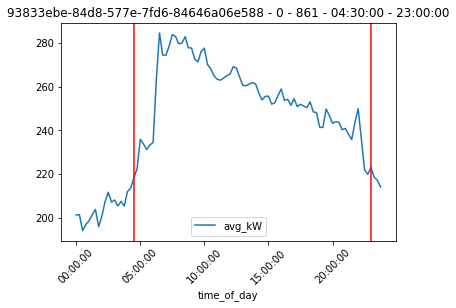

<Figure size 1080x288 with 0 Axes>

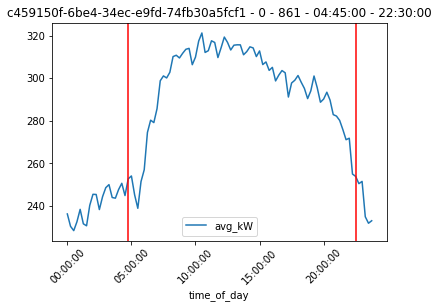

<Figure size 1080x288 with 0 Axes>

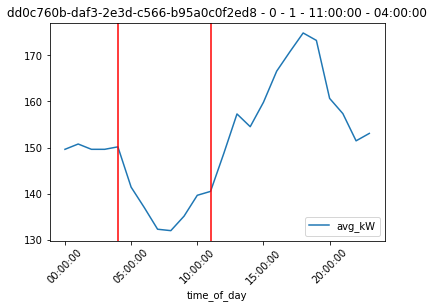

<Figure size 1080x288 with 0 Axes>

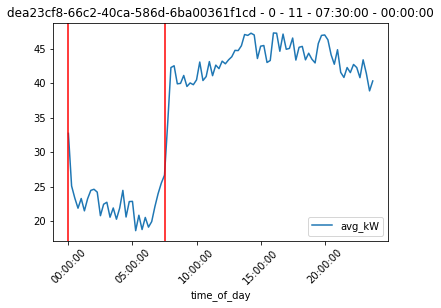

<Figure size 1080x288 with 0 Axes>

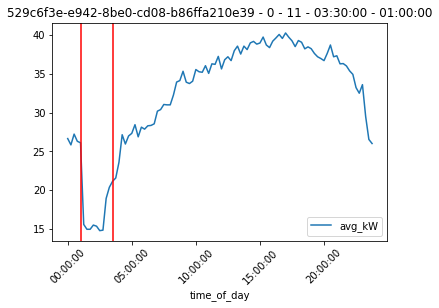

<Figure size 1080x288 with 0 Axes>

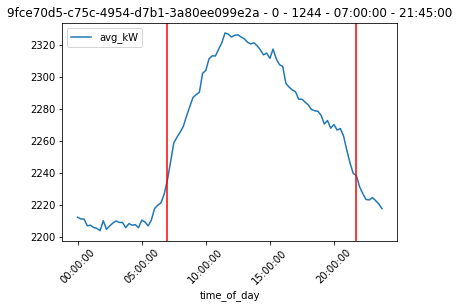

<Figure size 1080x288 with 0 Axes>

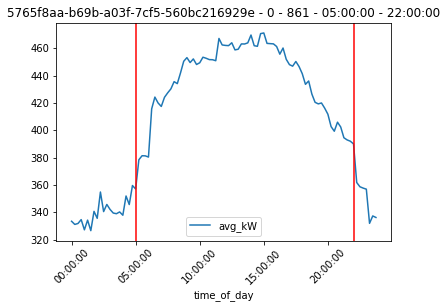

<Figure size 1080x288 with 0 Axes>

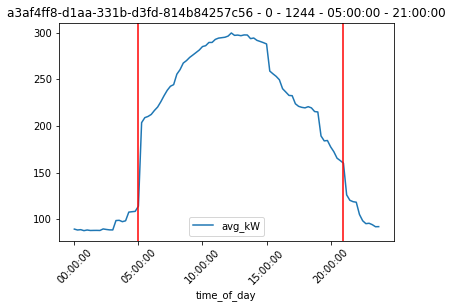

<Figure size 1080x288 with 0 Axes>

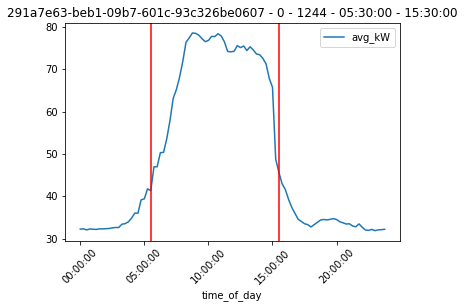

<Figure size 1080x288 with 0 Axes>

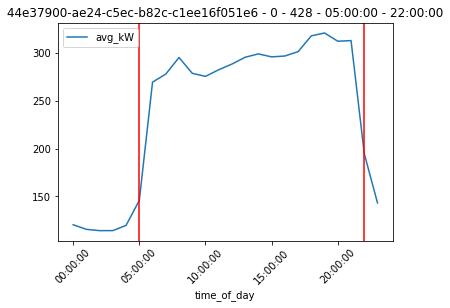

<Figure size 1080x288 with 0 Axes>

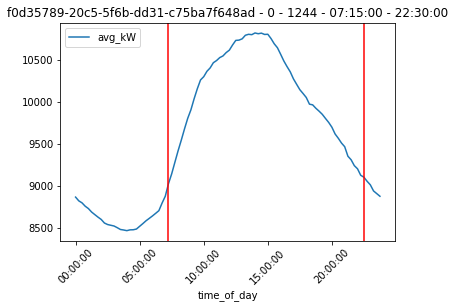

<Figure size 1080x288 with 0 Axes>

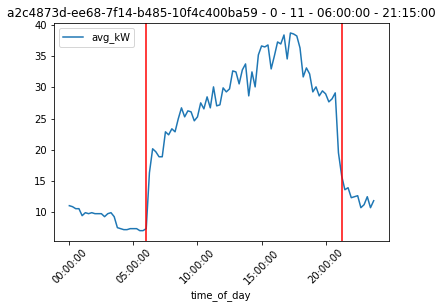

<Figure size 1080x288 with 0 Axes>

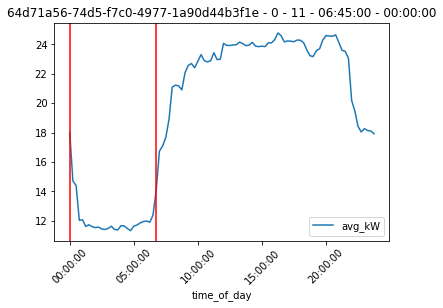

<Figure size 1080x288 with 0 Axes>

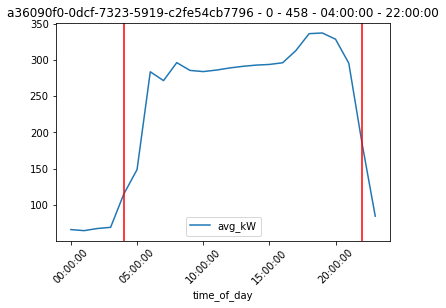

<Figure size 1080x288 with 0 Axes>

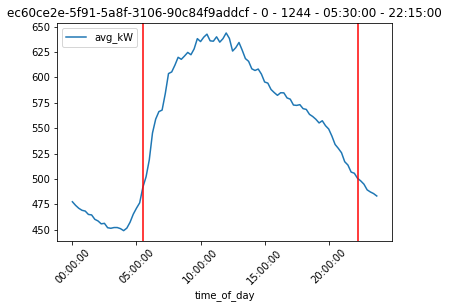

<Figure size 1080x288 with 0 Axes>

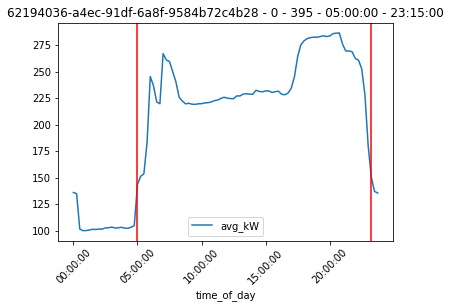

<Figure size 1080x288 with 0 Axes>

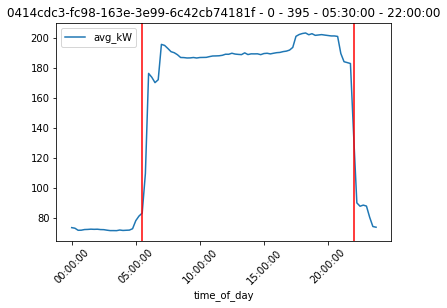

<Figure size 1080x288 with 0 Axes>

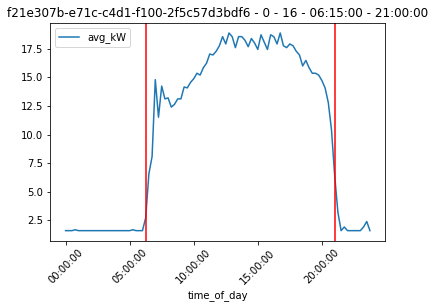

<Figure size 1080x288 with 0 Axes>

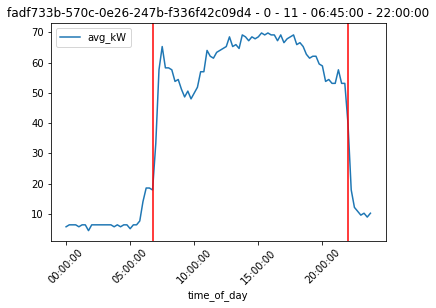

<Figure size 1080x288 with 0 Axes>

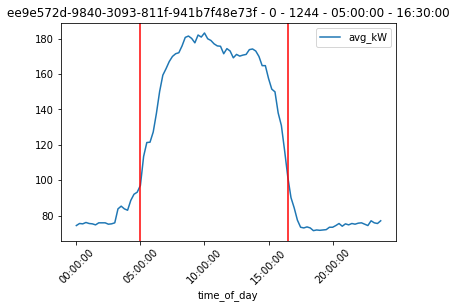

<Figure size 1080x288 with 0 Axes>

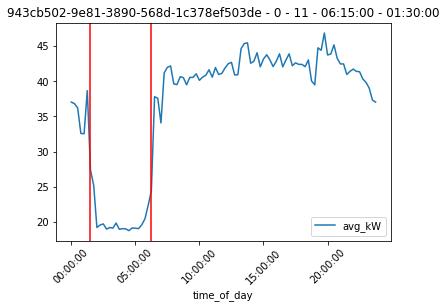

<Figure size 1080x288 with 0 Axes>

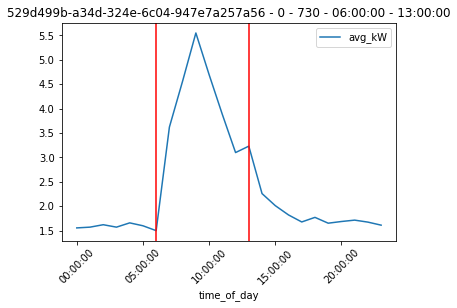

<Figure size 1080x288 with 0 Axes>

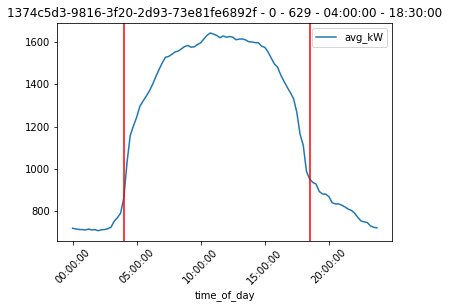

<Figure size 1080x288 with 0 Axes>

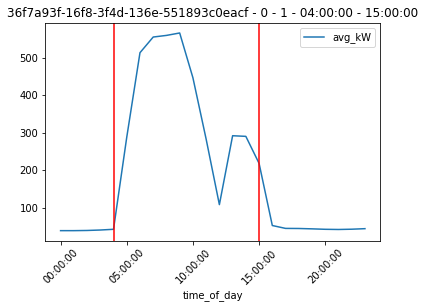

<Figure size 1080x288 with 0 Axes>

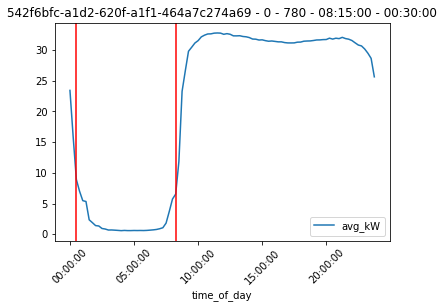

<Figure size 1080x288 with 0 Axes>

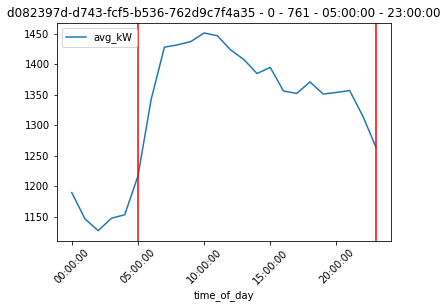

<Figure size 1080x288 with 0 Axes>

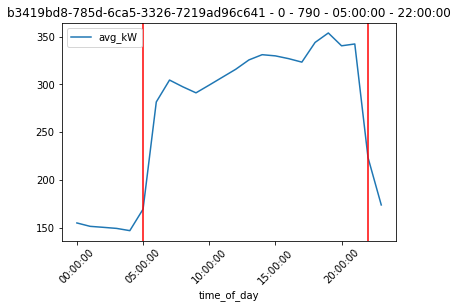

<Figure size 1080x288 with 0 Axes>

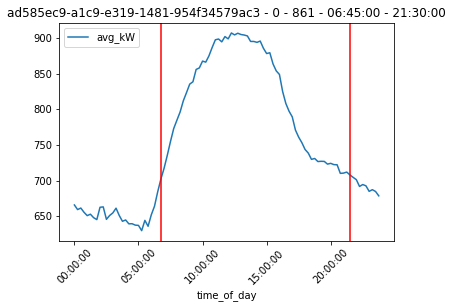

<Figure size 1080x288 with 0 Axes>

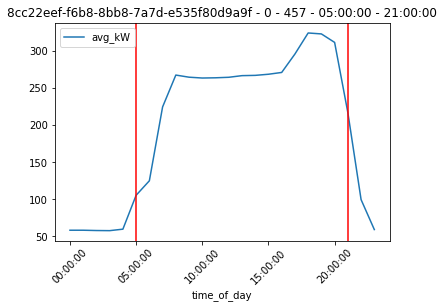

<Figure size 1080x288 with 0 Axes>

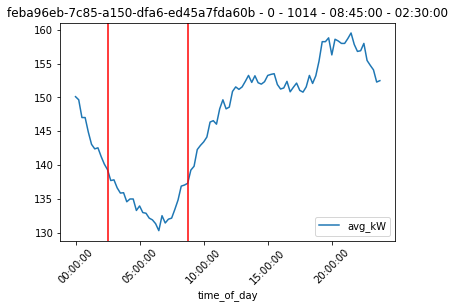

<Figure size 1080x288 with 0 Axes>

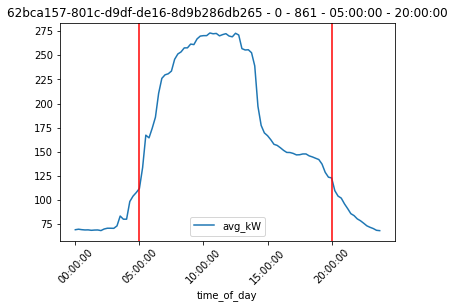

<Figure size 1080x288 with 0 Axes>

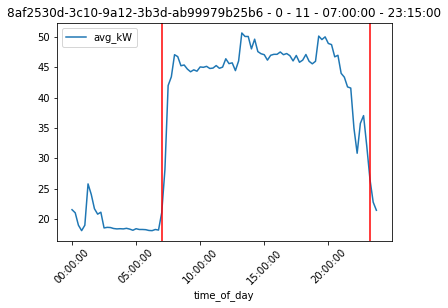

<Figure size 1080x288 with 0 Axes>

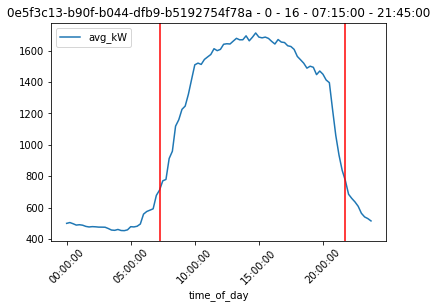

<Figure size 1080x288 with 0 Axes>

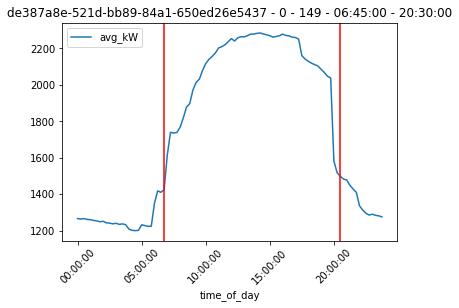

<Figure size 1080x288 with 0 Axes>

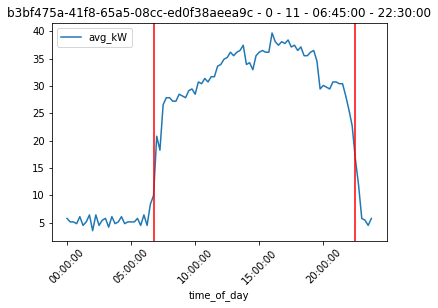

<Figure size 1080x288 with 0 Axes>

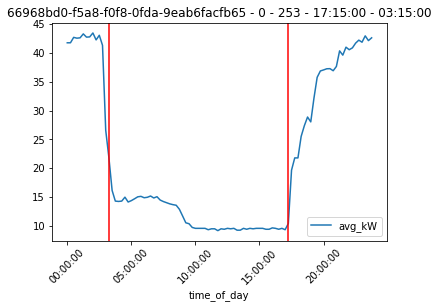

<Figure size 1080x288 with 0 Axes>

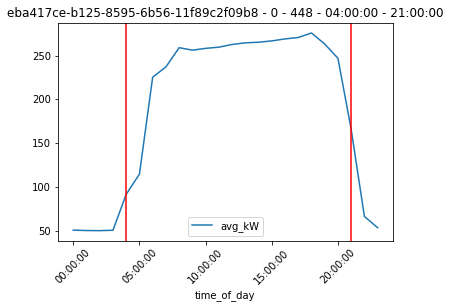

<Figure size 1080x288 with 0 Axes>

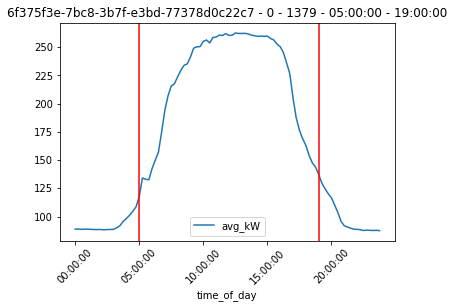

<Figure size 1080x288 with 0 Axes>

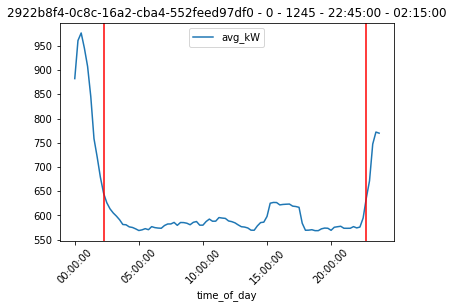

<Figure size 1080x288 with 0 Axes>

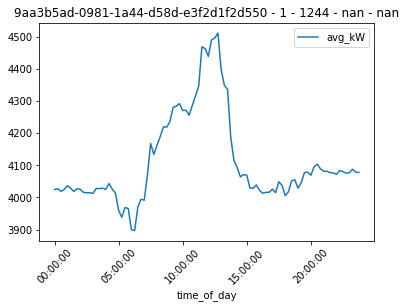

<Figure size 1080x288 with 0 Axes>

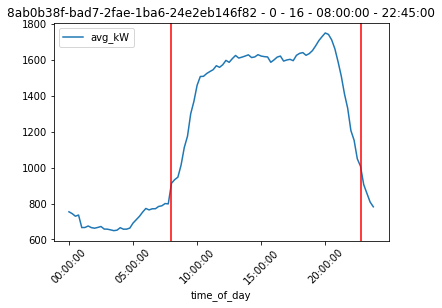

<Figure size 1080x288 with 0 Axes>

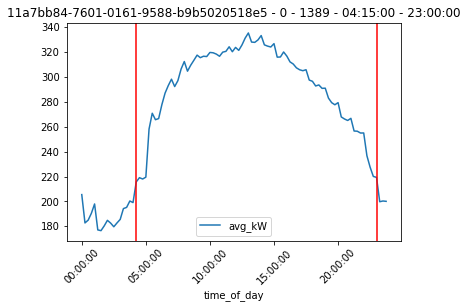

<Figure size 1080x288 with 0 Axes>

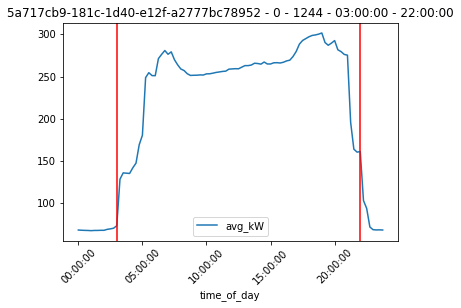

<Figure size 1080x288 with 0 Axes>

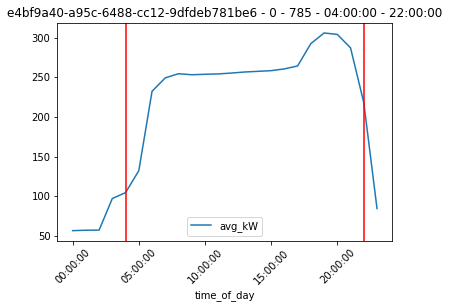

<Figure size 1080x288 with 0 Axes>

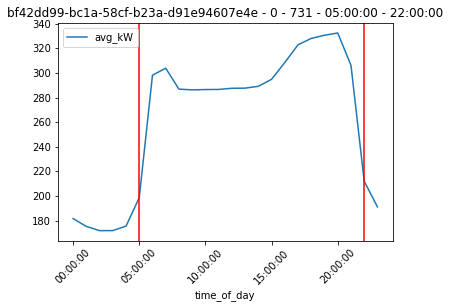

<Figure size 1080x288 with 0 Axes>

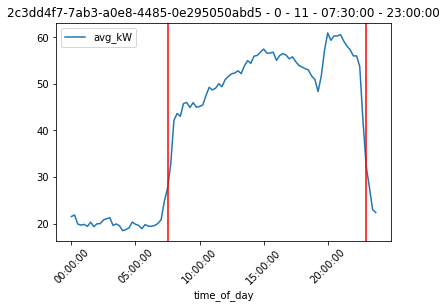

<Figure size 1080x288 with 0 Axes>

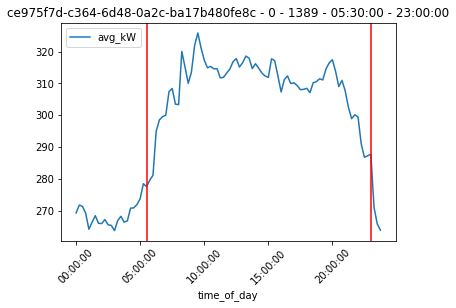

<Figure size 1080x288 with 0 Axes>

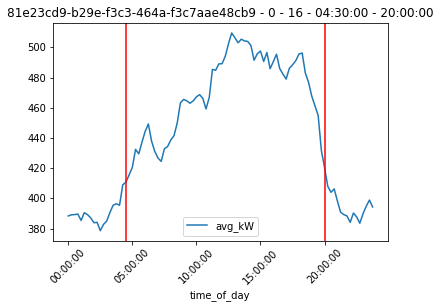

<Figure size 1080x288 with 0 Axes>

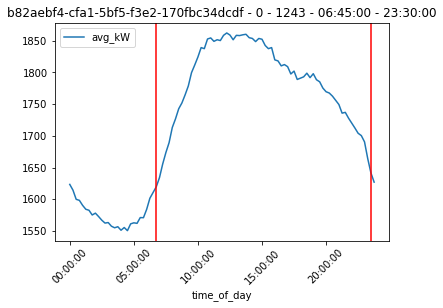

<Figure size 1080x288 with 0 Axes>

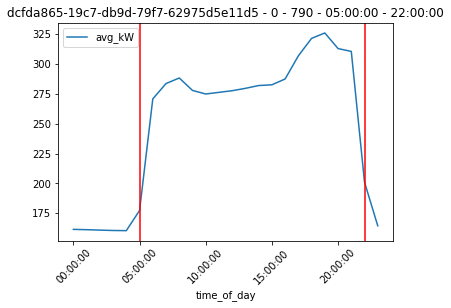

<Figure size 1080x288 with 0 Axes>

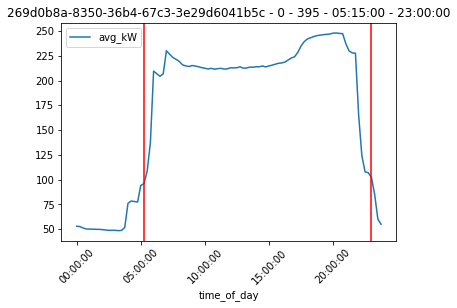

<Figure size 1080x288 with 0 Axes>

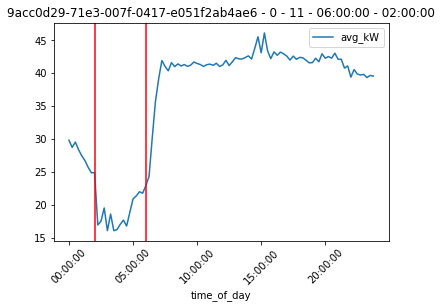

<Figure size 1080x288 with 0 Axes>

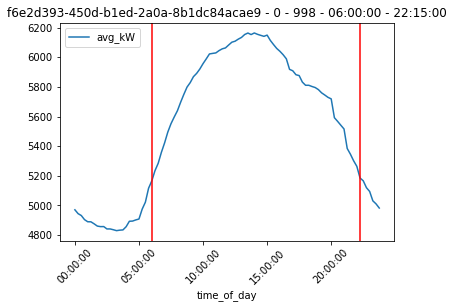

<Figure size 1080x288 with 0 Axes>

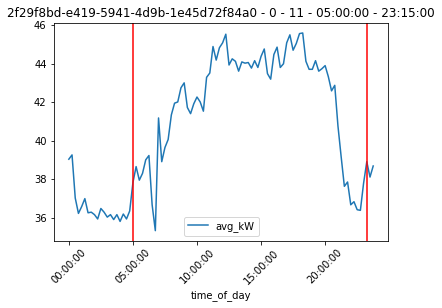

<Figure size 1080x288 with 0 Axes>

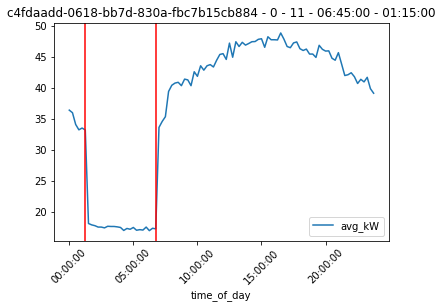

<Figure size 1080x288 with 0 Axes>

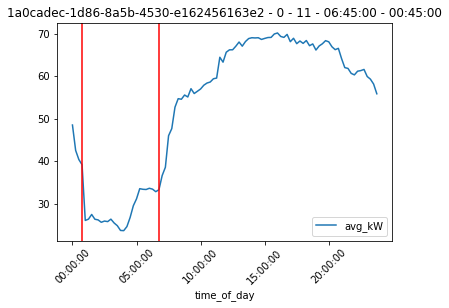

<Figure size 1080x288 with 0 Axes>

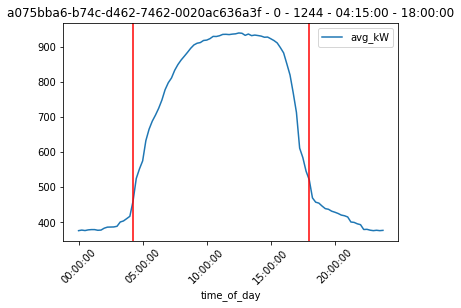

<Figure size 1080x288 with 0 Axes>

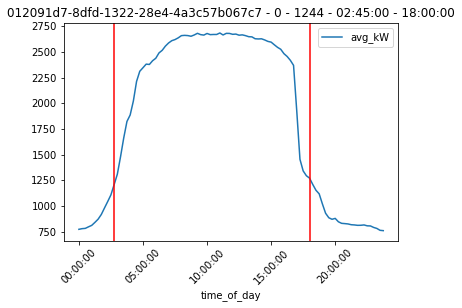

<Figure size 1080x288 with 0 Axes>

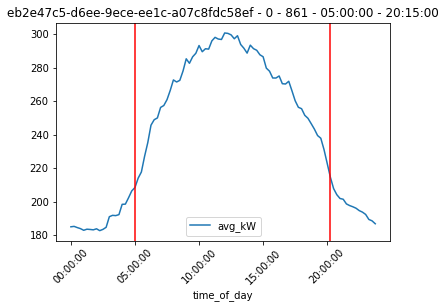

<Figure size 1080x288 with 0 Axes>

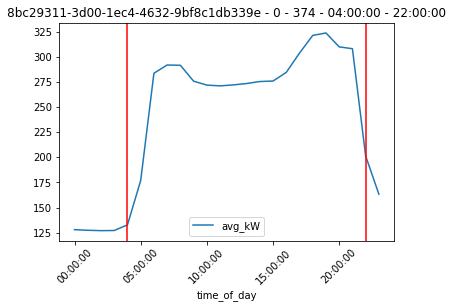

<Figure size 1080x288 with 0 Axes>

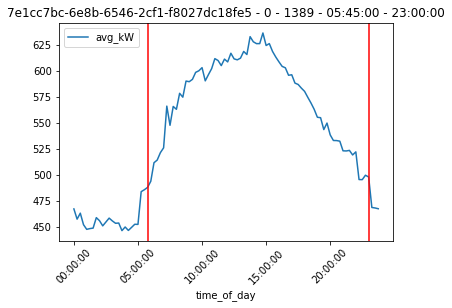

<Figure size 1080x288 with 0 Axes>

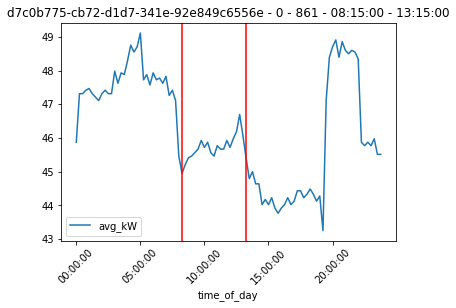

<Figure size 1080x288 with 0 Axes>

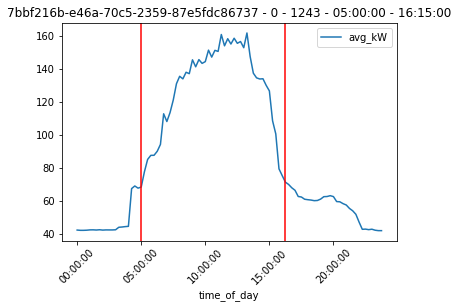

<Figure size 1080x288 with 0 Axes>

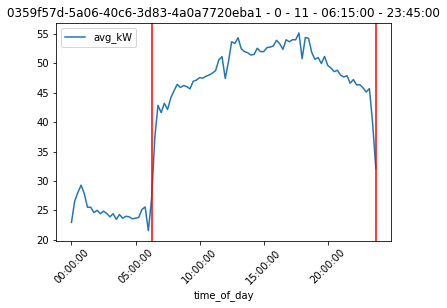

<Figure size 1080x288 with 0 Axes>

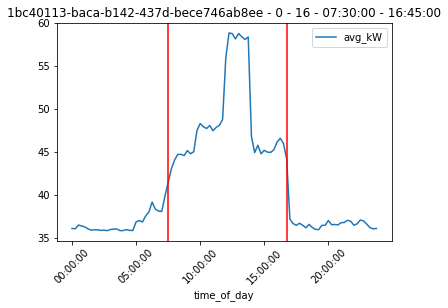

<Figure size 1080x288 with 0 Axes>

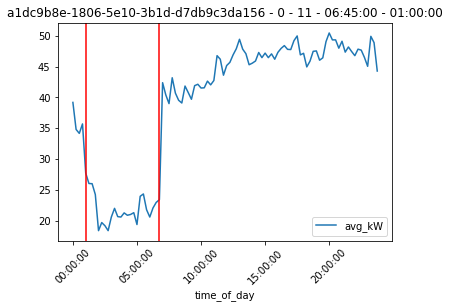

<Figure size 1080x288 with 0 Axes>

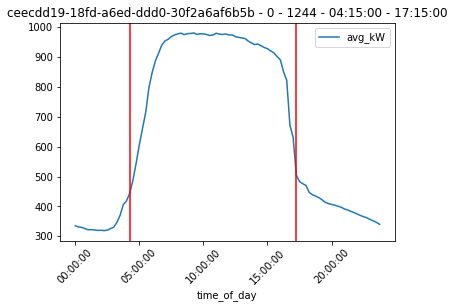

<Figure size 1080x288 with 0 Axes>

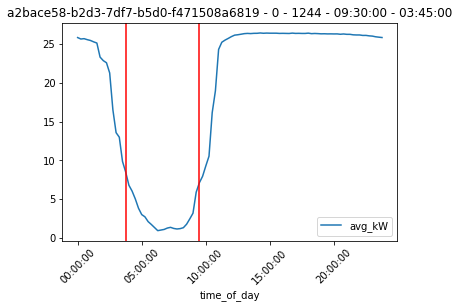

<Figure size 1080x288 with 0 Axes>

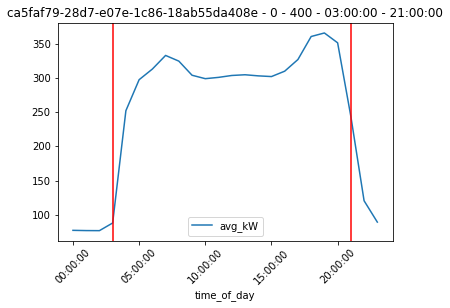

<Figure size 1080x288 with 0 Axes>

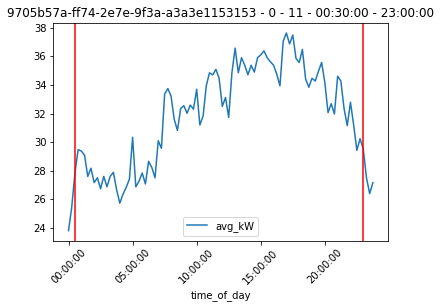

<Figure size 1080x288 with 0 Axes>

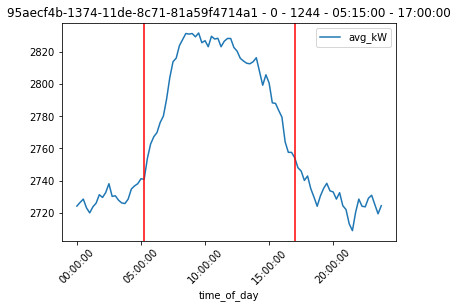

<Figure size 1080x288 with 0 Axes>

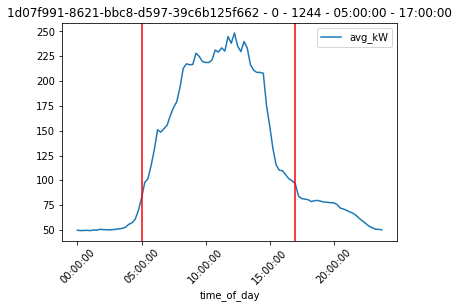

<Figure size 1080x288 with 0 Axes>

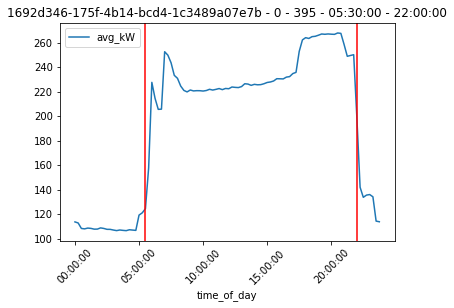

<Figure size 1080x288 with 0 Axes>

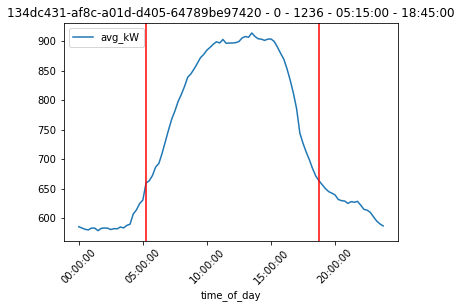

<Figure size 1080x288 with 0 Axes>

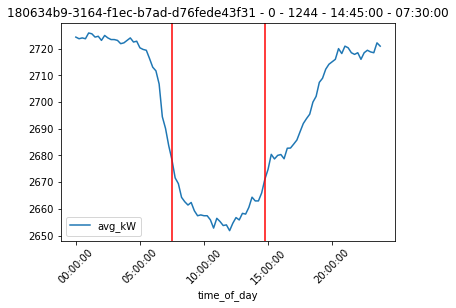

<Figure size 1080x288 with 0 Axes>

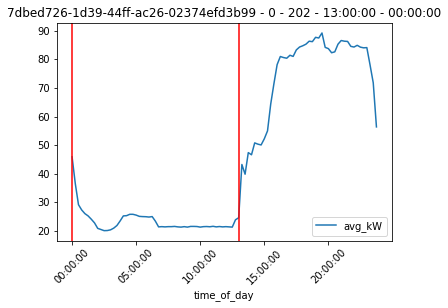

<Figure size 1080x288 with 0 Axes>

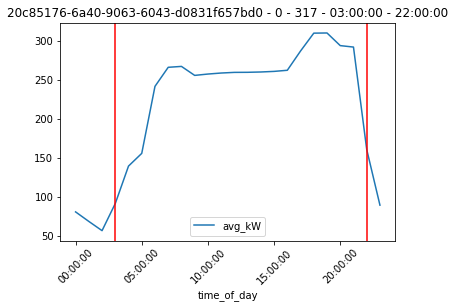

<Figure size 1080x288 with 0 Axes>

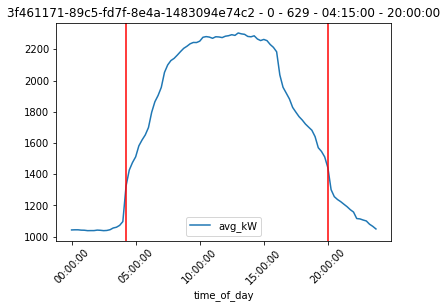

<Figure size 1080x288 with 0 Axes>

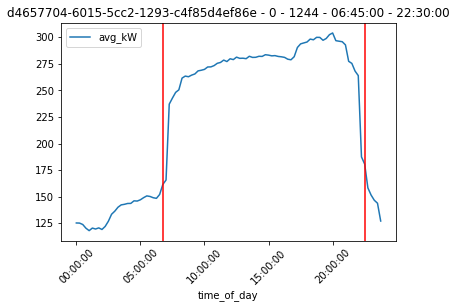

<Figure size 1080x288 with 0 Axes>

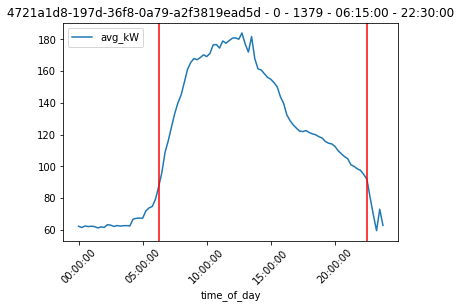

<Figure size 1080x288 with 0 Axes>

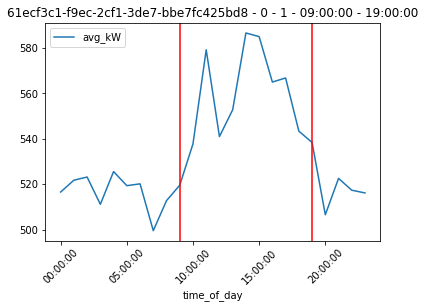

<Figure size 1080x288 with 0 Axes>

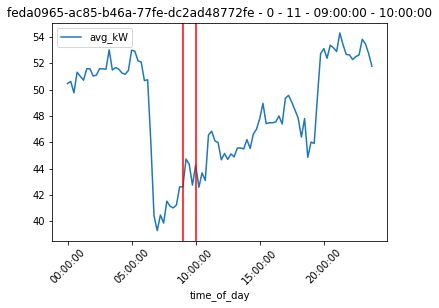

<Figure size 1080x288 with 0 Axes>

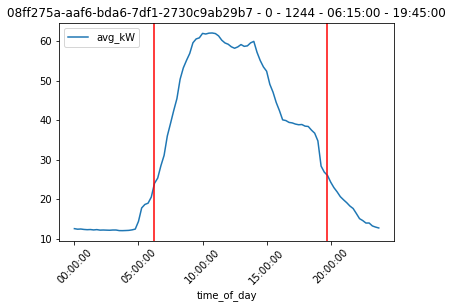

<Figure size 1080x288 with 0 Axes>

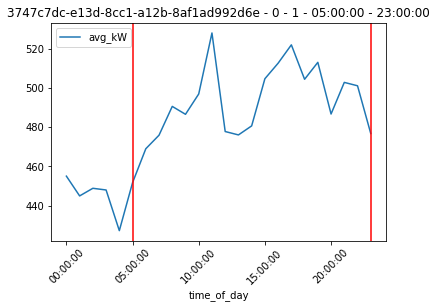

<Figure size 1080x288 with 0 Axes>

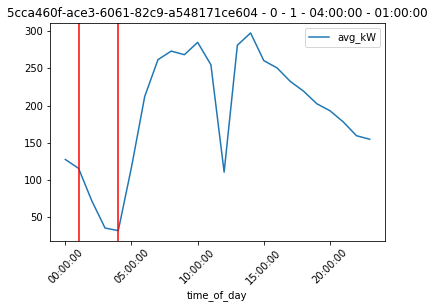

<Figure size 1080x288 with 0 Axes>

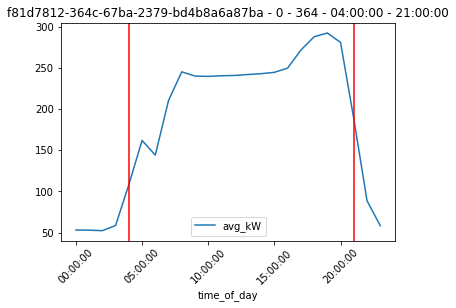

<Figure size 1080x288 with 0 Axes>

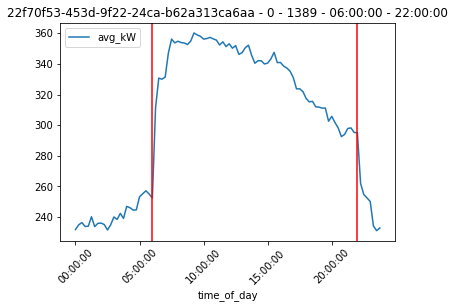

<Figure size 1080x288 with 0 Axes>

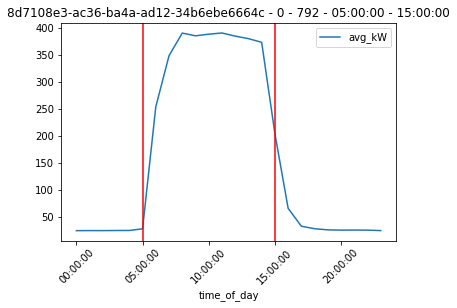

<Figure size 1080x288 with 0 Axes>

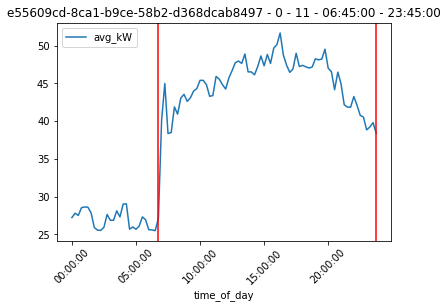

<Figure size 1080x288 with 0 Axes>

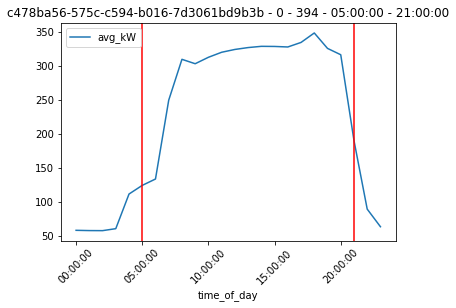

<Figure size 1080x288 with 0 Axes>

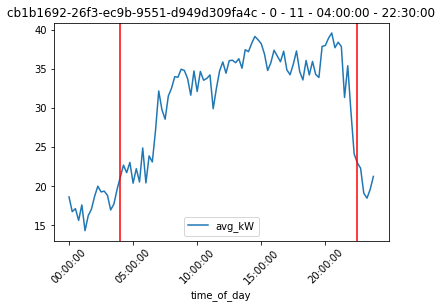

<Figure size 1080x288 with 0 Axes>

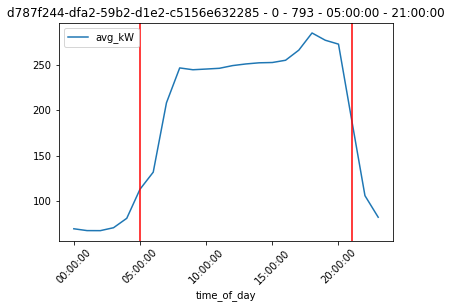

<Figure size 1080x288 with 0 Axes>

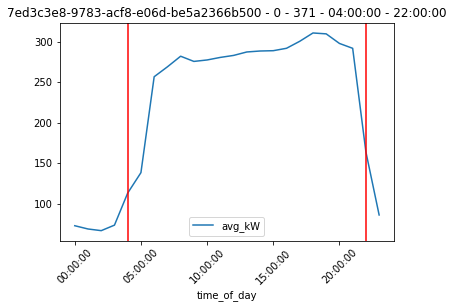

<Figure size 1080x288 with 0 Axes>

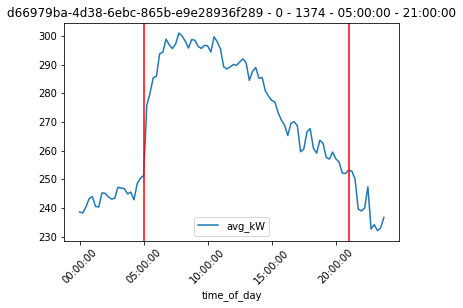

<Figure size 1080x288 with 0 Axes>

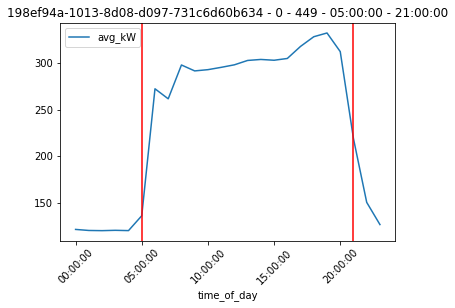

<Figure size 1080x288 with 0 Axes>

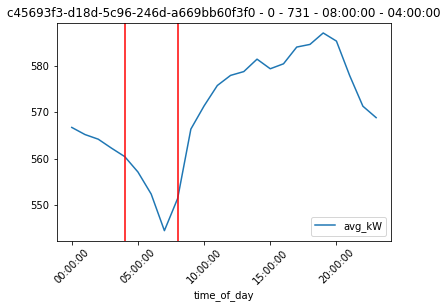

<Figure size 1080x288 with 0 Axes>

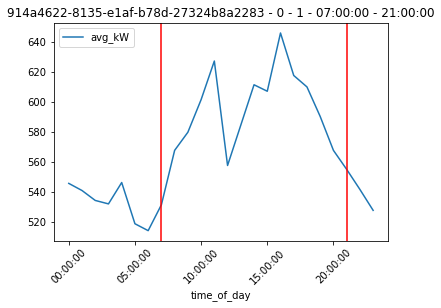

<Figure size 1080x288 with 0 Axes>

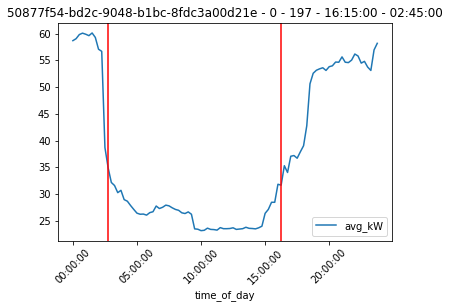

<Figure size 1080x288 with 0 Axes>

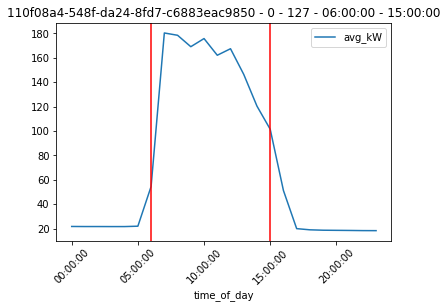

<Figure size 1080x288 with 0 Axes>

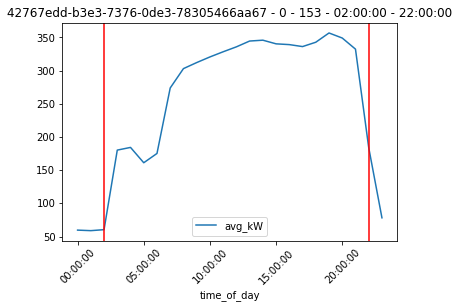

<Figure size 1080x288 with 0 Axes>

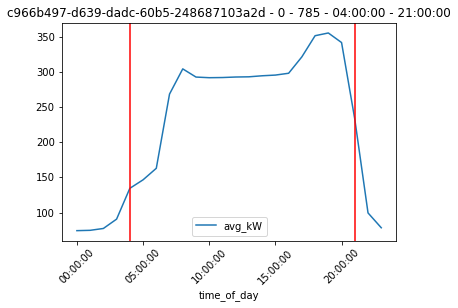

<Figure size 1080x288 with 0 Axes>

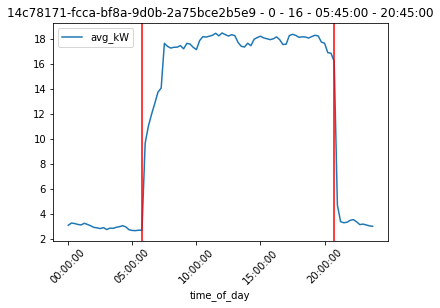

<Figure size 1080x288 with 0 Axes>

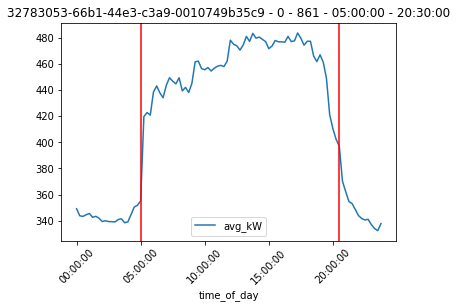

<Figure size 1080x288 with 0 Axes>

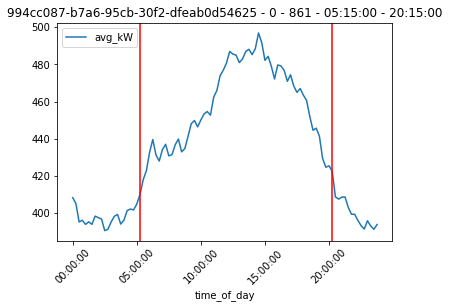

<Figure size 1080x288 with 0 Axes>

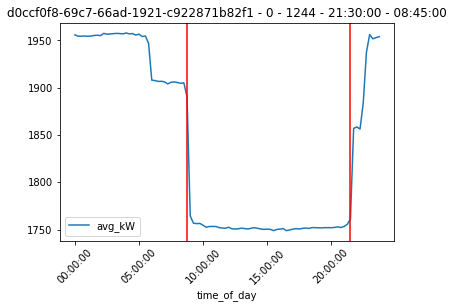

<Figure size 1080x288 with 0 Axes>

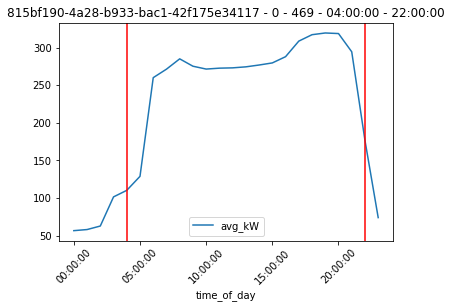

<Figure size 1080x288 with 0 Axes>

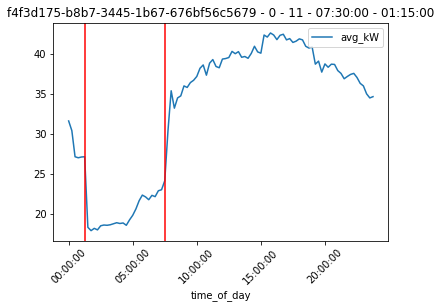

<Figure size 1080x288 with 0 Axes>

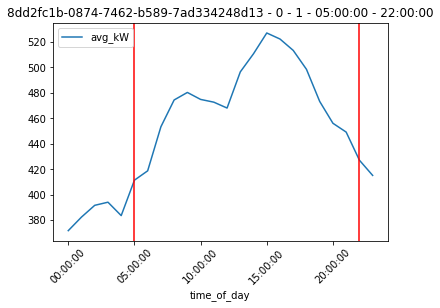

<Figure size 1080x288 with 0 Axes>

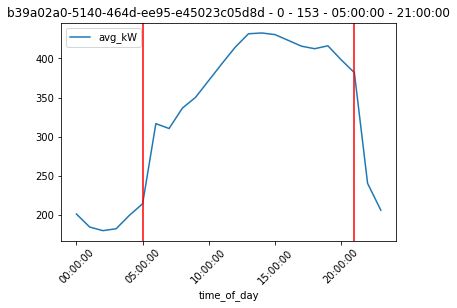

<Figure size 1080x288 with 0 Axes>

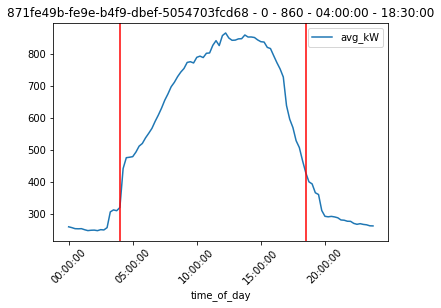

<Figure size 1080x288 with 0 Axes>

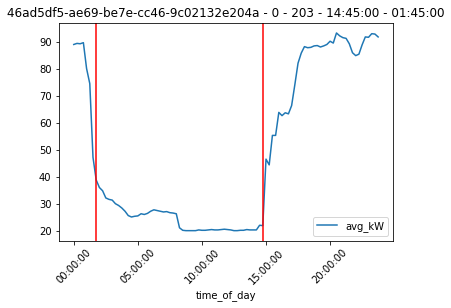

<Figure size 1080x288 with 0 Axes>

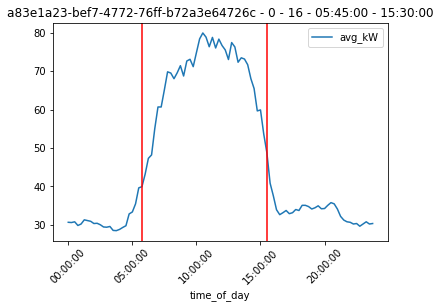

<Figure size 1080x288 with 0 Axes>

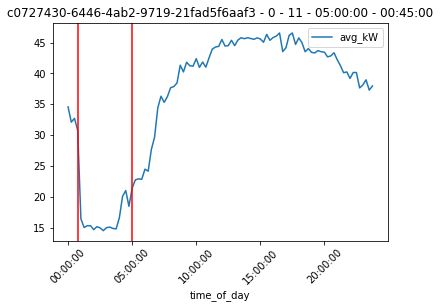

<Figure size 1080x288 with 0 Axes>

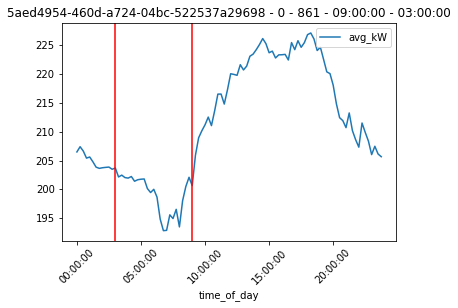

<Figure size 1080x288 with 0 Axes>

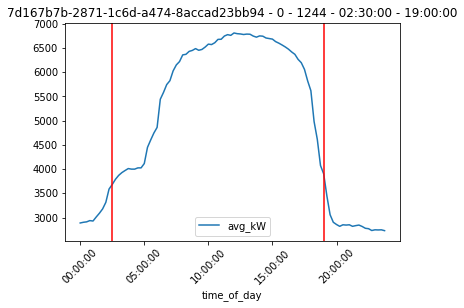

<Figure size 1080x288 with 0 Axes>

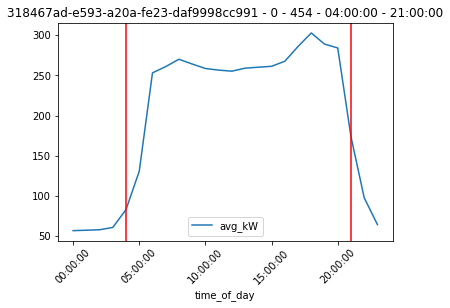

<Figure size 1080x288 with 0 Axes>

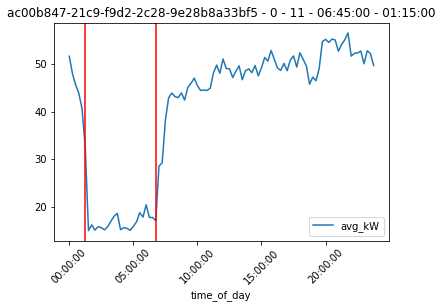

<Figure size 1080x288 with 0 Axes>

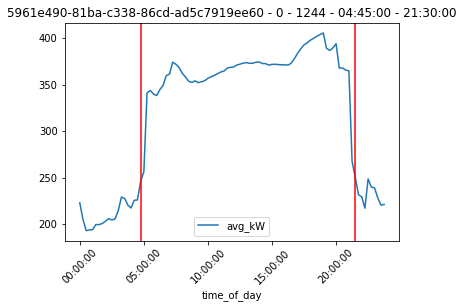

<Figure size 1080x288 with 0 Axes>

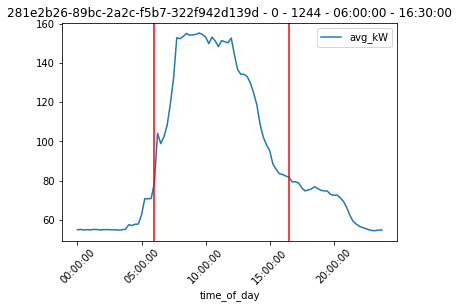

<Figure size 1080x288 with 0 Axes>

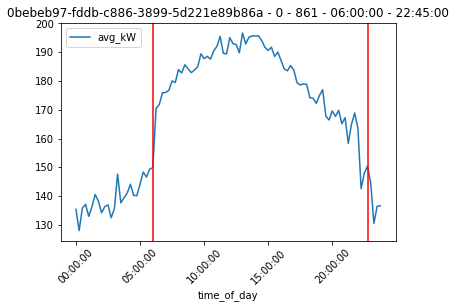

<Figure size 1080x288 with 0 Axes>

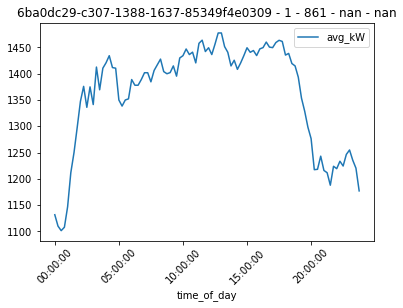

<Figure size 1080x288 with 0 Axes>

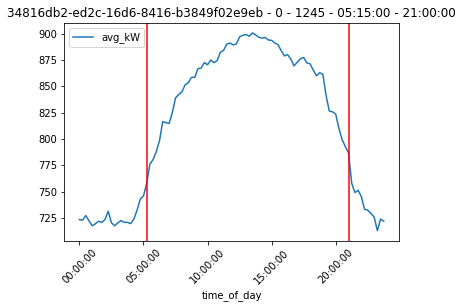

<Figure size 1080x288 with 0 Axes>

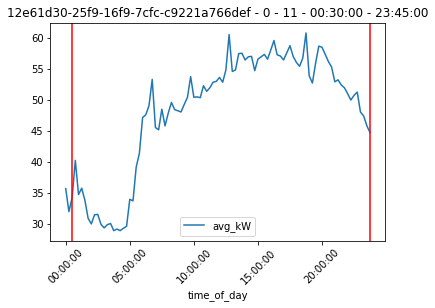

<Figure size 1080x288 with 0 Axes>

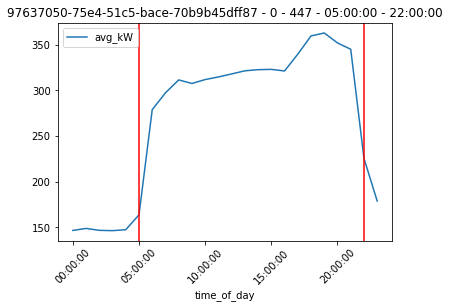

<Figure size 1080x288 with 0 Axes>

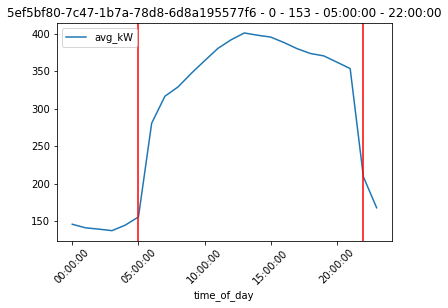

<Figure size 1080x288 with 0 Axes>

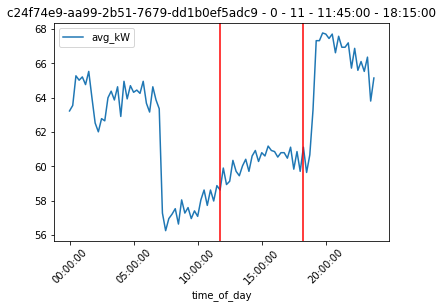

<Figure size 1080x288 with 0 Axes>

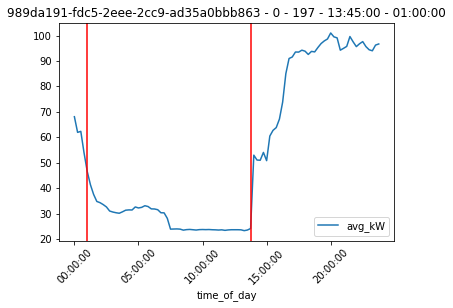

<Figure size 1080x288 with 0 Axes>

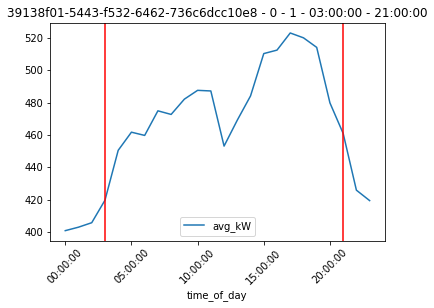

<Figure size 1080x288 with 0 Axes>

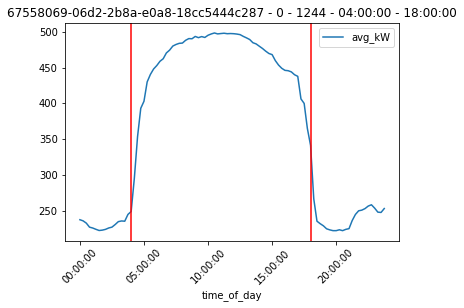

<Figure size 1080x288 with 0 Axes>

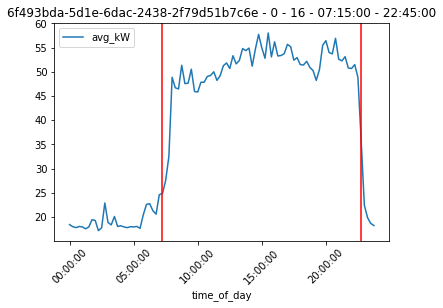

<Figure size 1080x288 with 0 Axes>

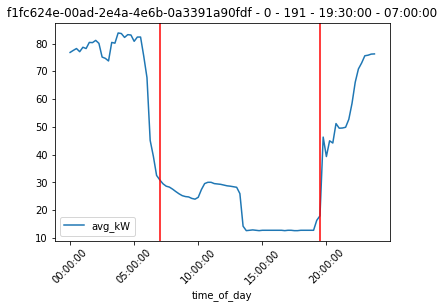

<Figure size 1080x288 with 0 Axes>

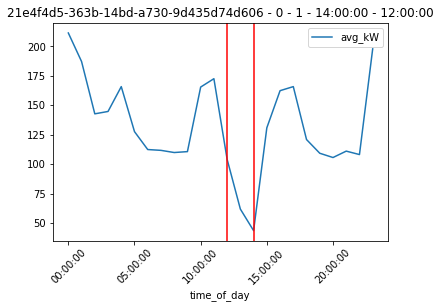

<Figure size 1080x288 with 0 Axes>

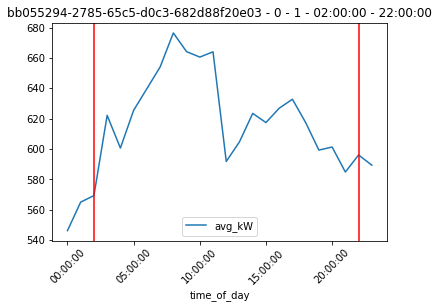

<Figure size 1080x288 with 0 Axes>

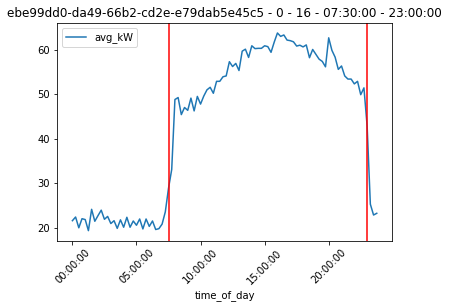

<Figure size 1080x288 with 0 Axes>

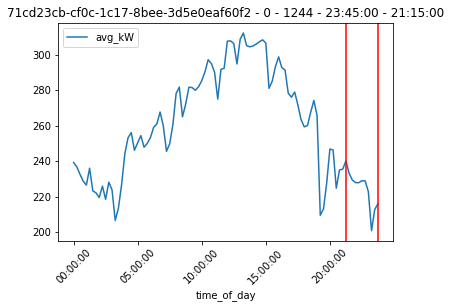

<Figure size 1080x288 with 0 Axes>

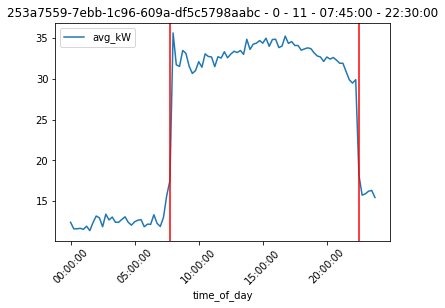

<Figure size 1080x288 with 0 Axes>

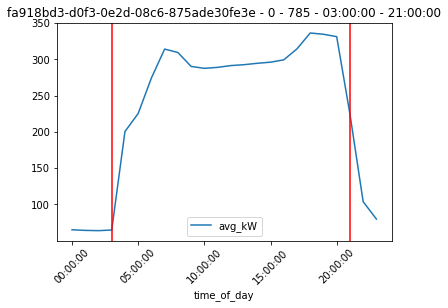

<Figure size 1080x288 with 0 Axes>

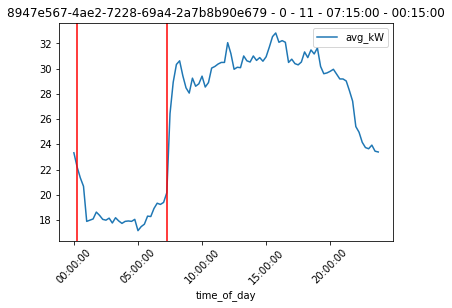

<Figure size 1080x288 with 0 Axes>

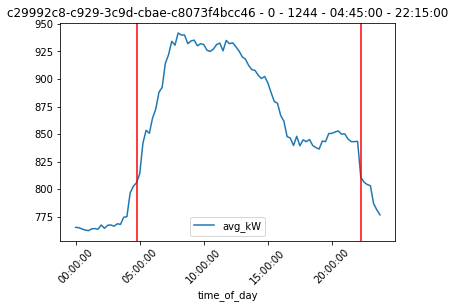

<Figure size 1080x288 with 0 Axes>

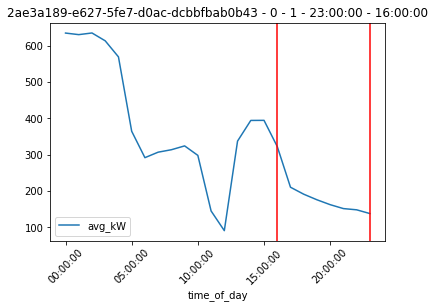

<Figure size 1080x288 with 0 Axes>

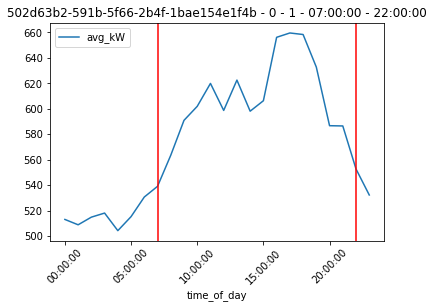

<Figure size 1080x288 with 0 Axes>

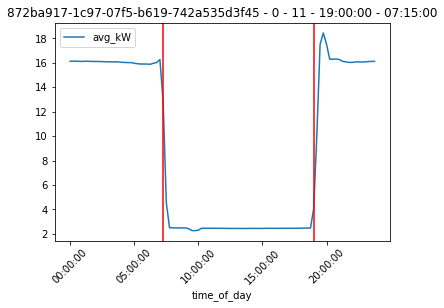

<Figure size 1080x288 with 0 Axes>

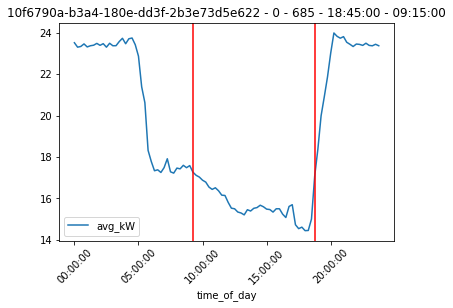

<Figure size 1080x288 with 0 Axes>

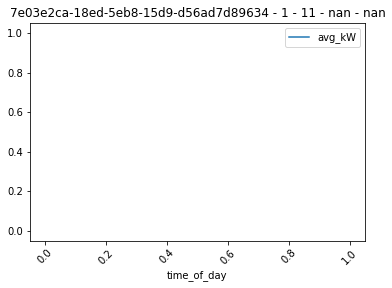

<Figure size 1080x288 with 0 Axes>

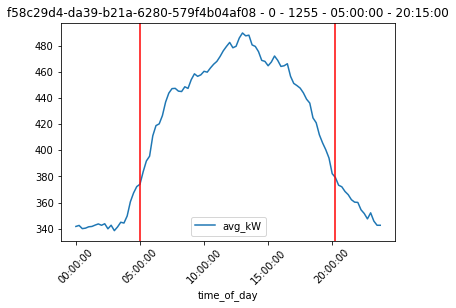

<Figure size 1080x288 with 0 Axes>

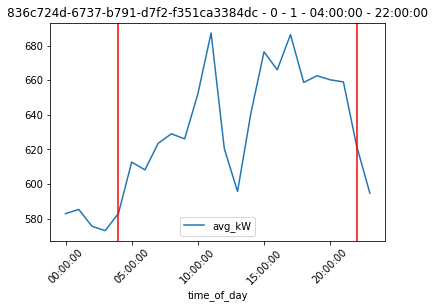

<Figure size 1080x288 with 0 Axes>

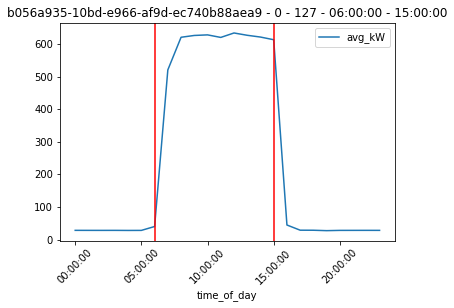

<Figure size 1080x288 with 0 Axes>

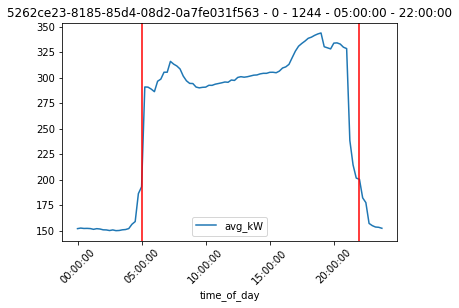

<Figure size 1080x288 with 0 Axes>

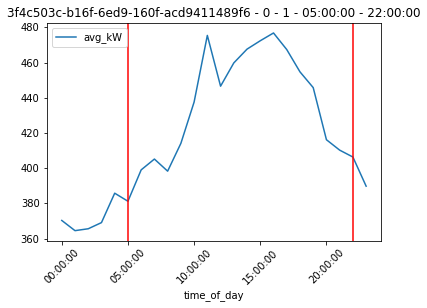

<Figure size 1080x288 with 0 Axes>

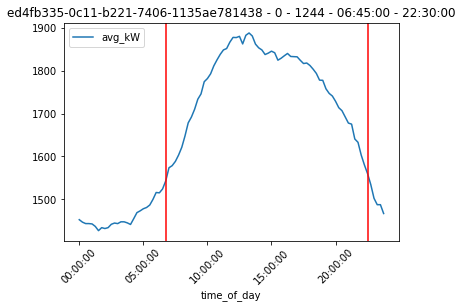

<Figure size 1080x288 with 0 Axes>

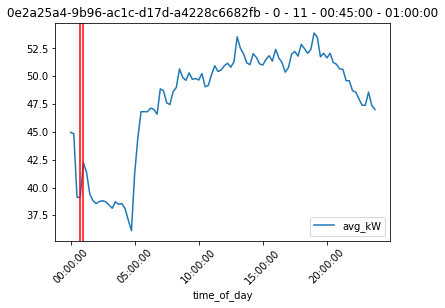

<Figure size 1080x288 with 0 Axes>

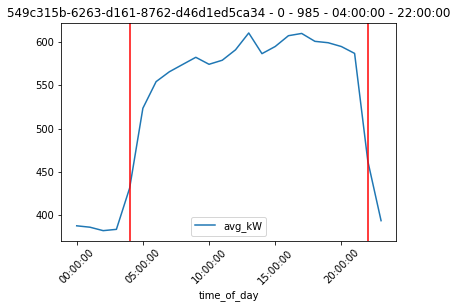

<Figure size 1080x288 with 0 Axes>

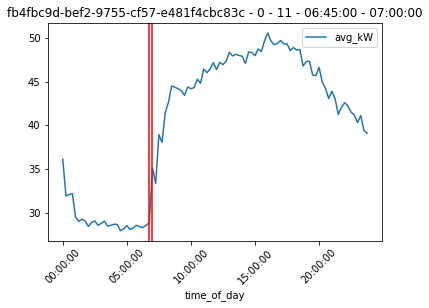

<Figure size 1080x288 with 0 Axes>

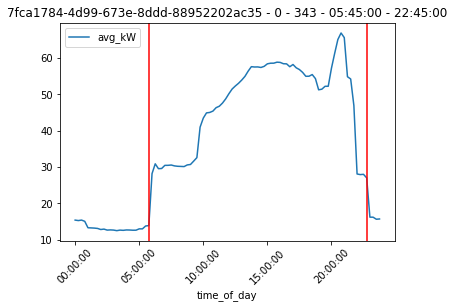

<Figure size 1080x288 with 0 Axes>

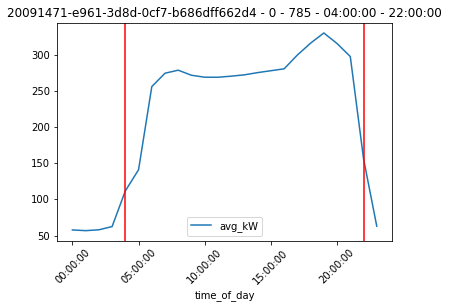

<Figure size 1080x288 with 0 Axes>

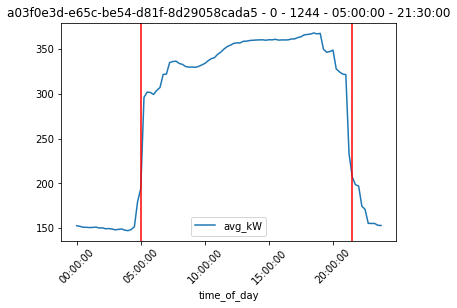

<Figure size 1080x288 with 0 Axes>

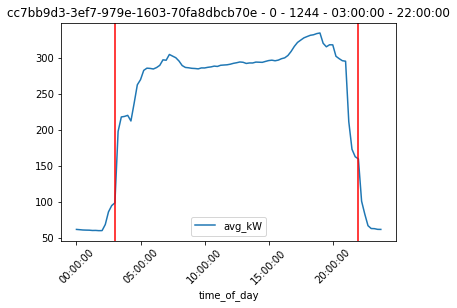

<Figure size 1080x288 with 0 Axes>

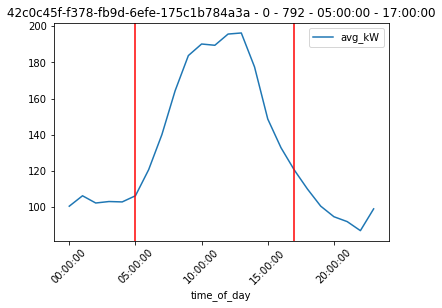

<Figure size 1080x288 with 0 Axes>

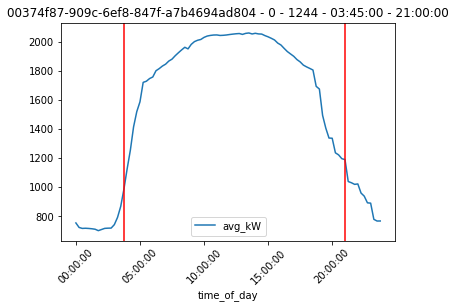

<Figure size 1080x288 with 0 Axes>

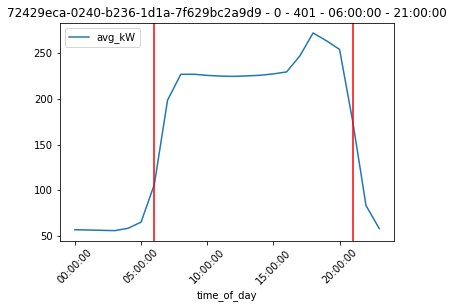

<Figure size 1080x288 with 0 Axes>

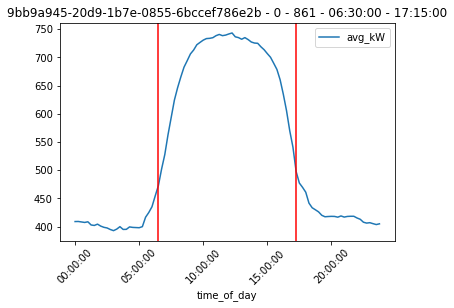

<Figure size 1080x288 with 0 Axes>

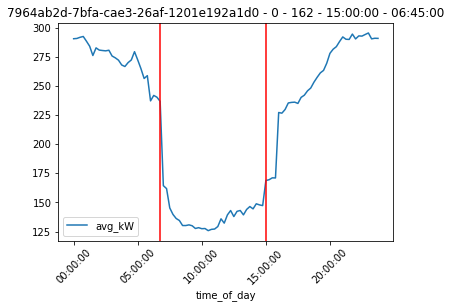

<Figure size 1080x288 with 0 Axes>

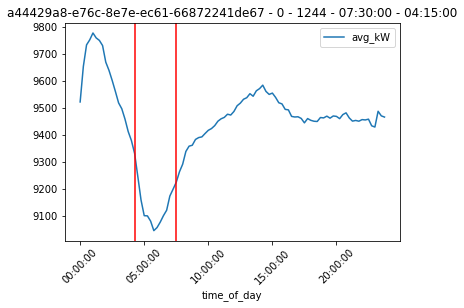

<Figure size 1080x288 with 0 Axes>

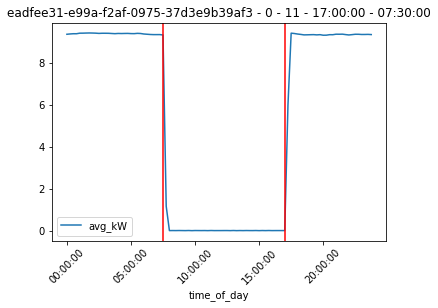

<Figure size 1080x288 with 0 Axes>

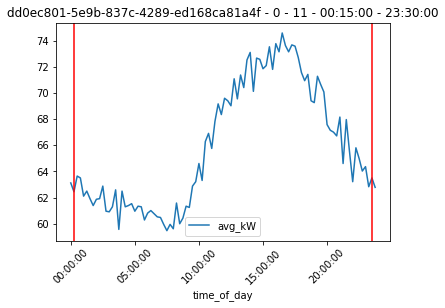

<Figure size 1080x288 with 0 Axes>

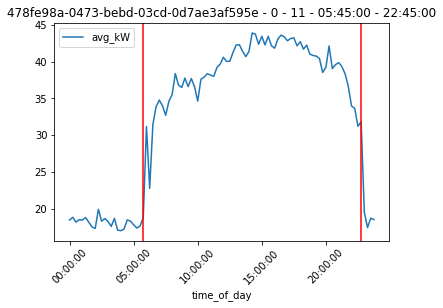

<Figure size 1080x288 with 0 Axes>

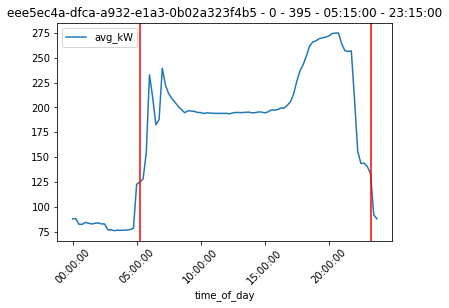

<Figure size 1080x288 with 0 Axes>

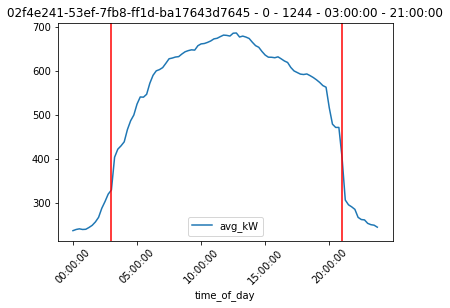

<Figure size 1080x288 with 0 Axes>

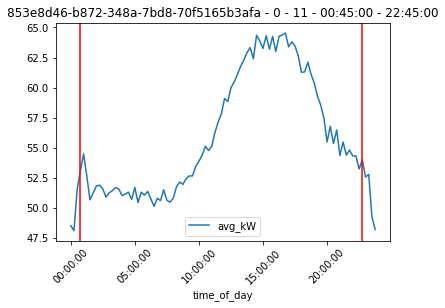

<Figure size 1080x288 with 0 Axes>

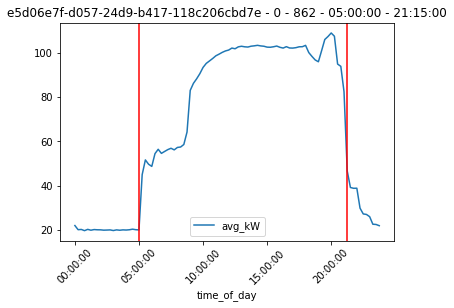

<Figure size 1080x288 with 0 Axes>

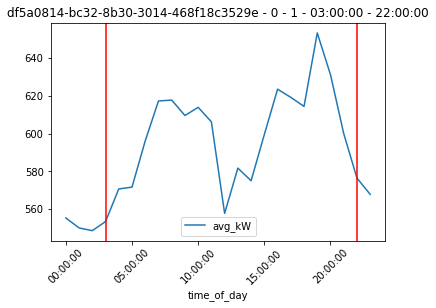

<Figure size 1080x288 with 0 Axes>

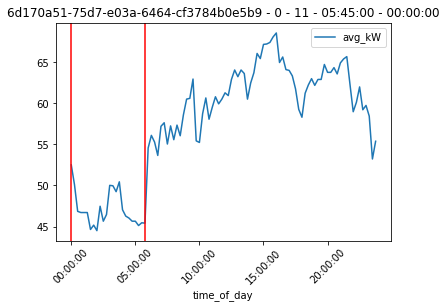

<Figure size 1080x288 with 0 Axes>

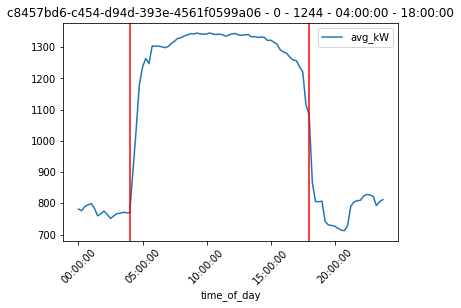

<Figure size 1080x288 with 0 Axes>

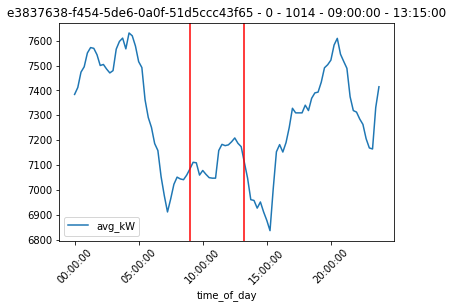

<Figure size 1080x288 with 0 Axes>

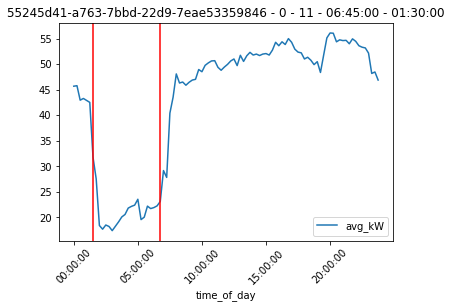

<Figure size 1080x288 with 0 Axes>

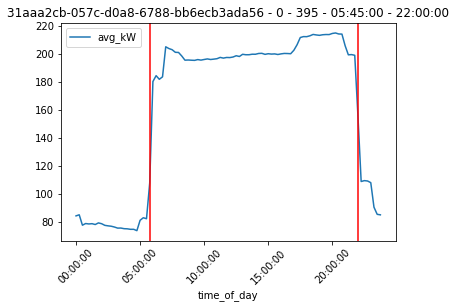

<Figure size 1080x288 with 0 Axes>

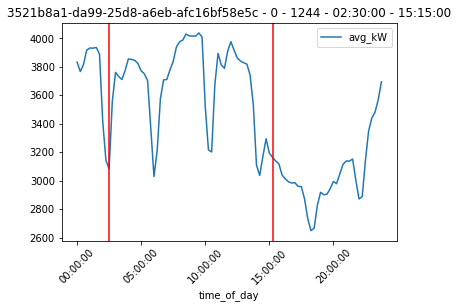

<Figure size 1080x288 with 0 Axes>

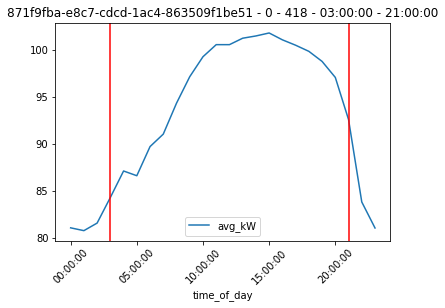

<Figure size 1080x288 with 0 Axes>

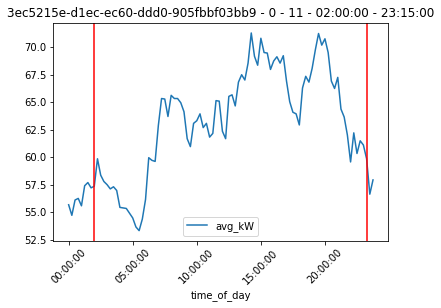

<Figure size 1080x288 with 0 Axes>

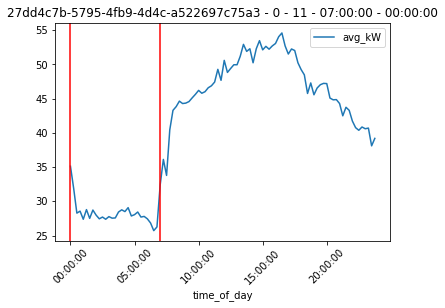

<Figure size 1080x288 with 0 Axes>

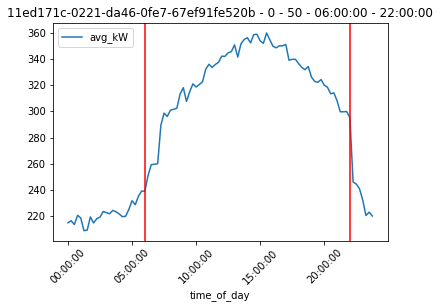

<Figure size 1080x288 with 0 Axes>

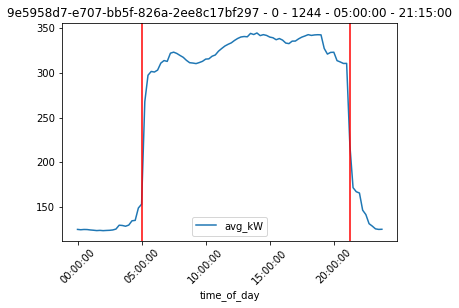

<Figure size 1080x288 with 0 Axes>

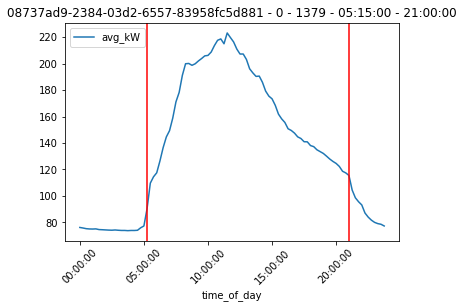

<Figure size 1080x288 with 0 Axes>

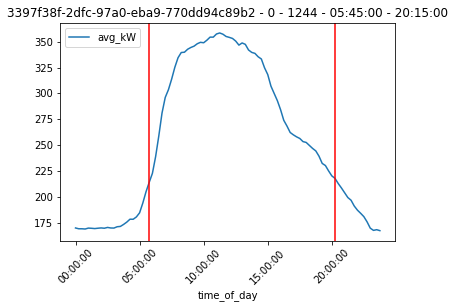

<Figure size 1080x288 with 0 Axes>

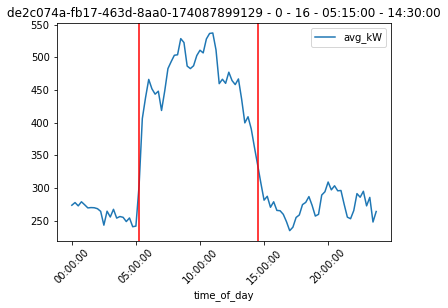

<Figure size 1080x288 with 0 Axes>

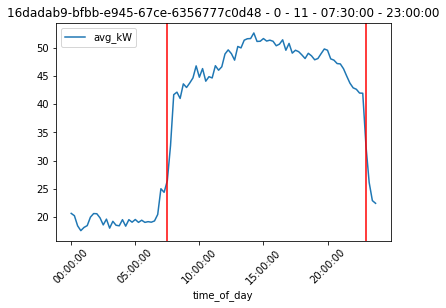

<Figure size 1080x288 with 0 Axes>

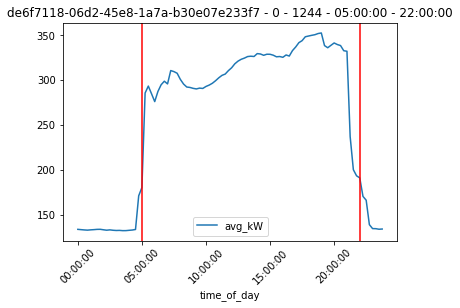

<Figure size 1080x288 with 0 Axes>

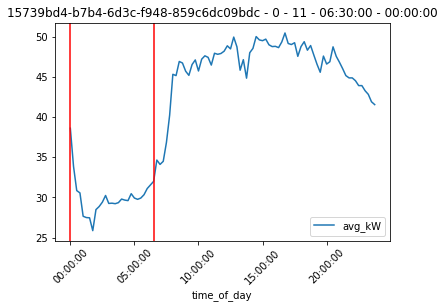

<Figure size 1080x288 with 0 Axes>

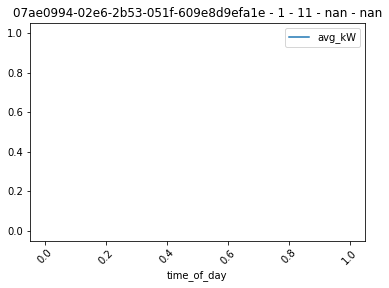

<Figure size 1080x288 with 0 Axes>

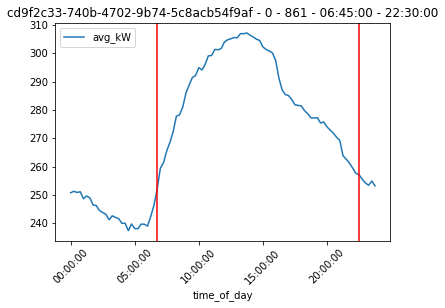

<Figure size 1080x288 with 0 Axes>

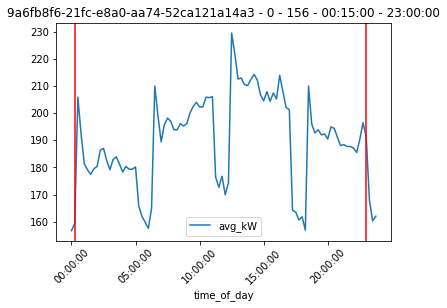

<Figure size 1080x288 with 0 Axes>

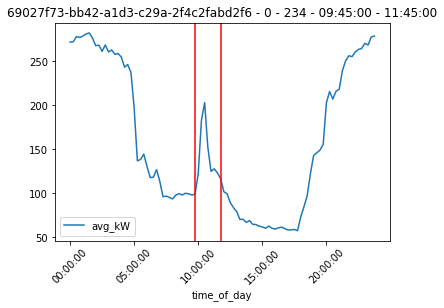

<Figure size 1080x288 with 0 Axes>

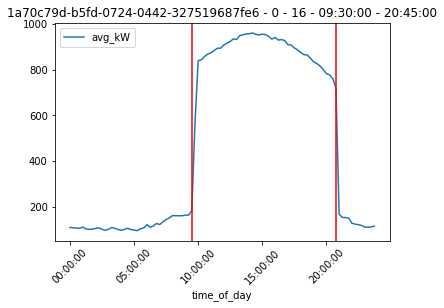

<Figure size 1080x288 with 0 Axes>

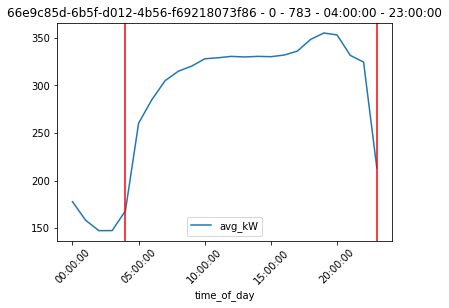

<Figure size 1080x288 with 0 Axes>

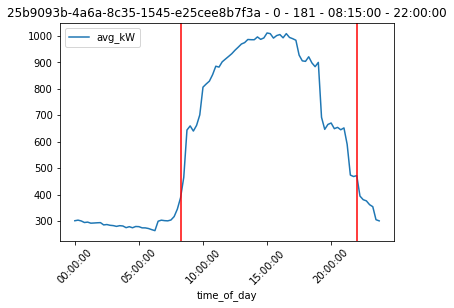

<Figure size 1080x288 with 0 Axes>

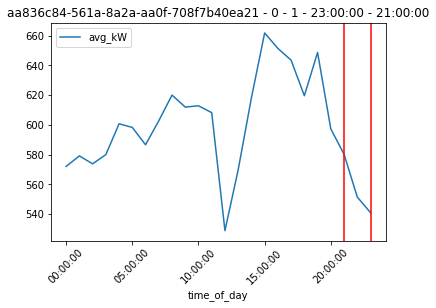

<Figure size 1080x288 with 0 Axes>

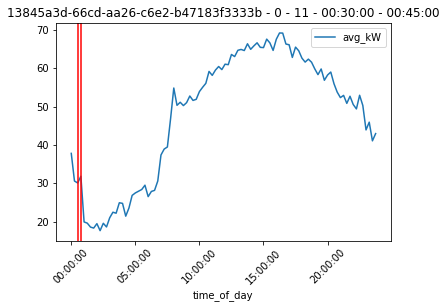

<Figure size 1080x288 with 0 Axes>

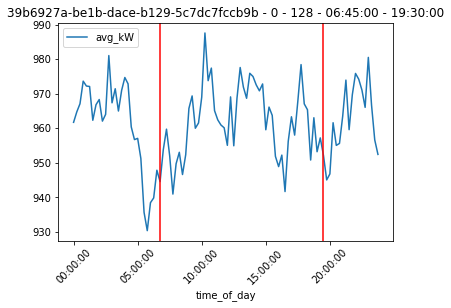

<Figure size 1080x288 with 0 Axes>

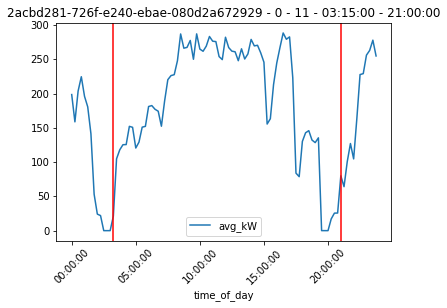

<Figure size 1080x288 with 0 Axes>

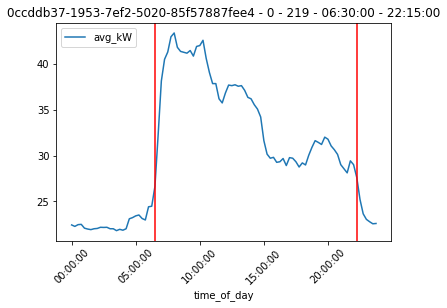

<Figure size 1080x288 with 0 Axes>

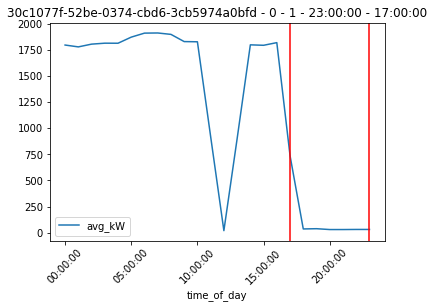

<Figure size 1080x288 with 0 Axes>

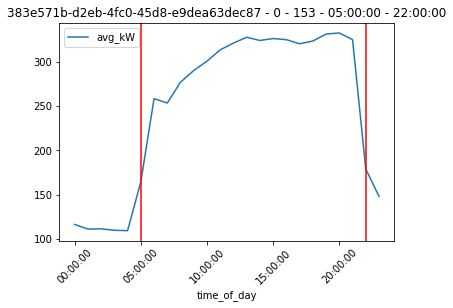

<Figure size 1080x288 with 0 Axes>

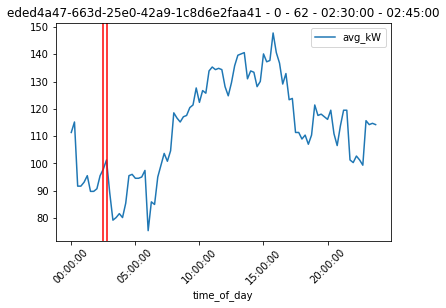

<Figure size 1080x288 with 0 Axes>

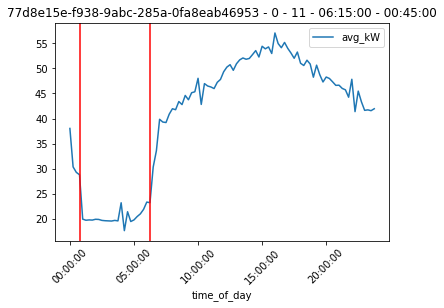

<Figure size 1080x288 with 0 Axes>

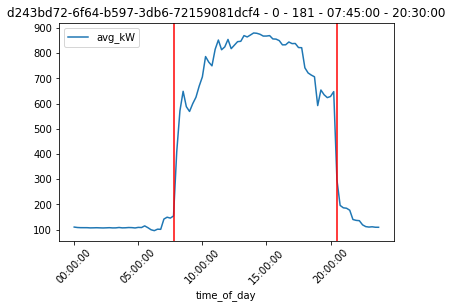

<Figure size 1080x288 with 0 Axes>

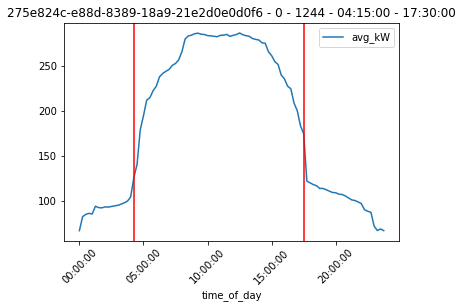

<Figure size 1080x288 with 0 Axes>

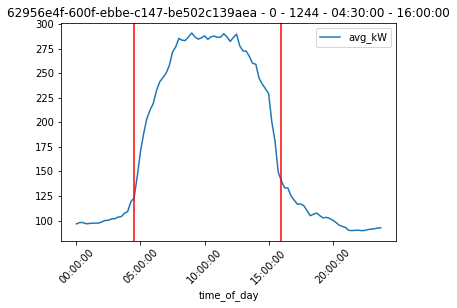

<Figure size 1080x288 with 0 Axes>

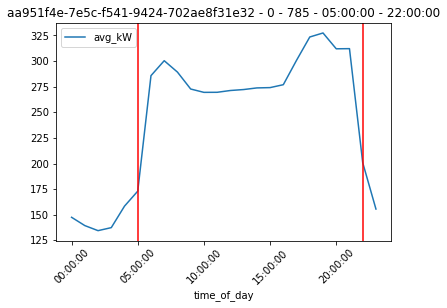

<Figure size 1080x288 with 0 Axes>

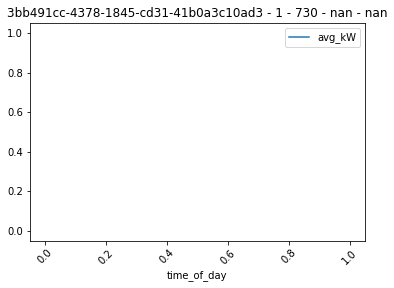

<Figure size 1080x288 with 0 Axes>

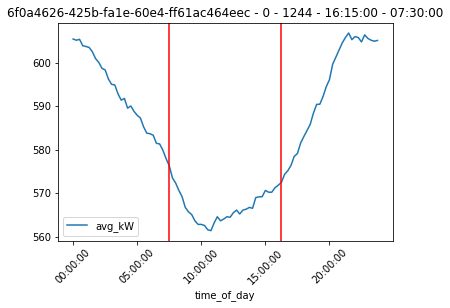

<Figure size 1080x288 with 0 Axes>

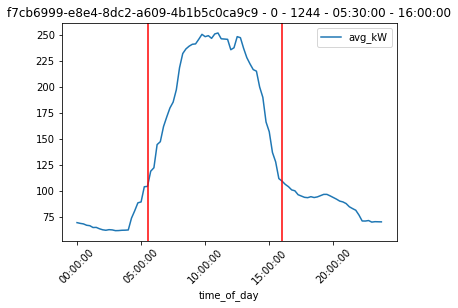

<Figure size 1080x288 with 0 Axes>

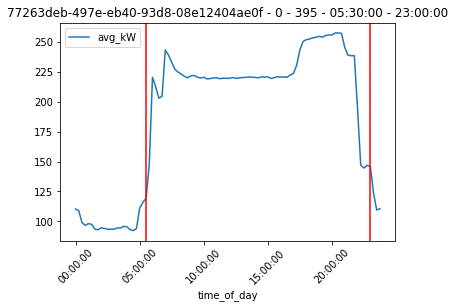

<Figure size 1080x288 with 0 Axes>

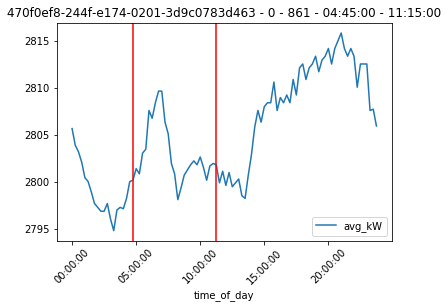

<Figure size 1080x288 with 0 Axes>

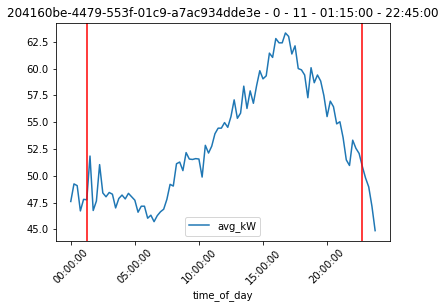

<Figure size 1080x288 with 0 Axes>

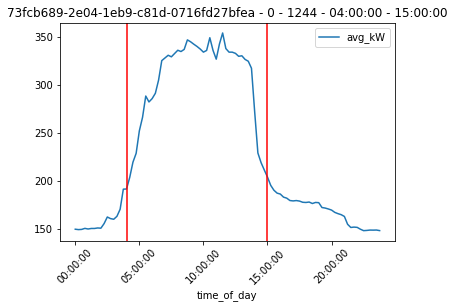

<Figure size 1080x288 with 0 Axes>

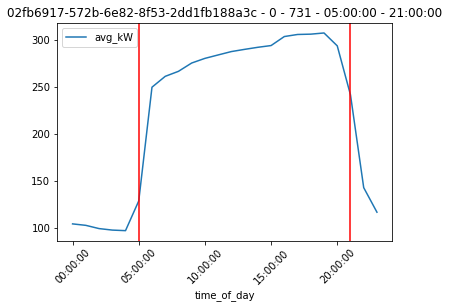

<Figure size 1080x288 with 0 Axes>

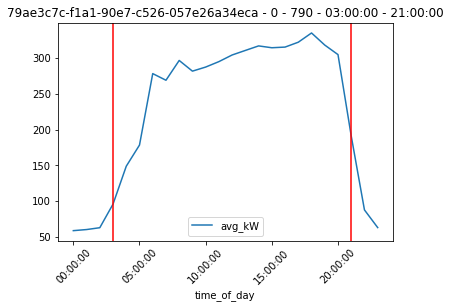

<Figure size 1080x288 with 0 Axes>

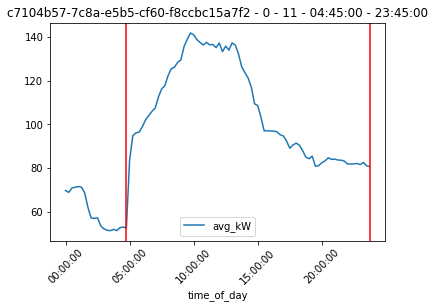

<Figure size 1080x288 with 0 Axes>

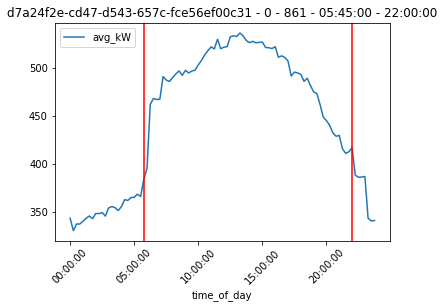

<Figure size 1080x288 with 0 Axes>

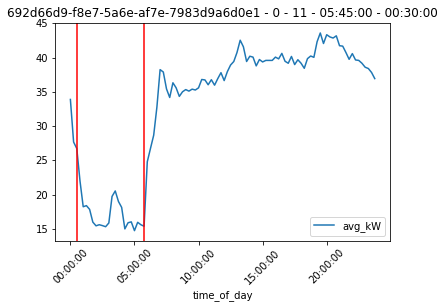

<Figure size 1080x288 with 0 Axes>

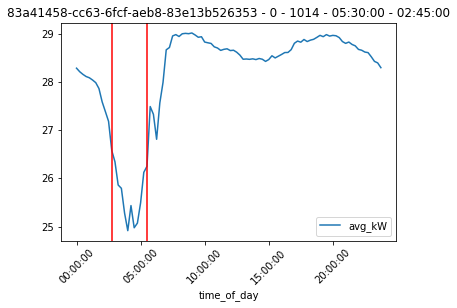

<Figure size 1080x288 with 0 Axes>

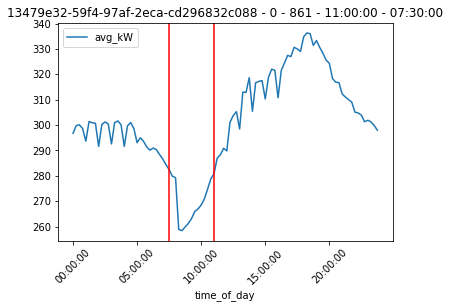

<Figure size 1080x288 with 0 Axes>

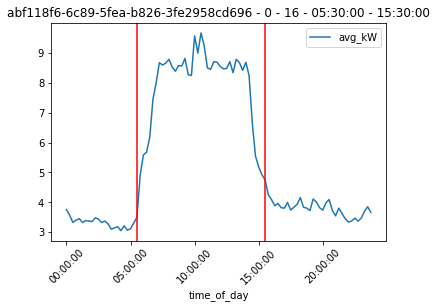

<Figure size 1080x288 with 0 Axes>

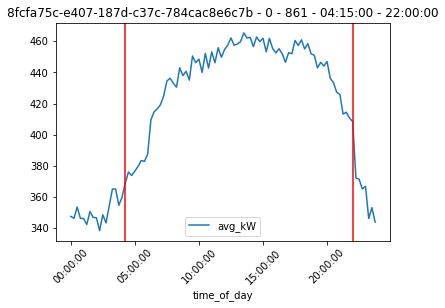

<Figure size 1080x288 with 0 Axes>

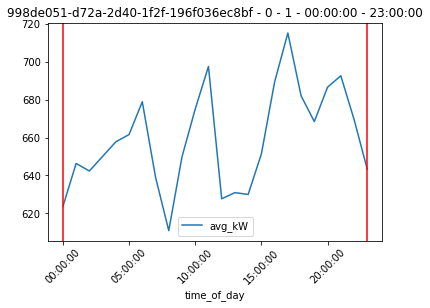

<Figure size 1080x288 with 0 Axes>

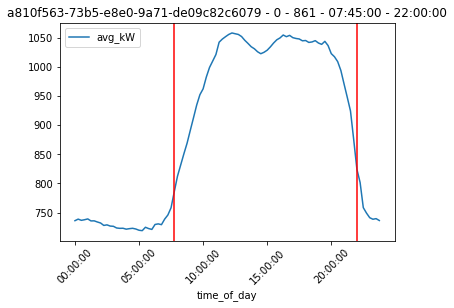

<Figure size 1080x288 with 0 Axes>

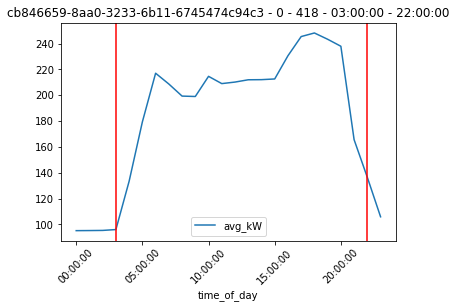

<Figure size 1080x288 with 0 Axes>

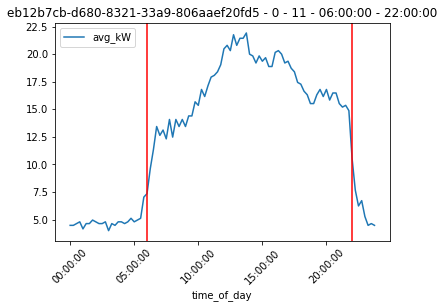

<Figure size 1080x288 with 0 Axes>

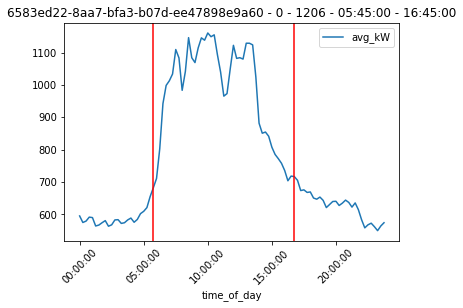

<Figure size 1080x288 with 0 Axes>

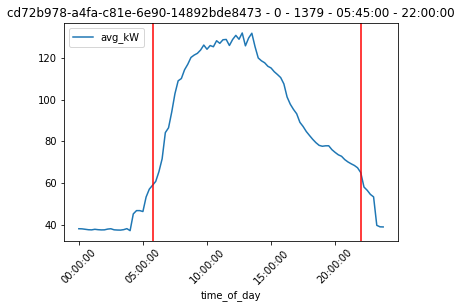

<Figure size 1080x288 with 0 Axes>

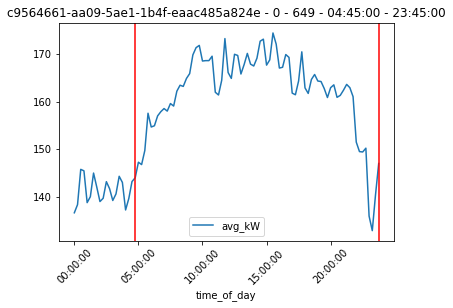

<Figure size 1080x288 with 0 Axes>

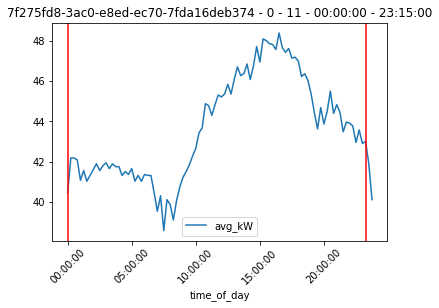

<Figure size 1080x288 with 0 Axes>

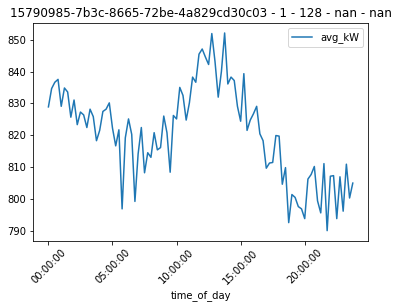

<Figure size 1080x288 with 0 Axes>

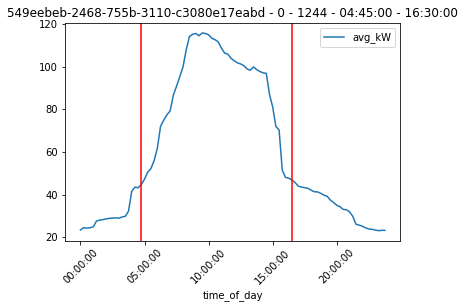

<Figure size 1080x288 with 0 Axes>

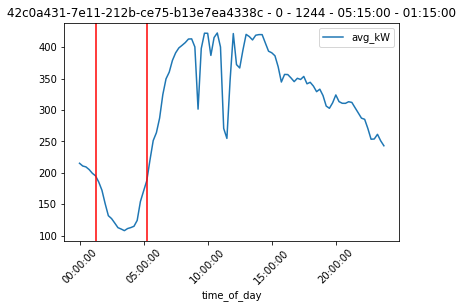

<Figure size 1080x288 with 0 Axes>

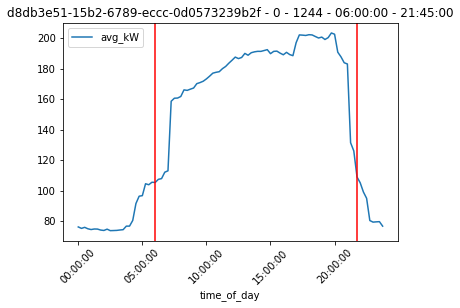

<Figure size 1080x288 with 0 Axes>

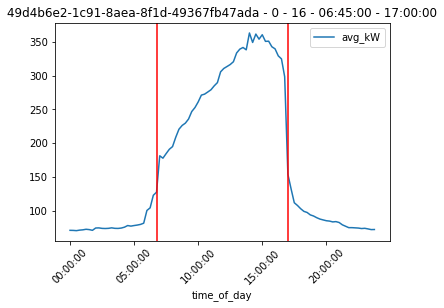

<Figure size 1080x288 with 0 Axes>

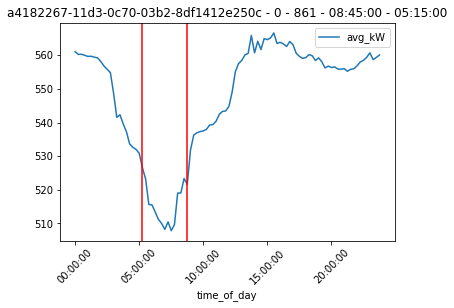

<Figure size 1080x288 with 0 Axes>

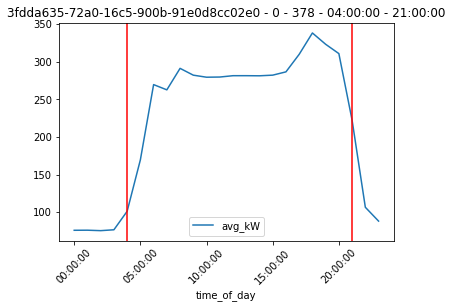

<Figure size 1080x288 with 0 Axes>

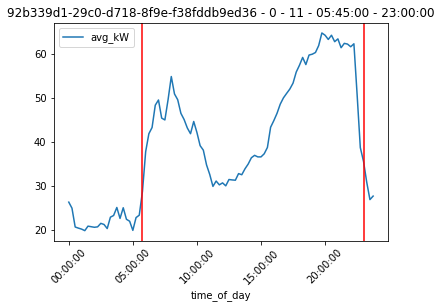

<Figure size 1080x288 with 0 Axes>

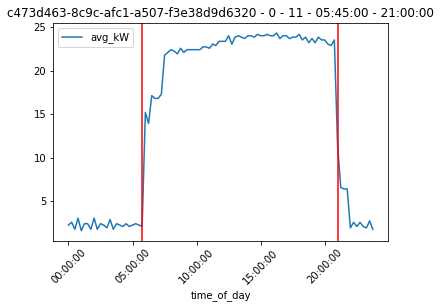

<Figure size 1080x288 with 0 Axes>

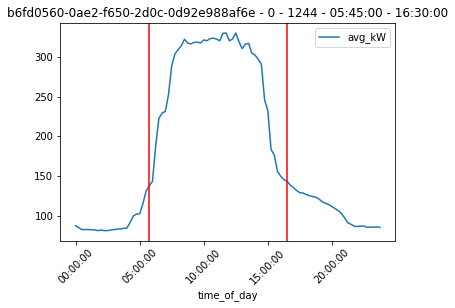

<Figure size 1080x288 with 0 Axes>

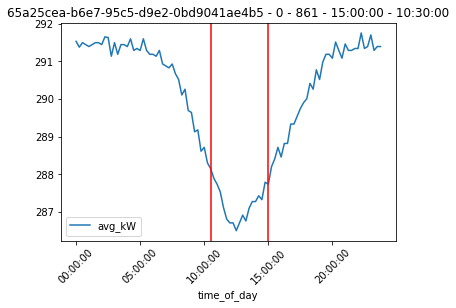

<Figure size 1080x288 with 0 Axes>

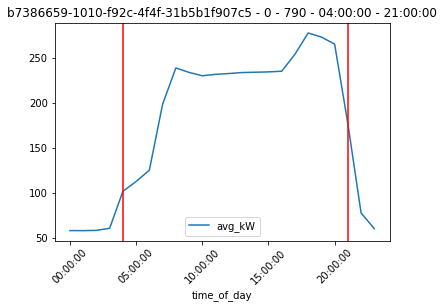

<Figure size 1080x288 with 0 Axes>

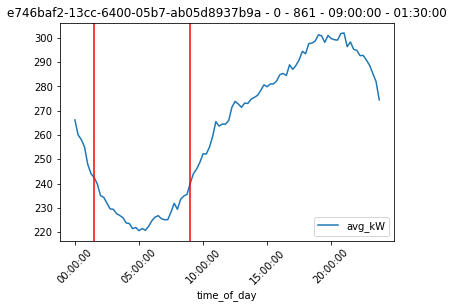

<Figure size 1080x288 with 0 Axes>

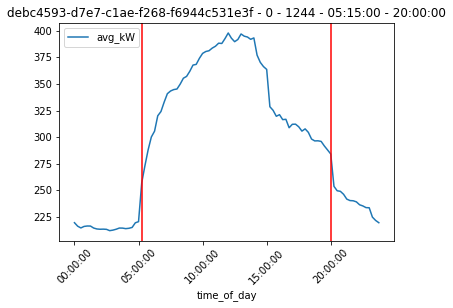

<Figure size 1080x288 with 0 Axes>

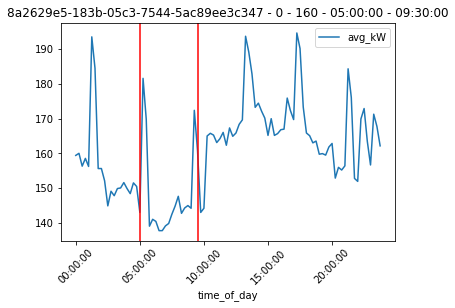

<Figure size 1080x288 with 0 Axes>

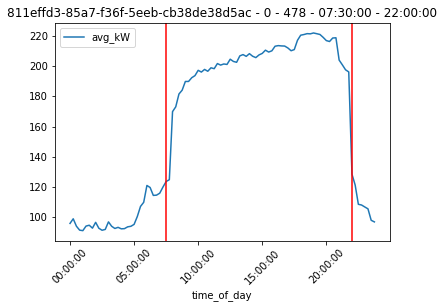

<Figure size 1080x288 with 0 Axes>

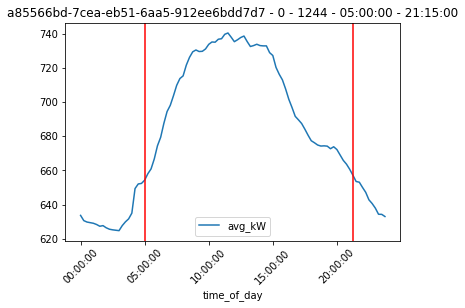

<Figure size 1080x288 with 0 Axes>

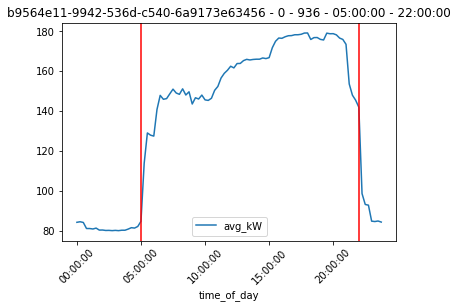

In [384]:
test_ops_data = day_plot_site_operating_status(all_data_df, site_list)

In [385]:
plt.close('all')